### BADASS Analysis: small molecules

Can we distinguish three different classes of small molecules (amino acids, fatty acids and sugars) from one another? And can we reduce the number of peptides we include in the array without negatively affecting model performance?

#### Analytes

Amino acids:
- Glutamate (E)
- Arginine (R)
- Serine (S)
- Valine (V)
- Tryptophan (W)

Fatty acids:
- Butanoic acid (B)
- Dodecanoic acid (D)
- Nervonic acid (N)
- Oleic acid (O)
- Palmitic acid (P)

Sugars:
- D-(+)-mannose (man)
- D-(-)-fructose (fru)
- D-(+)-glucose (glu)
- D-(+)-maltose monohydrate (mal)
- D-(+)-glucosamine HCl (gluam)

In [1]:
# Import from array_sensing package
from subroutines.parse_array_data import ParseArrayData
from subroutines.train import RunML, draw_conf_matrices

In [2]:
import copy
import math
import os
import pickle
import random
import shutil
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from collections import OrderedDict
from IPython.display import display
from sklearn.ensemble import AdaBoostClassifier
from sklearn.metrics import (
    accuracy_score, recall_score, precision_score, f1_score, cohen_kappa_score, make_scorer
)
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import LinearSVC, SVC

%matplotlib inline
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size

#### Parse in input data

Large array amino acid data

In [3]:
aa_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/'
                           'AAs/Reformatted_AA_csvs/'},
    results_dir='/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
                'All_small_molecules/AA_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Large array fatty acid data

In [4]:
fa_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/'
                           'FAs/Reformatted_FA_csvs/'},
    results_dir='/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
                'All_small_molecules/FA_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Large array sugar data

In [5]:
sugar_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/'
                           'Sugars/Reformatted_sugar_csvs/'},
    results_dir='/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
                'All_small_molecules/Sugar_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)

Locate xlsx files

In [6]:
aa_fluor_data.group_xlsx_repeats()

In [7]:
aa_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['E_repeat_1.xlsx',
                             'R_repeat_1.xlsx',
                             'S_repeat_1.xlsx',
                             'V_repeat_1.xlsx',
                             'W_repeat_1.xlsx'])])),
             ('repeat_2',
              OrderedDict([('DPH',
                            ['E_repeat_2.xlsx',
                             'R_repeat_2.xlsx',
                             'S_repeat_2.xlsx',
                             'V_repeat_2.xlsx',
                             'W_repeat_2.xlsx'])])),
             ('repeat_3',
              OrderedDict([('DPH',
                            ['E_repeat_3.xlsx',
                             'R_repeat_3.xlsx',
                             'S_repeat_3.xlsx',
                             'V_repeat_3.xlsx',
                             'W_repeat_3.xlsx'])])),
             ('repeat_4',
              OrderedDict([('DPH',
                     

In [8]:
fa_fluor_data.group_xlsx_repeats()

In [9]:
fa_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['B_repeat_1.xlsx',
                             'D_repeat_1.xlsx',
                             'N_repeat_1.xlsx',
                             'O_repeat_1.xlsx',
                             'P_repeat_1.xlsx'])])),
             ('repeat_2',
              OrderedDict([('DPH',
                            ['B_repeat_2.xlsx',
                             'D_repeat_2.xlsx',
                             'N_repeat_2.xlsx',
                             'O_repeat_2.xlsx',
                             'P_repeat_2.xlsx'])])),
             ('repeat_3',
              OrderedDict([('DPH',
                            ['B_repeat_3.xlsx',
                             'D_repeat_3.xlsx',
                             'N_repeat_3.xlsx',
                             'O_repeat_3.xlsx',
                             'P_repeat_3.xlsx'])])),
             ('repeat_4',
              OrderedDict([('DPH',
                     

In [10]:
sugar_fluor_data.group_xlsx_repeats()

In [11]:
sugar_fluor_data.repeat_dict

OrderedDict([('repeat_1',
              OrderedDict([('DPH',
                            ['fru_repeat_1.xlsx',
                             'glu_repeat_1.xlsx',
                             'gluam_repeat_1.xlsx',
                             'mal_repeat_1.xlsx',
                             'man_repeat_1.xlsx'])])),
             ('repeat_2',
              OrderedDict([('DPH',
                            ['fru_repeat_2.xlsx',
                             'glu_repeat_2.xlsx',
                             'gluam_repeat_2.xlsx',
                             'mal_repeat_2.xlsx',
                             'man_repeat_2.xlsx'])])),
             ('repeat_3',
              OrderedDict([('DPH',
                            ['fru_repeat_3.xlsx',
                             'glu_repeat_3.xlsx',
                             'gluam_repeat_3.xlsx',
                             'mal_repeat_3.xlsx',
                             'man_repeat_3.xlsx'])])),
             ('repeat_4',
              Ordere

Read the data in each xlsx file into a dataframe and perform min-max scaling

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_1.xlsx
Drawing scatter plot of data spread for E_repeat_1 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

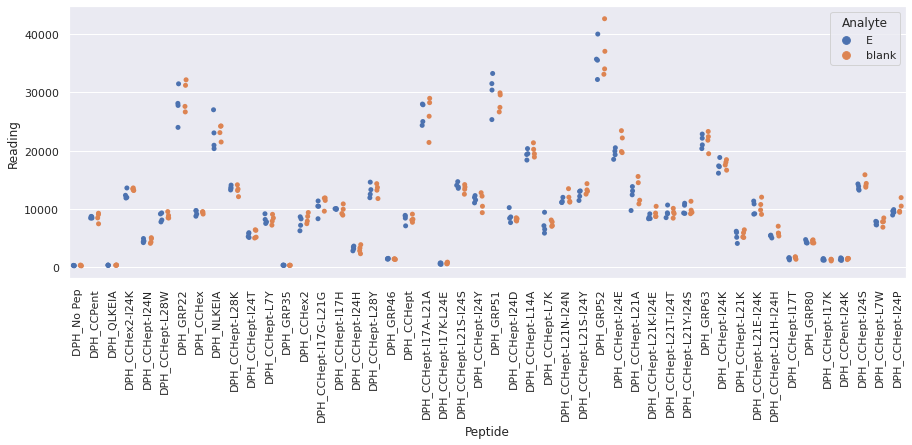

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx
Drawing scatter plot of data spread for R_repeat_1 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

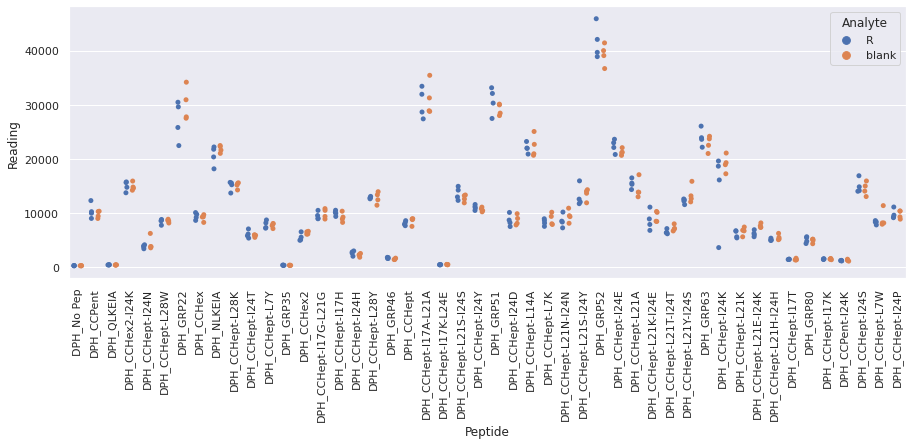

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_1.xlsx
Drawing scatter plot of data spread for S_repeat_1 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

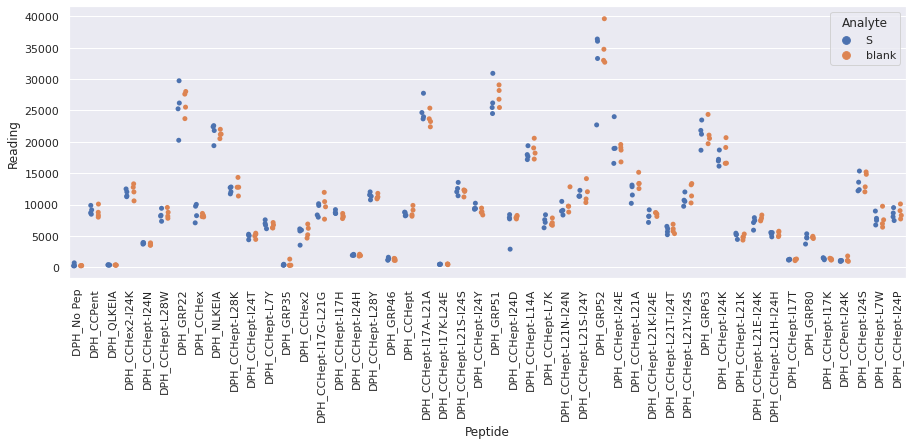

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_1.xlsx
Drawing scatter plot of data spread for V_repeat_1 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

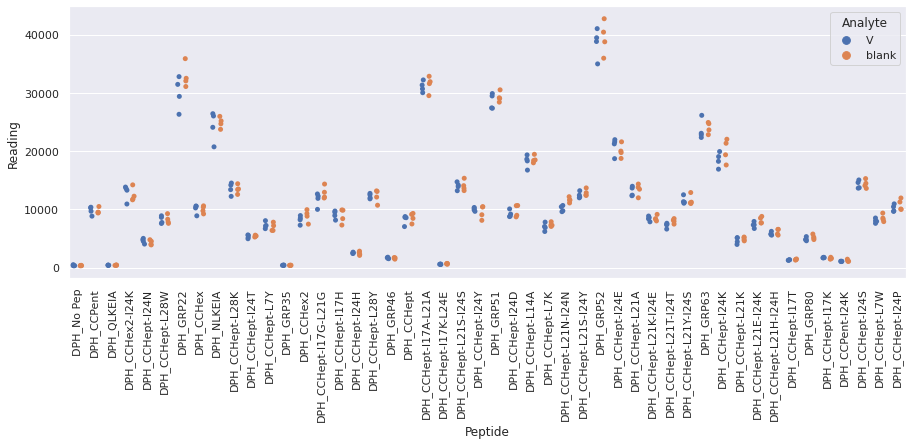

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_1.xlsx
Drawing scatter plot of data spread for W_repeat_1 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

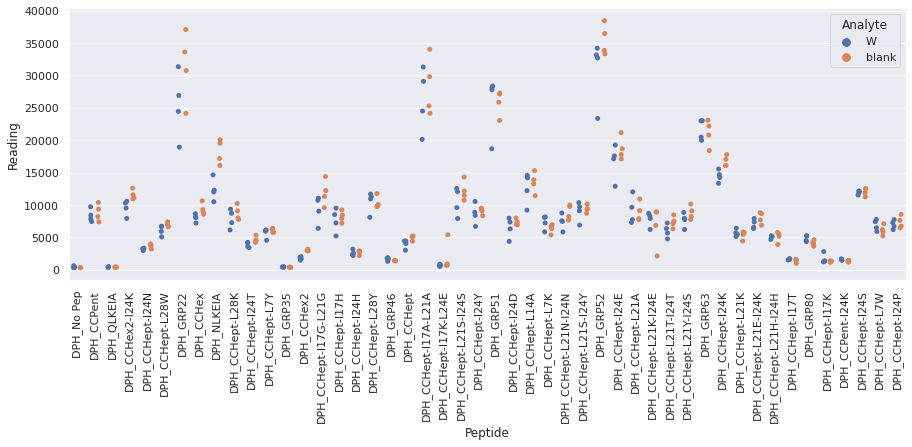

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_2.xlsx
Drawing scatter plot of data spread for E_repeat_2 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

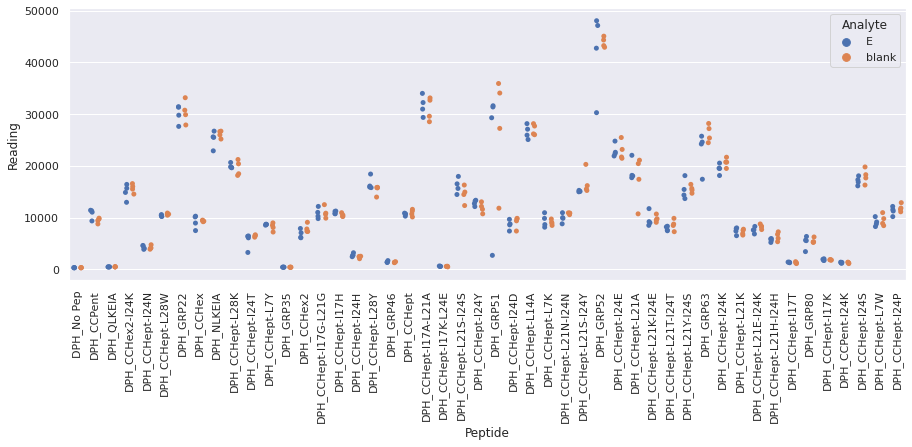

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_2.xlsx
Drawing scatter plot of data spread for R_repeat_2 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

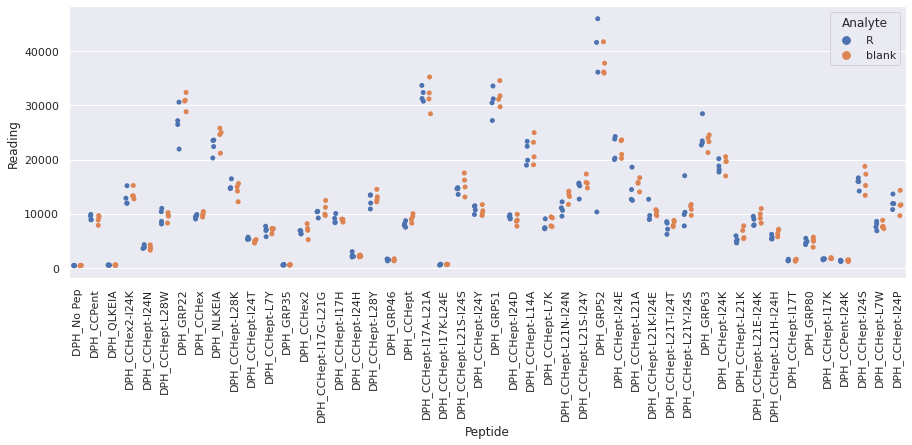

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_2.xlsx
Drawing scatter plot of data spread for S_repeat_2 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

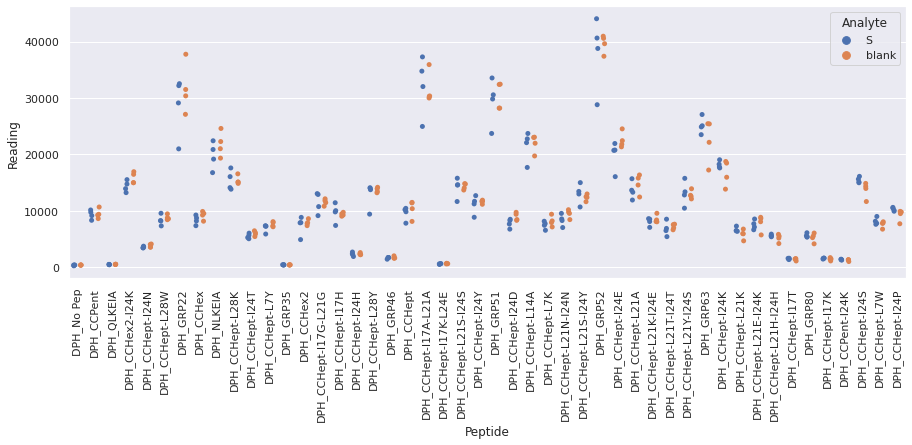

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_2.xlsx
Drawing scatter plot of data spread for V_repeat_2 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

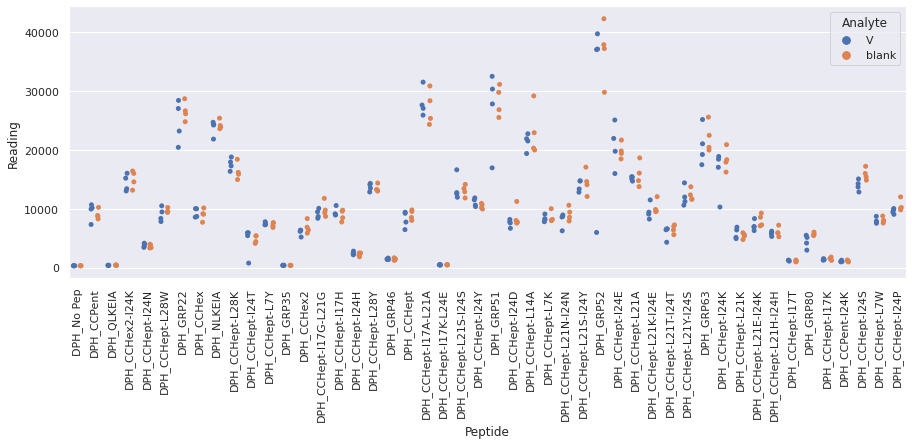

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_2.xlsx
Drawing scatter plot of data spread for W_repeat_2 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

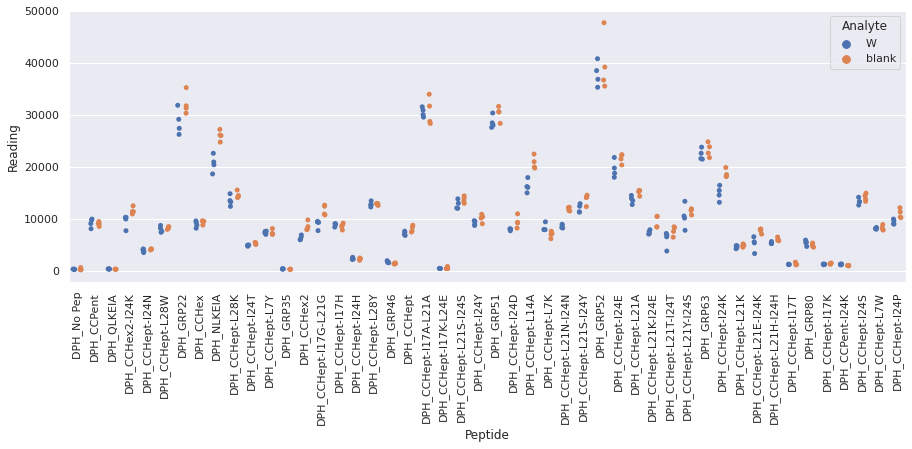

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_3.xlsx
Drawing scatter plot of data spread for E_repeat_3 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

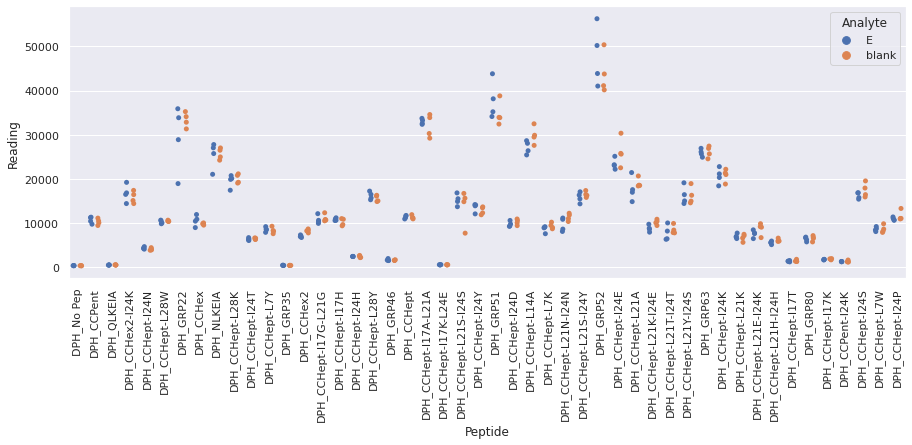

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_3.xlsx
Drawing scatter plot of data spread for R_repeat_3 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

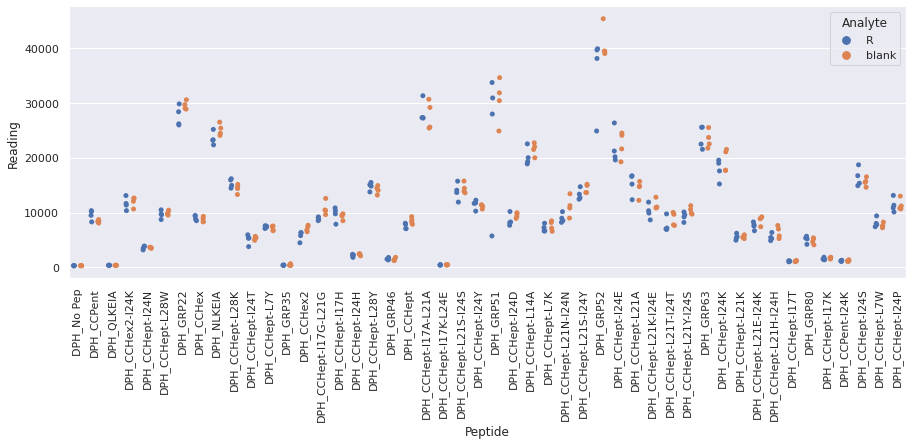

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_3.xlsx
Drawing scatter plot of data spread for S_repeat_3 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

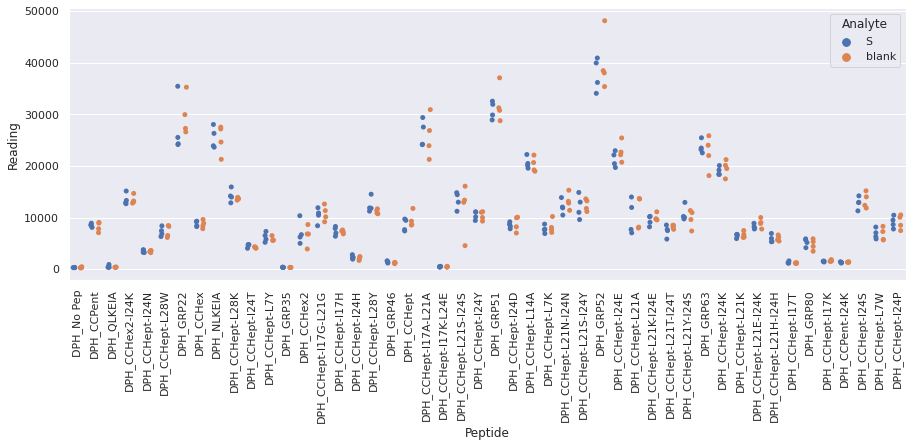

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_3.xlsx
Drawing scatter plot of data spread for V_repeat_3 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

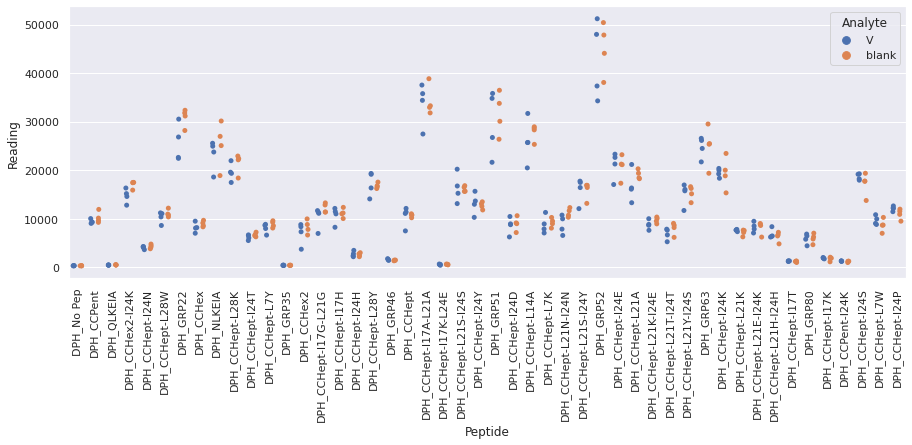

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_3.xlsx
Drawing scatter plot of data spread for W_repeat_3 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

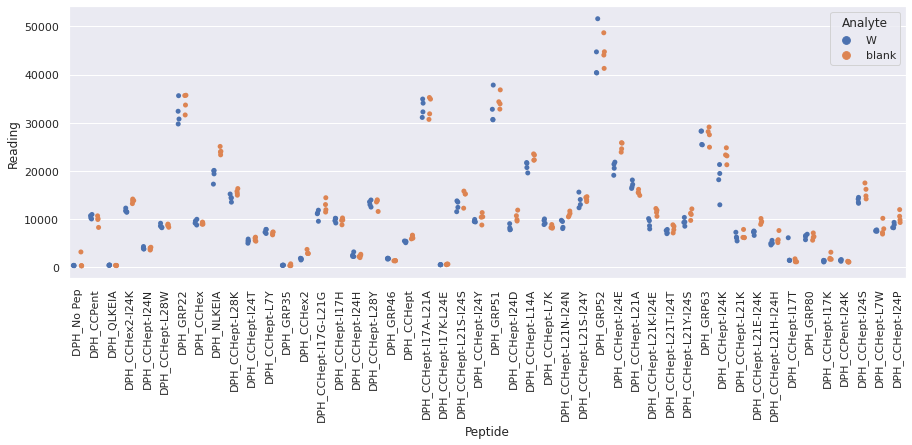

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_4.xlsx
Drawing scatter plot of data spread for E_repeat_4 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

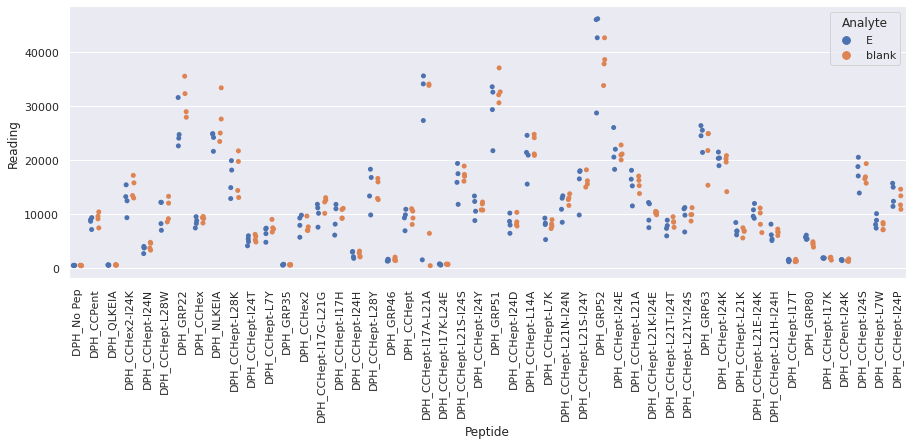

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_4.xlsx
Drawing scatter plot of data spread for R_repeat_4 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

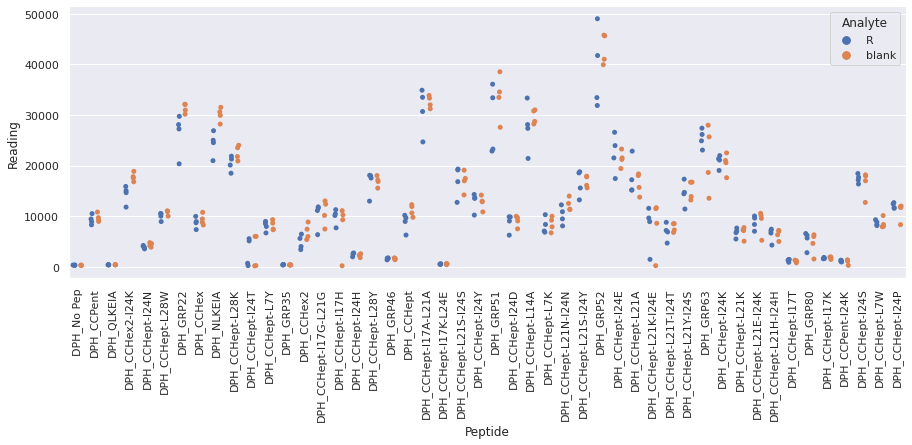

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_4.xlsx
Drawing scatter plot of data spread for S_repeat_4 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

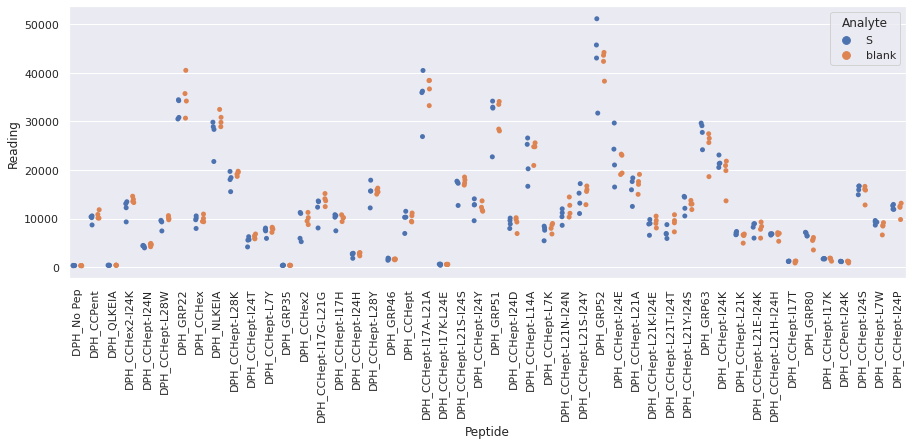

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_4.xlsx
Drawing scatter plot of data spread for V_repeat_4 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

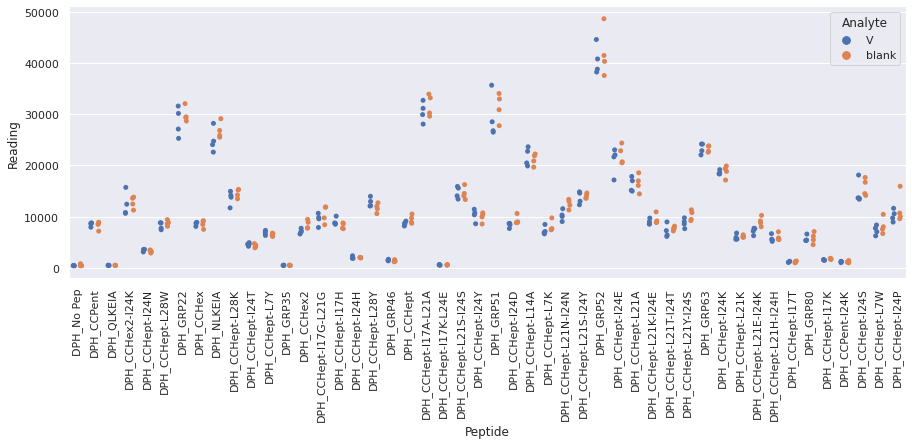

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_4.xlsx
Drawing scatter plot of data spread for W_repeat_4 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

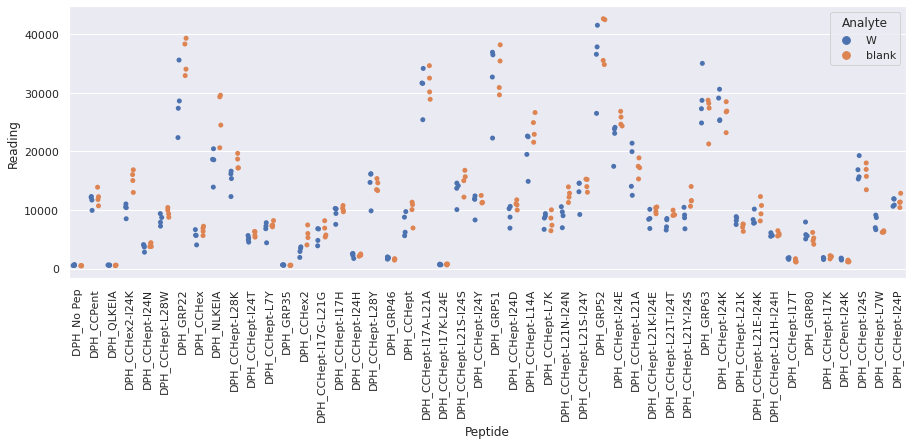

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_5.xlsx
Drawing scatter plot of data spread for E_repeat_5 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

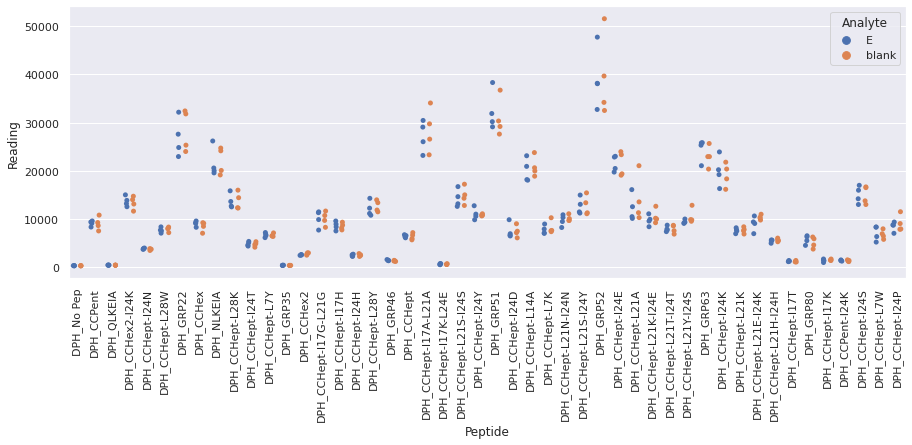

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_5.xlsx
Drawing scatter plot of data spread for R_repeat_5 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

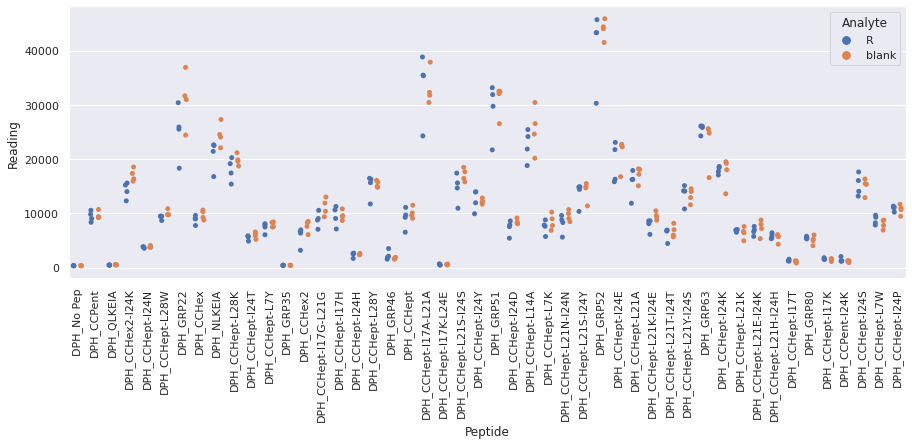

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_5.xlsx
Drawing scatter plot of data spread for S_repeat_5 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

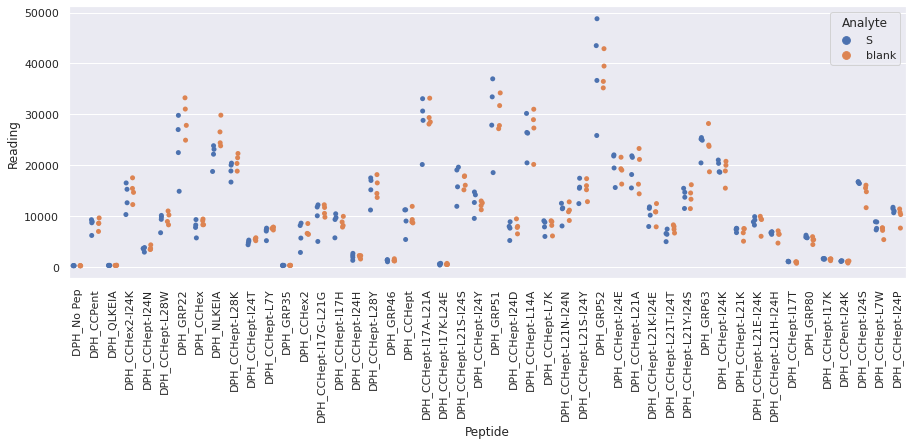

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_5.xlsx
Drawing scatter plot of data spread for V_repeat_5 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

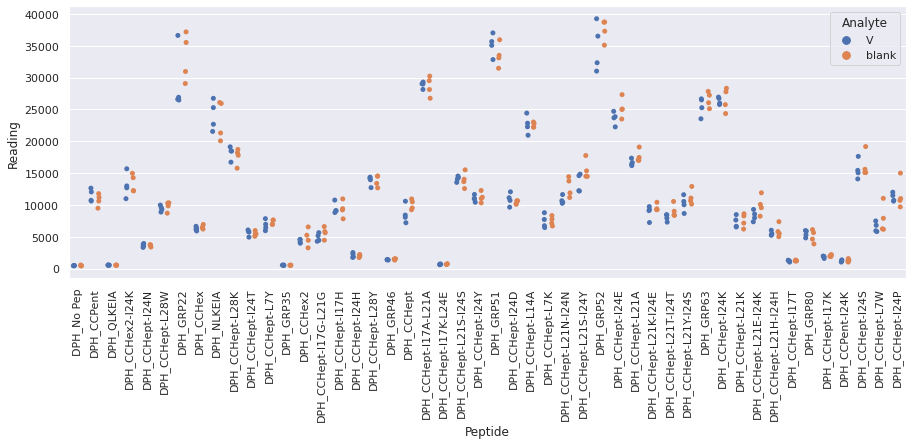

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_5.xlsx
Drawing scatter plot of data spread for W_repeat_5 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

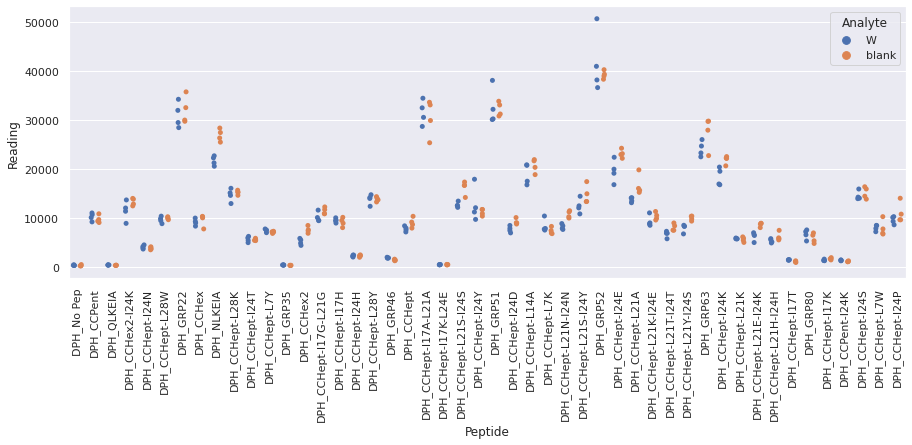

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_6.xlsx
Drawing scatter plot of data spread for E_repeat_6 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

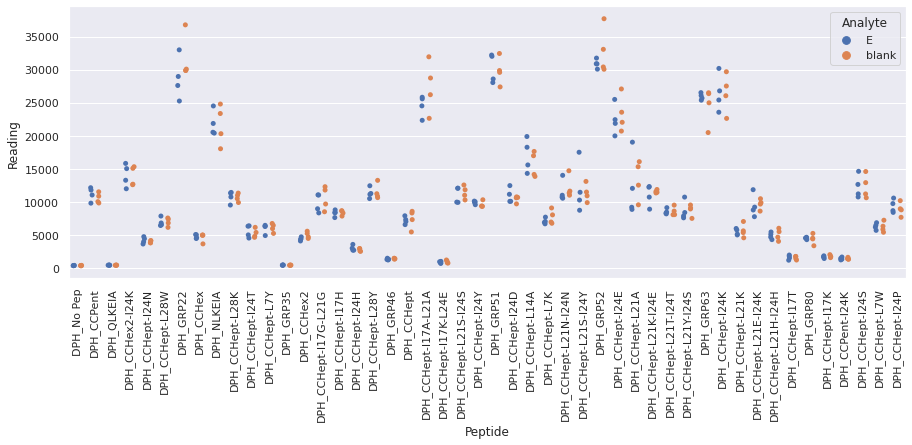

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_6.xlsx
Drawing scatter plot of data spread for R_repeat_6 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

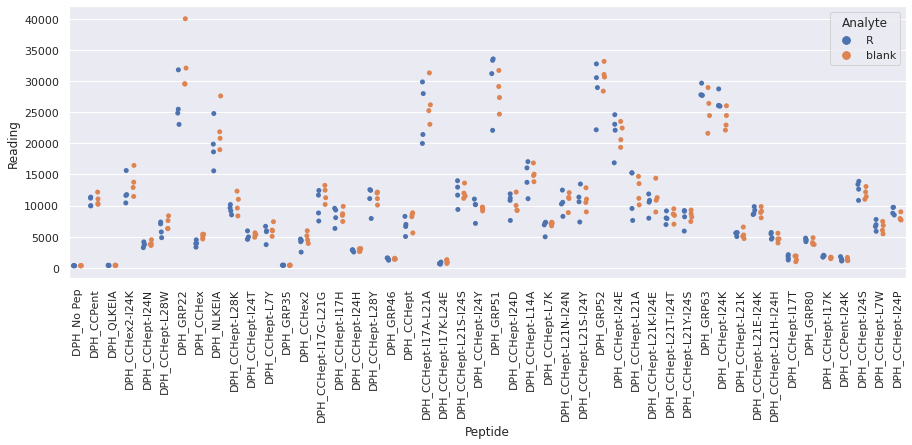

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_6.xlsx
Drawing scatter plot of data spread for S_repeat_6 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

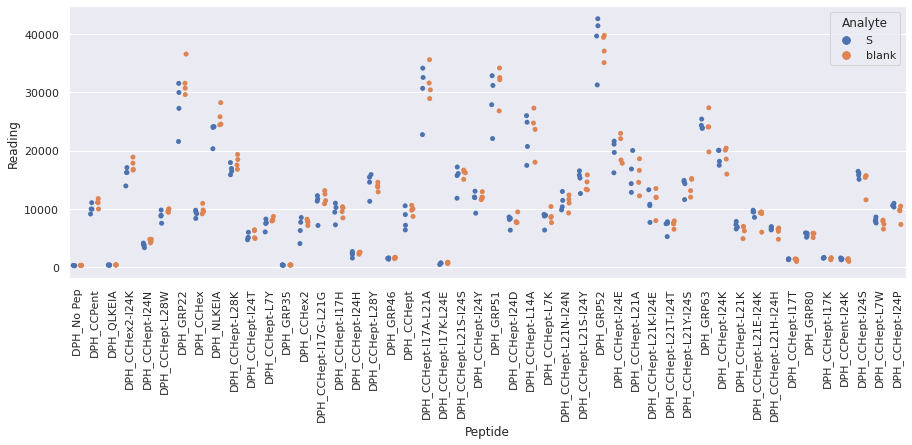

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_6.xlsx
Drawing scatter plot of data spread for V_repeat_6 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

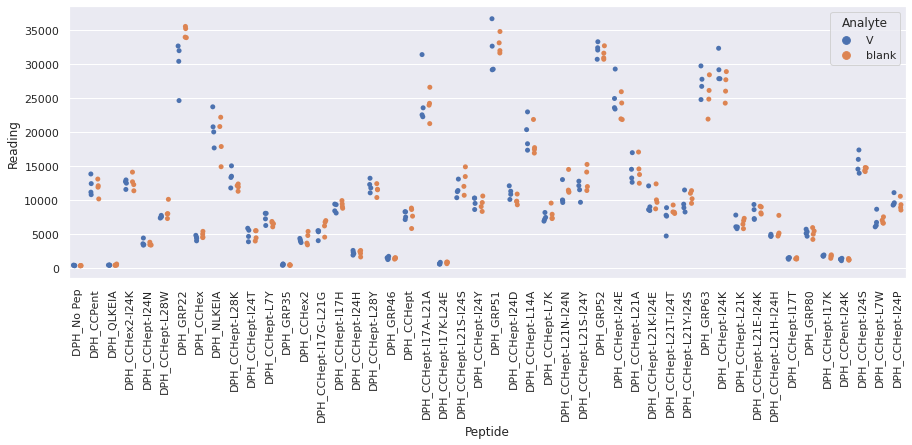

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_6.xlsx
Drawing scatter plot of data spread for W_repeat_6 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

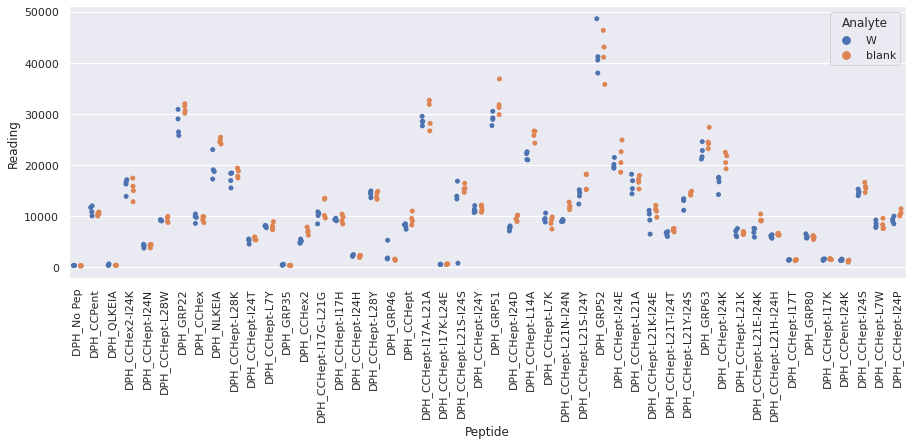

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_7.xlsx
Drawing scatter plot of data spread for E_repeat_7 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

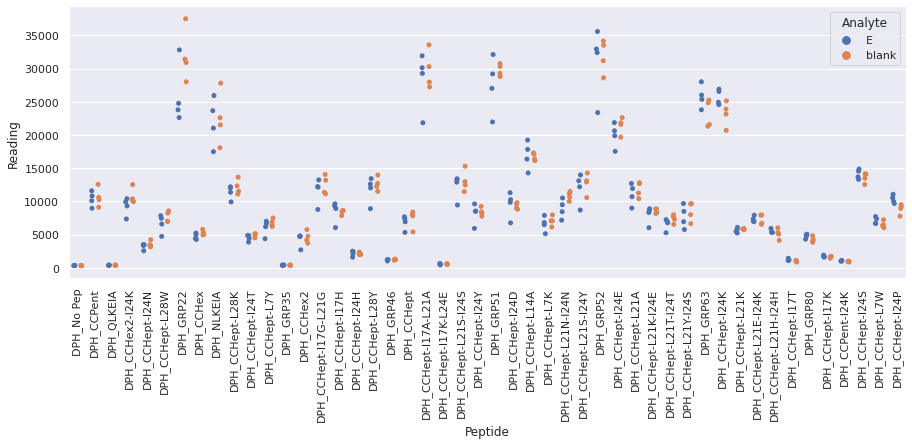

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_7.xlsx
Drawing scatter plot of data spread for R_repeat_7 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

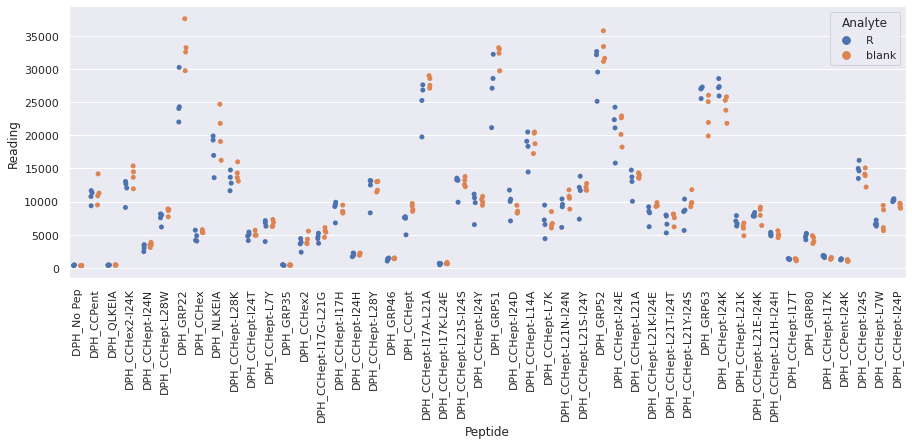

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_7.xlsx
Drawing scatter plot of data spread for S_repeat_7 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

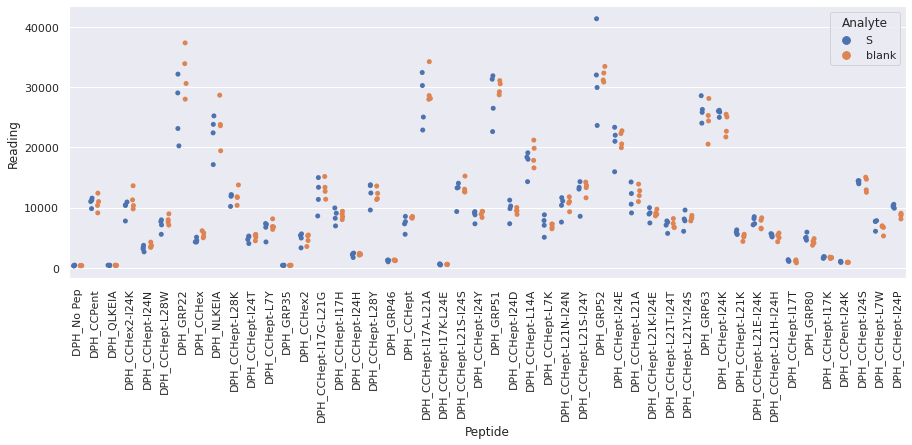

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_7.xlsx
Drawing scatter plot of data spread for V_repeat_7 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

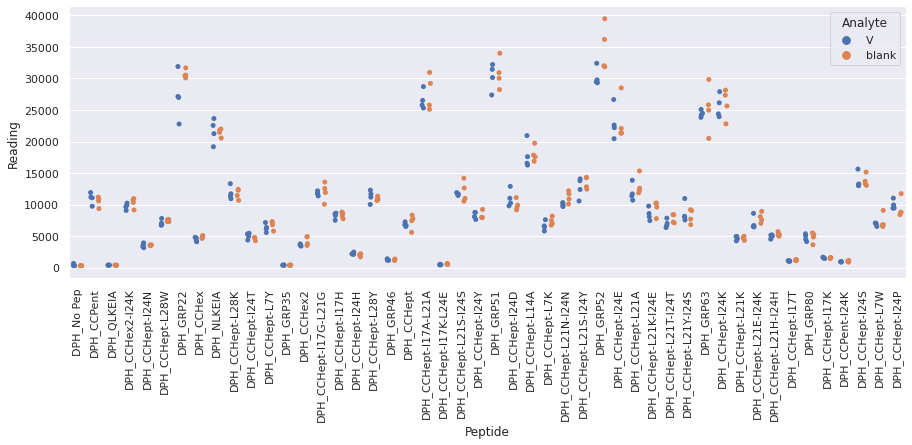

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_7.xlsx
Drawing scatter plot of data spread for W_repeat_7 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

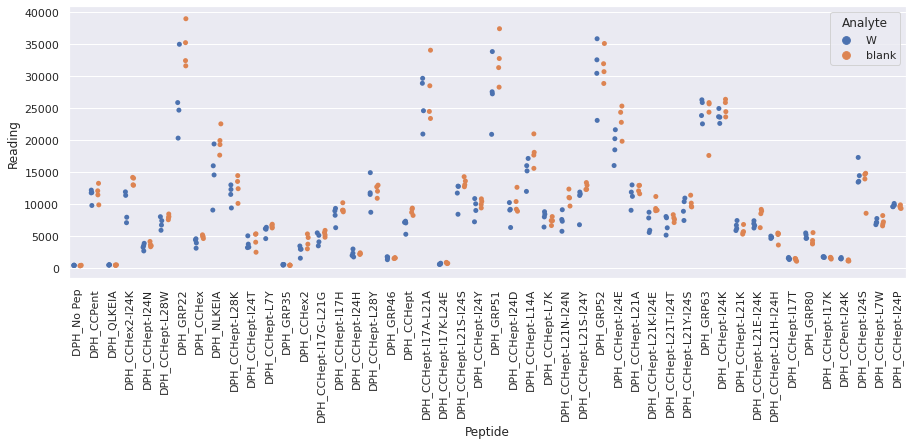

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_8.xlsx
Drawing scatter plot of data spread for E_repeat_8 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

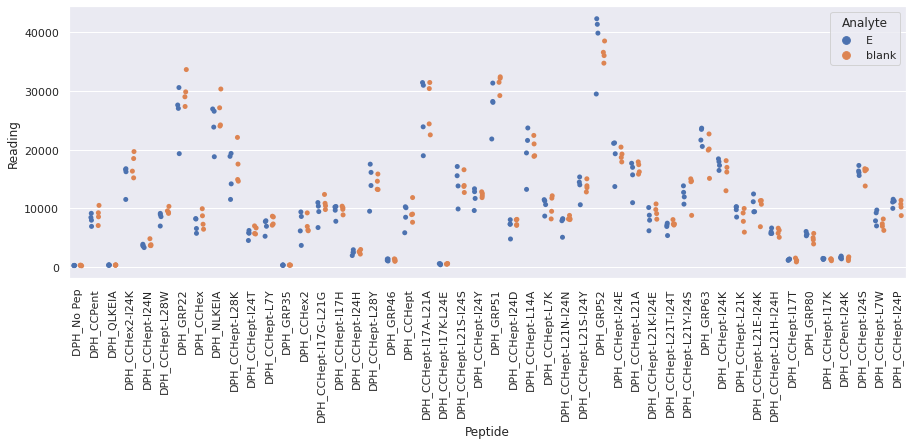

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_8.xlsx
Drawing scatter plot of data spread for R_repeat_8 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

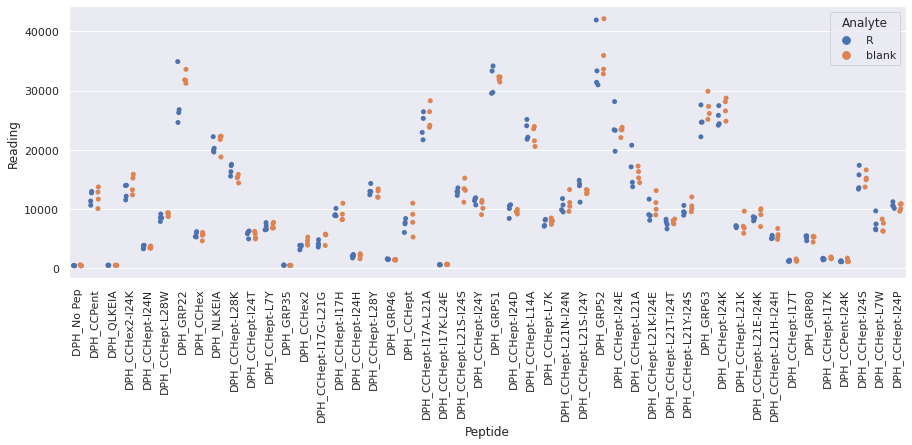

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_8.xlsx
Drawing scatter plot of data spread for S_repeat_8 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

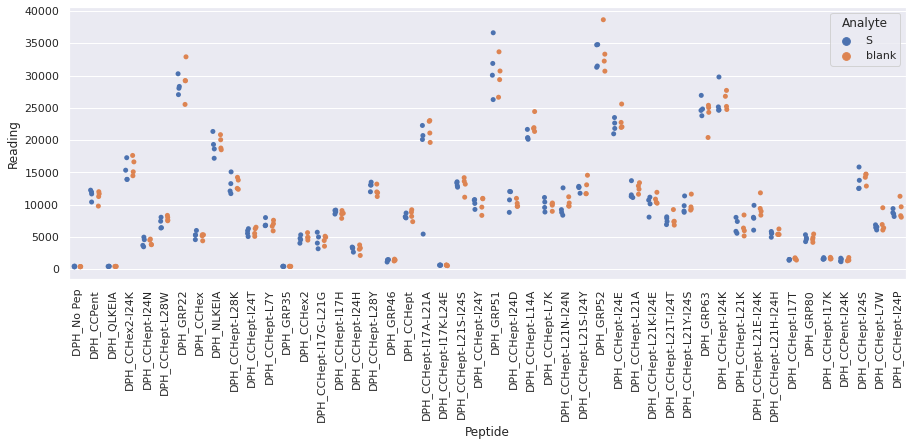

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_8.xlsx
Drawing scatter plot of data spread for V_repeat_8 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

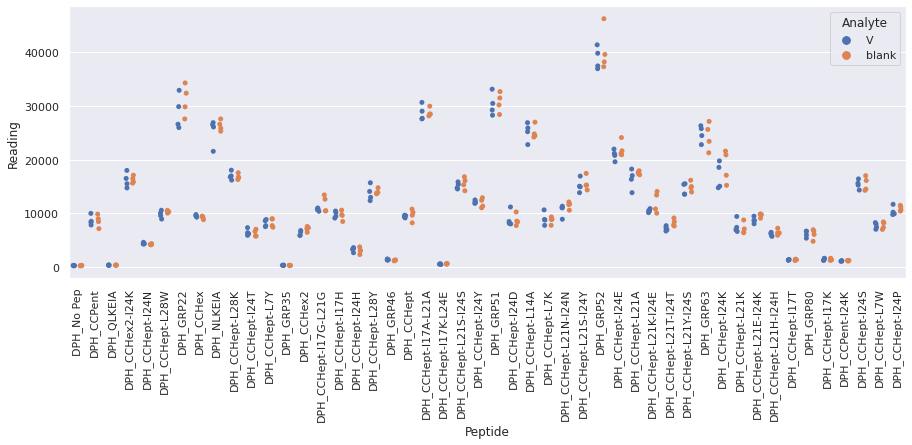

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_8.xlsx
Drawing scatter plot of data spread for W_repeat_8 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

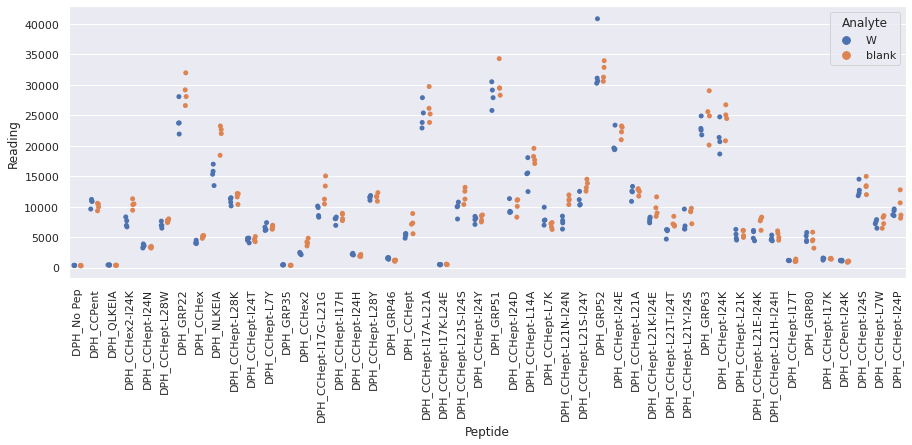

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_9.xlsx
Drawing scatter plot of data spread for E_repeat_9 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

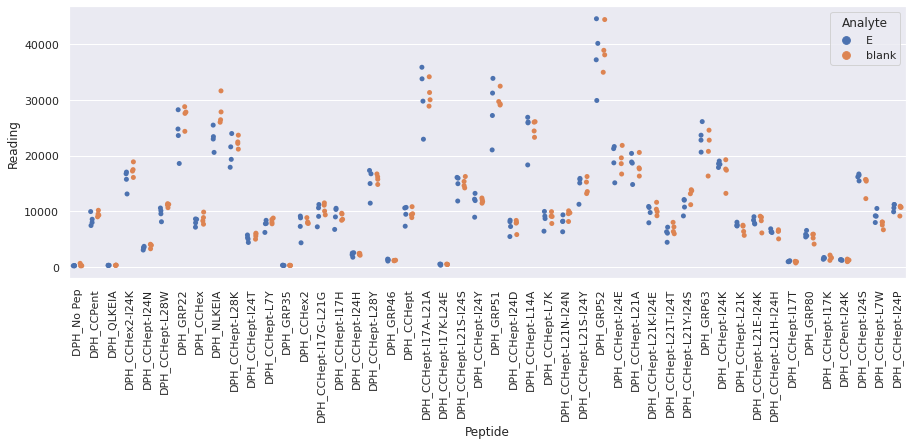

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_9.xlsx
Drawing scatter plot of data spread for R_repeat_9 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

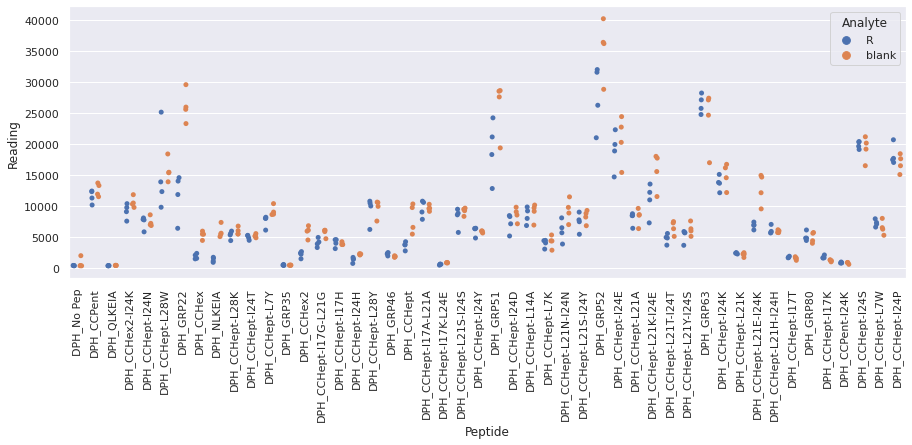

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_9.xlsx
Drawing scatter plot of data spread for S_repeat_9 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

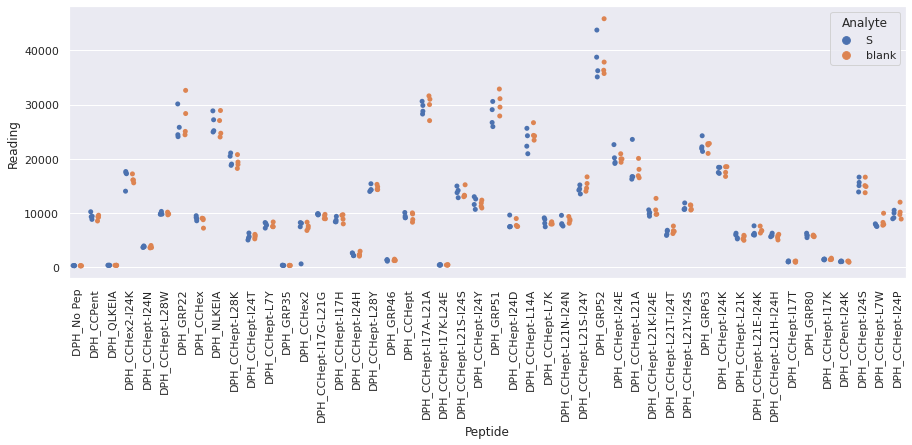

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_9.xlsx
Drawing scatter plot of data spread for V_repeat_9 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

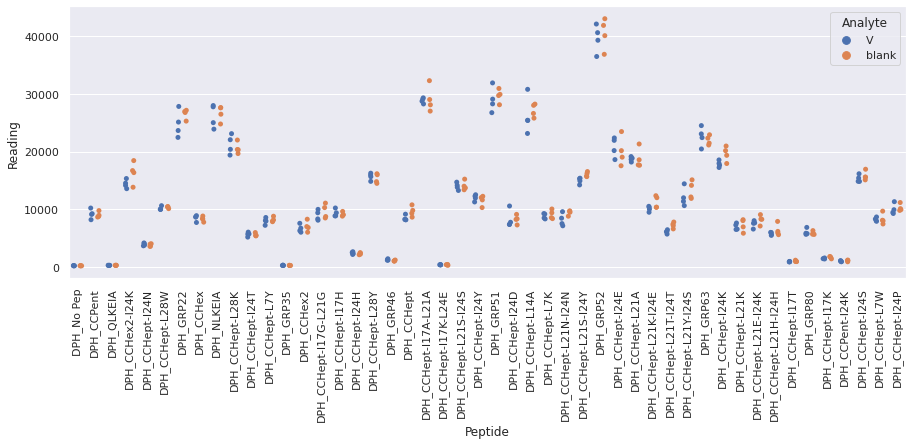

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_9.xlsx
Drawing scatter plot of data spread for W_repeat_9 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

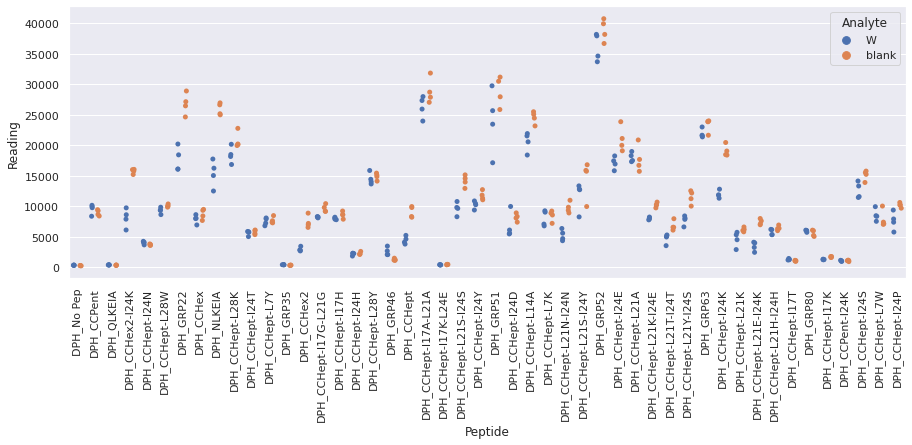

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/E_repeat_10.xlsx
Drawing scatter plot of data spread for E_repeat_10 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

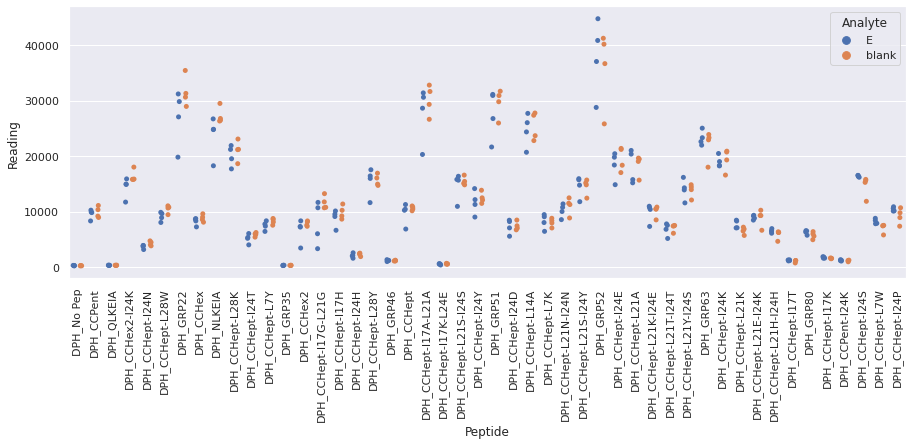

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_10.xlsx
Drawing scatter plot of data spread for R_repeat_10 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

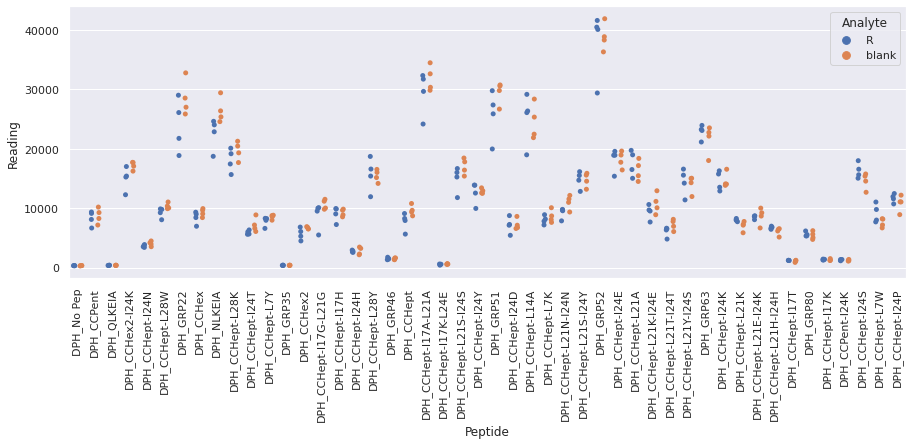

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/S_repeat_10.xlsx
Drawing scatter plot of data spread for S_repeat_10 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

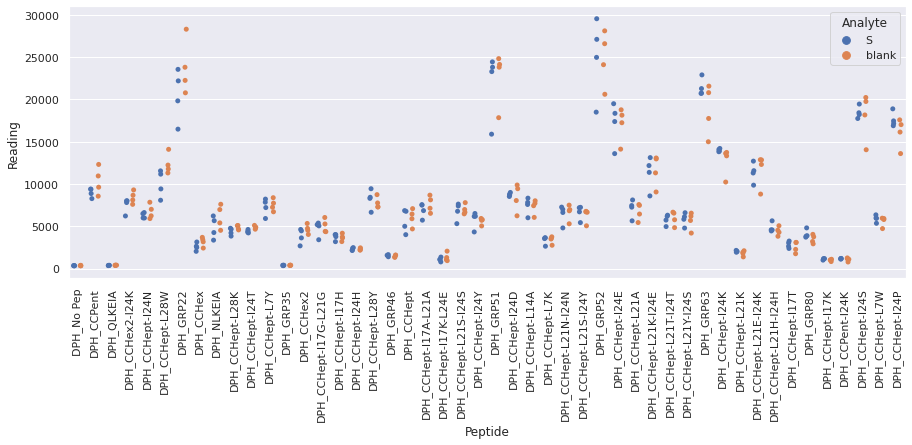

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/V_repeat_10.xlsx
Drawing scatter plot of data spread for V_repeat_10 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

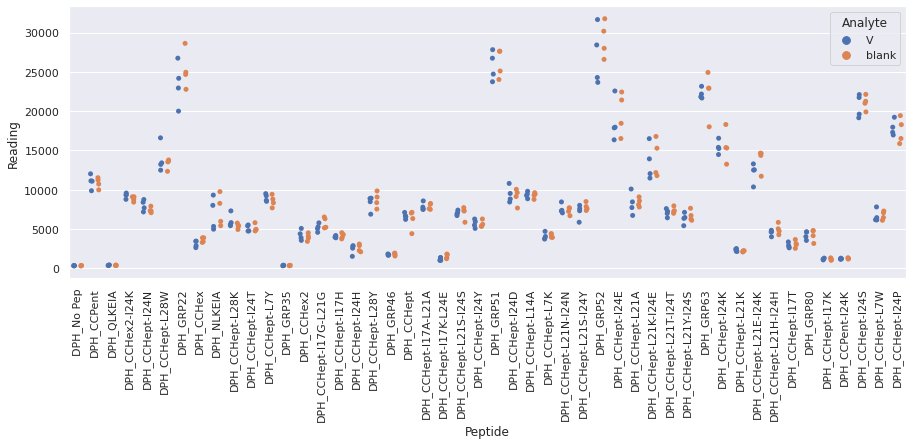

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/W_repeat_10.xlsx
Drawing scatter plot of data spread for W_repeat_10 in AA_unscaled_data


<Figure size 720x720 with 0 Axes>

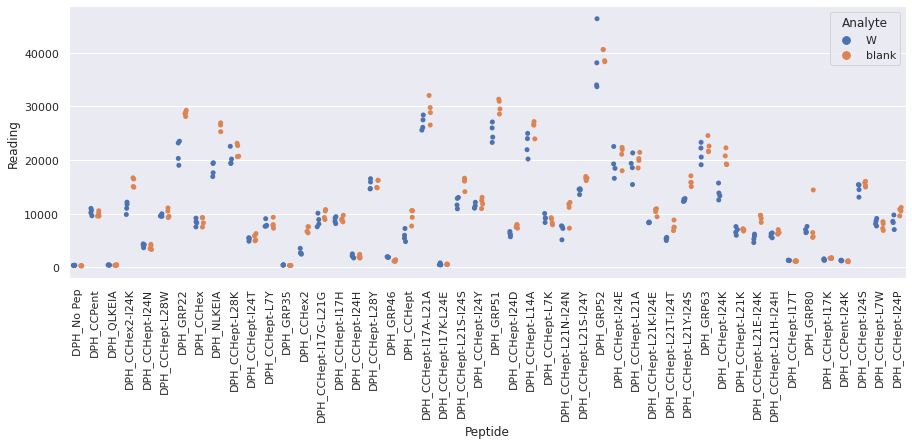

Drawing scatter plot of data spread for E_repeat_1 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

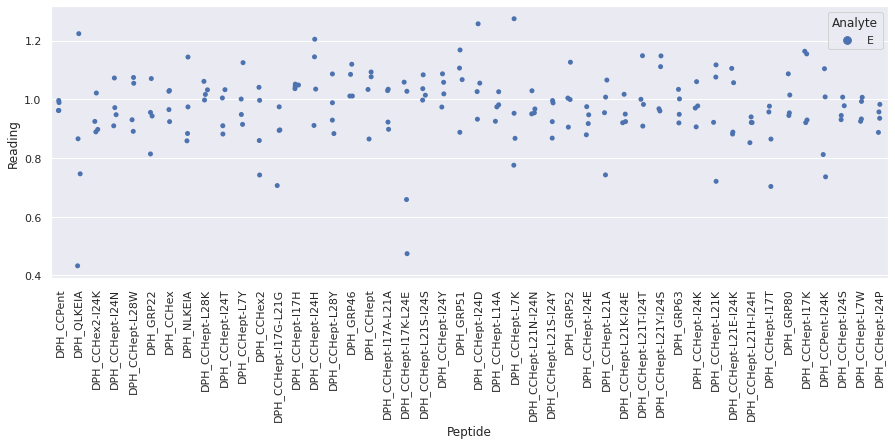

Drawing scatter plot of data spread for R_repeat_1 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

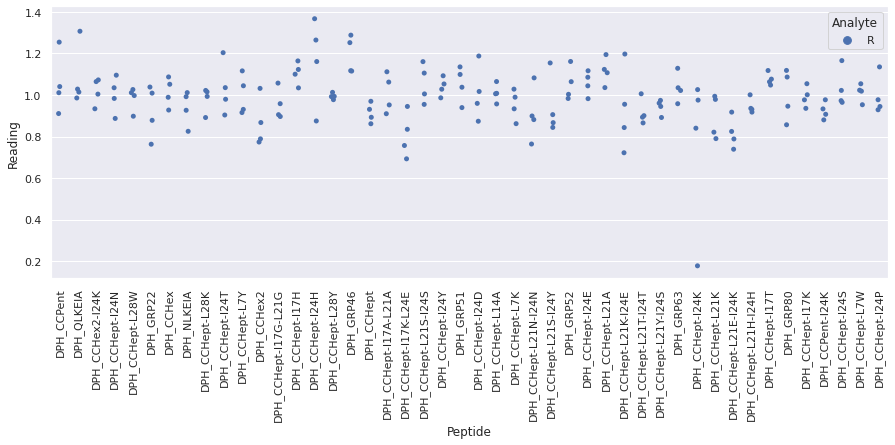

Drawing scatter plot of data spread for S_repeat_1 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

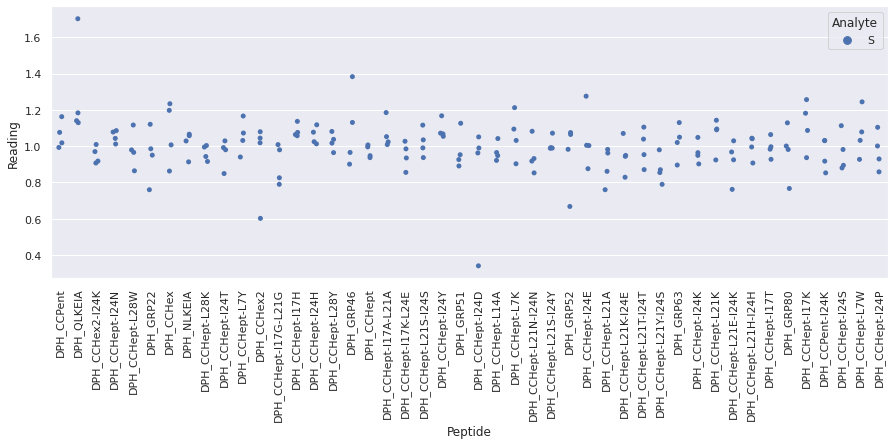

Drawing scatter plot of data spread for V_repeat_1 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

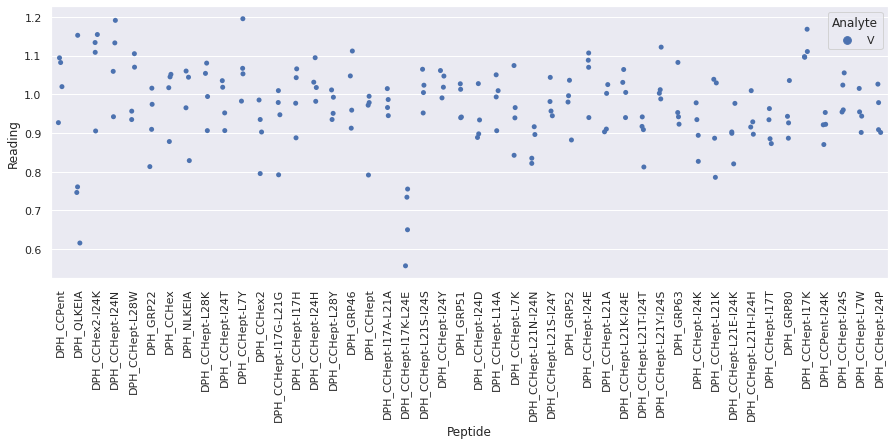

Drawing scatter plot of data spread for W_repeat_1 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

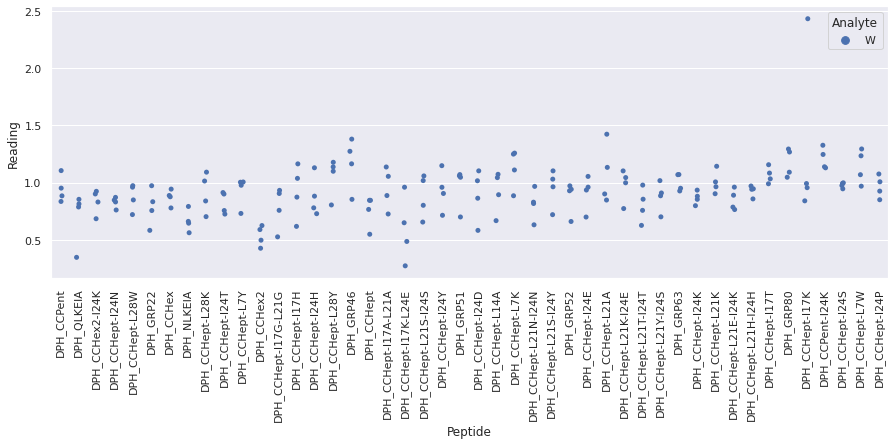

Drawing scatter plot of data spread for E_repeat_2 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

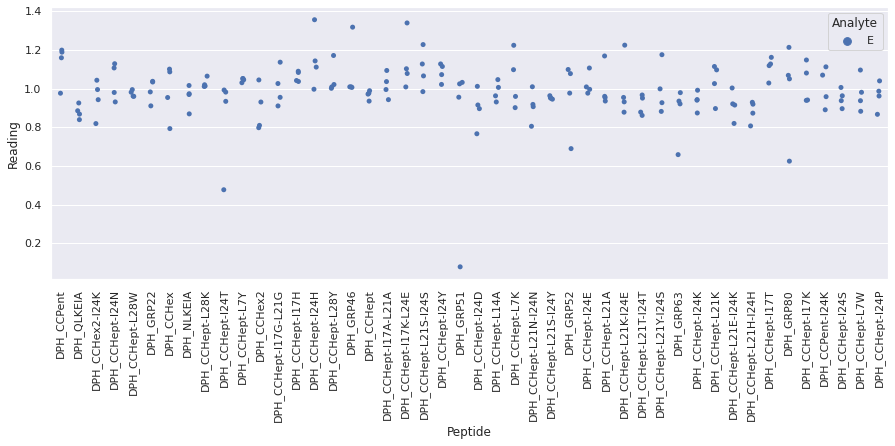

Drawing scatter plot of data spread for R_repeat_2 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

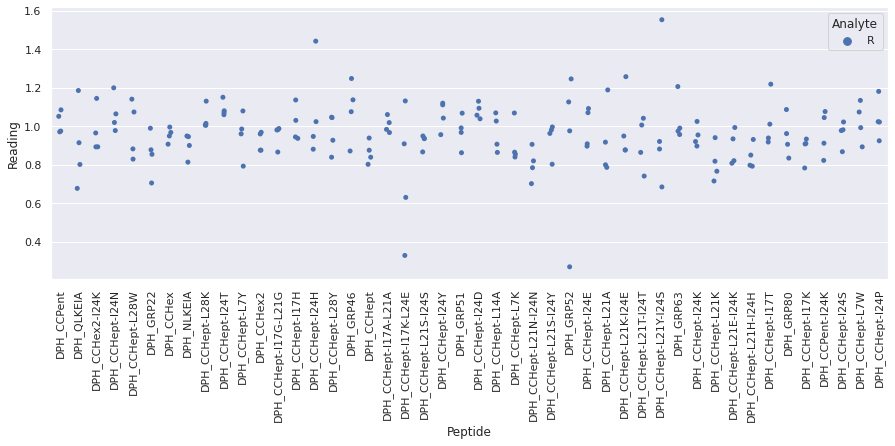

Drawing scatter plot of data spread for S_repeat_2 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

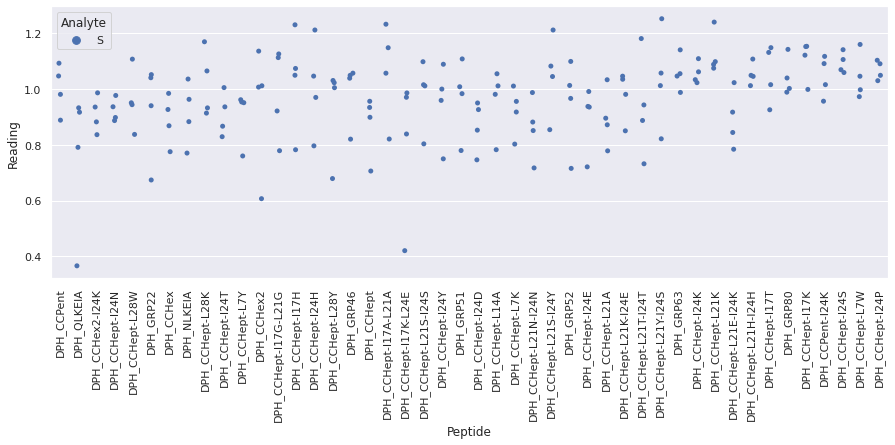

Drawing scatter plot of data spread for V_repeat_2 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

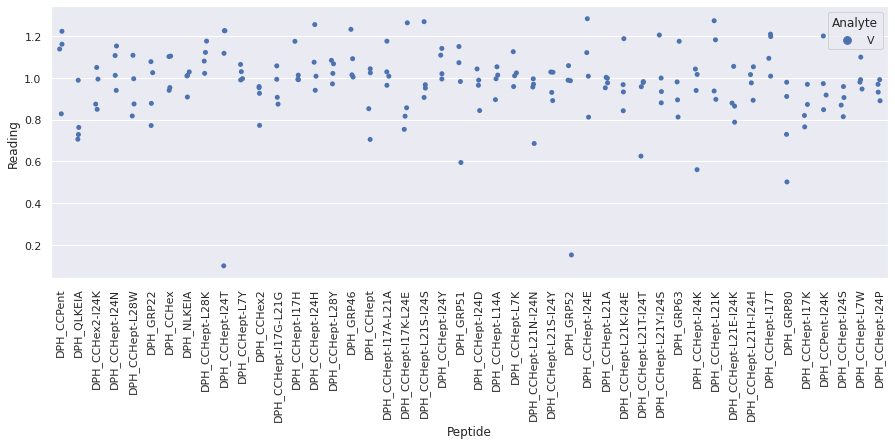

Drawing scatter plot of data spread for W_repeat_2 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

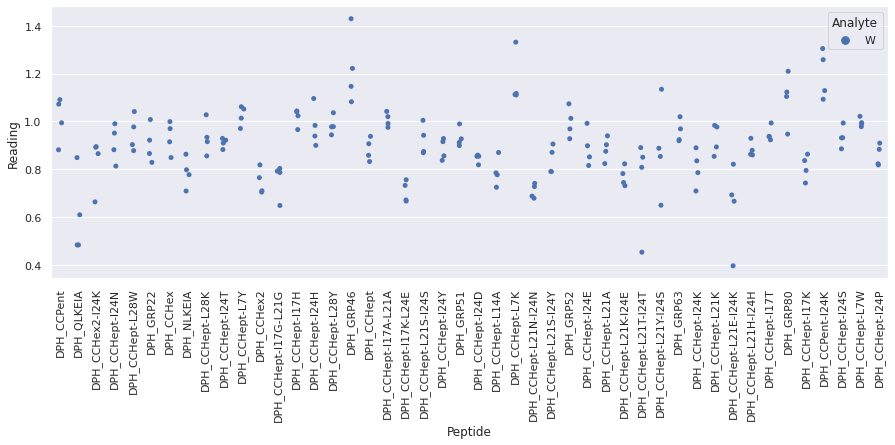

Drawing scatter plot of data spread for E_repeat_3 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

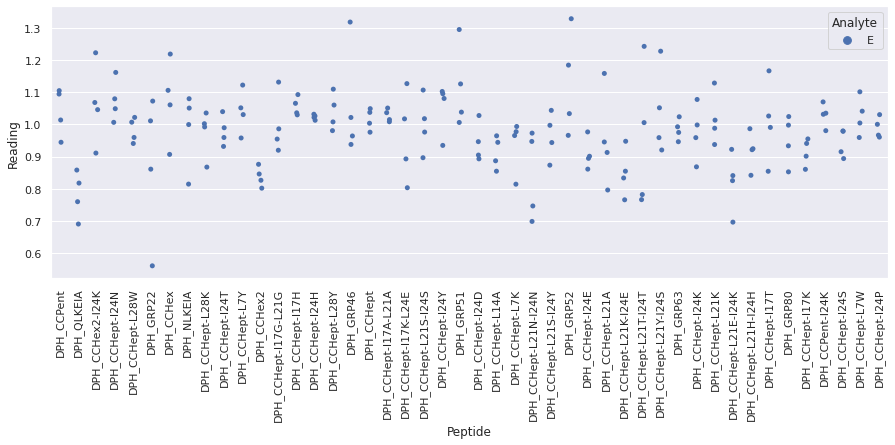

Drawing scatter plot of data spread for R_repeat_3 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

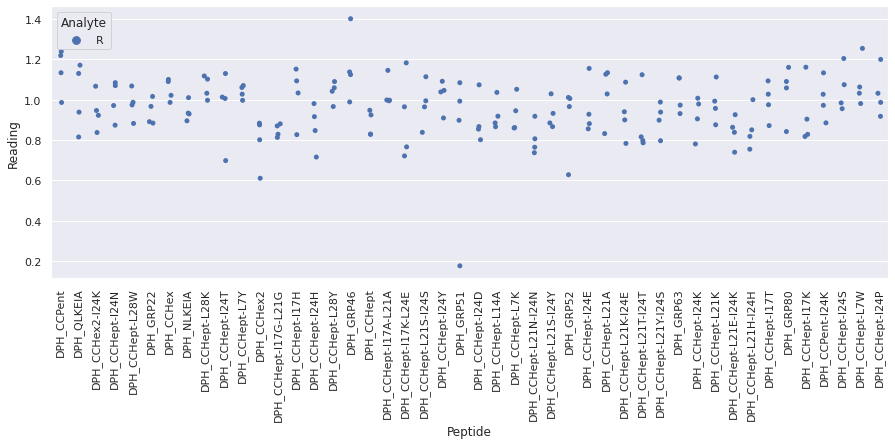

Drawing scatter plot of data spread for S_repeat_3 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

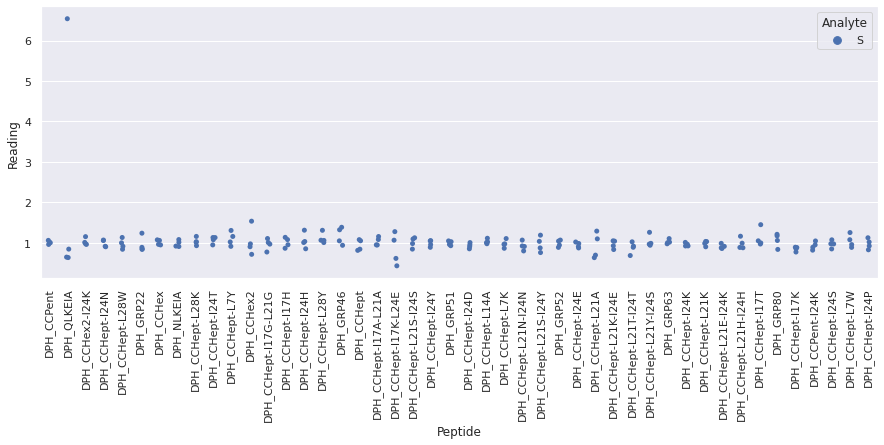

Drawing scatter plot of data spread for V_repeat_3 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

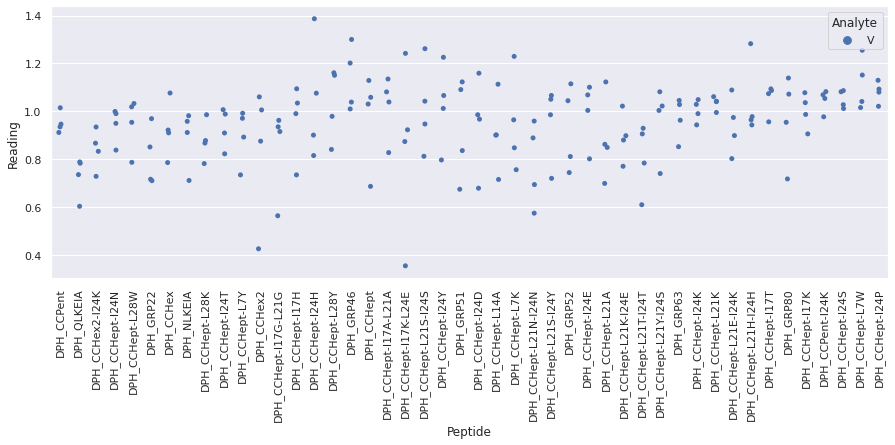

Drawing scatter plot of data spread for W_repeat_3 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

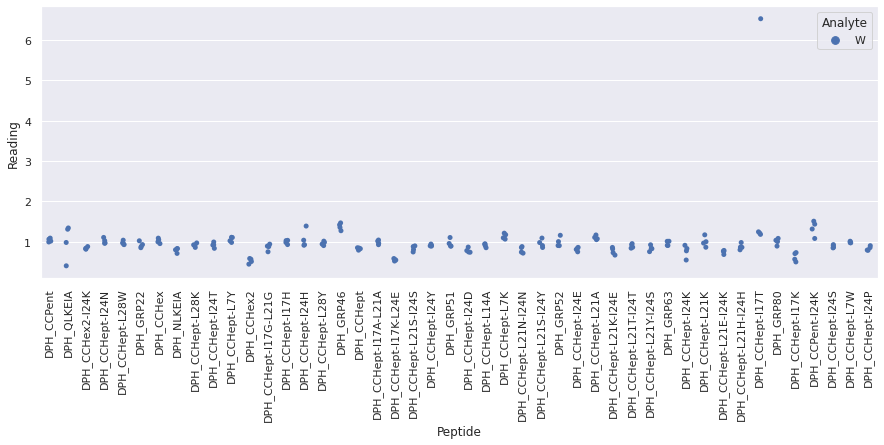

Drawing scatter plot of data spread for E_repeat_4 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

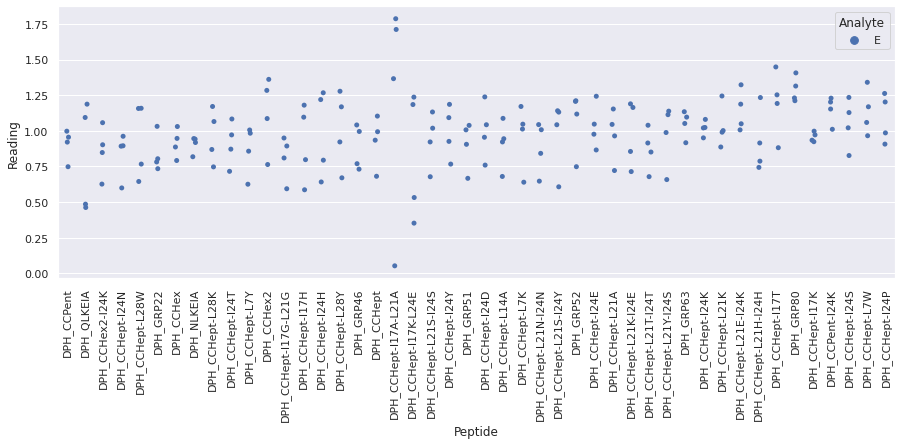

Drawing scatter plot of data spread for R_repeat_4 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

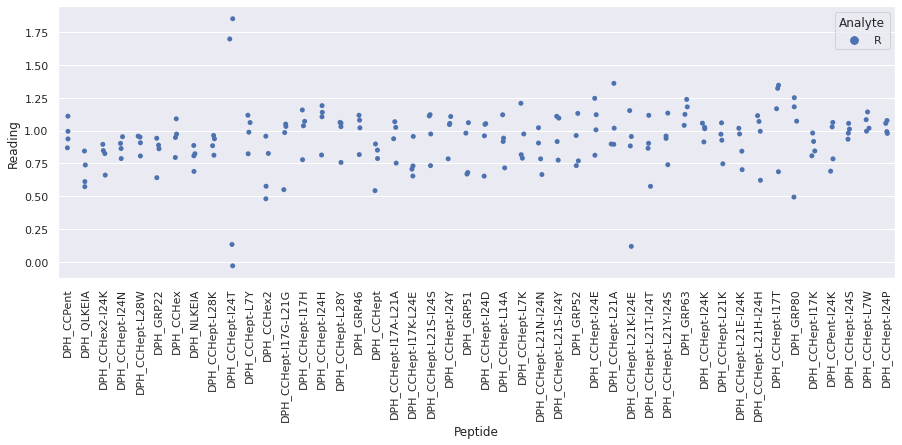

Drawing scatter plot of data spread for S_repeat_4 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

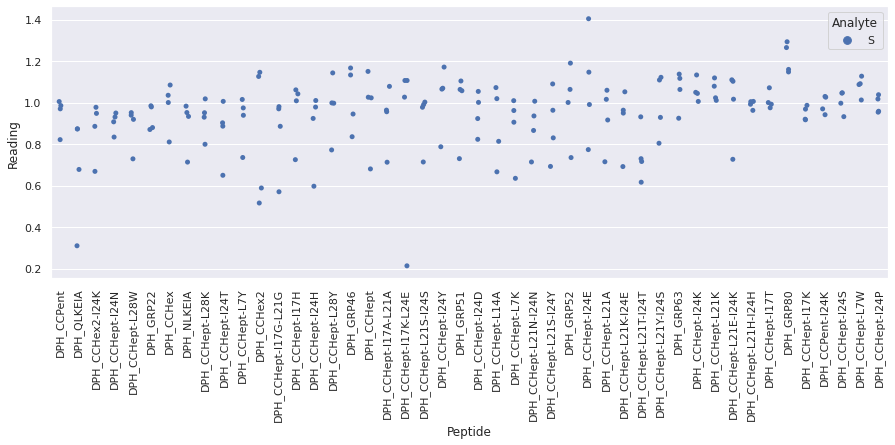

Drawing scatter plot of data spread for V_repeat_4 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

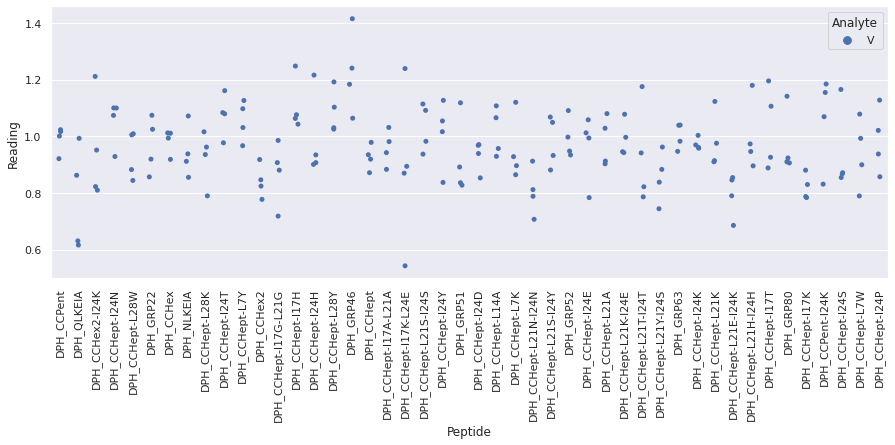

Drawing scatter plot of data spread for W_repeat_4 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

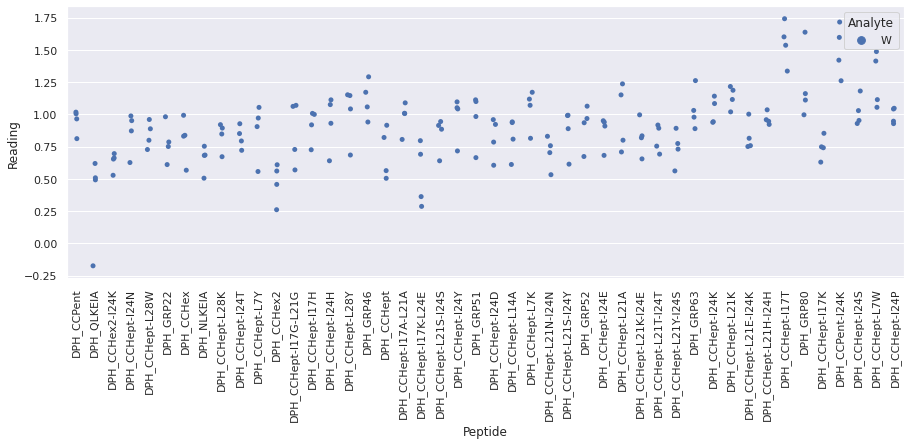

Drawing scatter plot of data spread for E_repeat_5 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

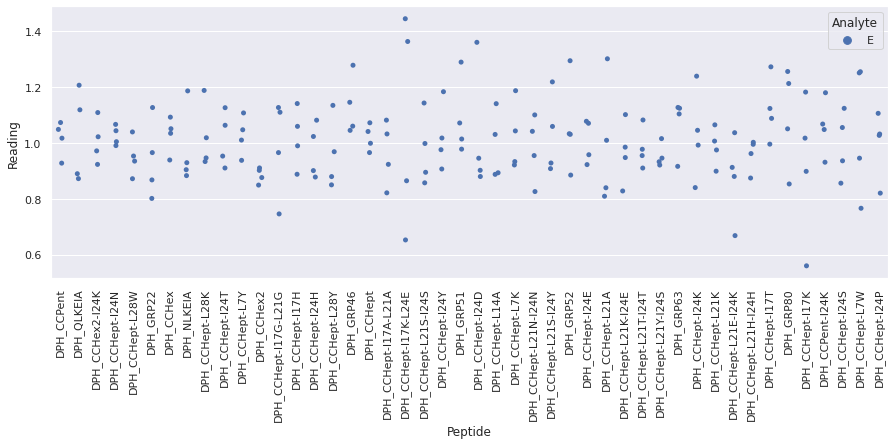

Drawing scatter plot of data spread for R_repeat_5 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

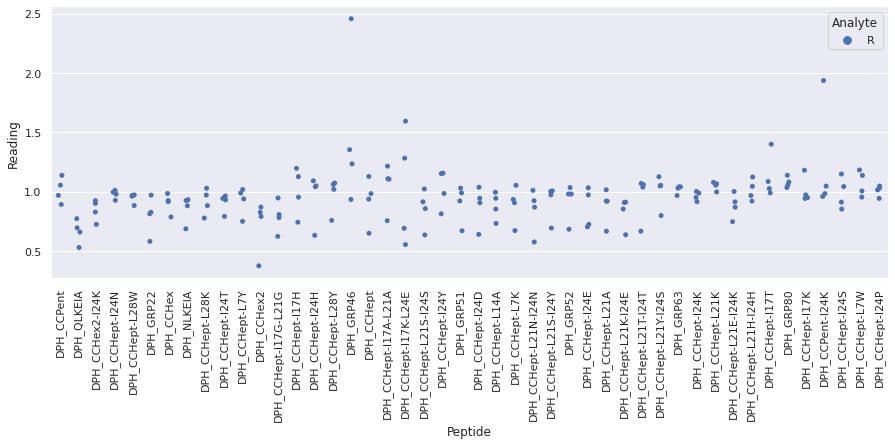

Drawing scatter plot of data spread for S_repeat_5 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

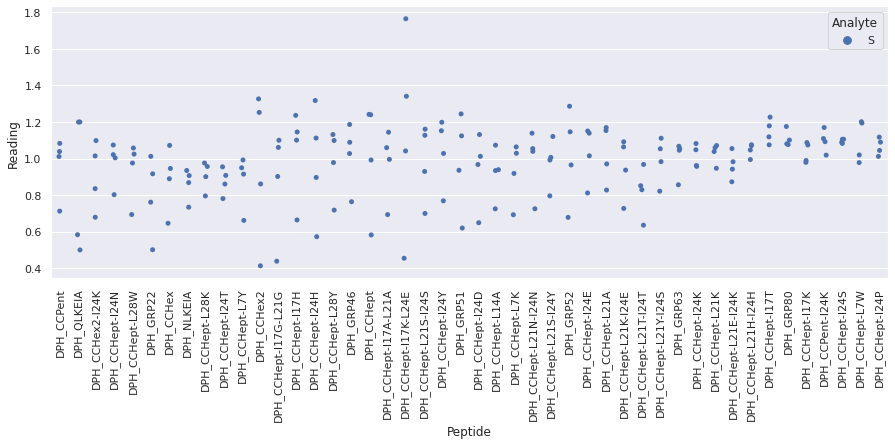

Drawing scatter plot of data spread for V_repeat_5 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

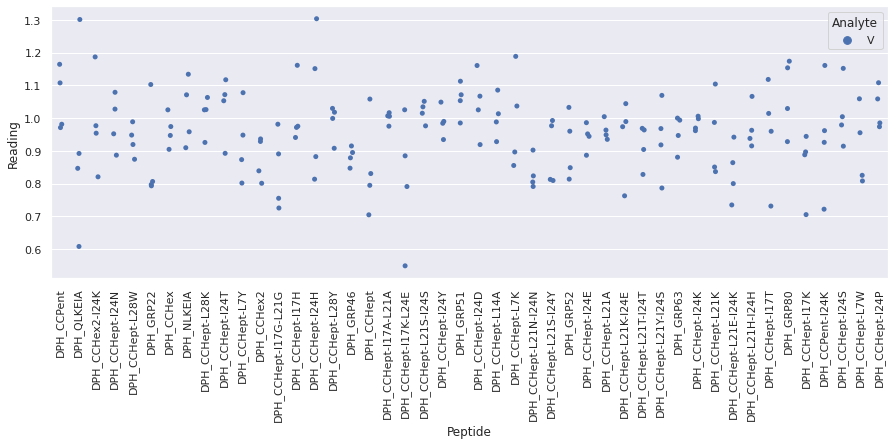

Drawing scatter plot of data spread for W_repeat_5 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

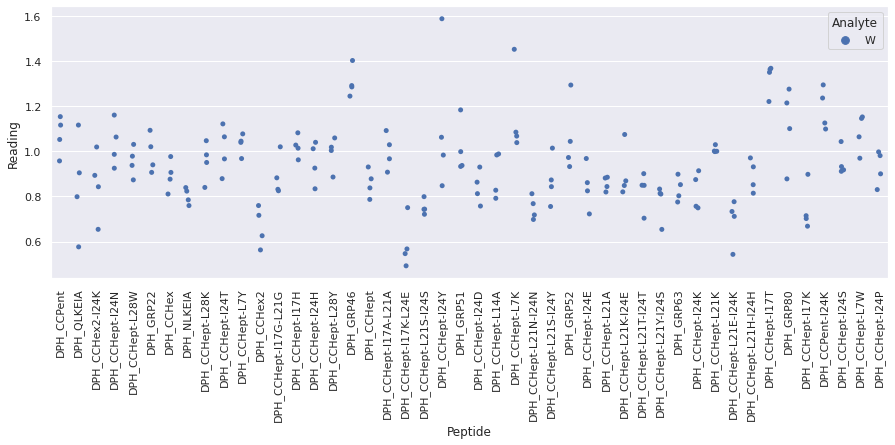

Drawing scatter plot of data spread for E_repeat_6 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

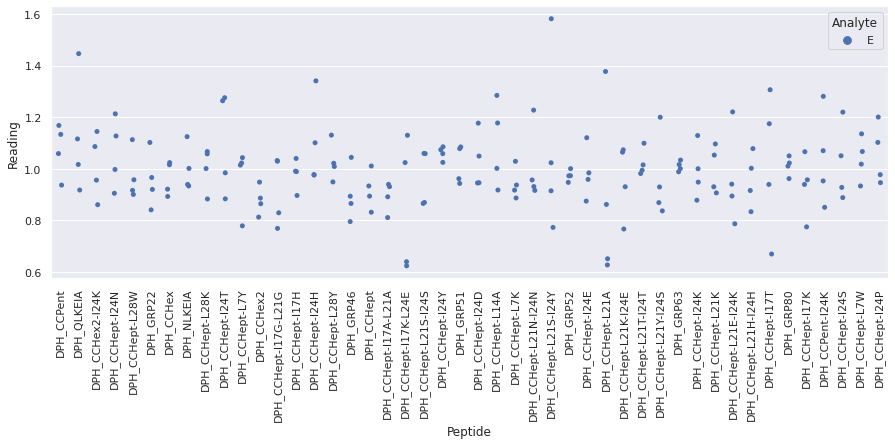

Drawing scatter plot of data spread for R_repeat_6 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

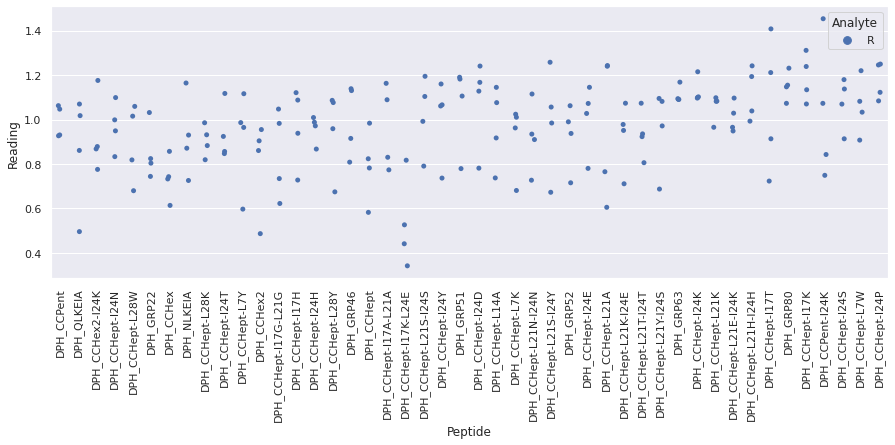

Drawing scatter plot of data spread for S_repeat_6 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

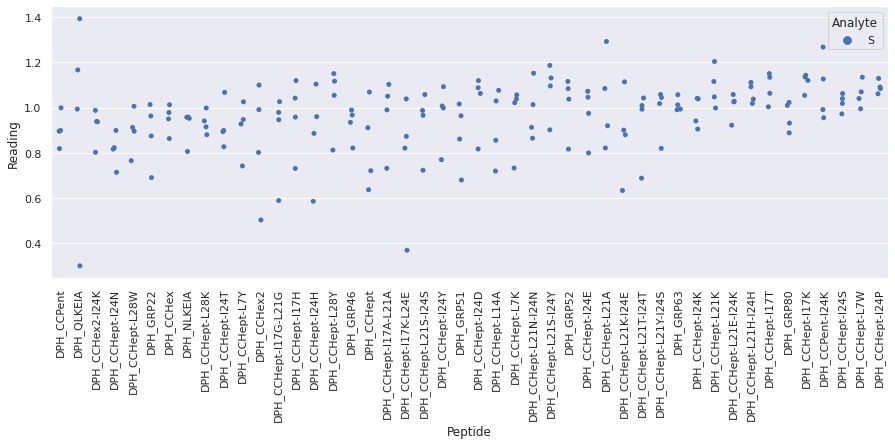

Drawing scatter plot of data spread for V_repeat_6 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

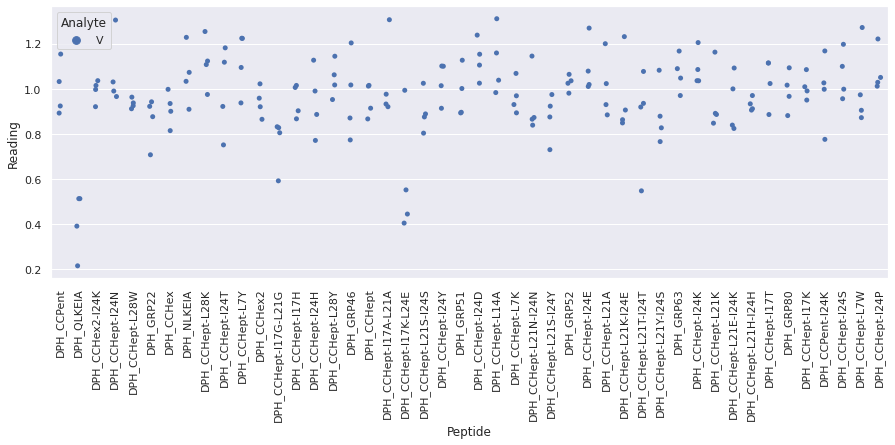

Drawing scatter plot of data spread for W_repeat_6 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

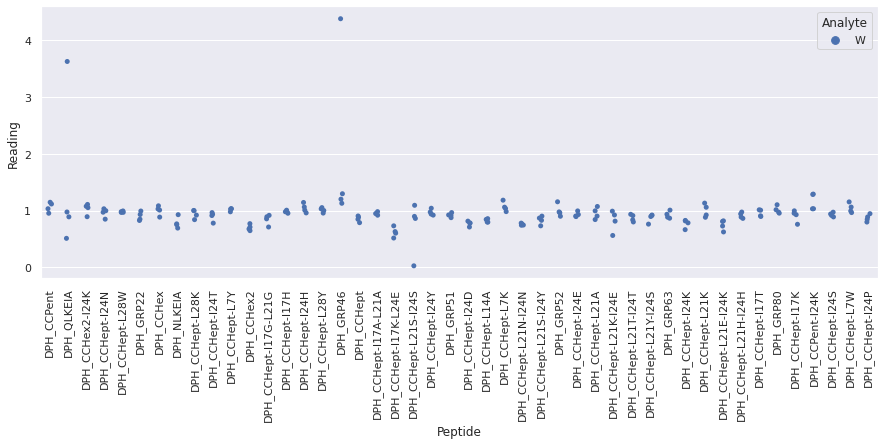

Drawing scatter plot of data spread for E_repeat_7 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

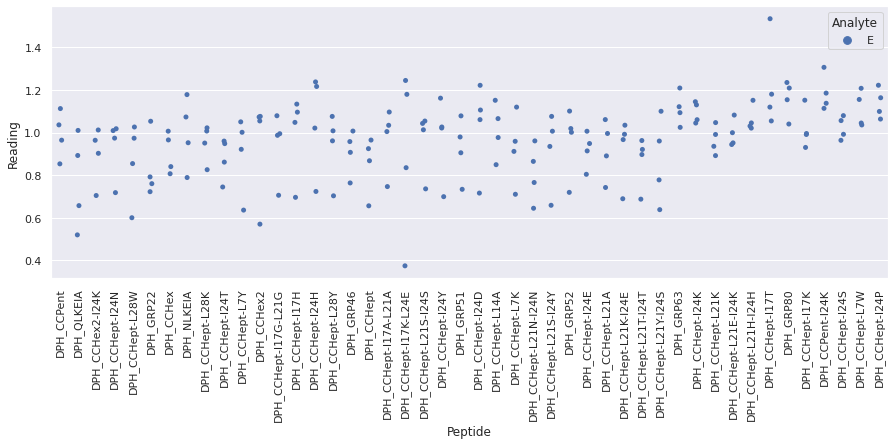

Drawing scatter plot of data spread for R_repeat_7 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

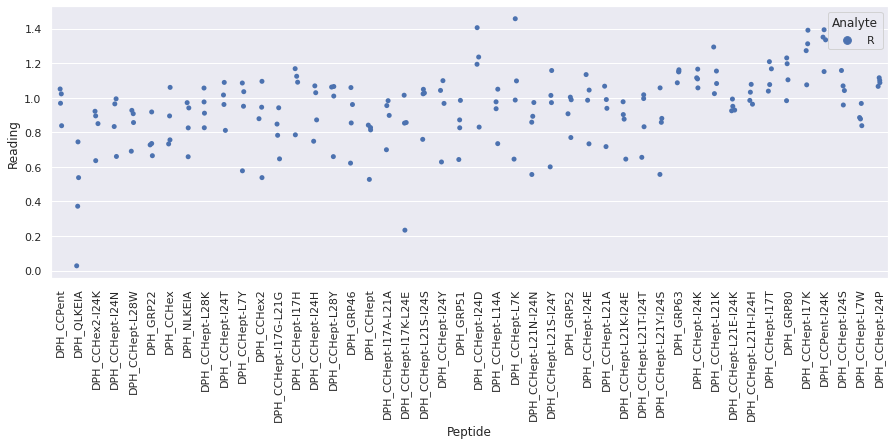

Drawing scatter plot of data spread for S_repeat_7 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

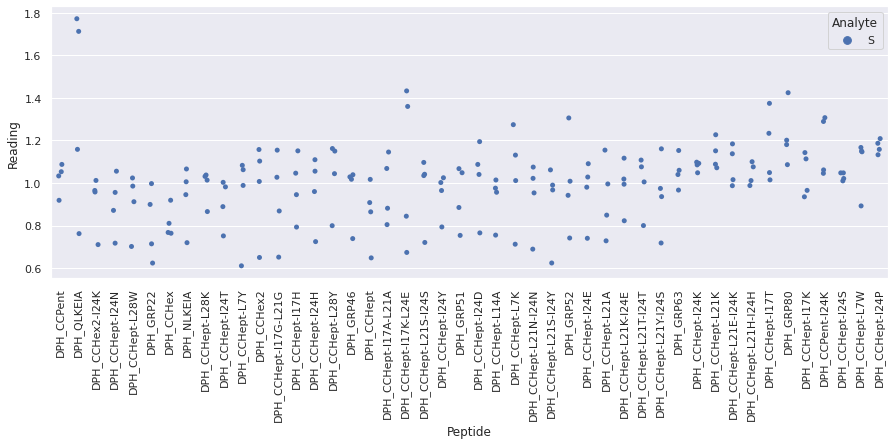

Drawing scatter plot of data spread for V_repeat_7 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

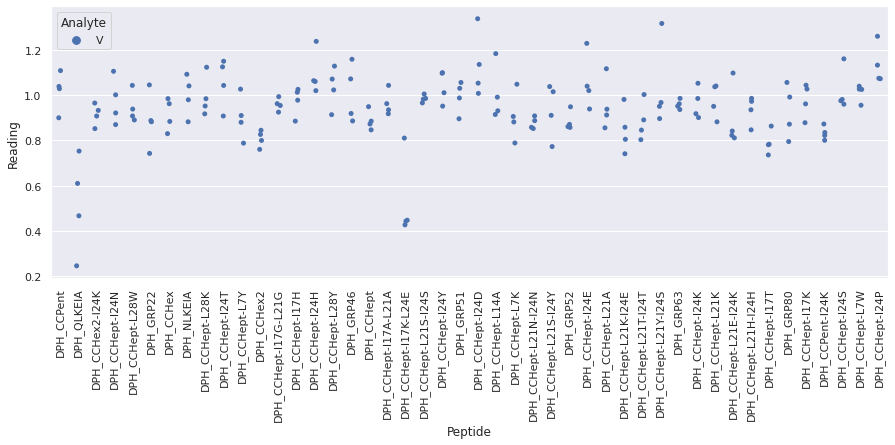

Drawing scatter plot of data spread for W_repeat_7 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

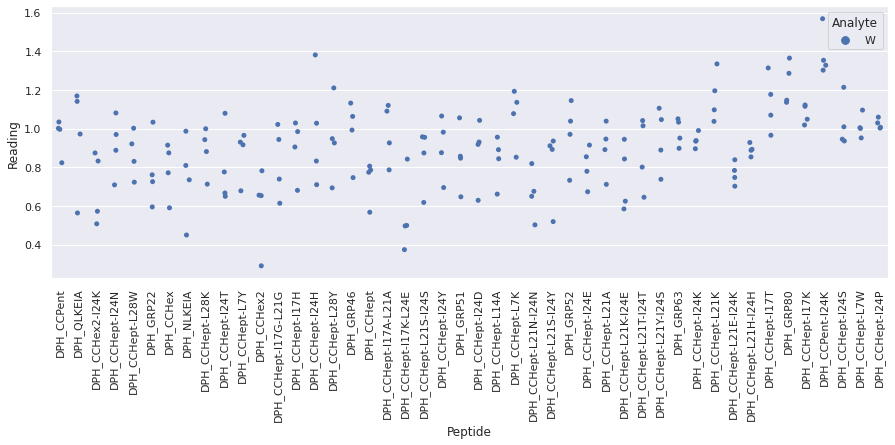

Drawing scatter plot of data spread for E_repeat_8 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

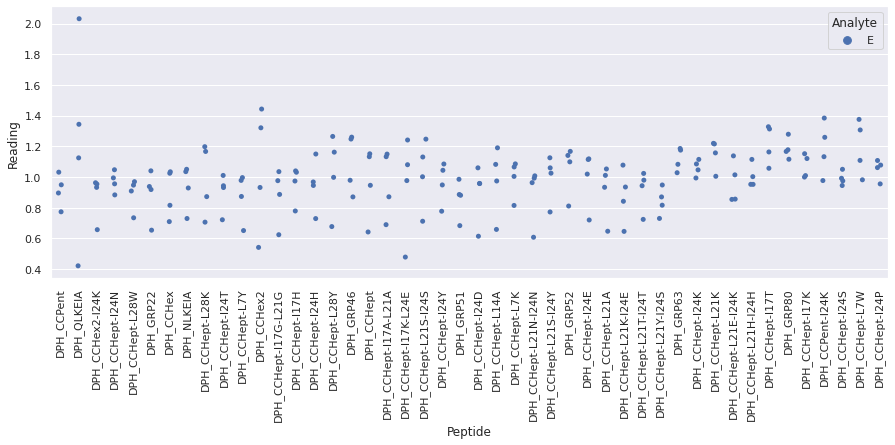

Drawing scatter plot of data spread for R_repeat_8 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

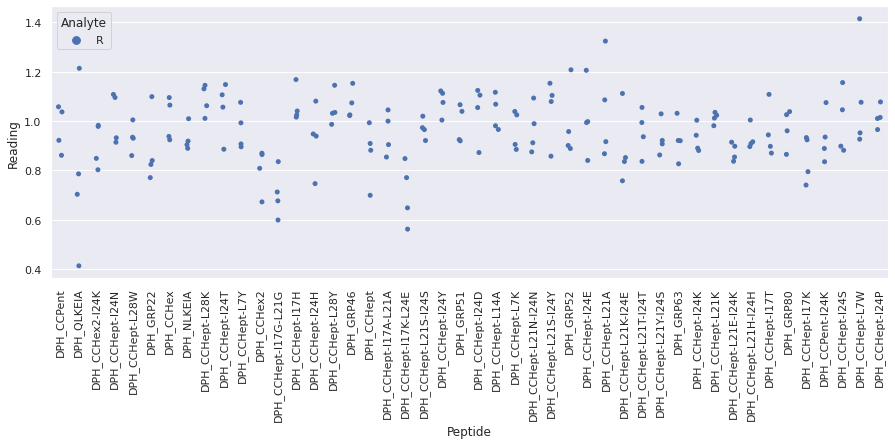

Drawing scatter plot of data spread for S_repeat_8 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

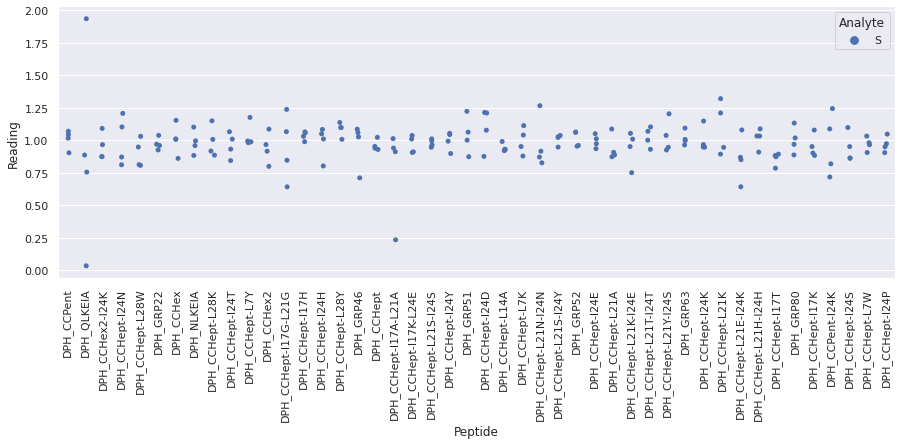

Drawing scatter plot of data spread for V_repeat_8 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

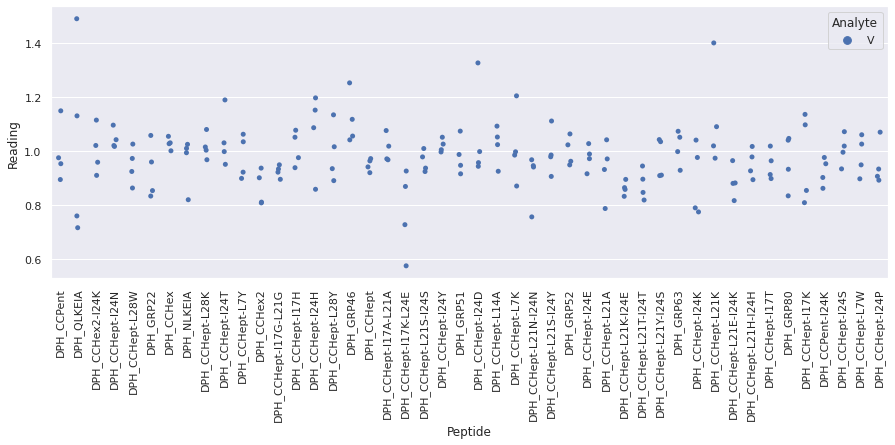

Drawing scatter plot of data spread for W_repeat_8 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

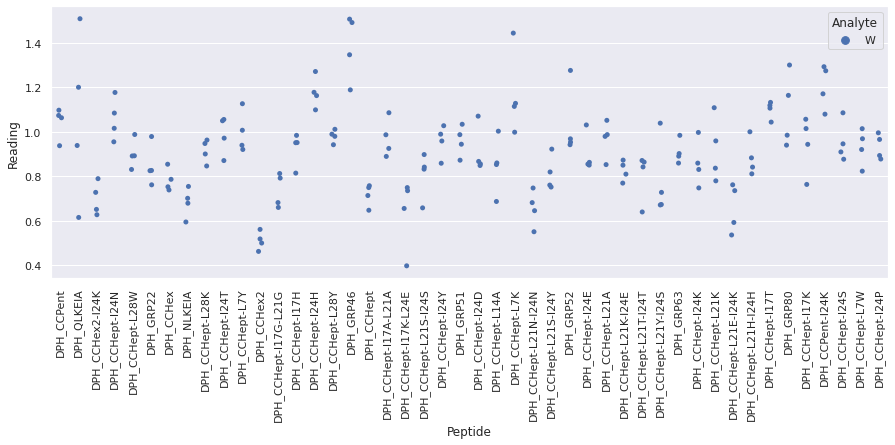

Drawing scatter plot of data spread for E_repeat_9 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

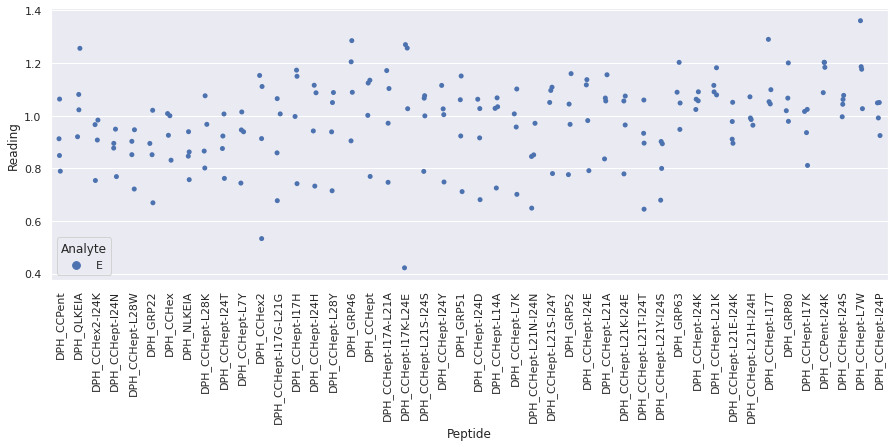

 WARNING - median fluorescence of (R + DPH_QLKEIA + fluorophore) is less than fluorescence of (R + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for R_repeat_9 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

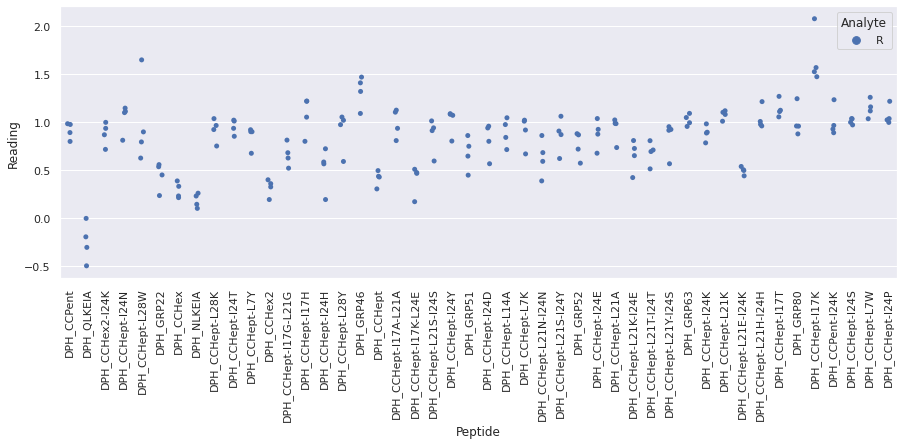

Drawing scatter plot of data spread for S_repeat_9 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

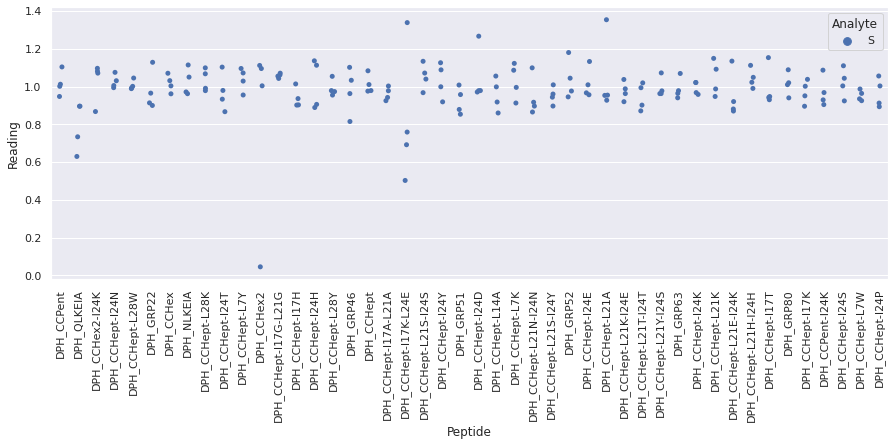

Drawing scatter plot of data spread for V_repeat_9 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

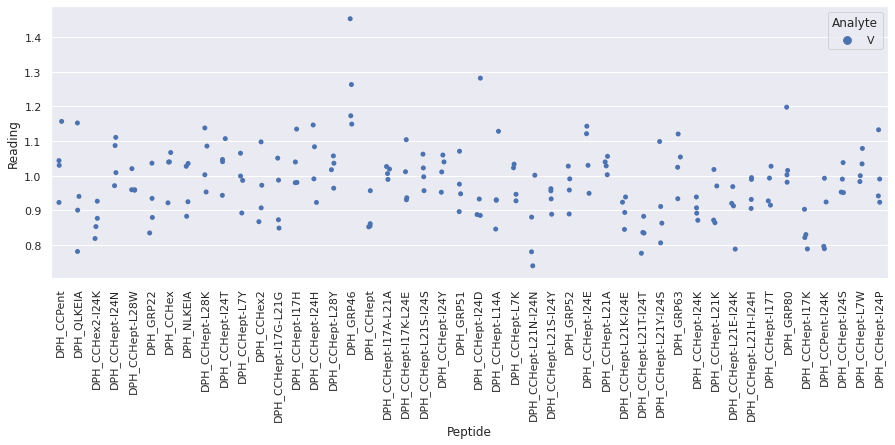

Drawing scatter plot of data spread for W_repeat_9 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

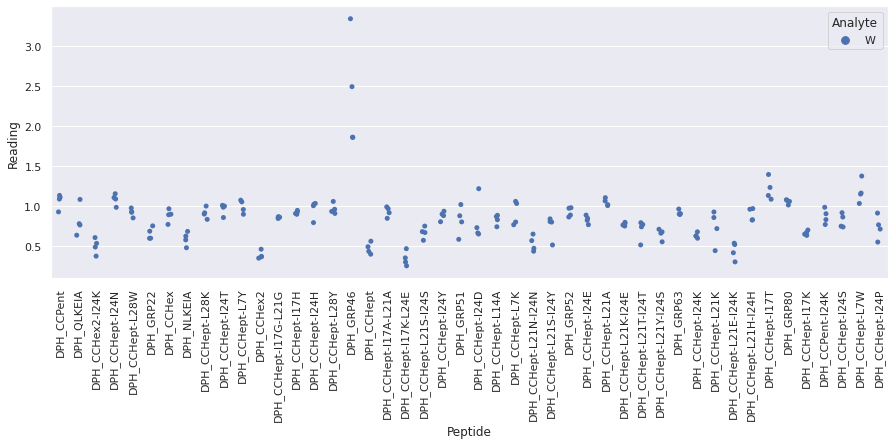

Drawing scatter plot of data spread for E_repeat_10 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

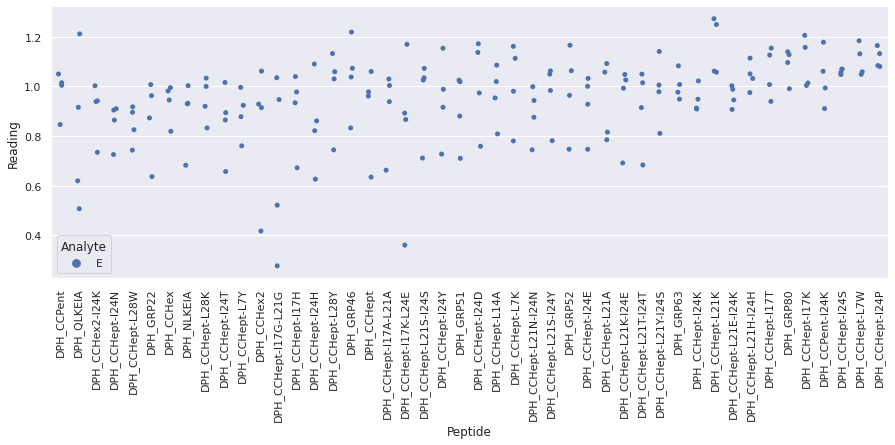

Drawing scatter plot of data spread for R_repeat_10 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

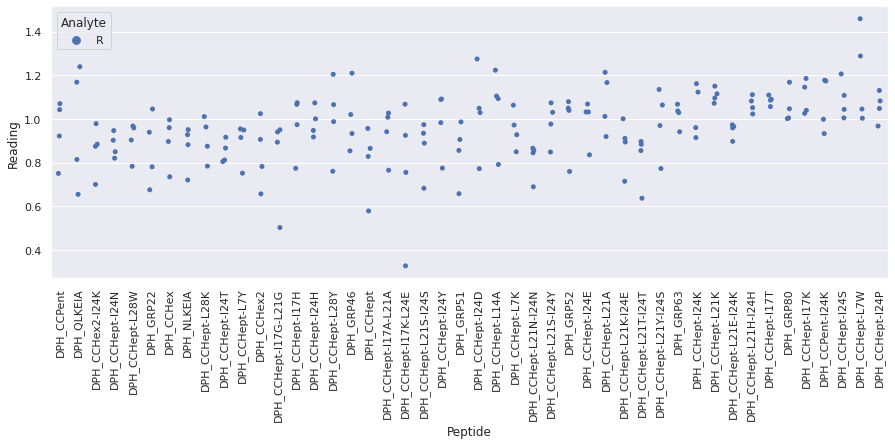

Drawing scatter plot of data spread for S_repeat_10 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

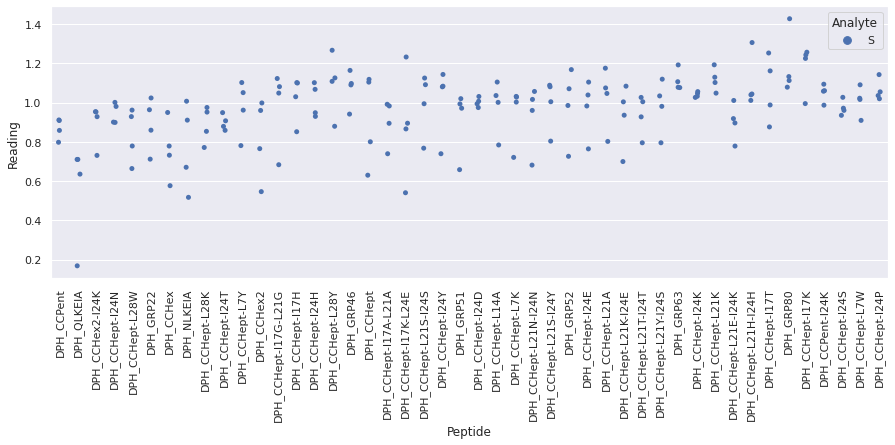

Drawing scatter plot of data spread for V_repeat_10 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

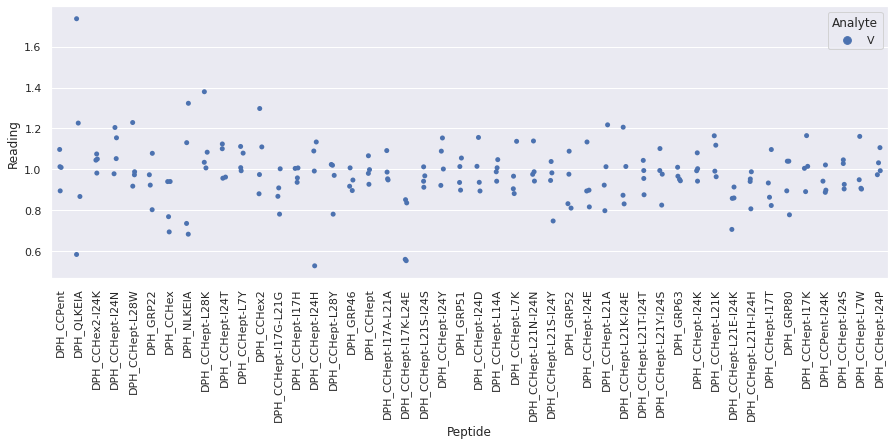

Drawing scatter plot of data spread for W_repeat_10 in AA_scaled_data


<Figure size 720x720 with 0 Axes>

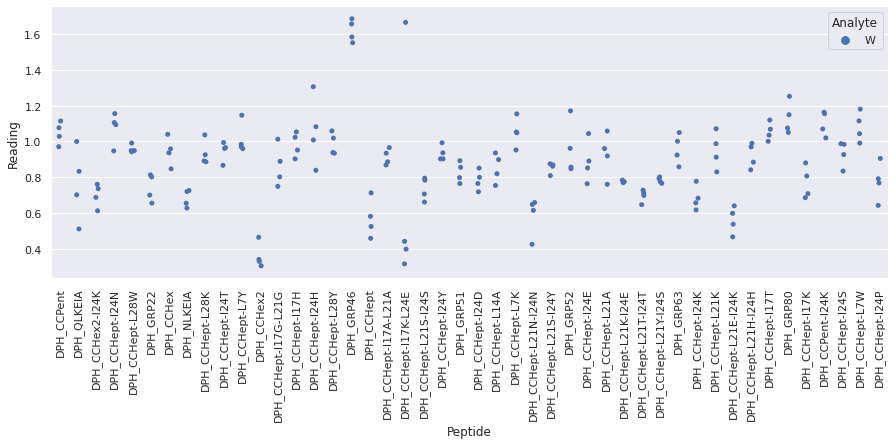



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_No Pep, 284.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_CCHept-I24N, 6263.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_CCHept-I24T, 5537.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_CCHept, 7562.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_CCHept-I17T, 1685.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: blank, DPH_CCHept-L7W, 11393.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/AAs/Reformatted_AA_csvs/R_repeat_1.xlsx: R, DPH_QLKEIA, 494.0
/home/ks17

In [12]:
aa_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='AA'
)

At a glance:
- There are no plates in the dataset that by eye are obviously anomalous
- The fluorescence of peptides GRP35, QLKEIA and CCHept-I17K-L24E in the presence of DPH is very similar to that of DPH on its own. Consequently, the min-max scaled readings of these peptides are likely to contain large amounts of noise => may need to discard these peptides from the analysis if the variation in readings obtained for the same analyte with these peptides is high.
- There is not much difference in the fluorescence signal in the presence and absence of analyte => the analytes are not causing much displacement/change of interaction of DPH with the peptide. Tryptophan has a greater effect than the other analytes.

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx
Drawing scatter plot of data spread for B_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

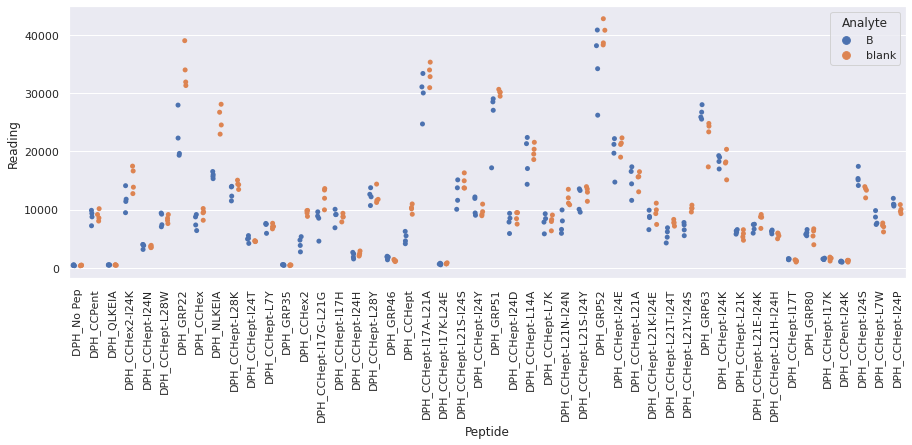

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx
Drawing scatter plot of data spread for D_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

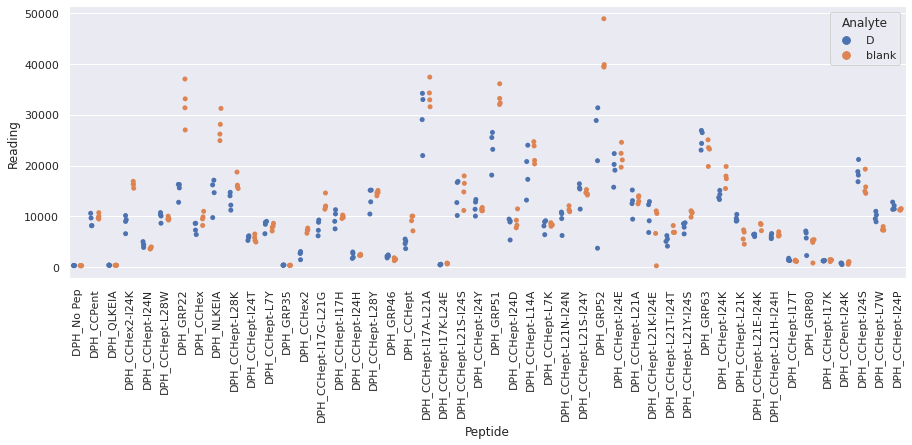

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_1.xlsx
Drawing scatter plot of data spread for N_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

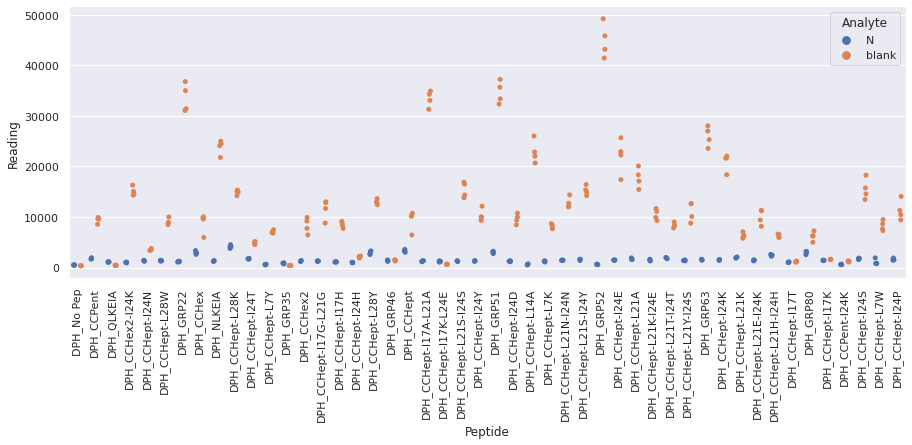

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_1.xlsx
Drawing scatter plot of data spread for O_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

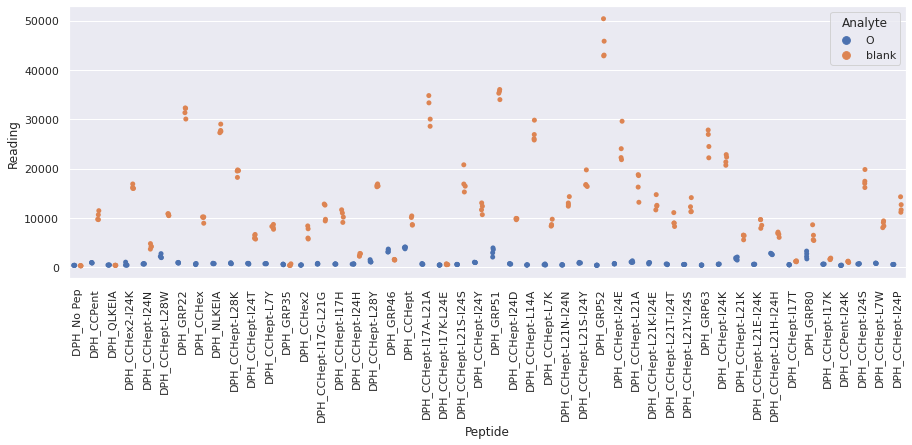

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_1.xlsx
Drawing scatter plot of data spread for P_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

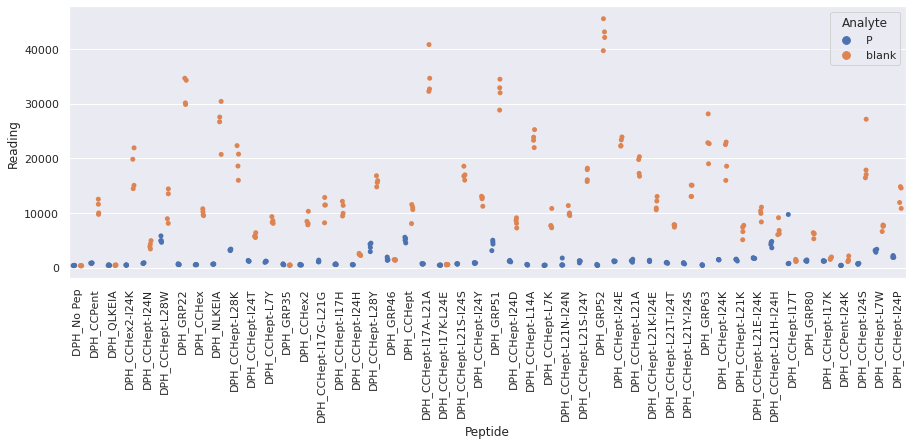

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_2.xlsx
Drawing scatter plot of data spread for B_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

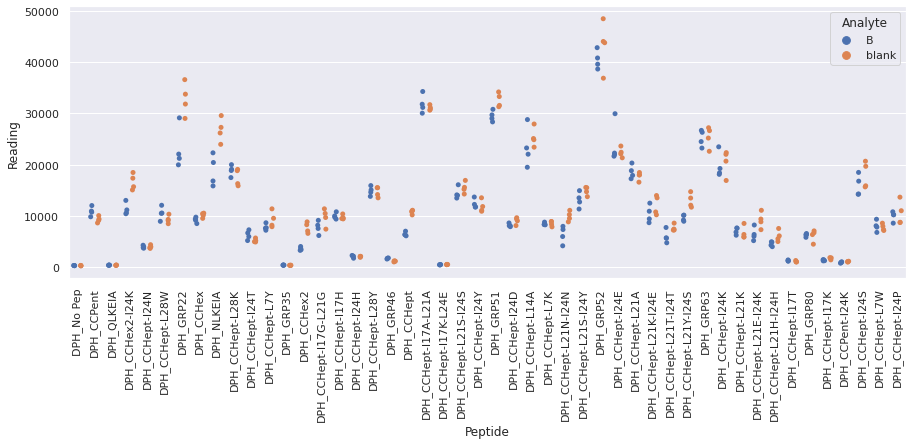

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_2.xlsx
Drawing scatter plot of data spread for D_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

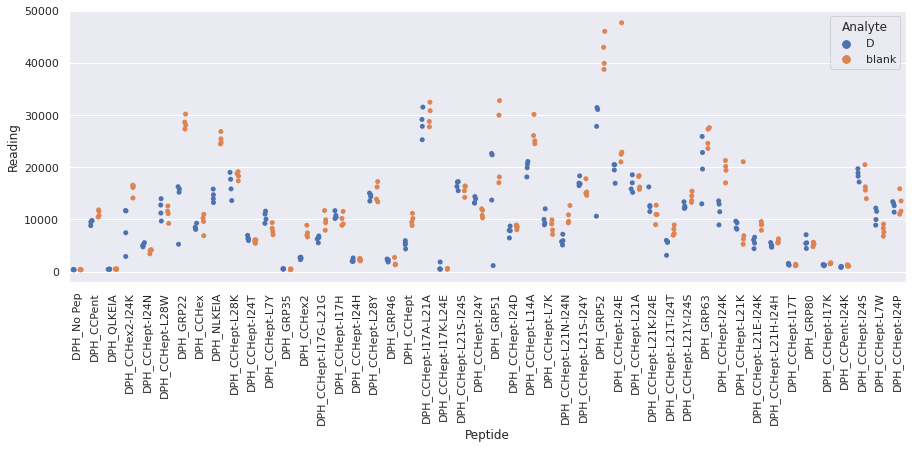

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_2.xlsx
Drawing scatter plot of data spread for N_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

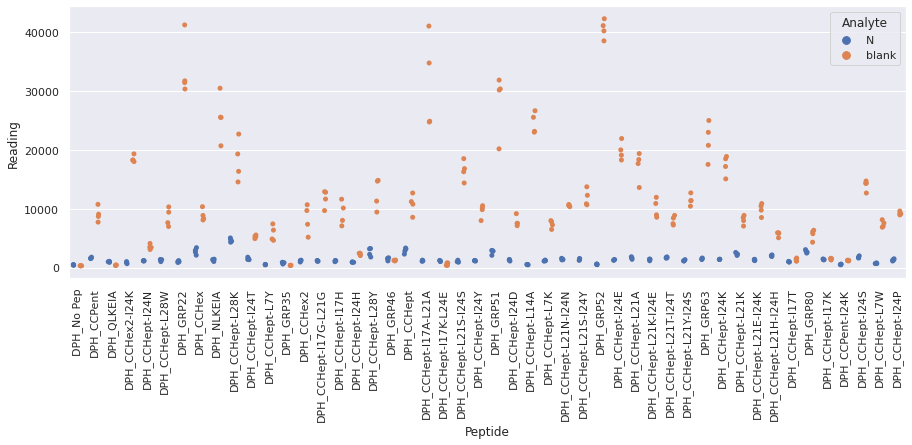

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_2.xlsx
Drawing scatter plot of data spread for O_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

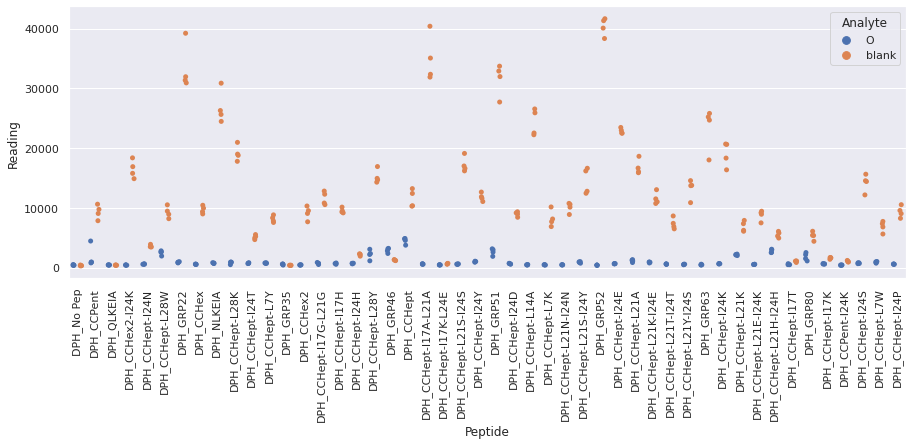

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_2.xlsx
Drawing scatter plot of data spread for P_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

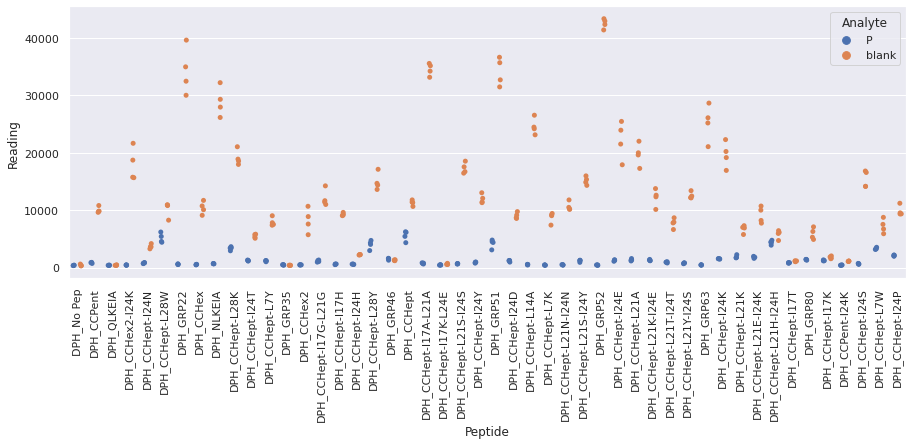

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_3.xlsx
Drawing scatter plot of data spread for B_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

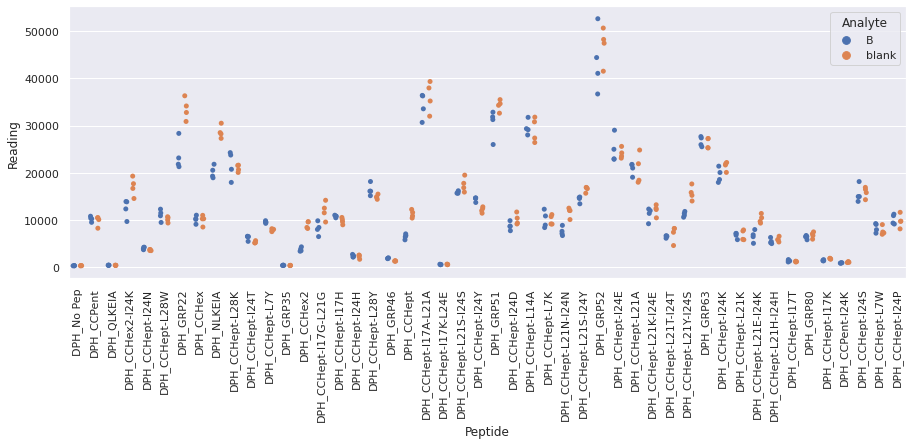

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_3.xlsx
Drawing scatter plot of data spread for D_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

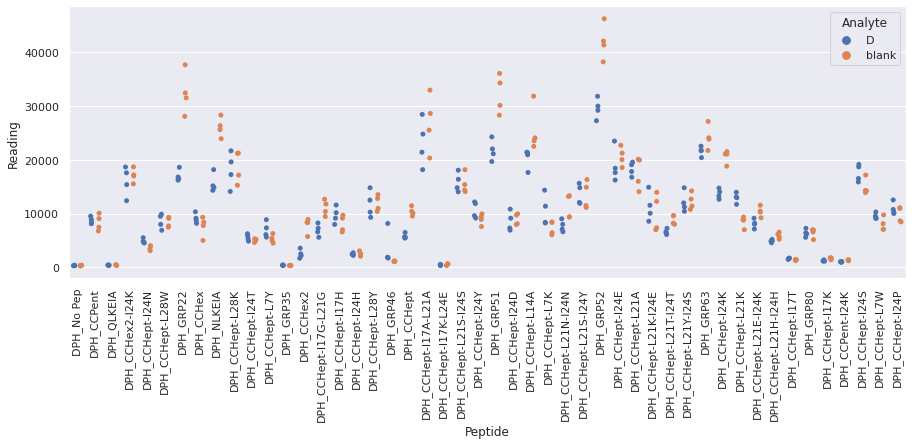

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_3.xlsx
Drawing scatter plot of data spread for N_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

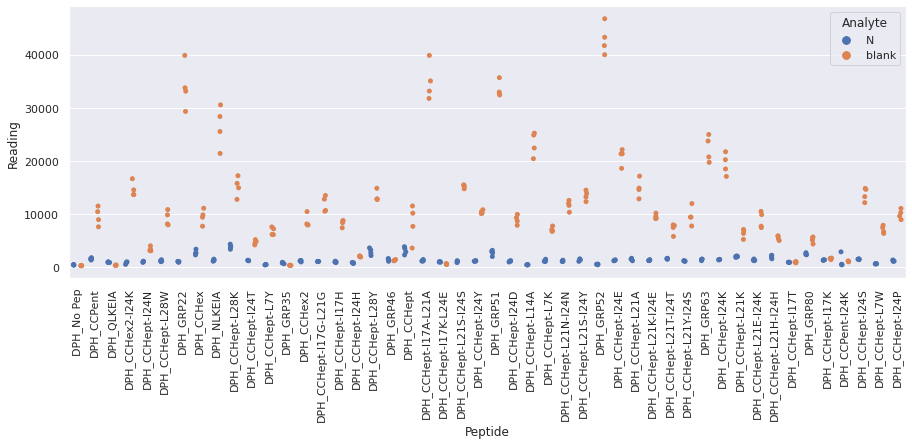

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx
Drawing scatter plot of data spread for O_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

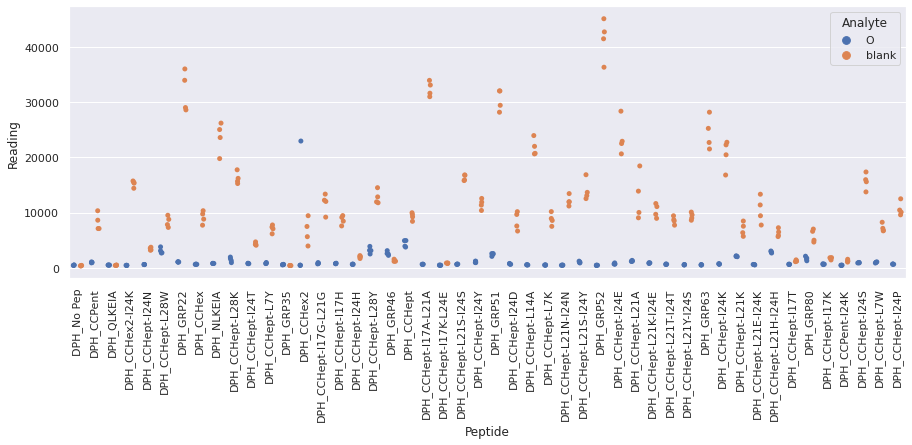

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx
Drawing scatter plot of data spread for P_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

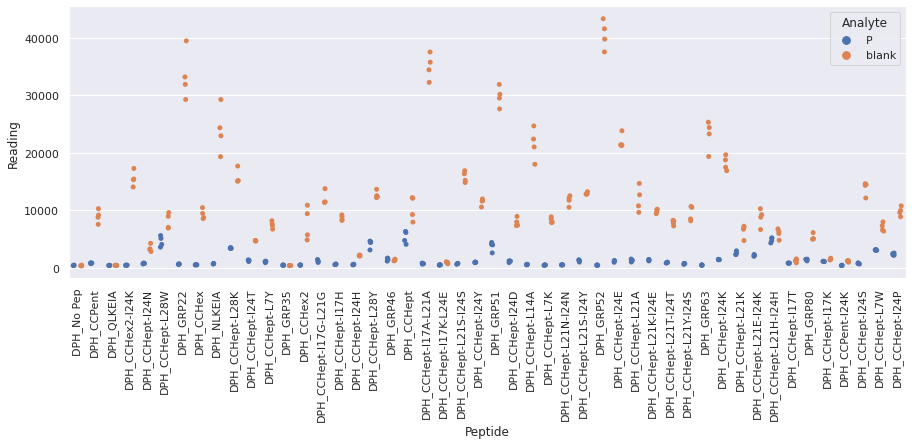

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_4.xlsx
Drawing scatter plot of data spread for B_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

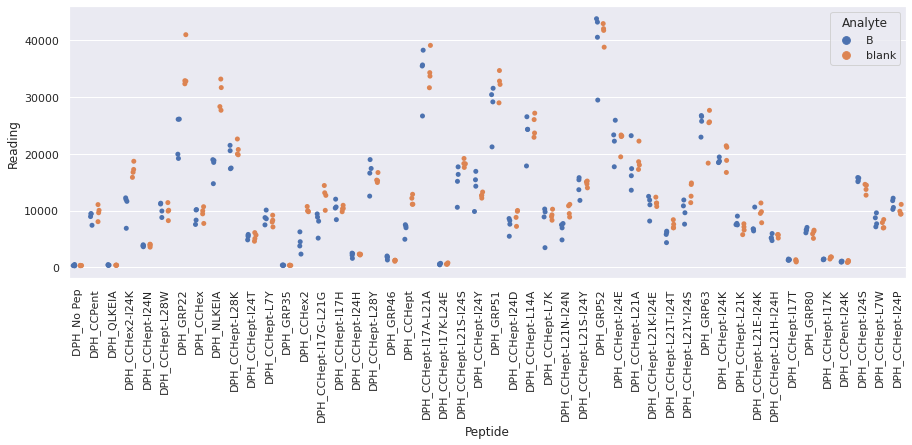

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_4.xlsx
Drawing scatter plot of data spread for D_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

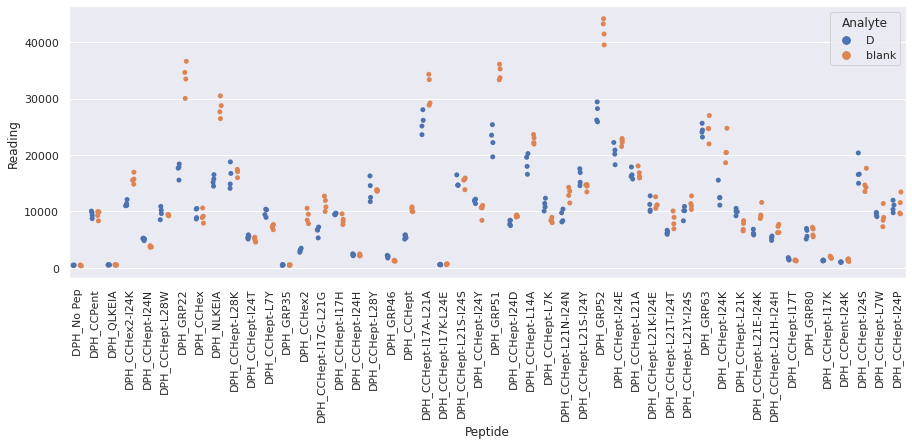

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_4.xlsx
Drawing scatter plot of data spread for N_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

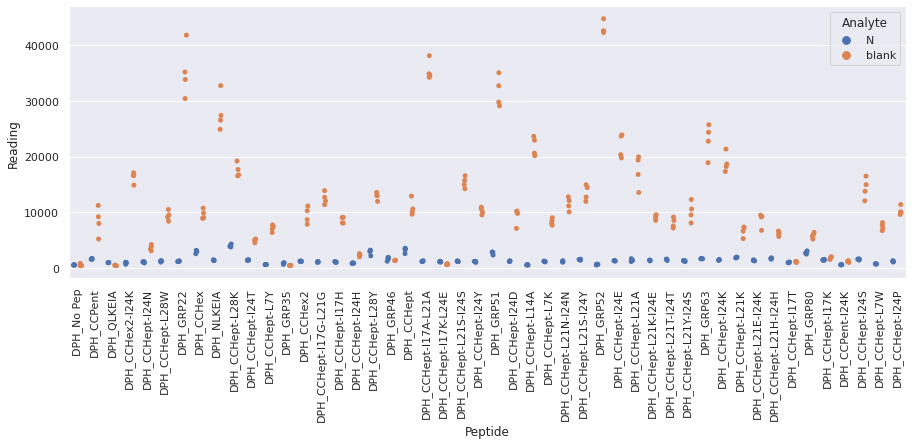

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_4.xlsx
Drawing scatter plot of data spread for O_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

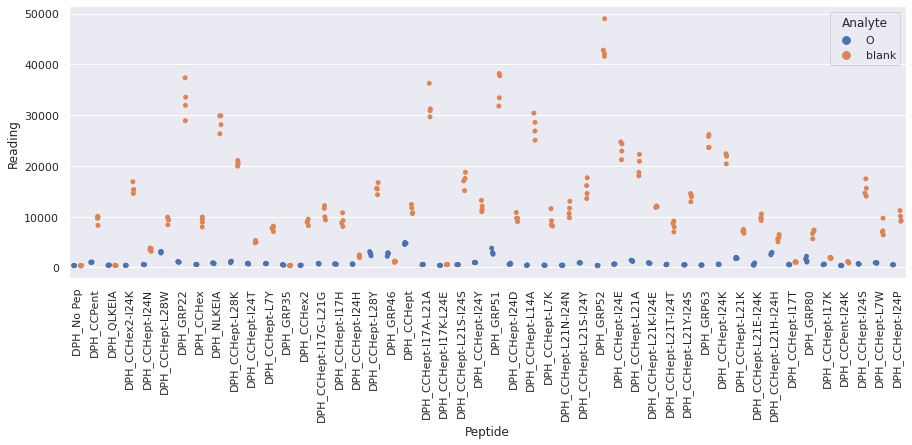

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_4.xlsx
Drawing scatter plot of data spread for P_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

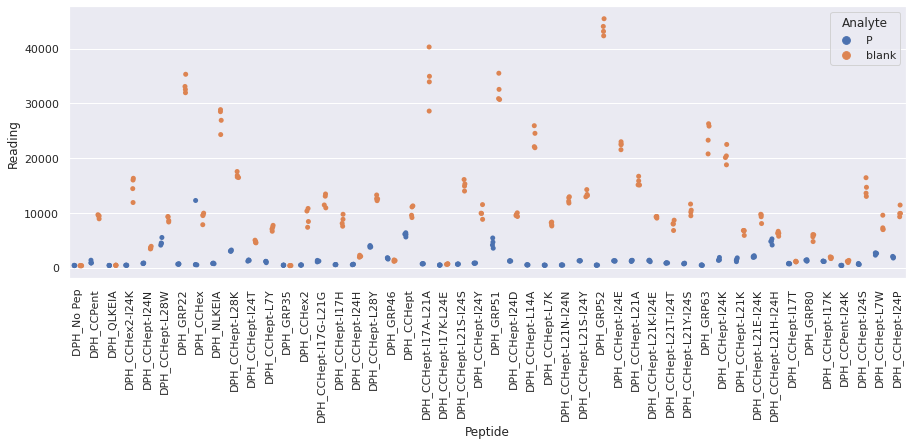

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_5.xlsx
Drawing scatter plot of data spread for B_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

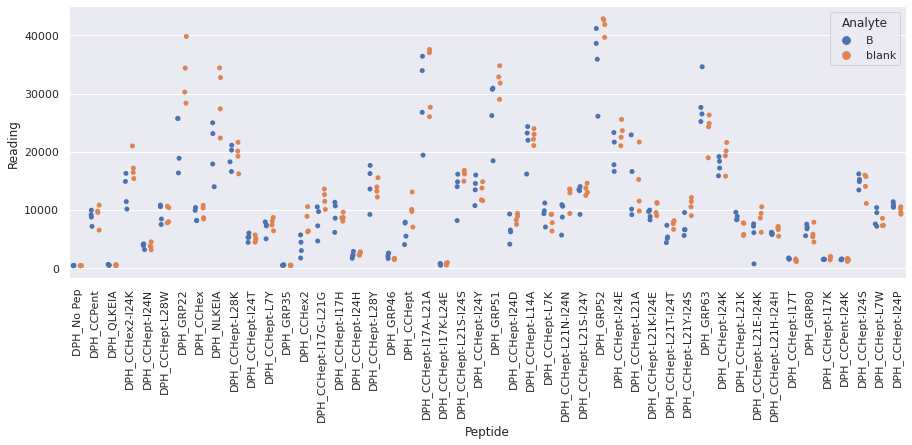

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_5.xlsx
Drawing scatter plot of data spread for D_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

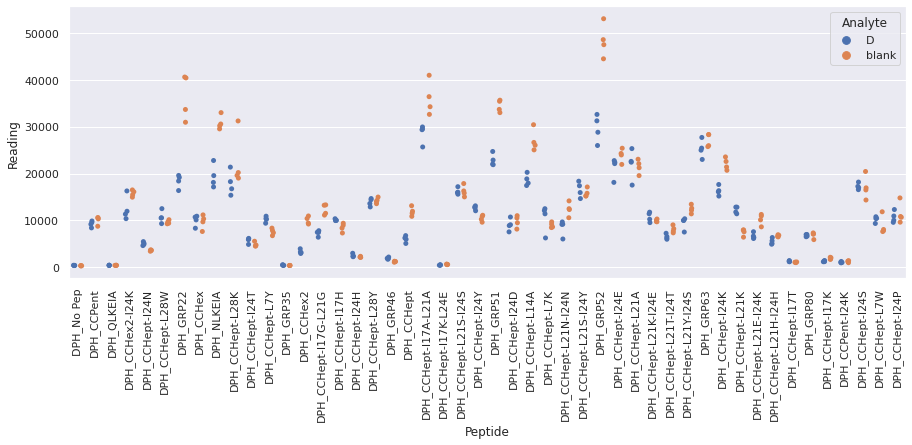

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_5.xlsx
Drawing scatter plot of data spread for N_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

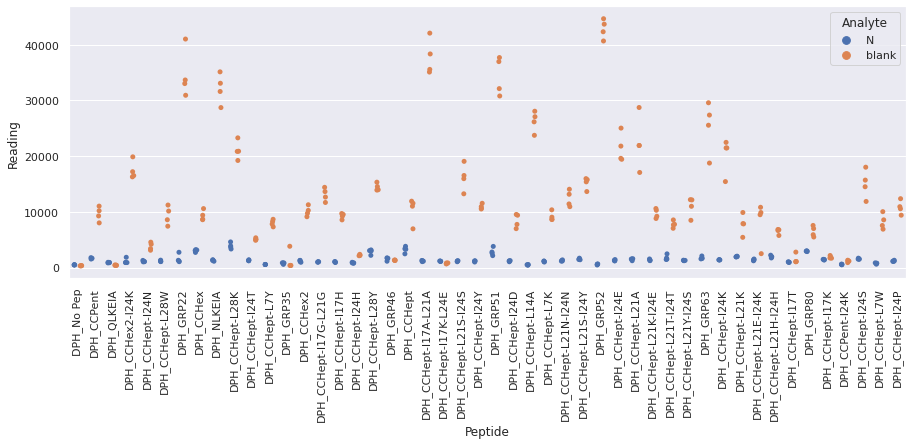

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_5.xlsx
Drawing scatter plot of data spread for O_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

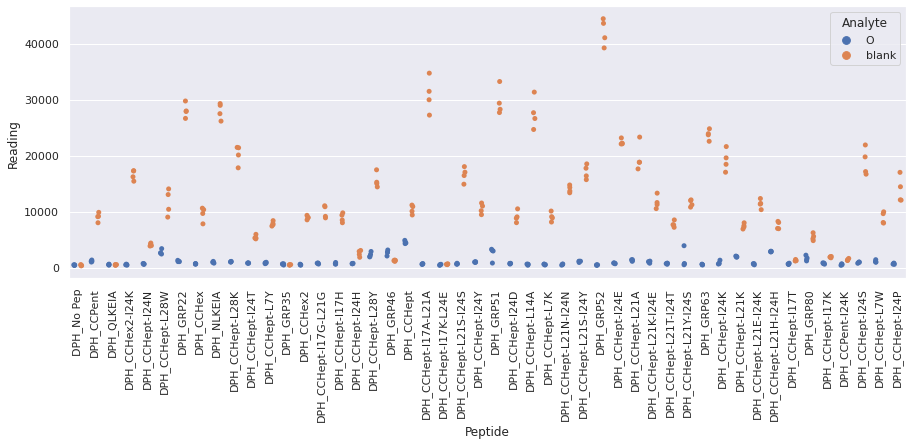

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_5.xlsx
Drawing scatter plot of data spread for P_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

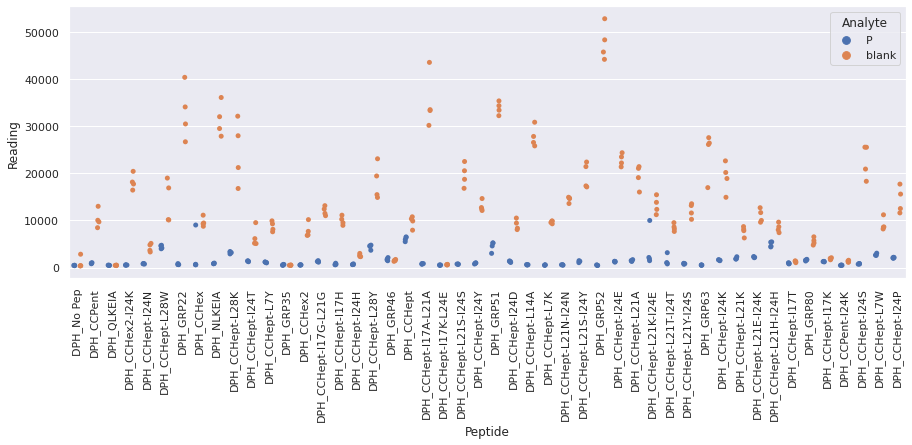

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_6.xlsx
Drawing scatter plot of data spread for B_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

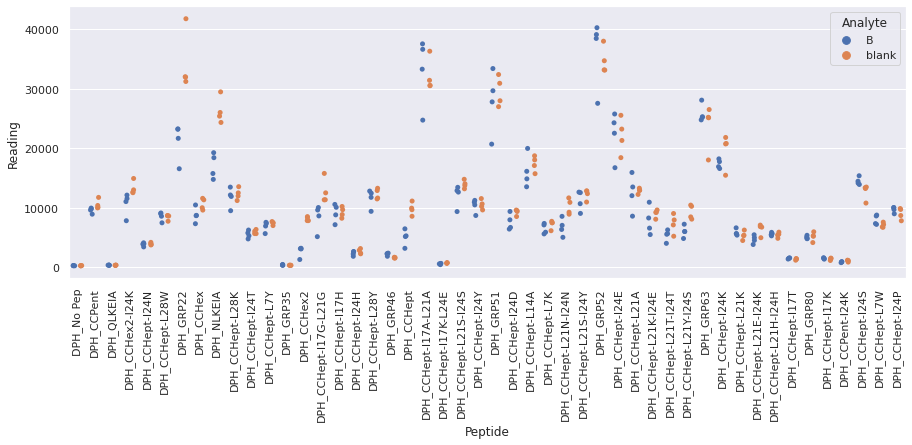

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_6.xlsx
Drawing scatter plot of data spread for D_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

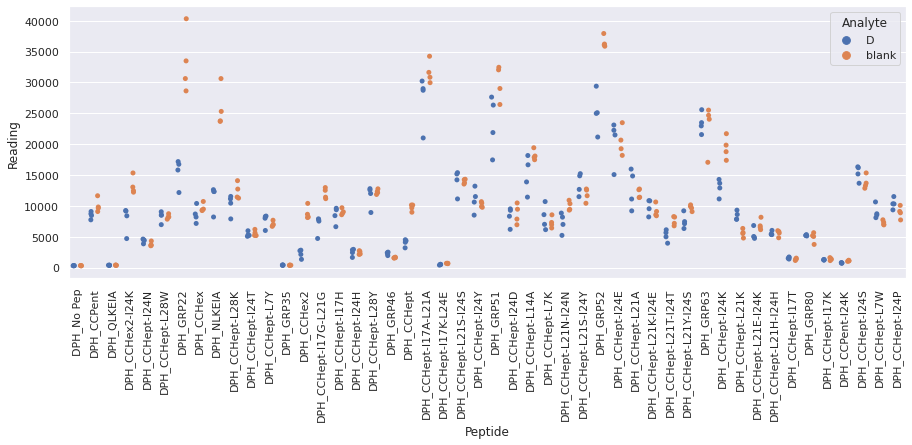

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_6.xlsx
Drawing scatter plot of data spread for N_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

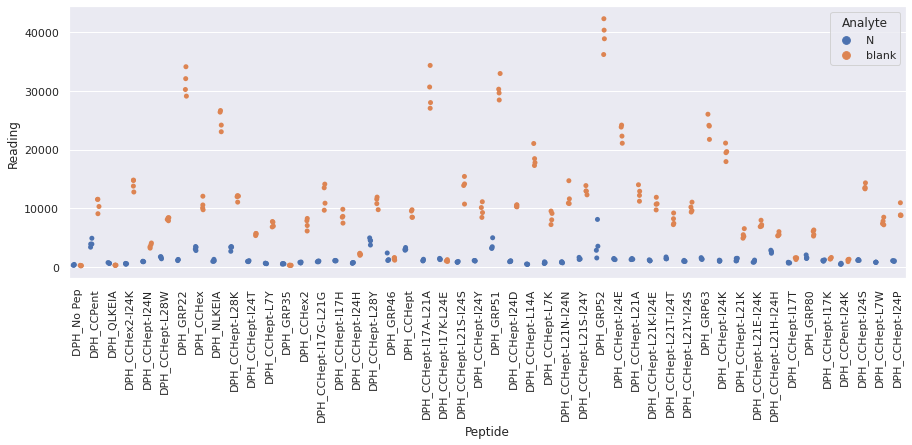

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx
Drawing scatter plot of data spread for O_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

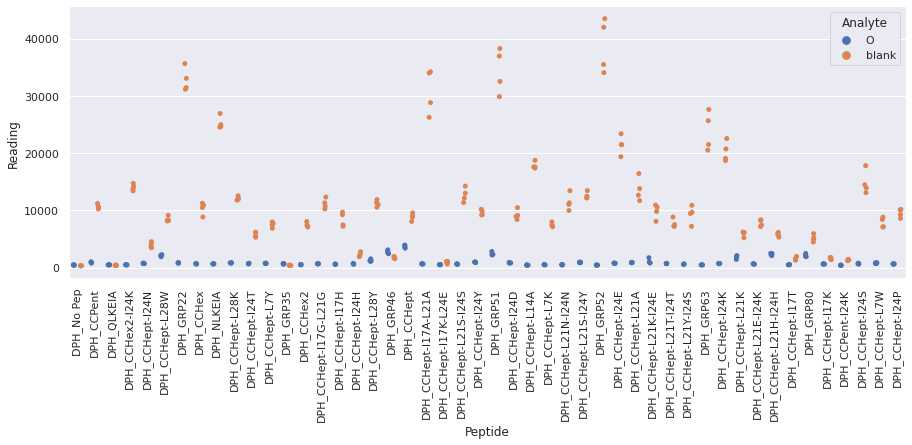

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_6.xlsx
Drawing scatter plot of data spread for P_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

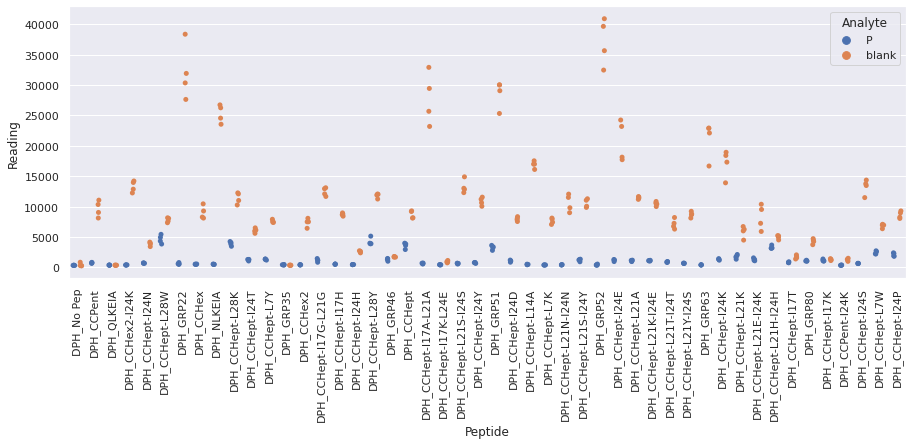

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_7.xlsx
Drawing scatter plot of data spread for B_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

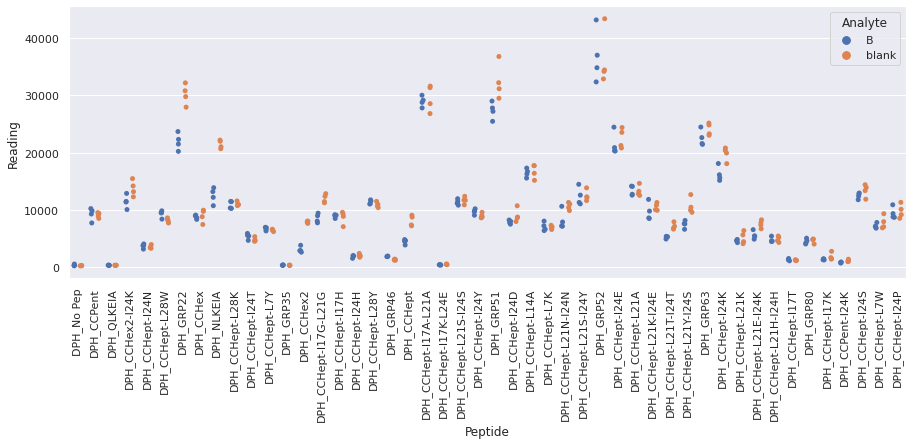

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_7.xlsx
Drawing scatter plot of data spread for D_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

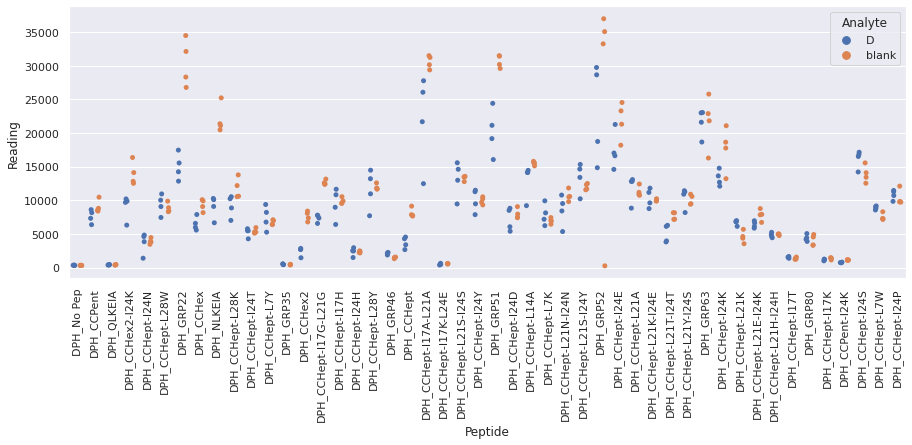

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_7.xlsx
Drawing scatter plot of data spread for N_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

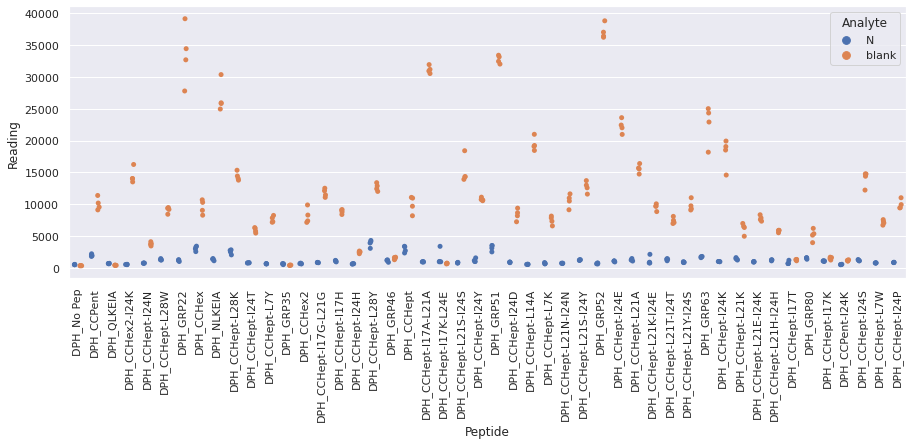

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx
Drawing scatter plot of data spread for O_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

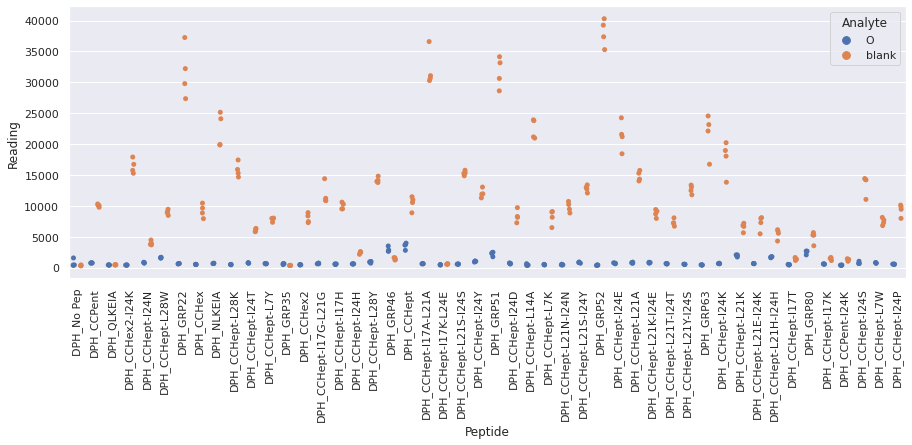

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_7.xlsx
Drawing scatter plot of data spread for P_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

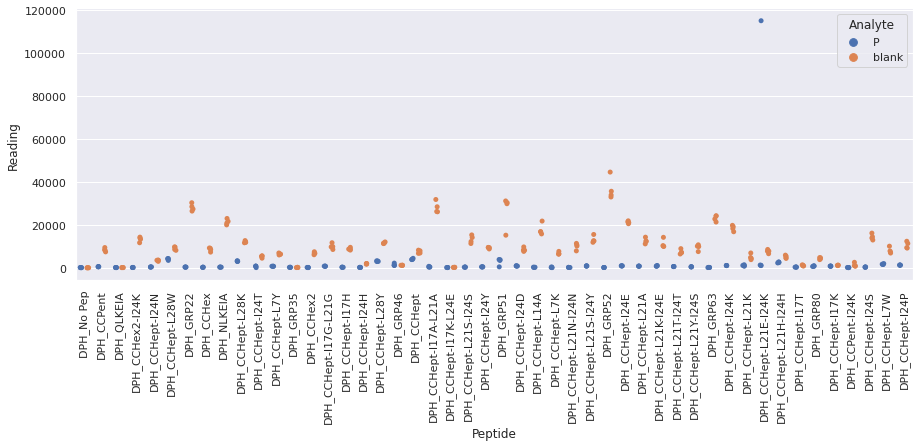

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_8.xlsx
Drawing scatter plot of data spread for B_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

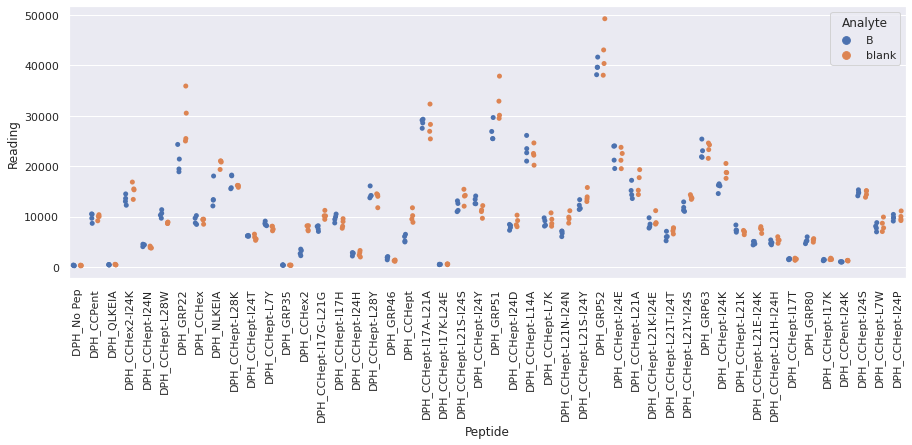

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_8.xlsx
Drawing scatter plot of data spread for D_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

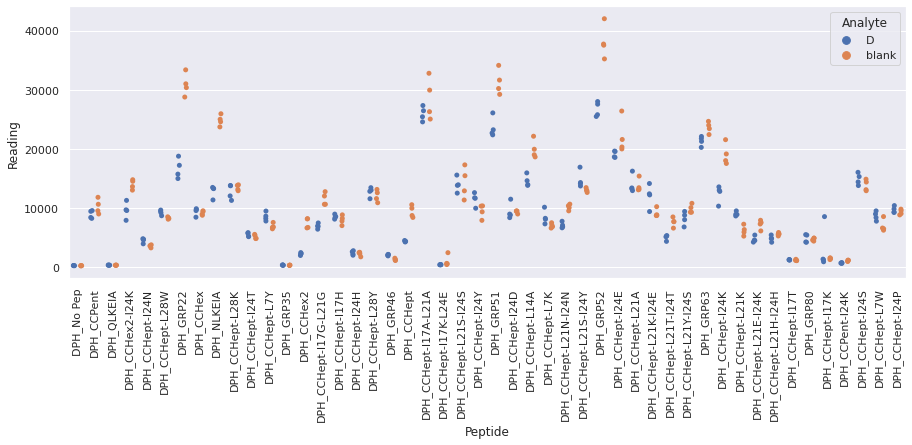

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_8.xlsx
Drawing scatter plot of data spread for N_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

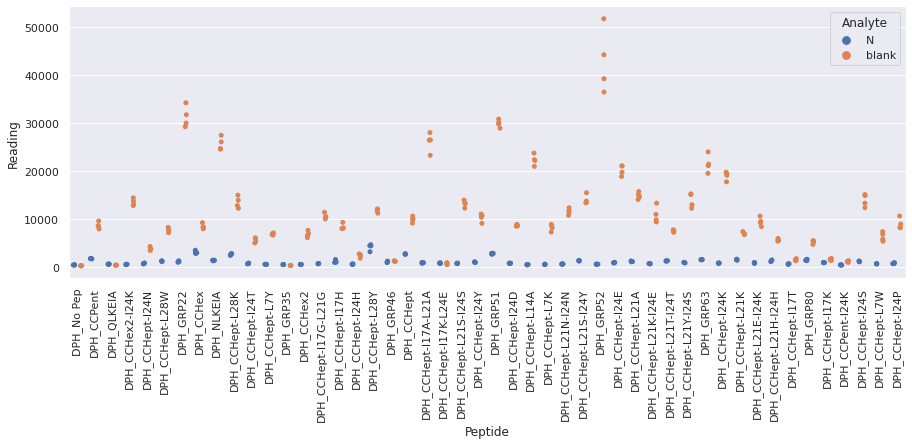

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_8.xlsx
Drawing scatter plot of data spread for O_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

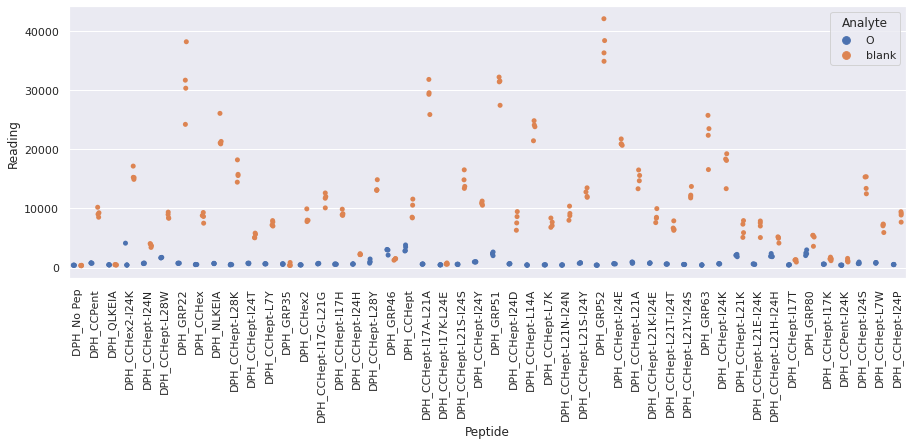

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_8.xlsx
Drawing scatter plot of data spread for P_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

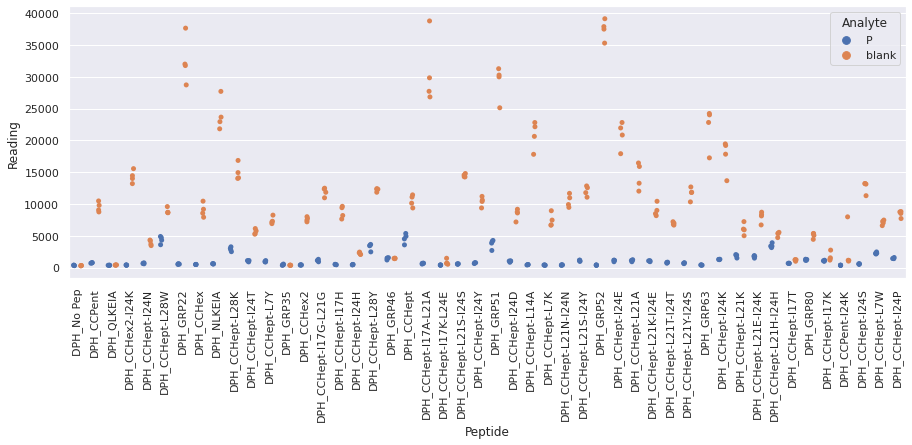

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_9.xlsx
Drawing scatter plot of data spread for B_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

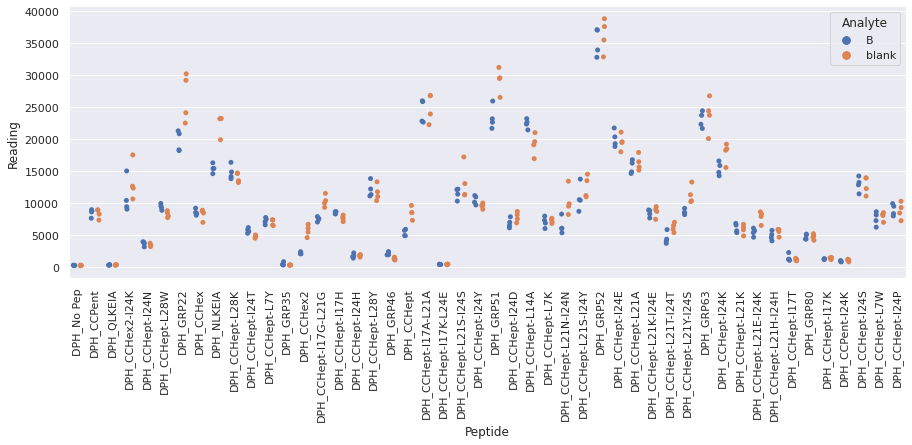

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_9.xlsx
Drawing scatter plot of data spread for D_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

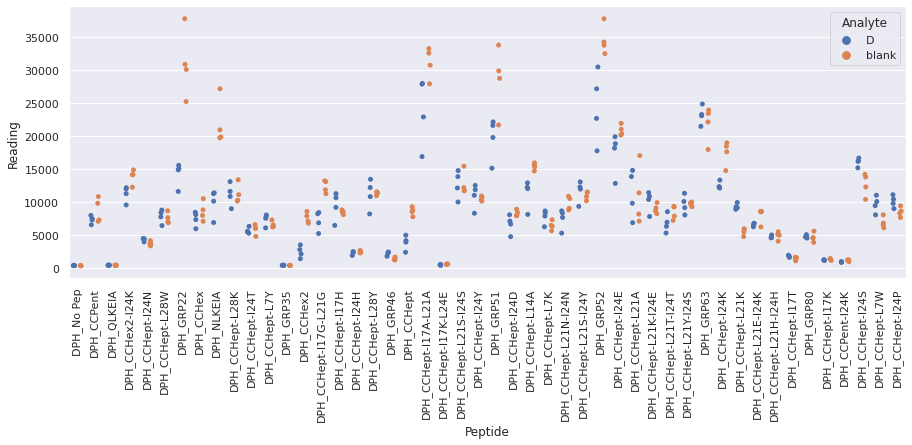

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_9.xlsx
Drawing scatter plot of data spread for N_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

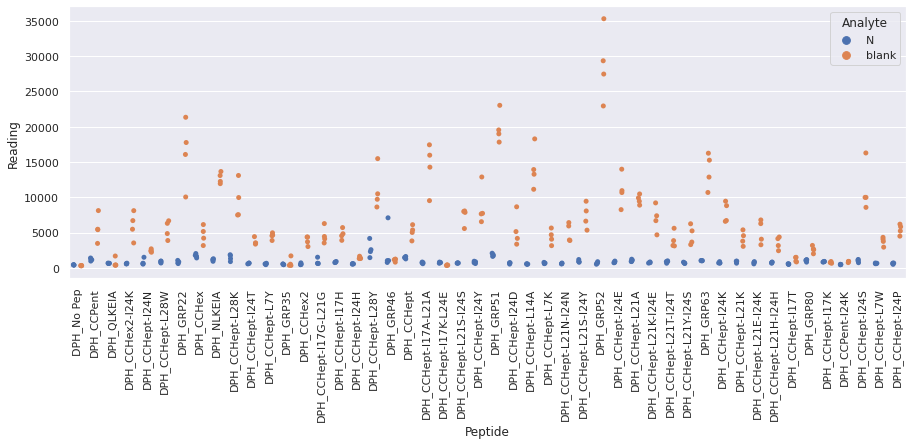

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_9.xlsx
Drawing scatter plot of data spread for O_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

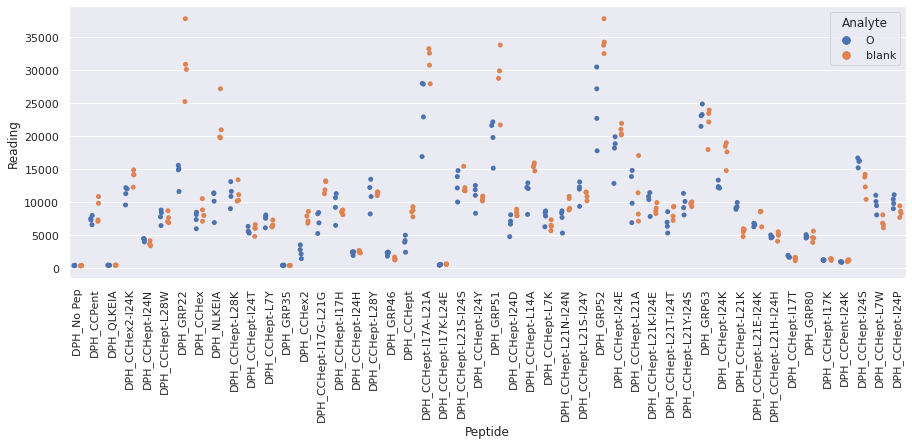

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx
Drawing scatter plot of data spread for P_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

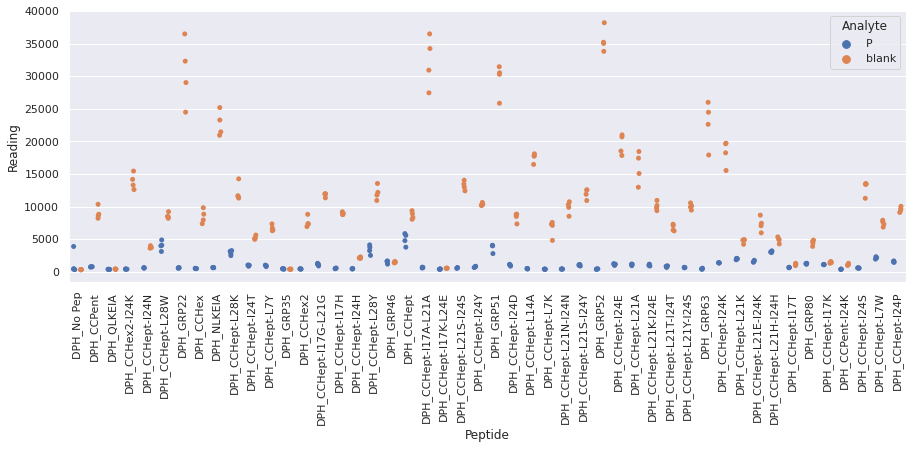

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_10.xlsx
Drawing scatter plot of data spread for B_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

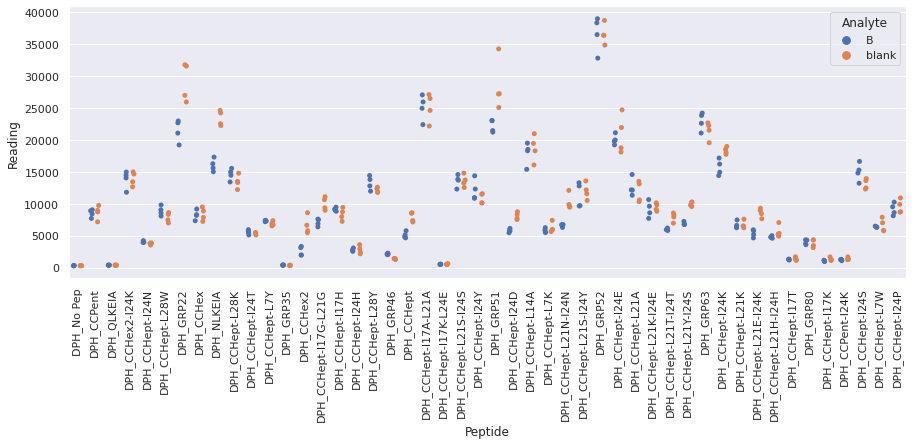

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_10.xlsx
Drawing scatter plot of data spread for D_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

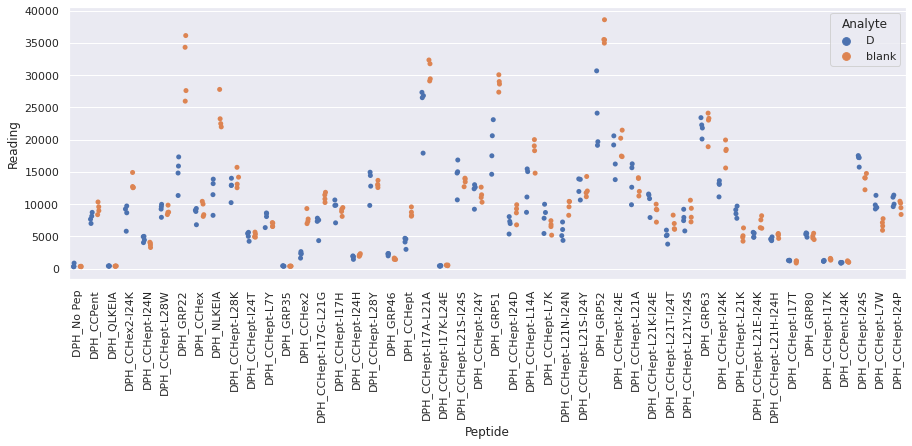

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_10.xlsx
Drawing scatter plot of data spread for N_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

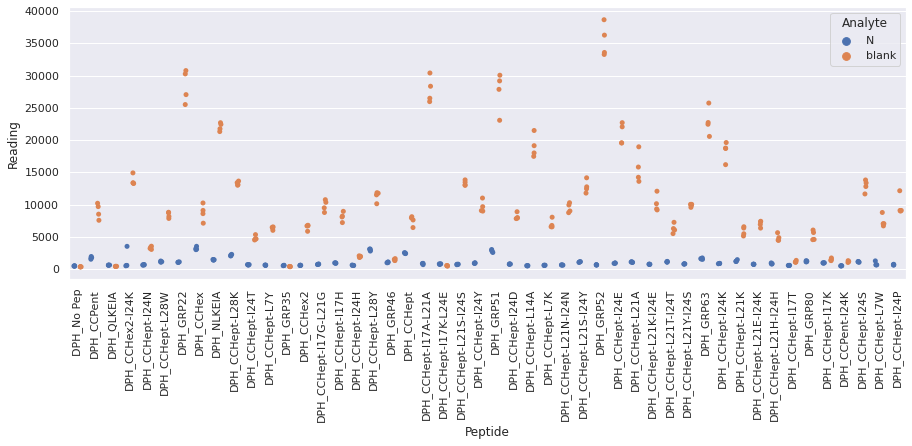

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx
Drawing scatter plot of data spread for O_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

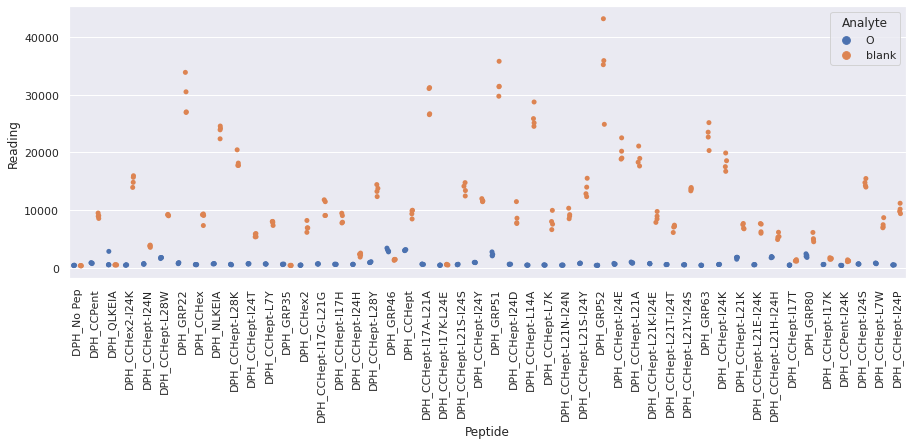

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_10.xlsx
Drawing scatter plot of data spread for P_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

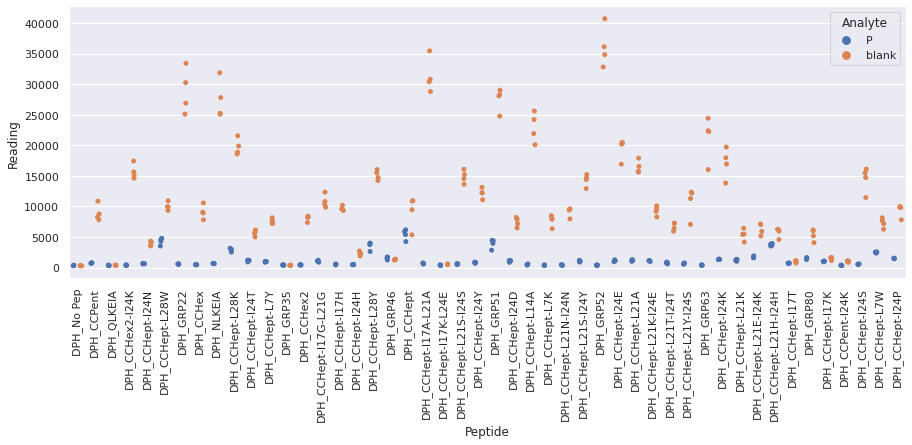

Drawing scatter plot of data spread for B_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

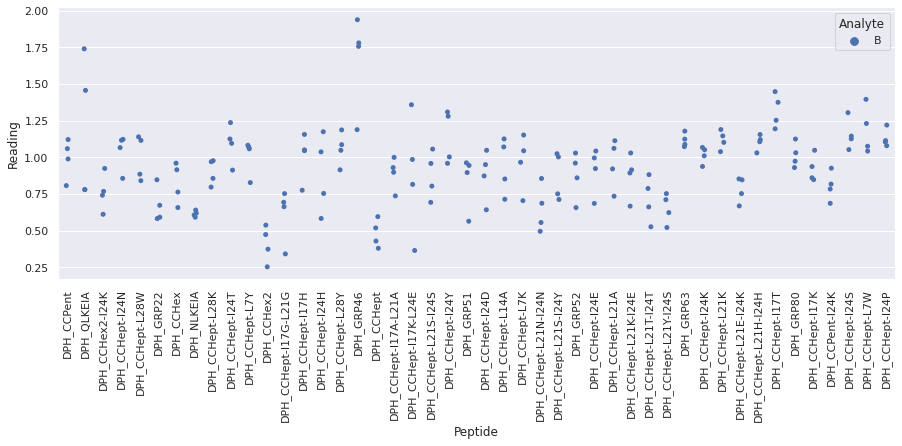

Drawing scatter plot of data spread for D_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

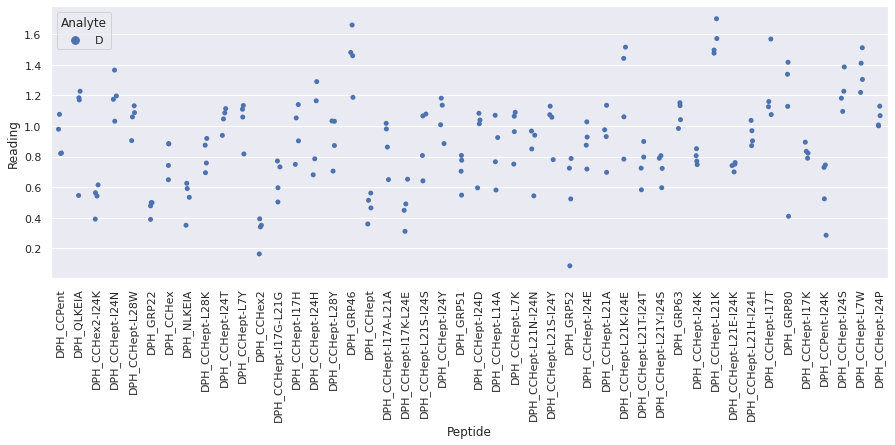

Drawing scatter plot of data spread for N_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

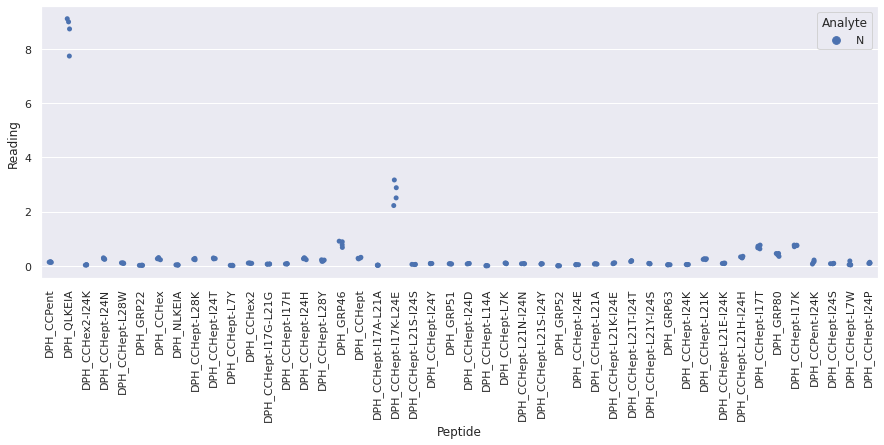

 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

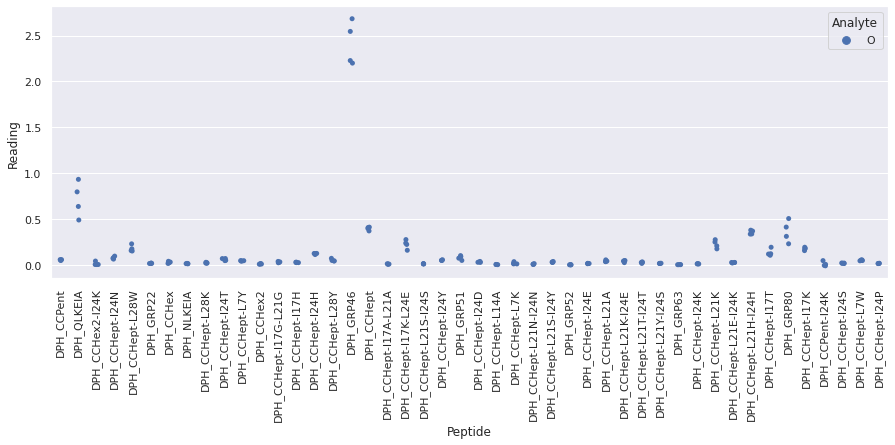

Drawing scatter plot of data spread for P_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

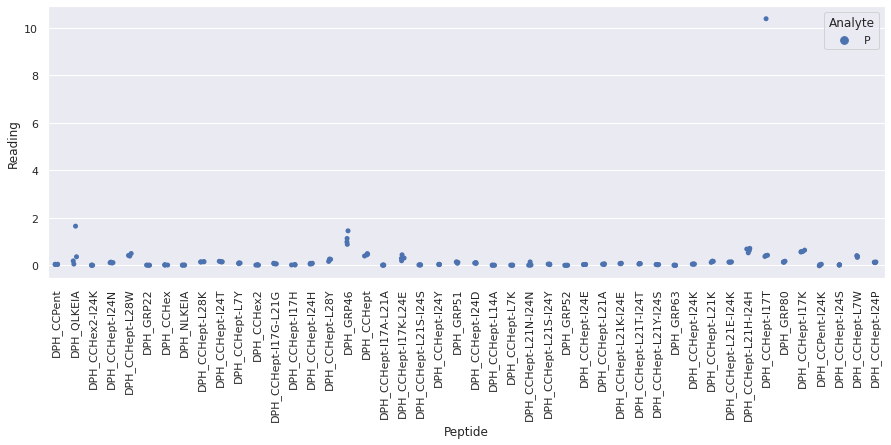

Drawing scatter plot of data spread for B_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

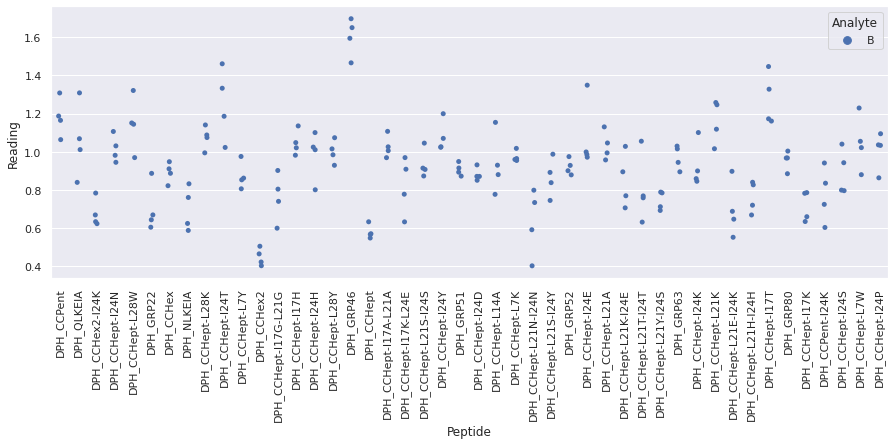

Drawing scatter plot of data spread for D_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

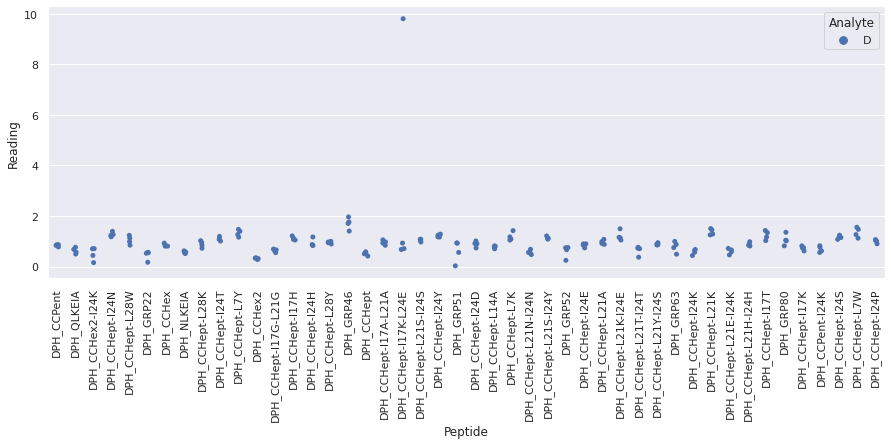

Drawing scatter plot of data spread for N_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

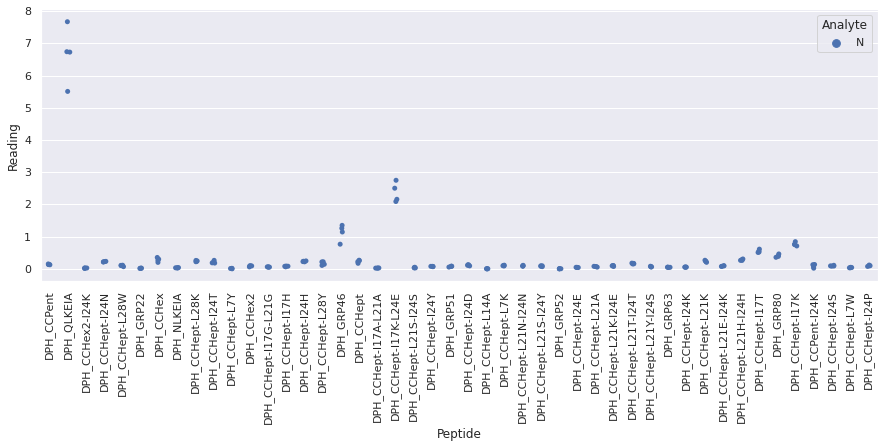

Drawing scatter plot of data spread for O_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

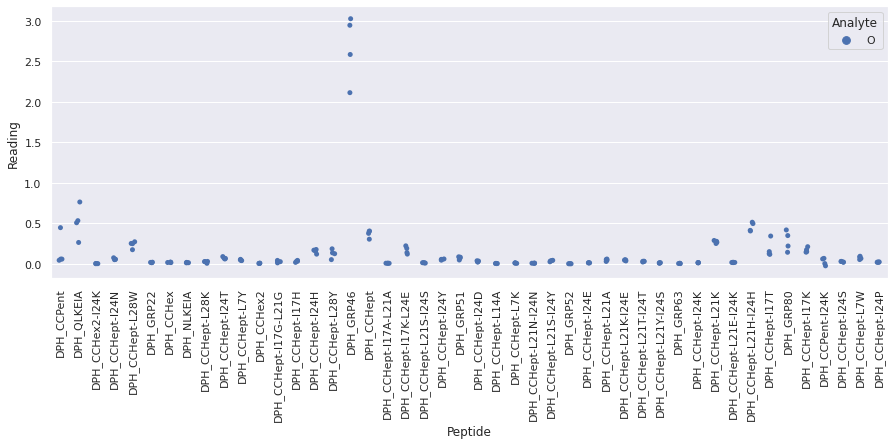

Drawing scatter plot of data spread for P_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

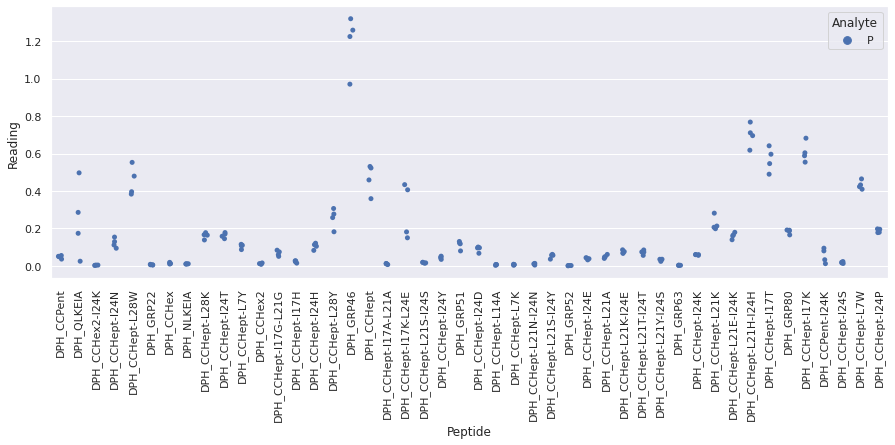

Drawing scatter plot of data spread for B_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

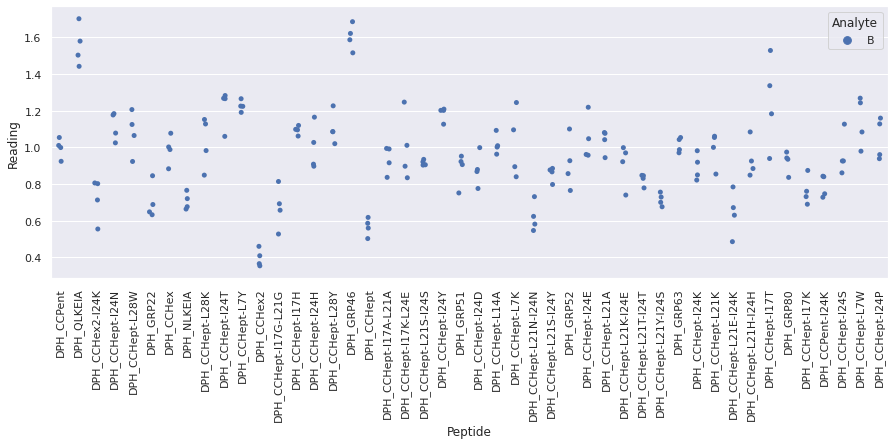

Drawing scatter plot of data spread for D_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

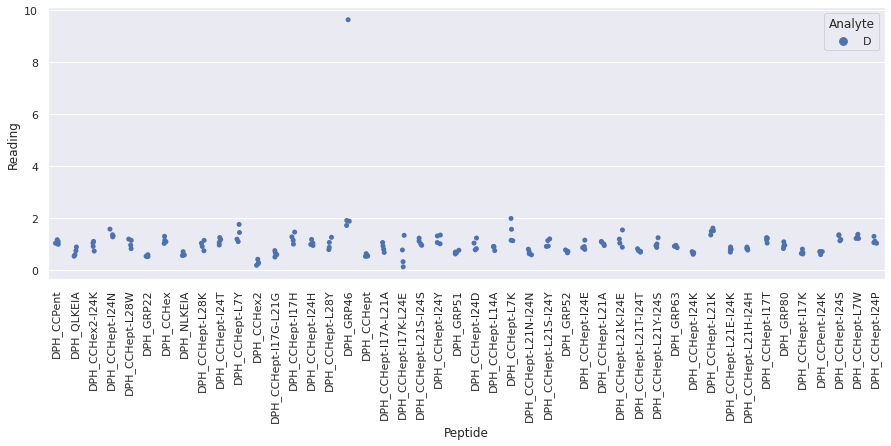

 WARNING - median fluorescence of (N + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (N + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for N_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

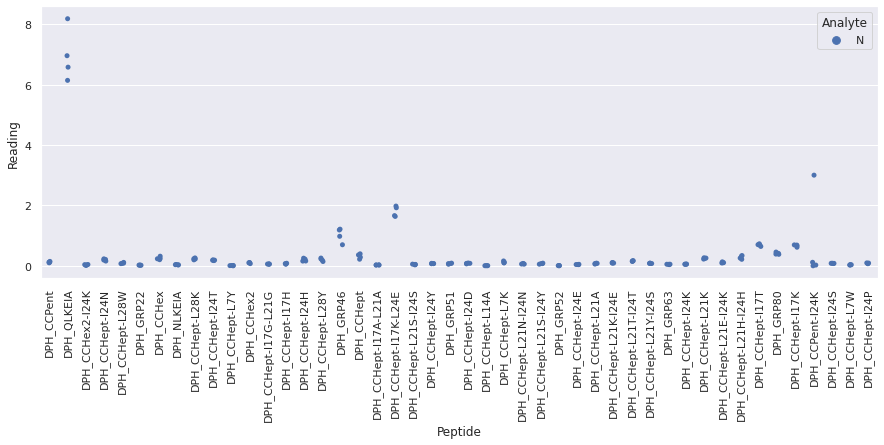

 WARNING - median fluorescence of (O + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCHex2 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate 

<Figure size 720x720 with 0 Axes>

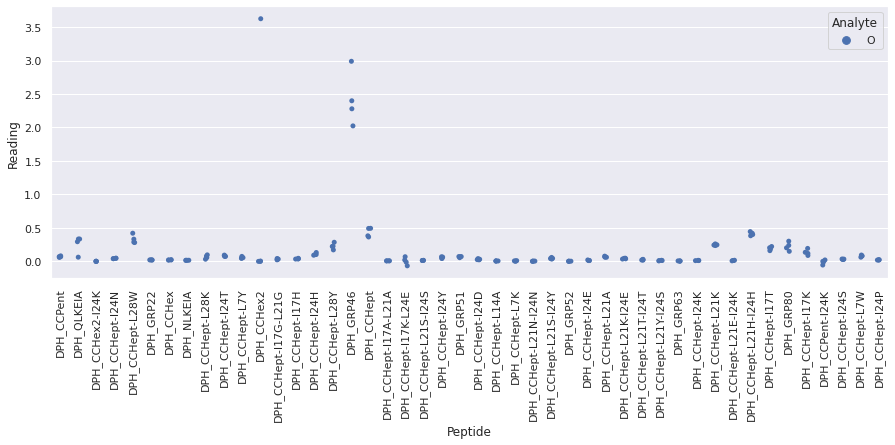

 WARNING - median fluorescence of (P + DPH_QLKEIA + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for P_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

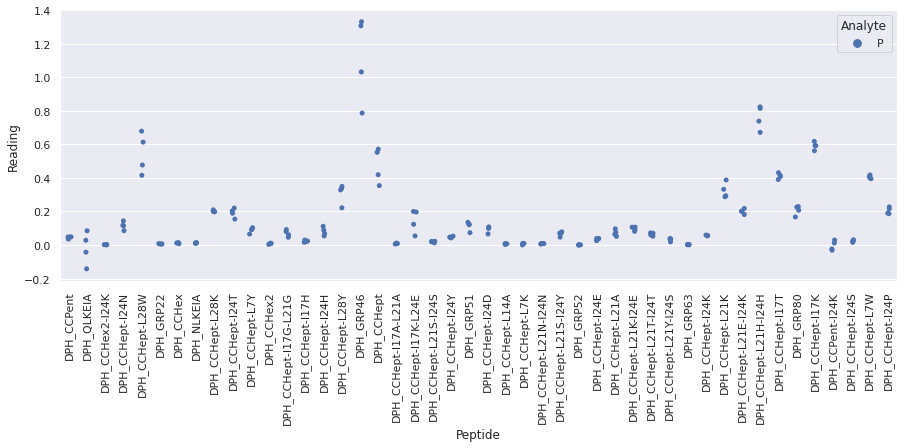

Drawing scatter plot of data spread for B_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

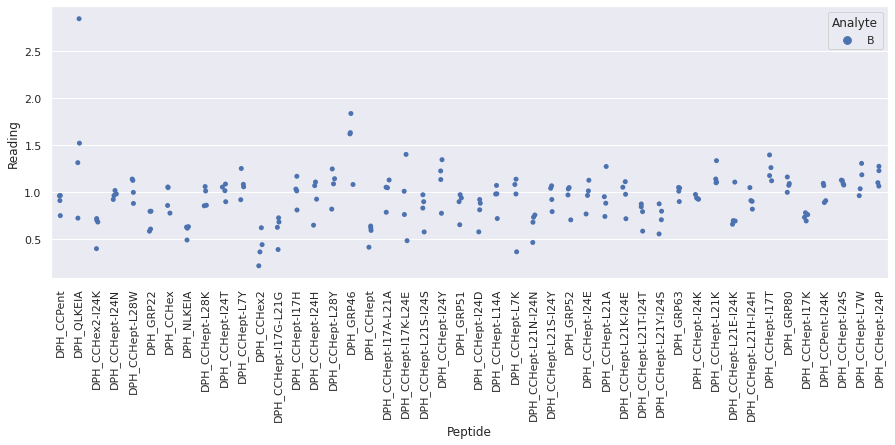

Drawing scatter plot of data spread for D_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

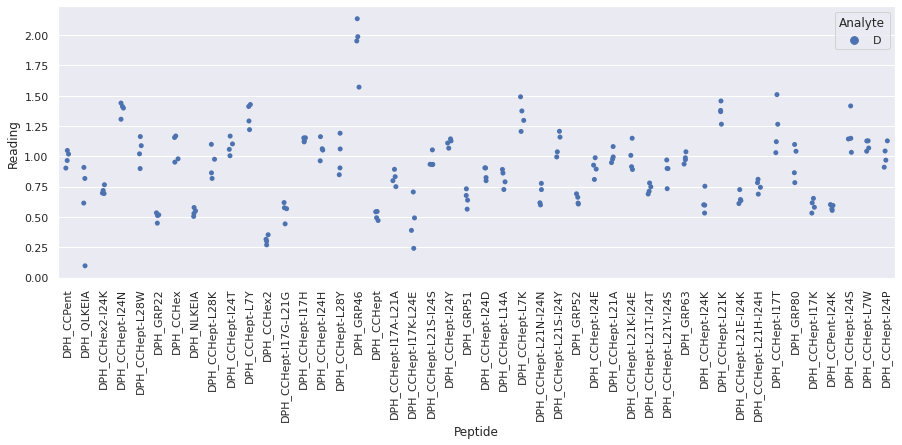

Drawing scatter plot of data spread for N_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

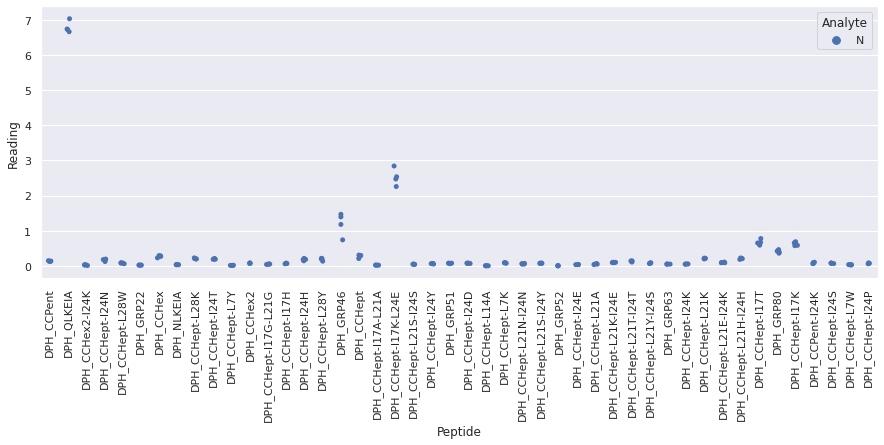

Drawing scatter plot of data spread for O_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

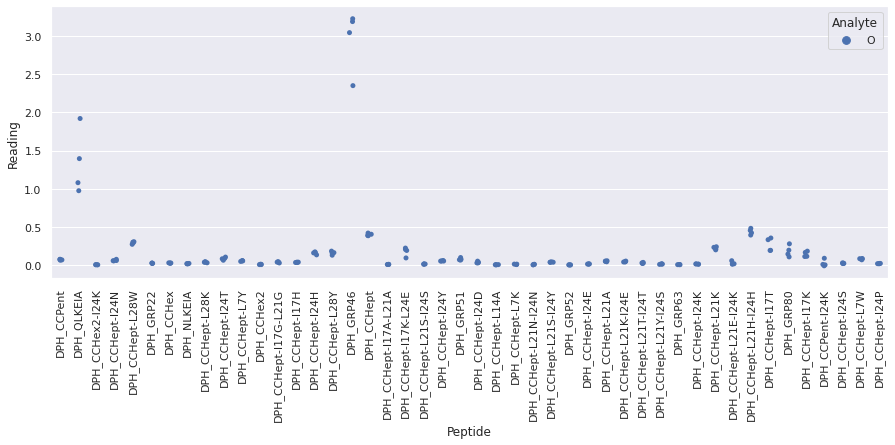

Drawing scatter plot of data spread for P_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

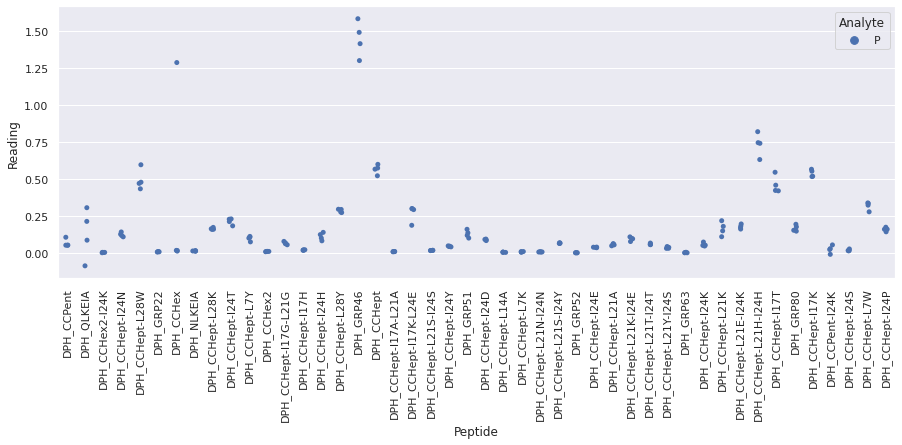

Drawing scatter plot of data spread for B_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

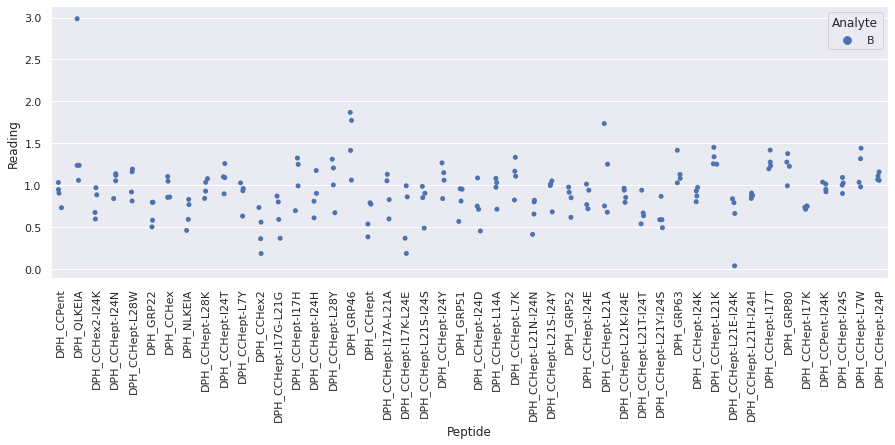

Drawing scatter plot of data spread for D_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

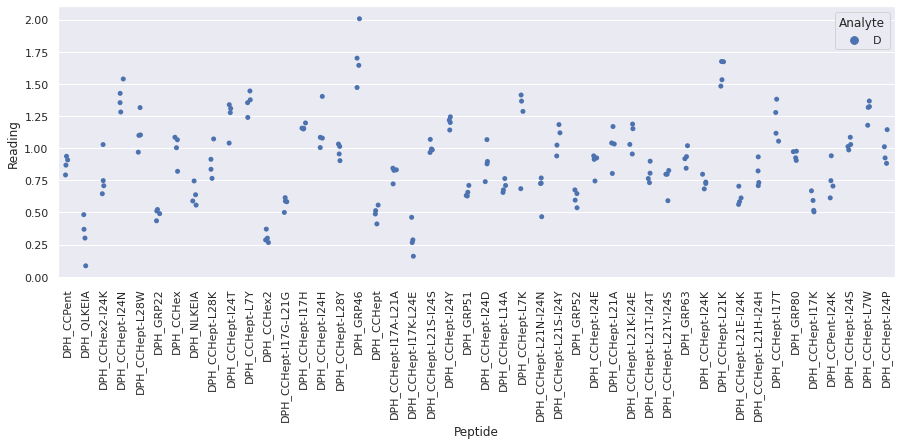

Drawing scatter plot of data spread for N_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

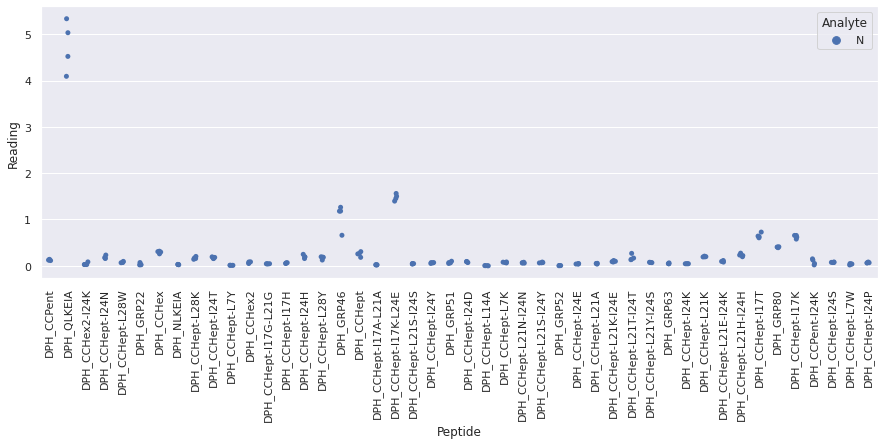

Drawing scatter plot of data spread for O_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

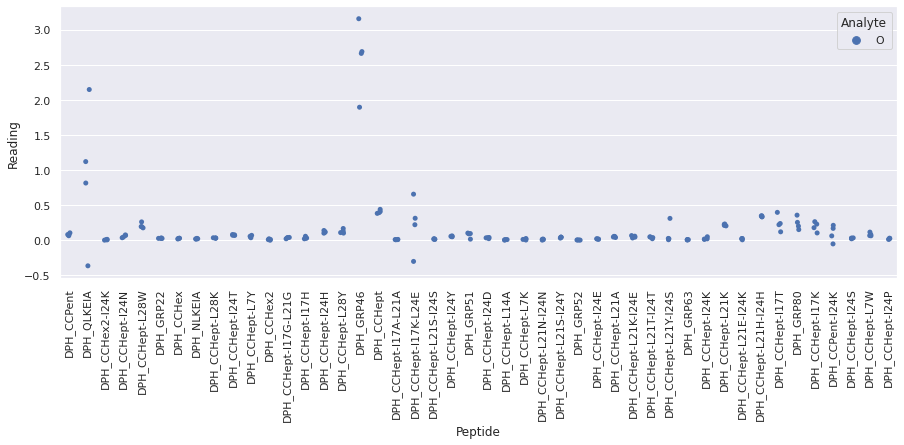

Drawing scatter plot of data spread for P_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

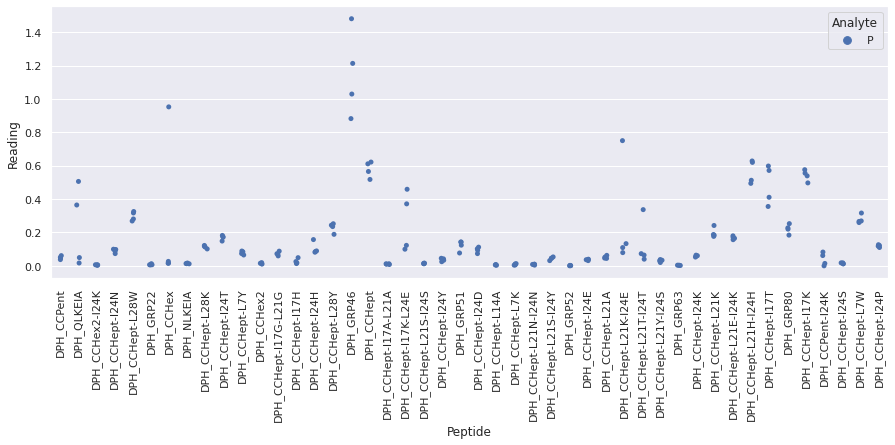

Drawing scatter plot of data spread for B_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

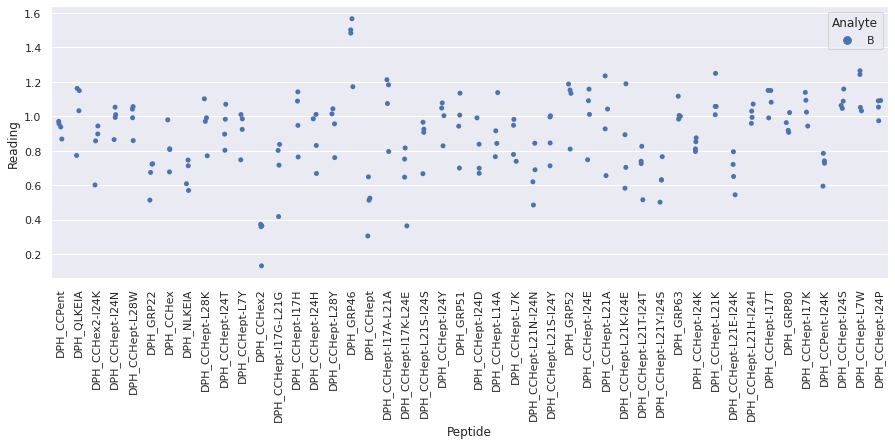

Drawing scatter plot of data spread for D_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

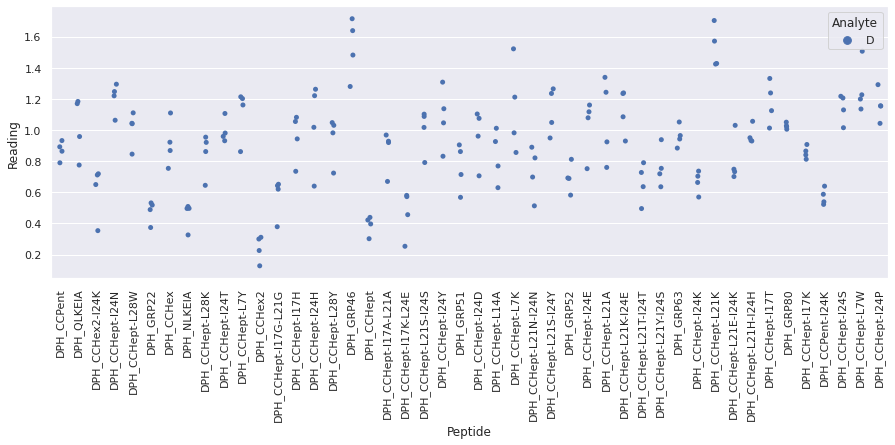

Drawing scatter plot of data spread for N_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

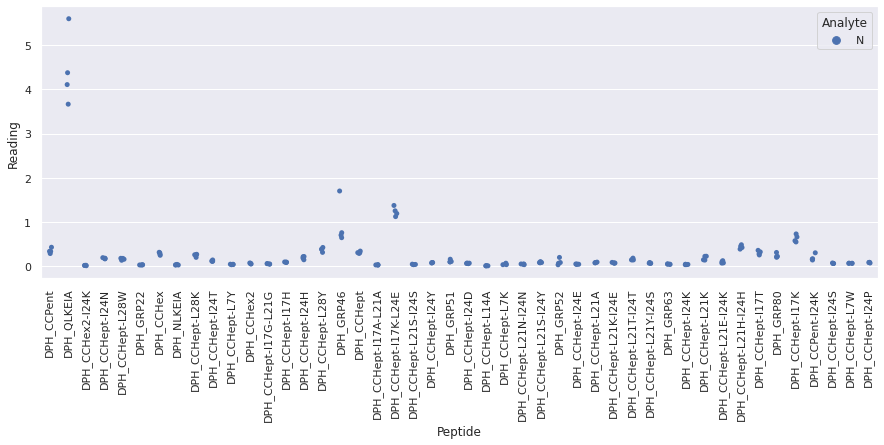

 WARNING - median fluorescence of (O + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

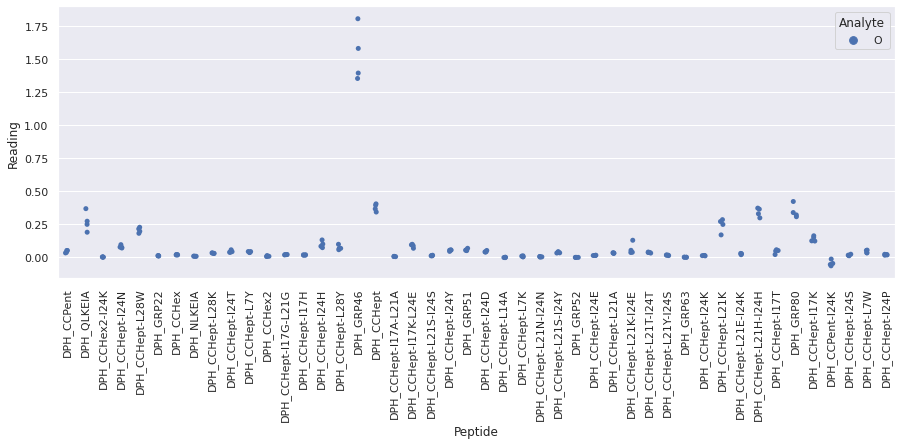

Drawing scatter plot of data spread for P_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

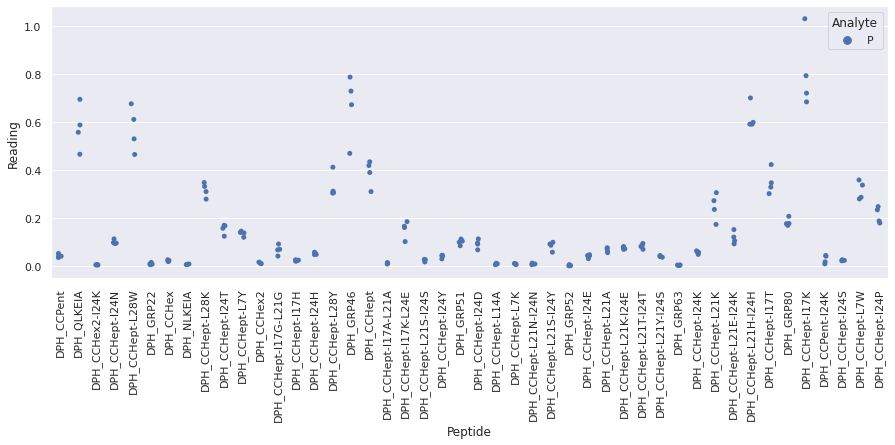

Drawing scatter plot of data spread for B_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

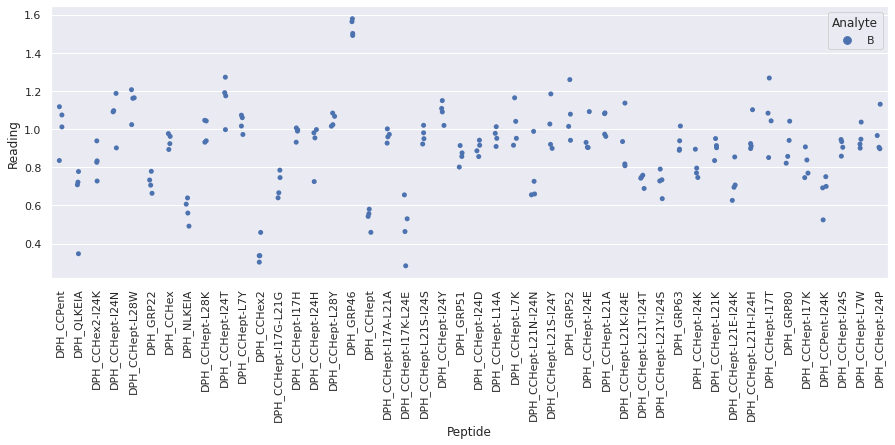

Drawing scatter plot of data spread for D_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

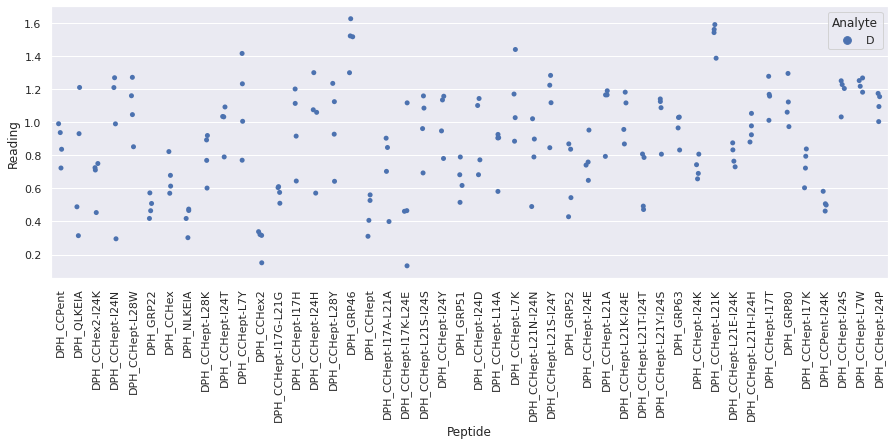

Drawing scatter plot of data spread for N_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

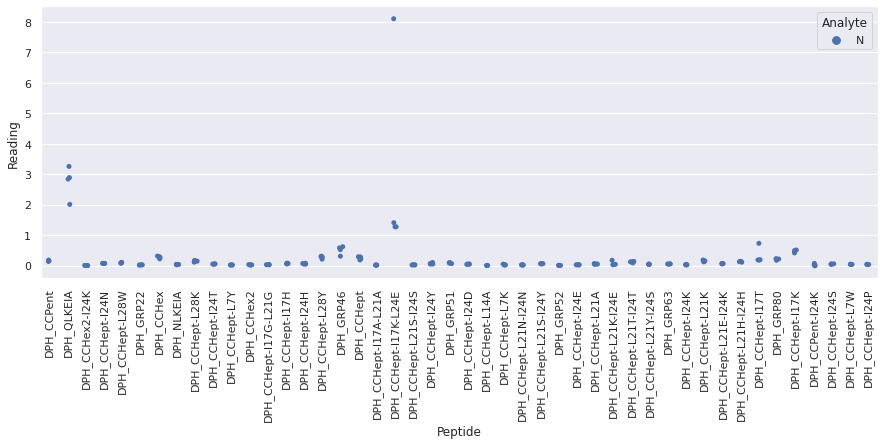

 WARNING - median fluorescence of (O + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on p

<Figure size 720x720 with 0 Axes>

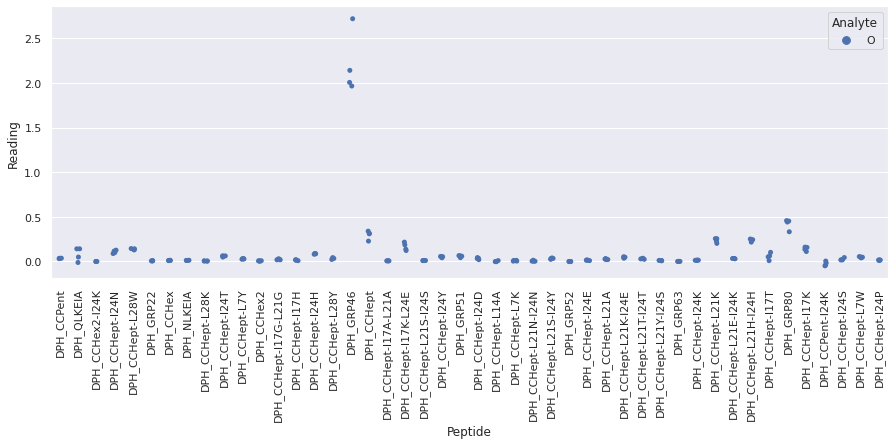

Drawing scatter plot of data spread for P_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

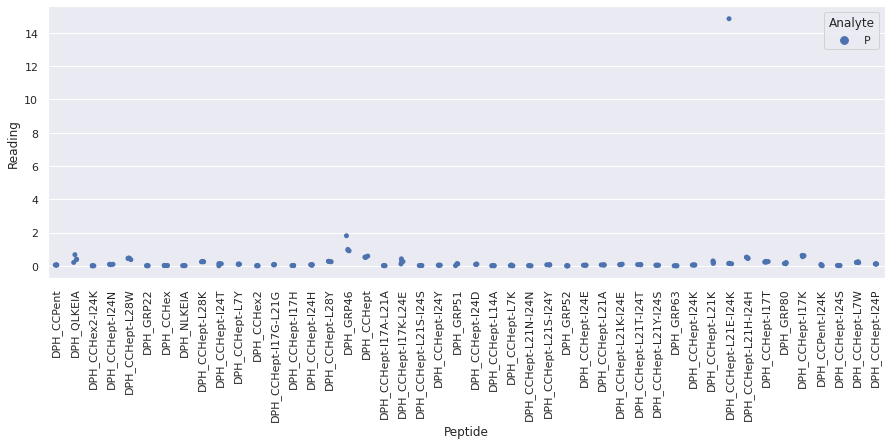

Drawing scatter plot of data spread for B_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

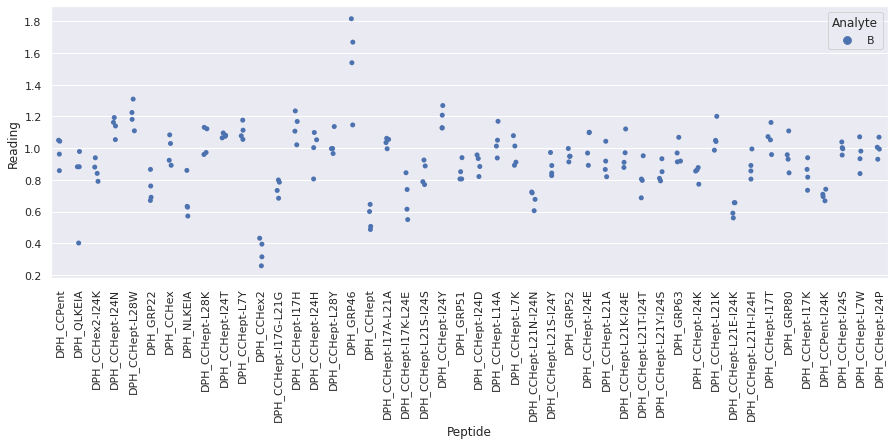

Drawing scatter plot of data spread for D_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

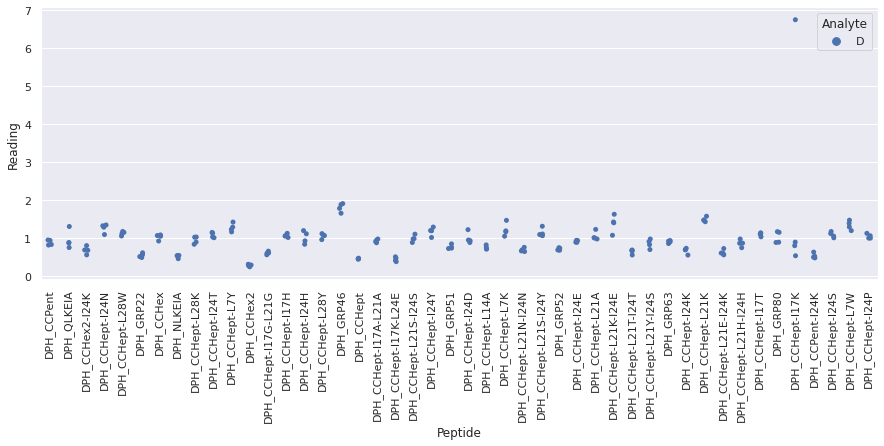

Drawing scatter plot of data spread for N_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

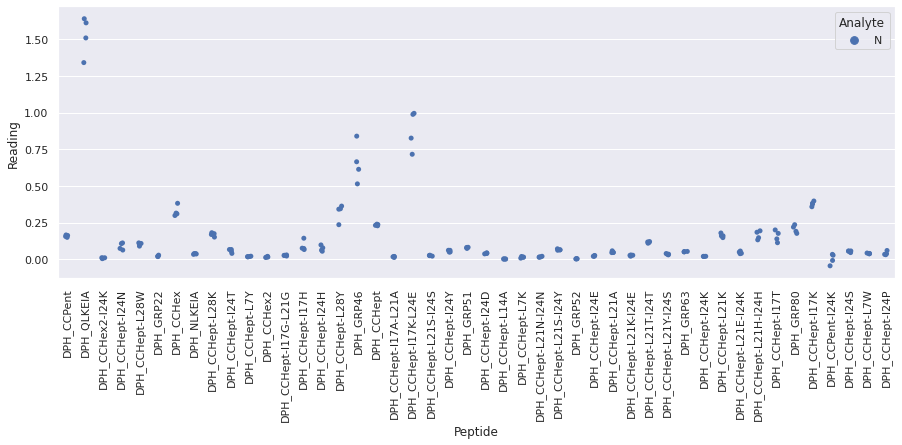

Drawing scatter plot of data spread for O_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

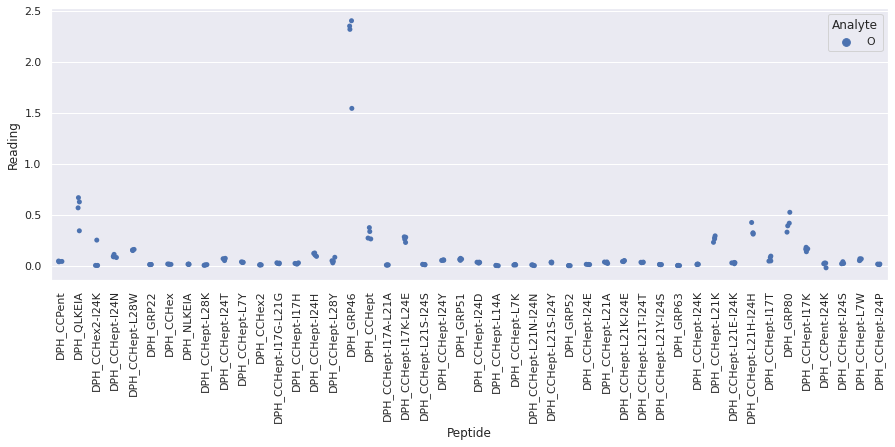

Drawing scatter plot of data spread for P_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

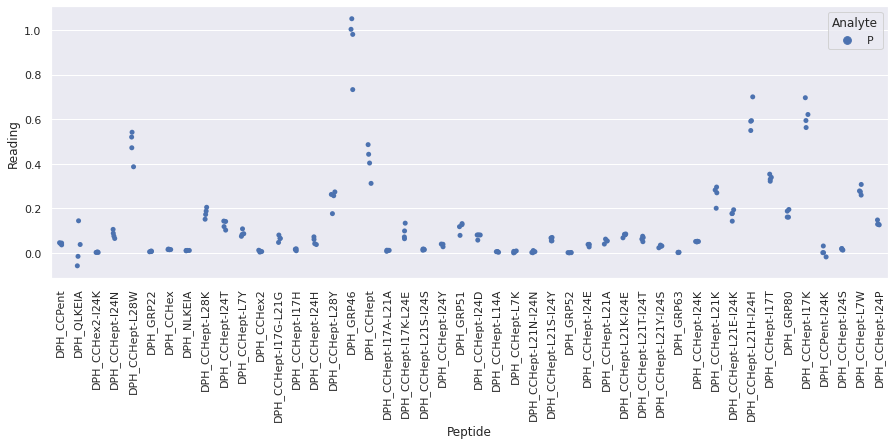

Drawing scatter plot of data spread for B_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

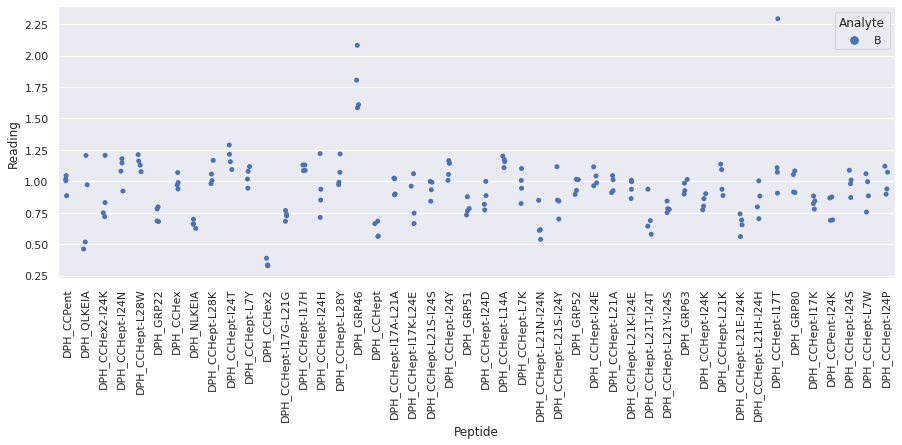

Drawing scatter plot of data spread for D_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

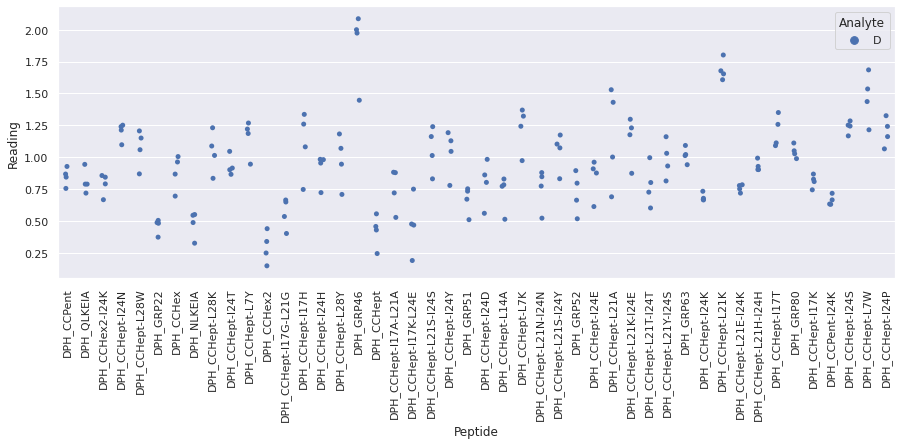

Drawing scatter plot of data spread for N_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

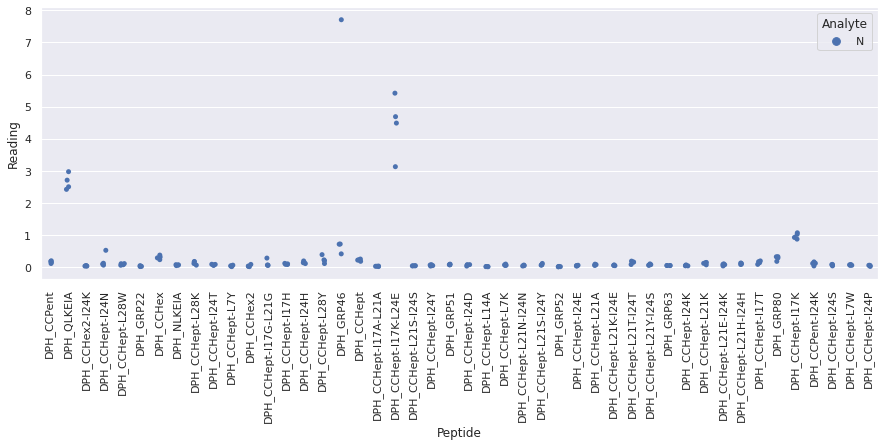

Drawing scatter plot of data spread for O_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

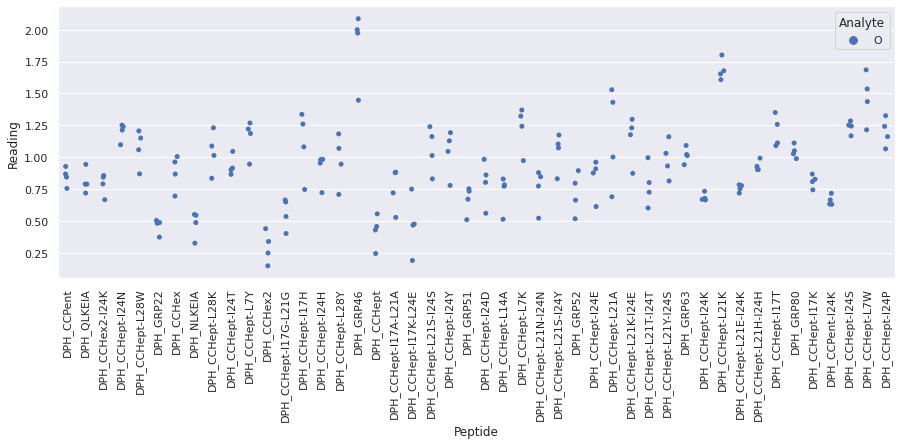

 WARNING - median fluorescence of (P + DPH_QLKEIA + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHex2 + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (P + fluorophore) alone on 

<Figure size 720x720 with 0 Axes>

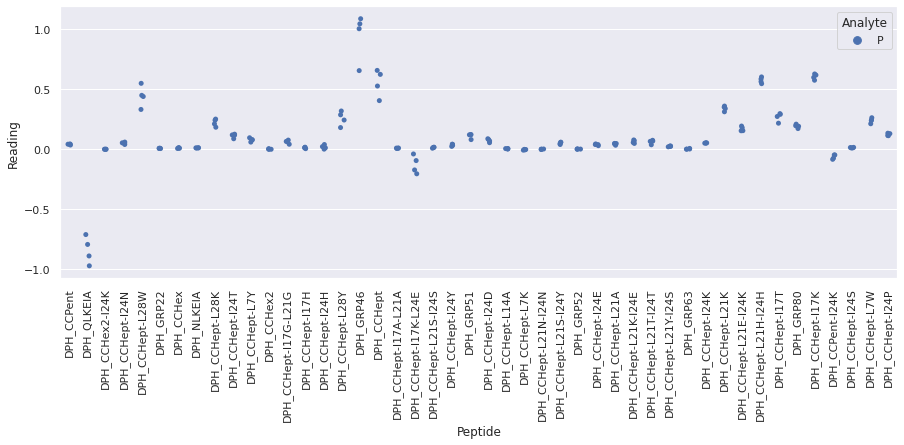

Drawing scatter plot of data spread for B_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

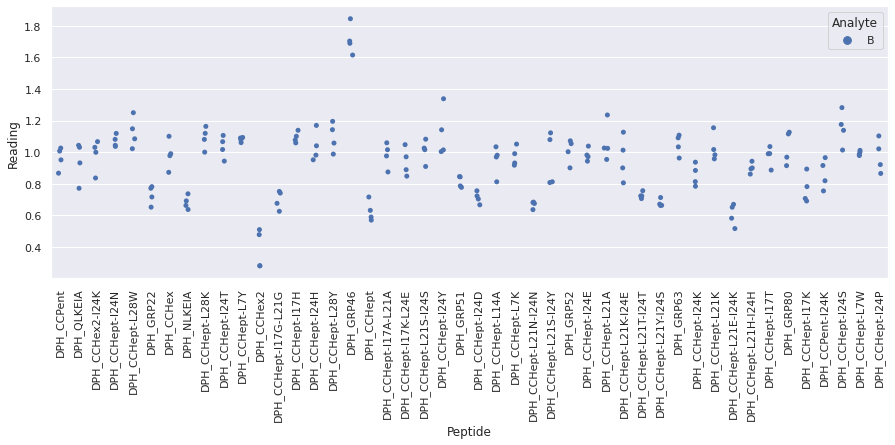

Drawing scatter plot of data spread for D_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

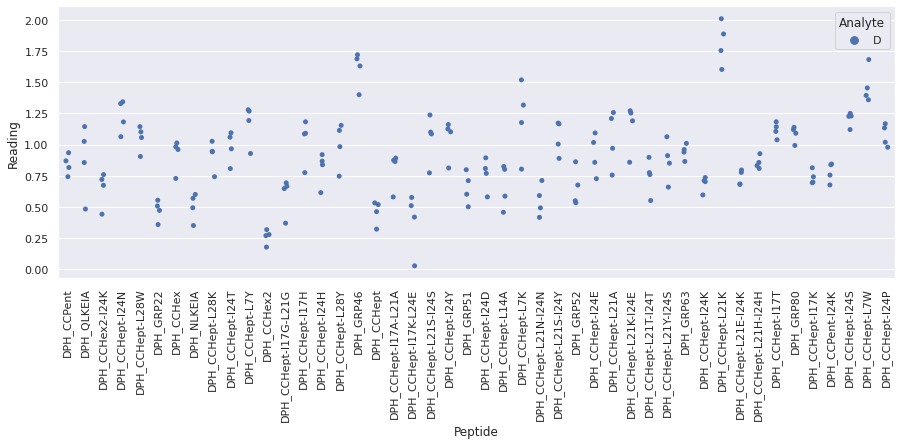

Drawing scatter plot of data spread for N_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

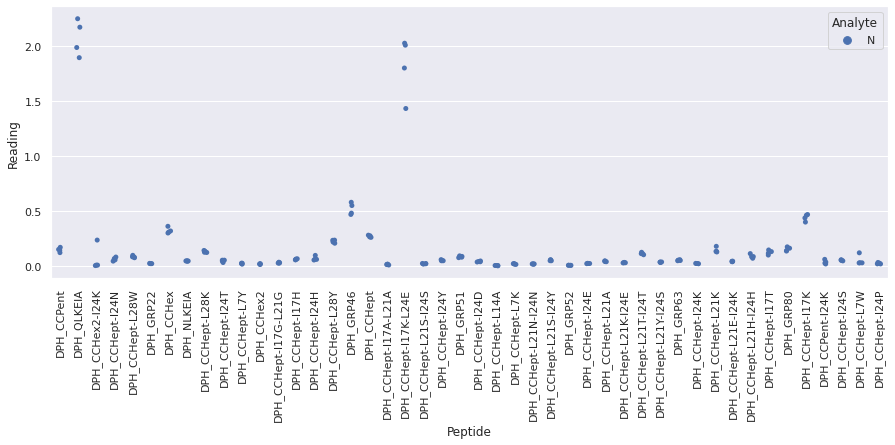

 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

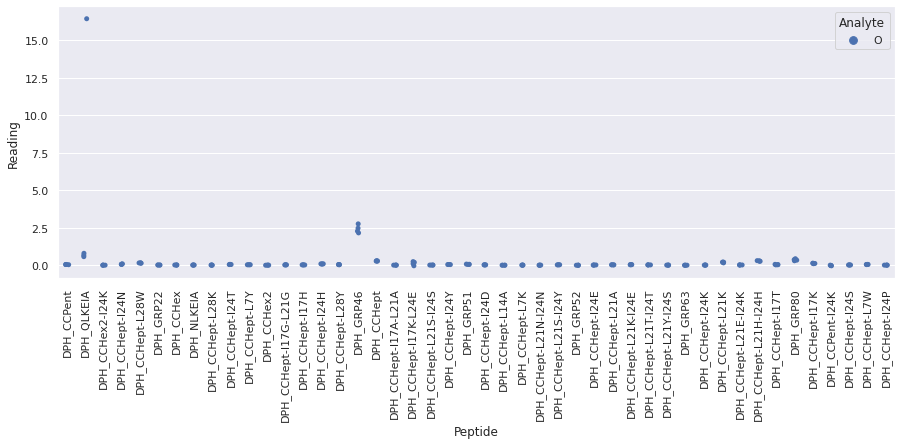

Drawing scatter plot of data spread for P_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

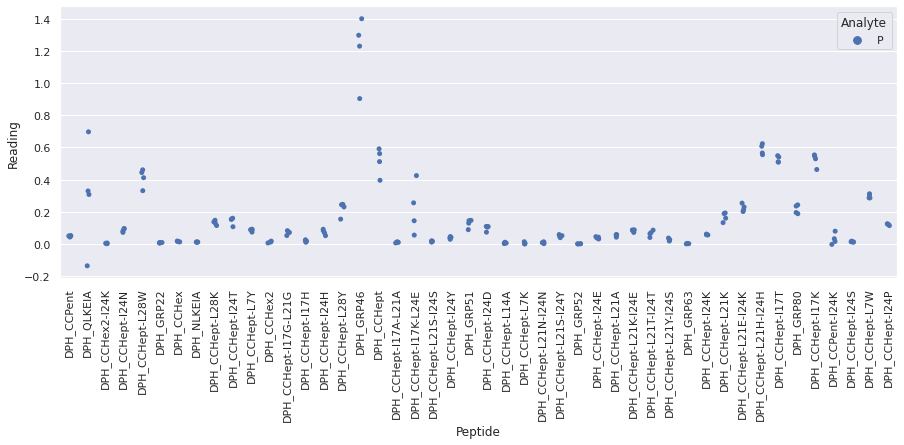



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: blank, DPH_CCHept-L28Y, 14387.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: blank, DPH_CCHept-I17K-L24E, 858.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: B, DPH_CCHept-L7Y, 5924.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: B, DPH_GRP51, 17187.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_GRP52, 48839.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_CCHept-L21T-I24T, 8211.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_CCHept-L21E-I24K, 

In [13]:
fa_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='FA'
)

At a glance:
- Plate O_repeat_9.xlsx looks anomalous - looks like there might have been a mix up between samples, as the signal looks more like that of a solution of D (or possibly B) rather than O. Repeat plate parsing excluding this plate. There is also an unusually high reading on P_repeat_7.xlsx, but this will be discarded when averaging the data by calculating the median, and the other readings on the plate look OK. Otherwise, there are no other plates that by eye are obviously anomalous.
- Similarly to the AA data, the fluorescence of peptides GRP35, QLKEIA and CCHept-I17K-L24E in the presence of DPH is very similar to that of DPH on its own (which is reassuring, given that this is a comparison of the interaction of the fluorophore with the peptide in the absence of analyte).
- The fluorescence of GRP46 with DPH is slightly higher as compared to these three peptides, but still pretty low (like a few other peptides in the dataset). What marks it out as unusual though is that the addition of the shorter-tailed FAs often causes the net fluorescence signal with this peptide to increase. So, in spite of the fact that this causes the resultant scaled readings to be large, this is not necessarily a problem provided that these readings are consistent (and in fact they could prove very useful in discriminating between the analytes given the differences in their readings described above). Will make an assessment based upon the variation observed aross repeats in the box plots below. 
- The FAs, especially those with longer tails and/or cis C=C bonds, cause a large decrease in DPH signal. Accordingly, more warnings are raised for this dataset, because in many cases the analyte effectively completely displaces DPH from interacting with the peptide => the signal of (analyte + peptide + DPH) will be similar to that of (analyte + DPH). Hence in some cases (analyte + peptide + DPH) will be smaller than (analyte + DPH). These warnings can therefore be safely ignored.

Directory /home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/All_small_molecules/FA_plate_parsing_plots/ already found in /home/ks17361/ML_environment/BADASS/array_sensing
Overwrite /home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/All_small_molecules/FA_plate_parsing_plots/?
y
Successfully removed O_repeat_9.xlsx
Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx
Drawing scatter plot of data spread for B_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

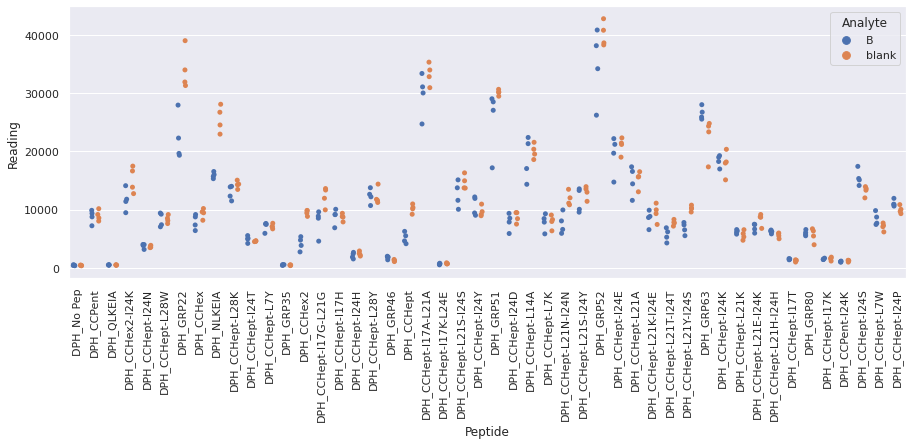

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx
Drawing scatter plot of data spread for D_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

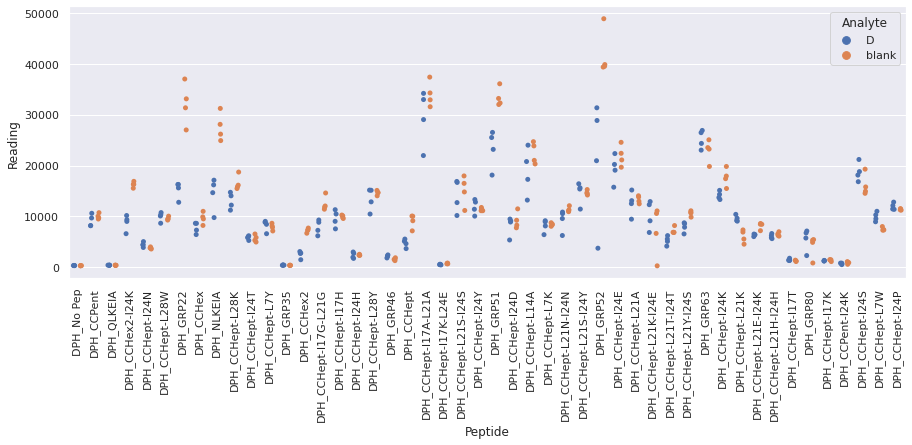

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_1.xlsx
Drawing scatter plot of data spread for N_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

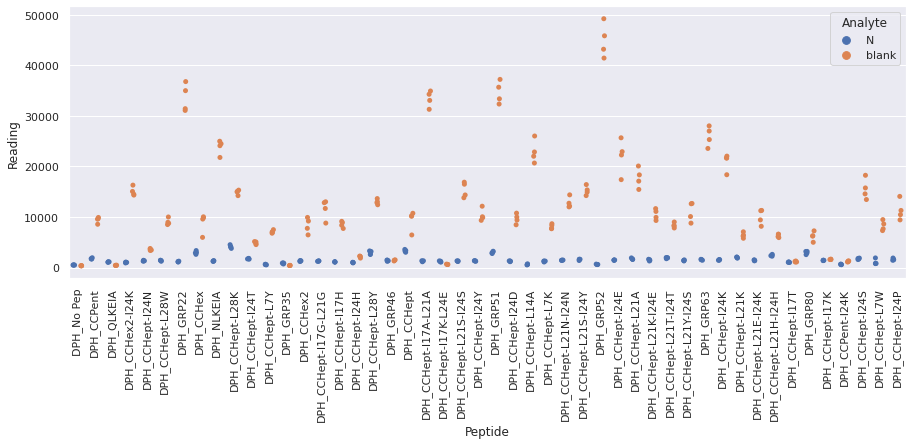

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_1.xlsx
Drawing scatter plot of data spread for O_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

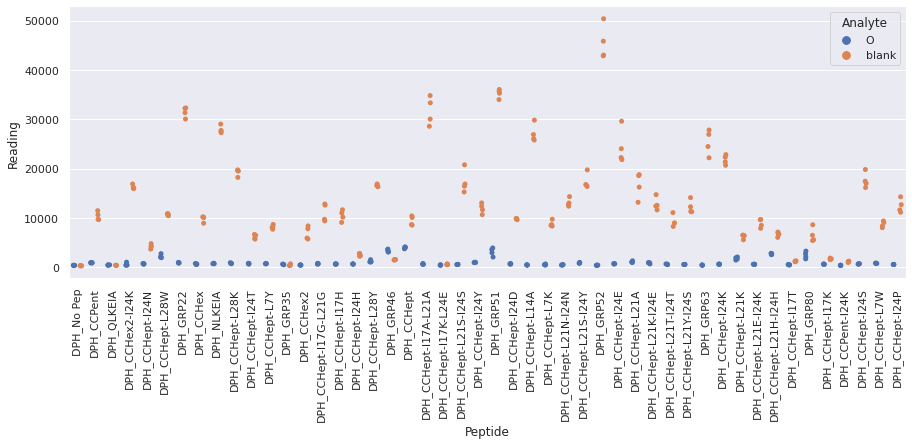

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_1.xlsx
Drawing scatter plot of data spread for P_repeat_1 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

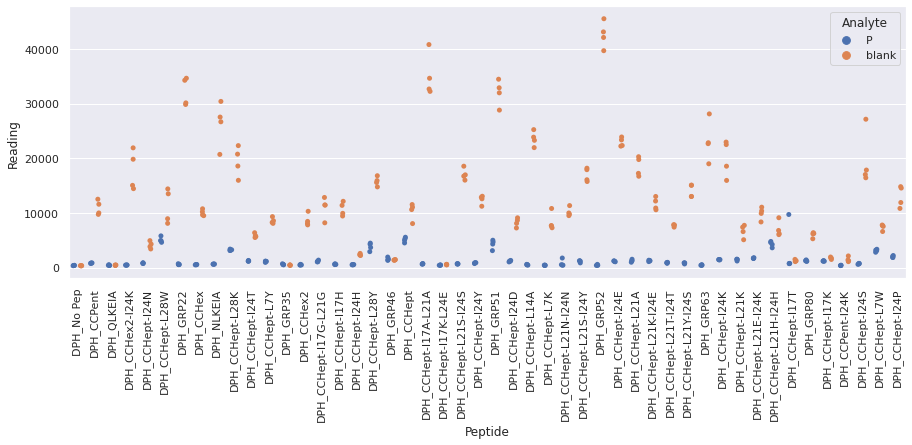

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_2.xlsx
Drawing scatter plot of data spread for B_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

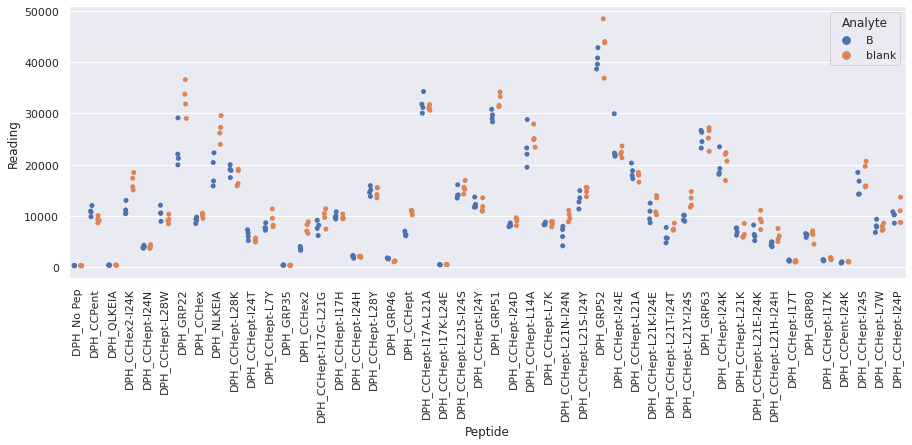

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_2.xlsx
Drawing scatter plot of data spread for D_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

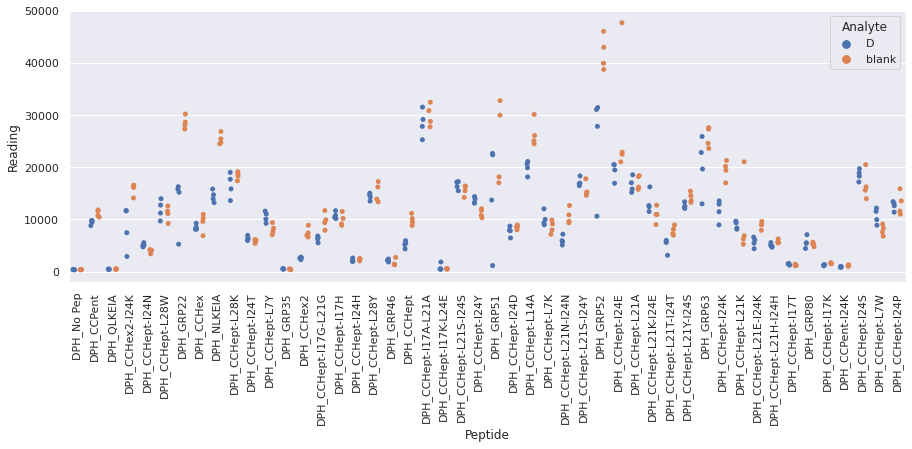

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_2.xlsx
Drawing scatter plot of data spread for N_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

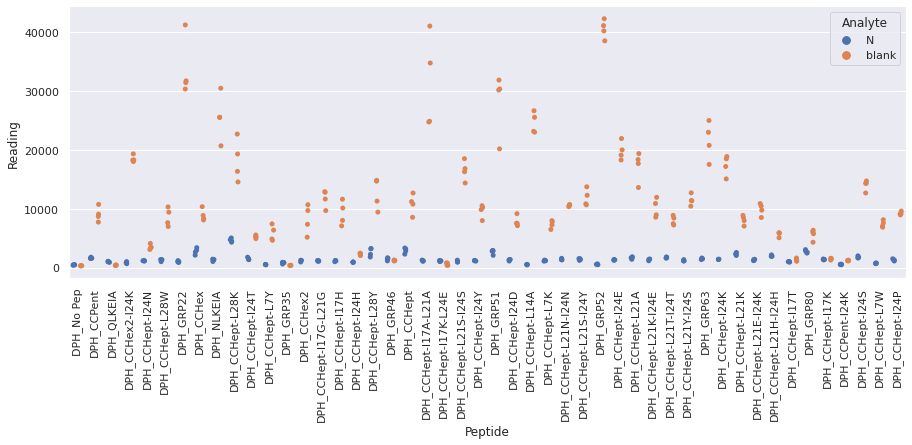

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_2.xlsx
Drawing scatter plot of data spread for O_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

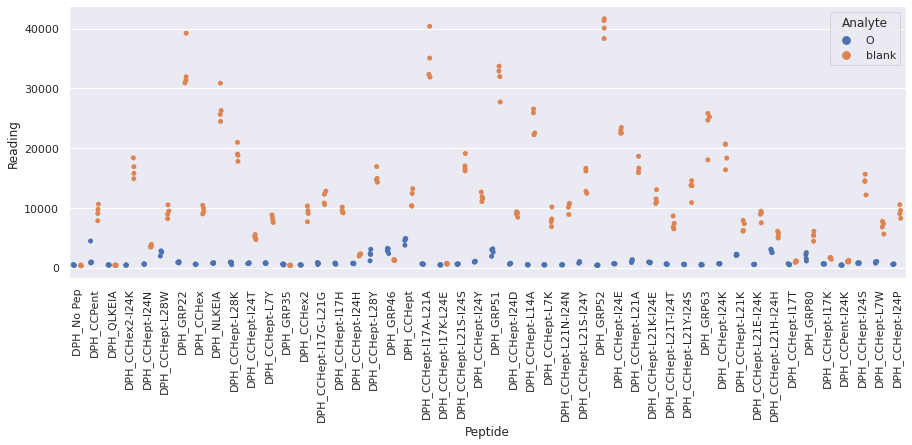

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_2.xlsx
Drawing scatter plot of data spread for P_repeat_2 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

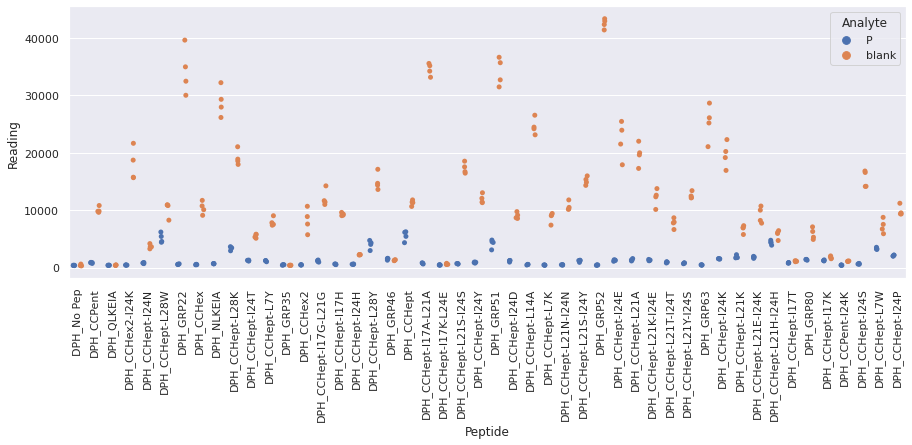

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_3.xlsx
Drawing scatter plot of data spread for B_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

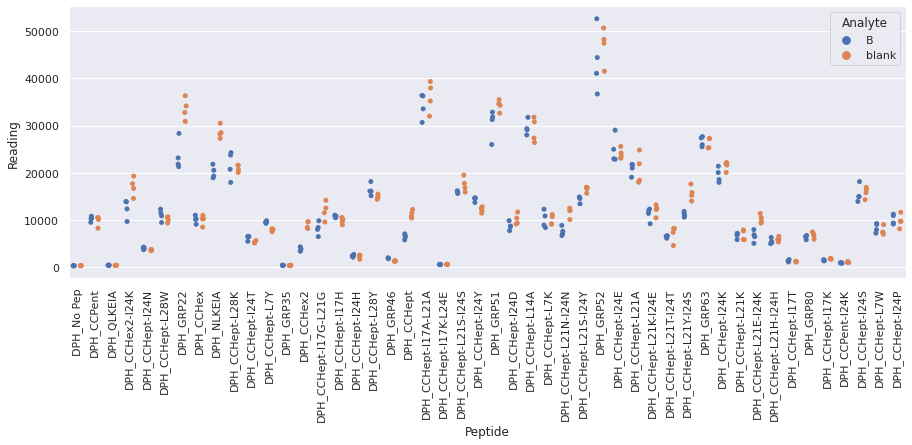

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_3.xlsx
Drawing scatter plot of data spread for D_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

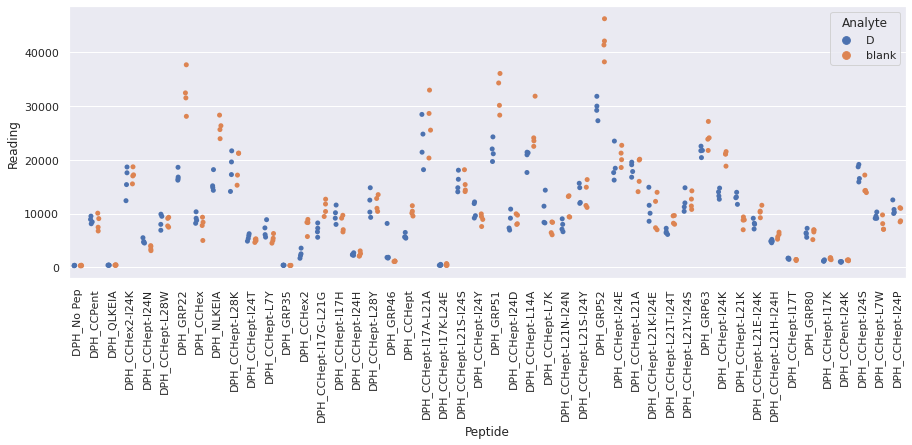

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_3.xlsx
Drawing scatter plot of data spread for N_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

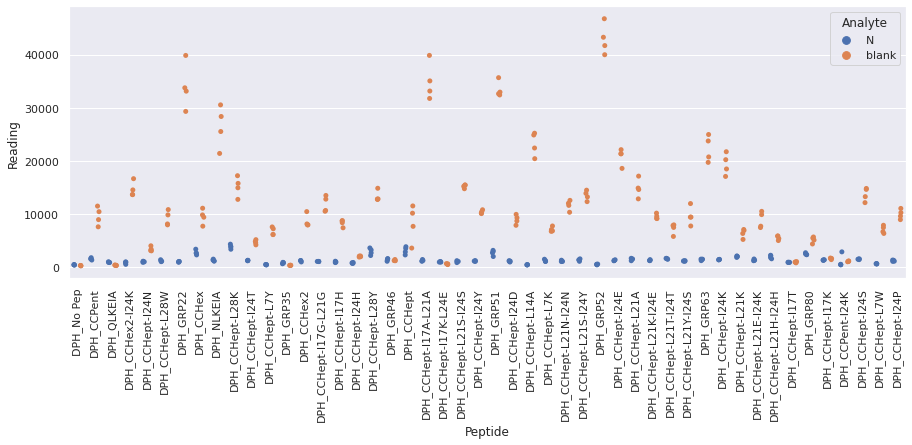

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx
Drawing scatter plot of data spread for O_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

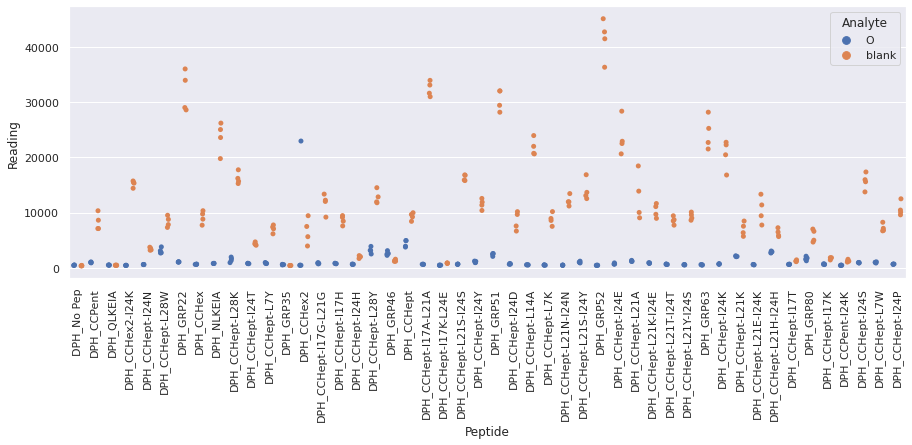

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx
Drawing scatter plot of data spread for P_repeat_3 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

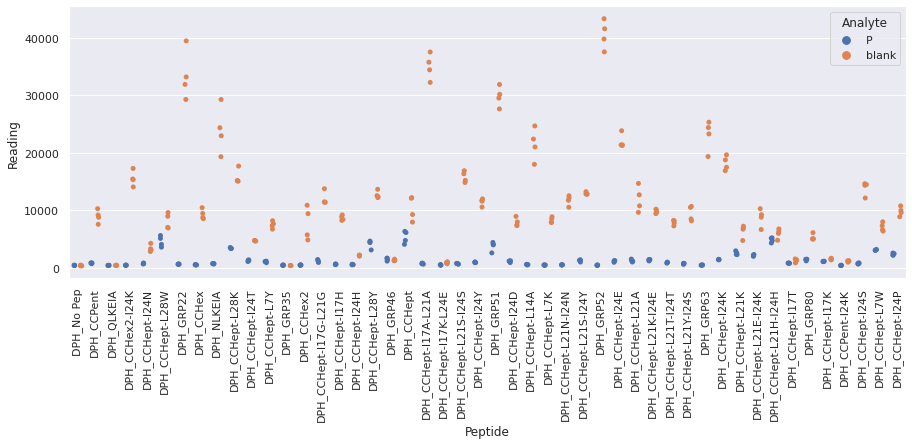

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_4.xlsx
Drawing scatter plot of data spread for B_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

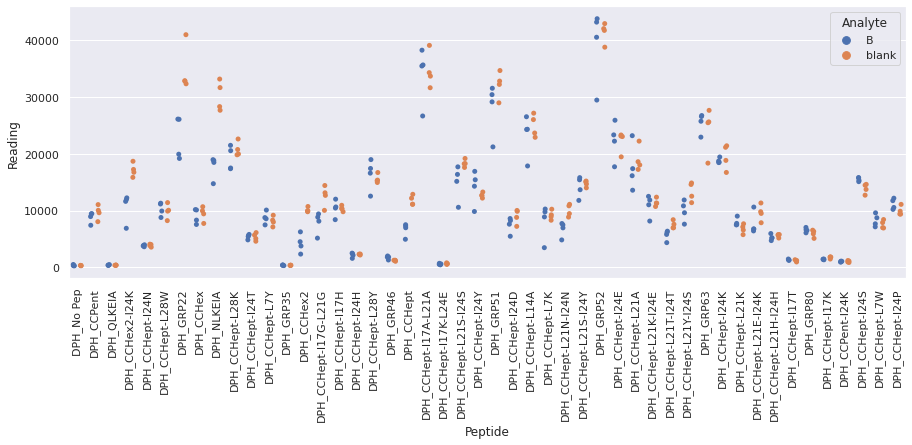

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_4.xlsx
Drawing scatter plot of data spread for D_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

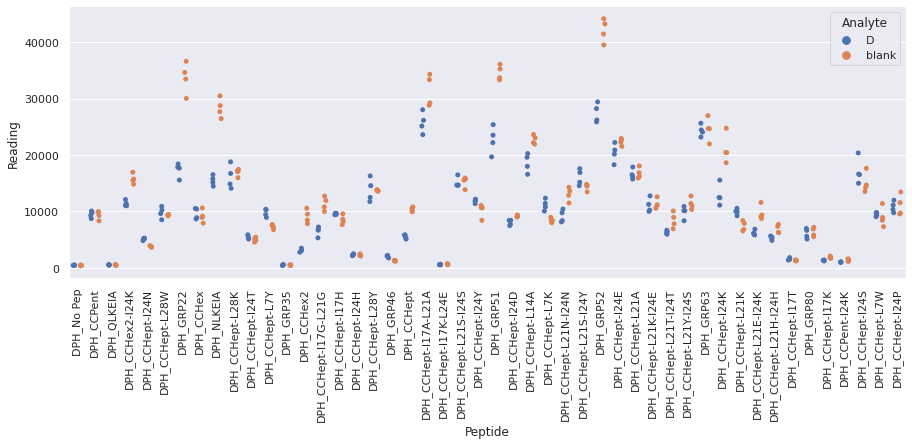

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_4.xlsx
Drawing scatter plot of data spread for N_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

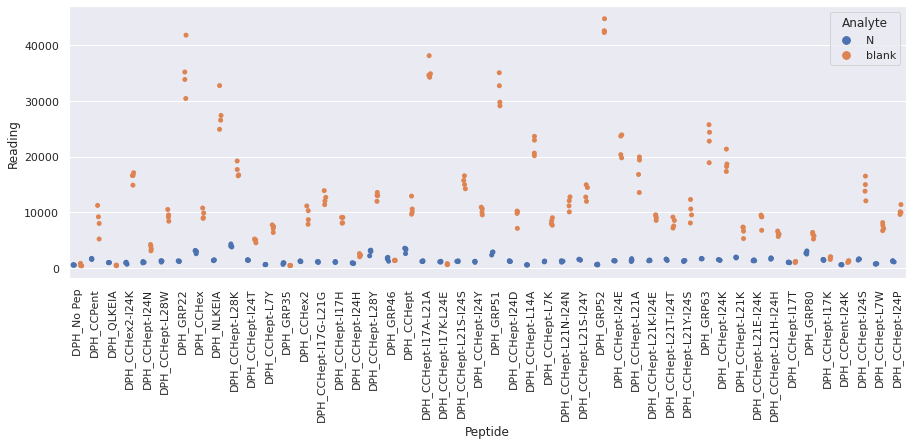

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_4.xlsx
Drawing scatter plot of data spread for O_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

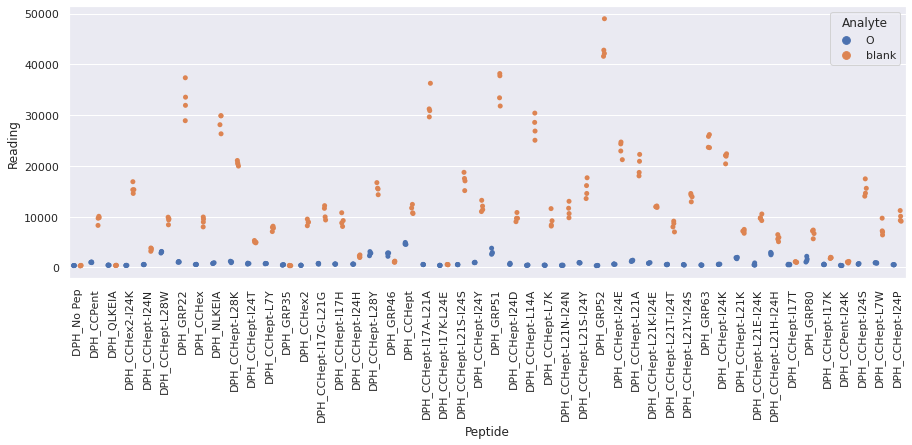

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_4.xlsx
Drawing scatter plot of data spread for P_repeat_4 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

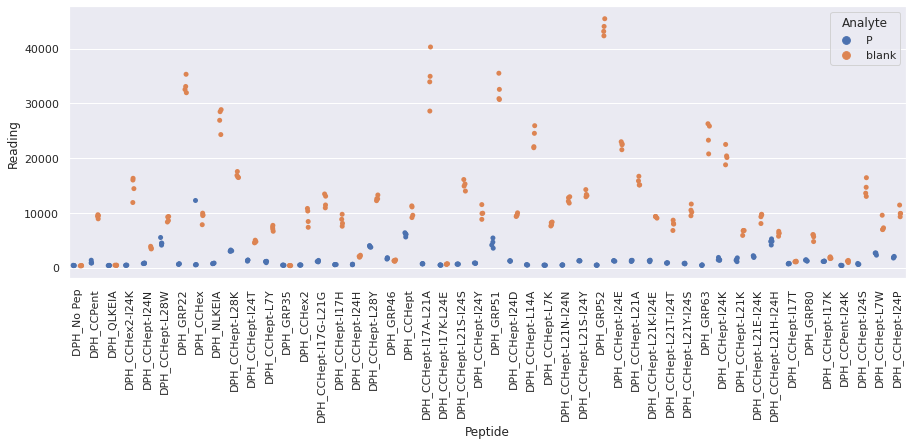

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_5.xlsx
Drawing scatter plot of data spread for B_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

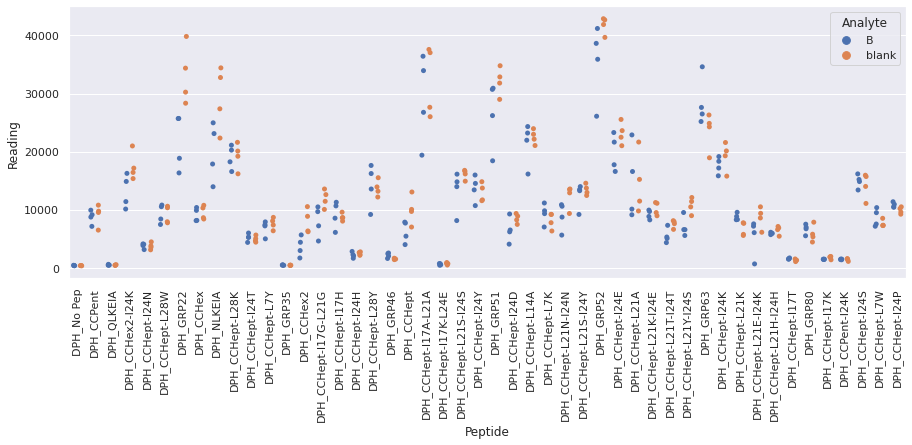

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_5.xlsx
Drawing scatter plot of data spread for D_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

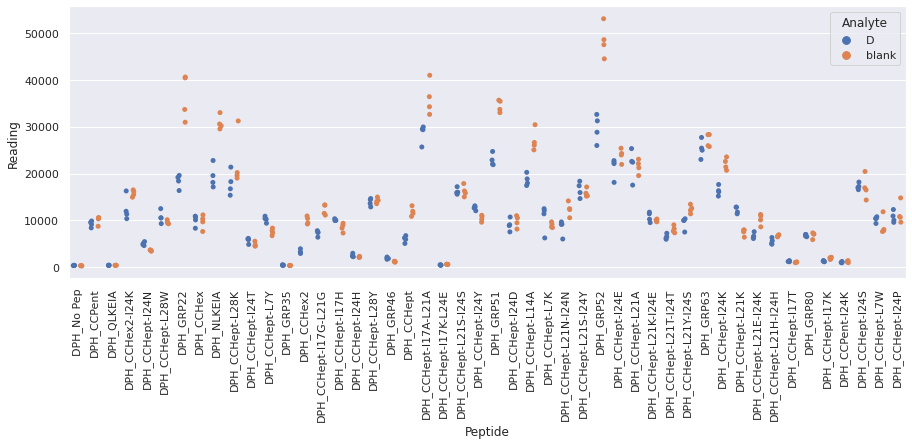

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_5.xlsx
Drawing scatter plot of data spread for N_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

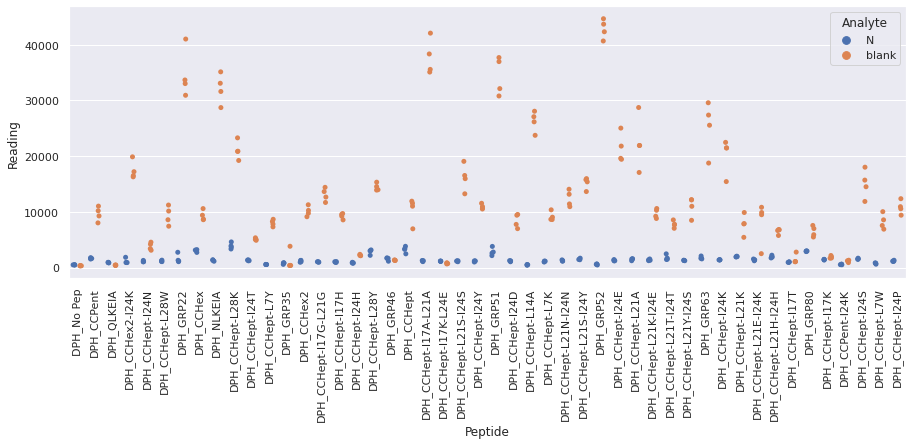

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_5.xlsx
Drawing scatter plot of data spread for O_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

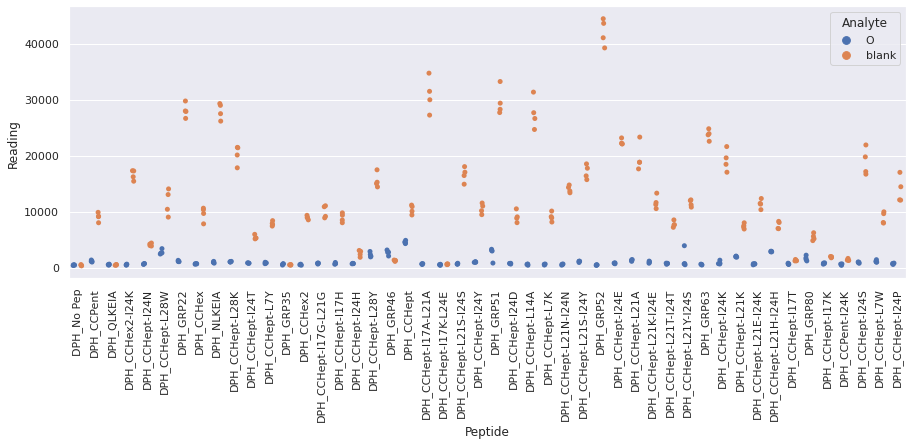

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_5.xlsx
Drawing scatter plot of data spread for P_repeat_5 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

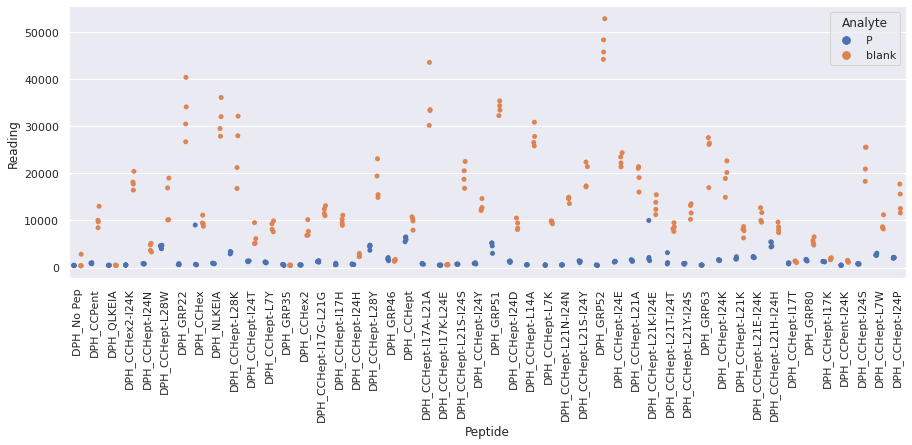

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_6.xlsx
Drawing scatter plot of data spread for B_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

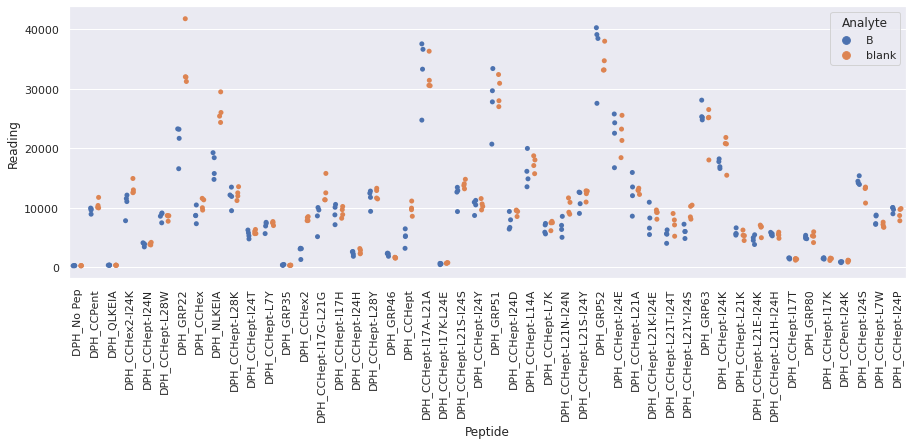

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_6.xlsx
Drawing scatter plot of data spread for D_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

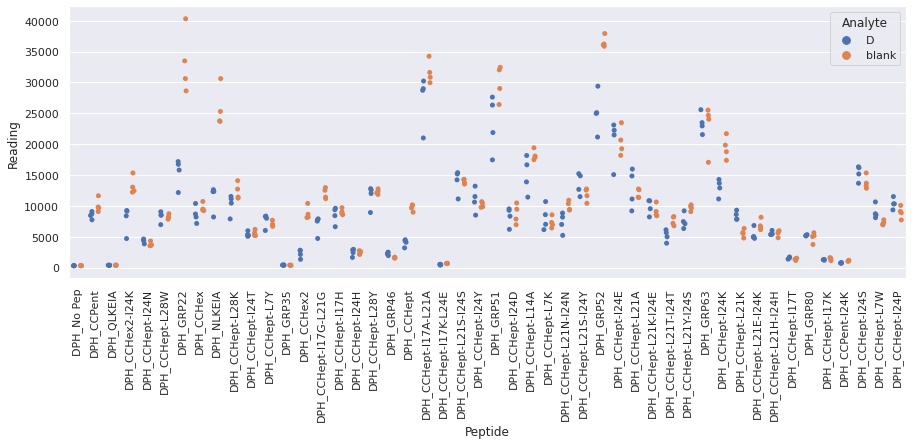

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_6.xlsx
Drawing scatter plot of data spread for N_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

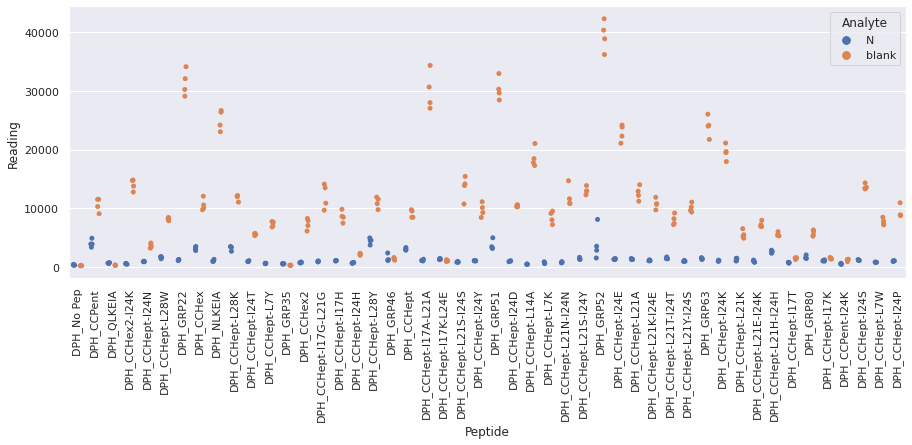

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx
Drawing scatter plot of data spread for O_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

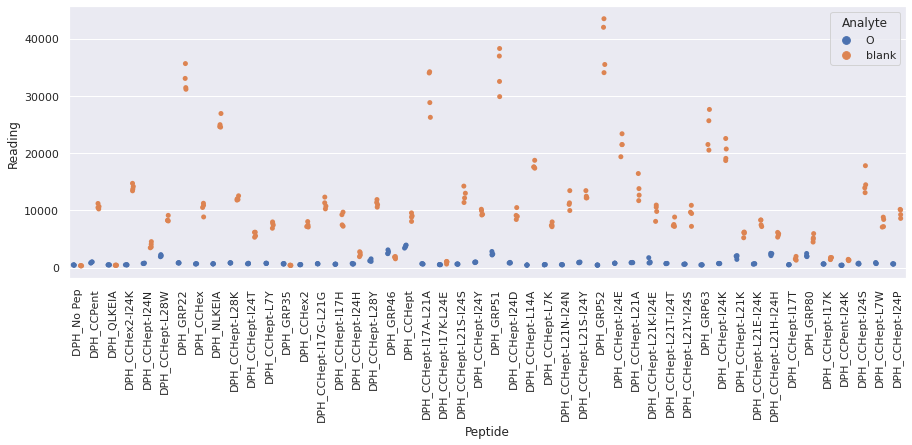

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_6.xlsx
Drawing scatter plot of data spread for P_repeat_6 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

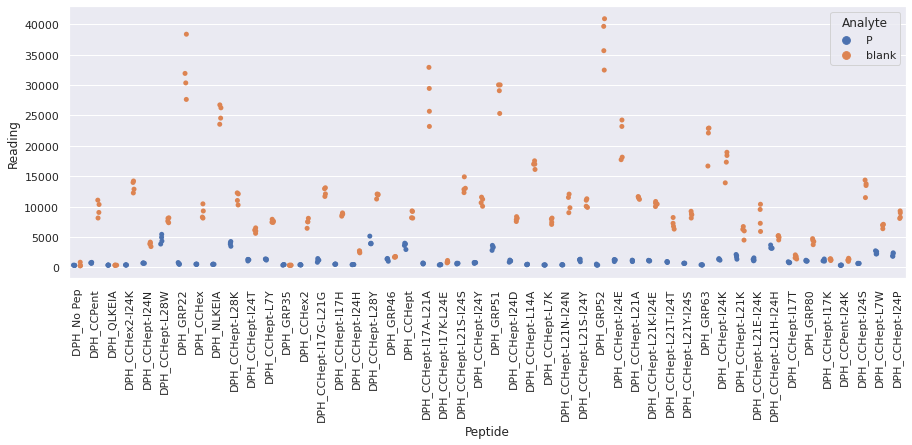

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_7.xlsx
Drawing scatter plot of data spread for B_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

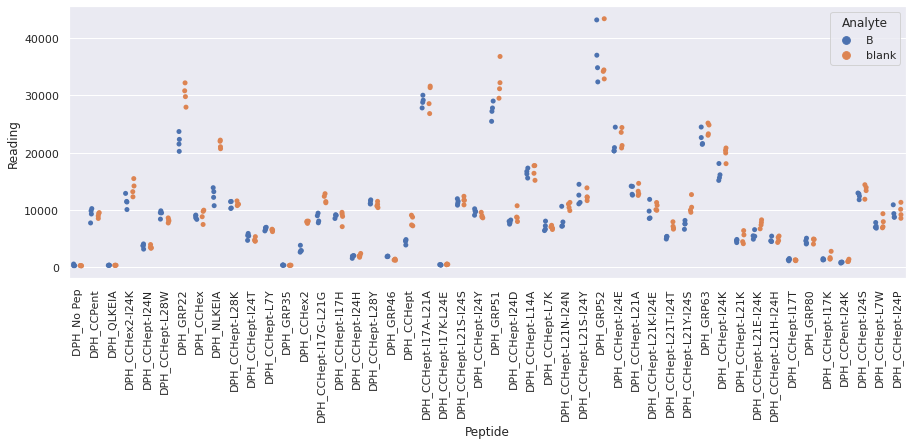

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_7.xlsx
Drawing scatter plot of data spread for D_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

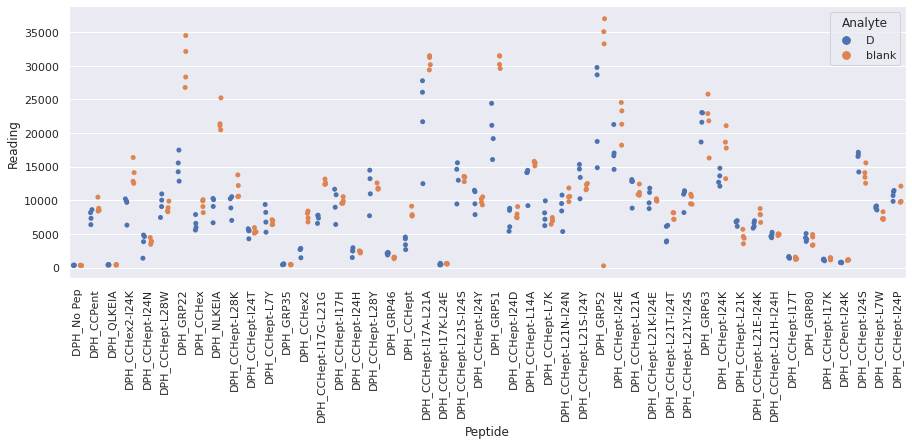

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_7.xlsx
Drawing scatter plot of data spread for N_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

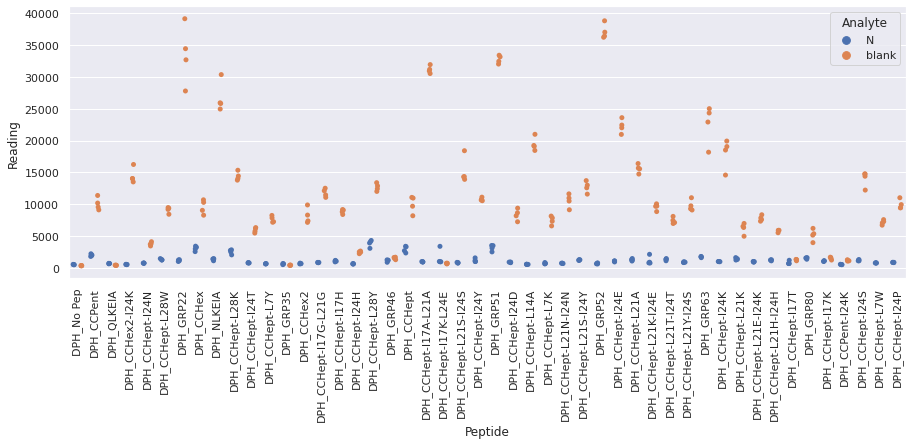

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx
Drawing scatter plot of data spread for O_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

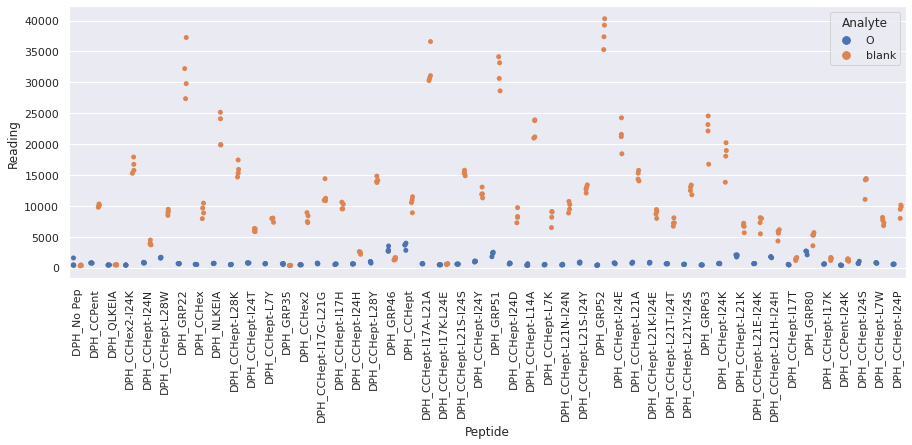

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_7.xlsx
Drawing scatter plot of data spread for P_repeat_7 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

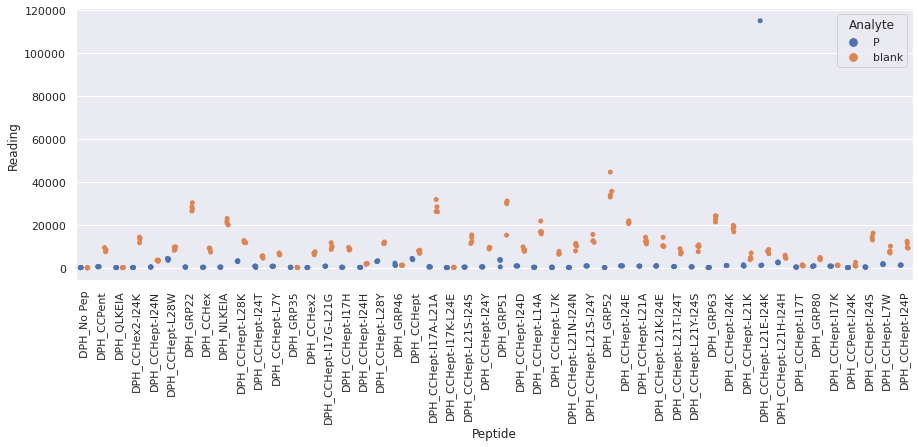

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_8.xlsx
Drawing scatter plot of data spread for B_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

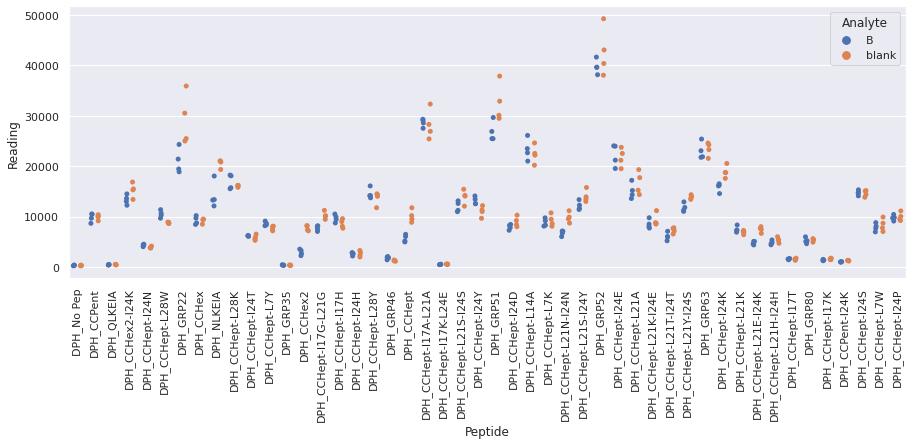

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_8.xlsx
Drawing scatter plot of data spread for D_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

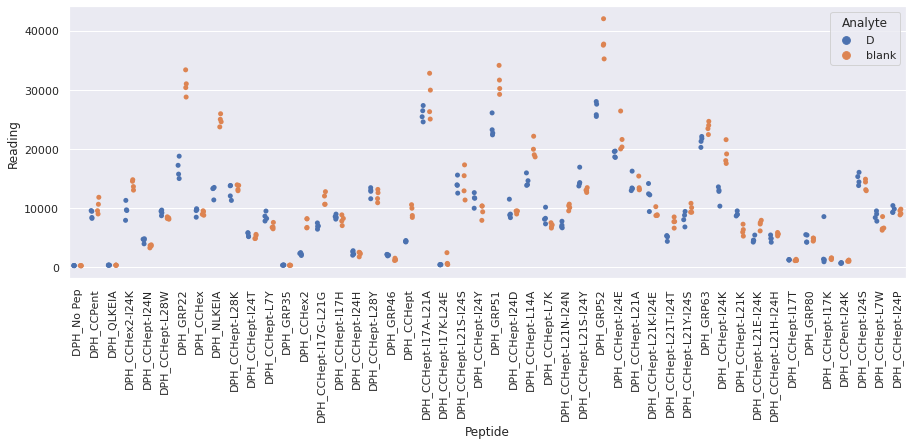

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_8.xlsx
Drawing scatter plot of data spread for N_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

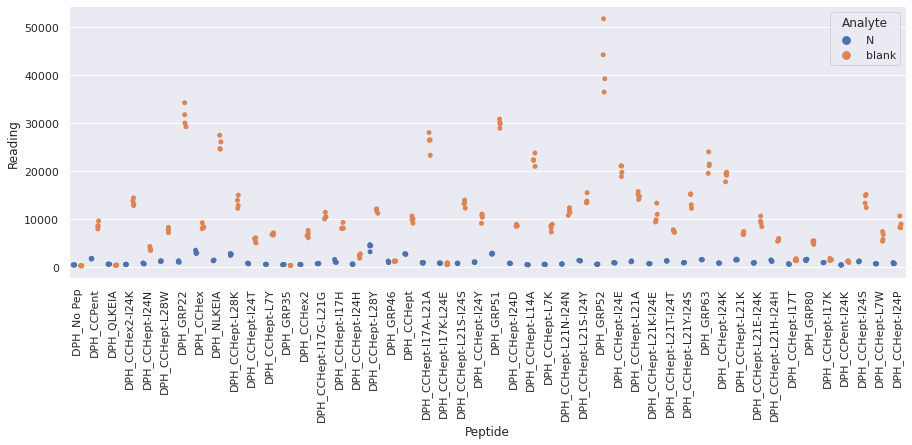

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_8.xlsx
Drawing scatter plot of data spread for O_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

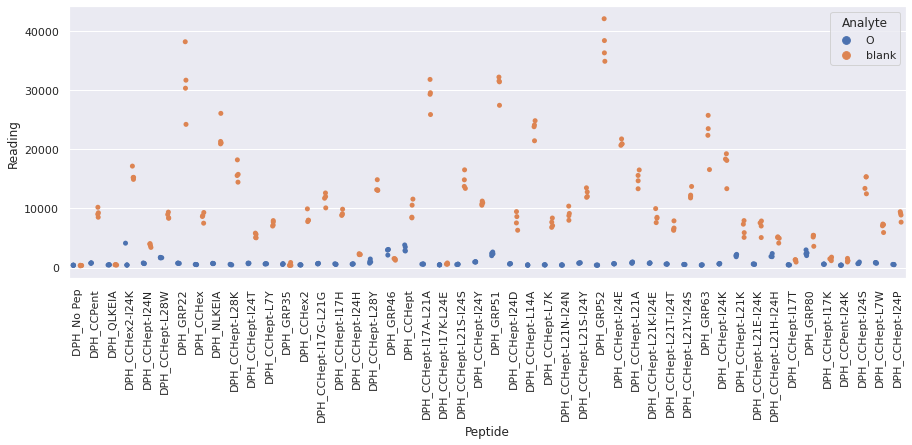

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_8.xlsx
Drawing scatter plot of data spread for P_repeat_8 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

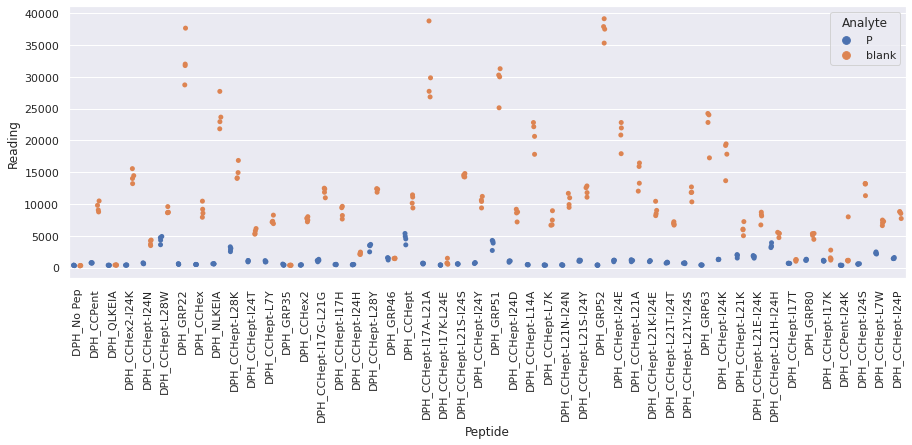

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_9.xlsx
Drawing scatter plot of data spread for B_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

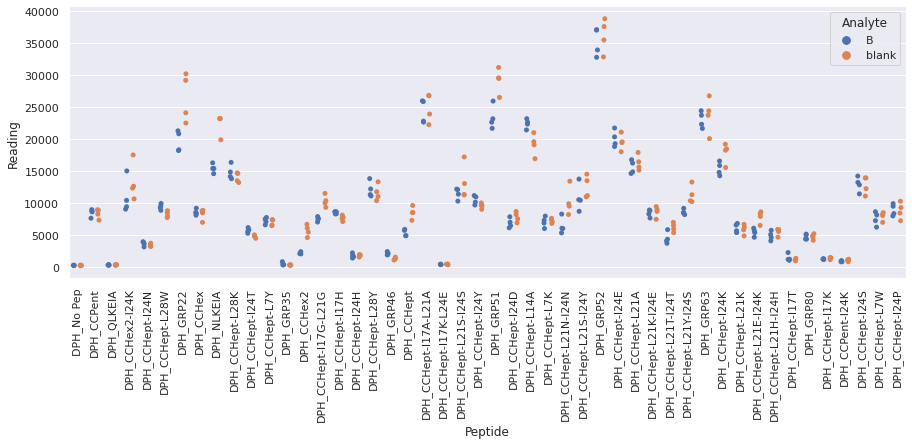

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_9.xlsx
Drawing scatter plot of data spread for D_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

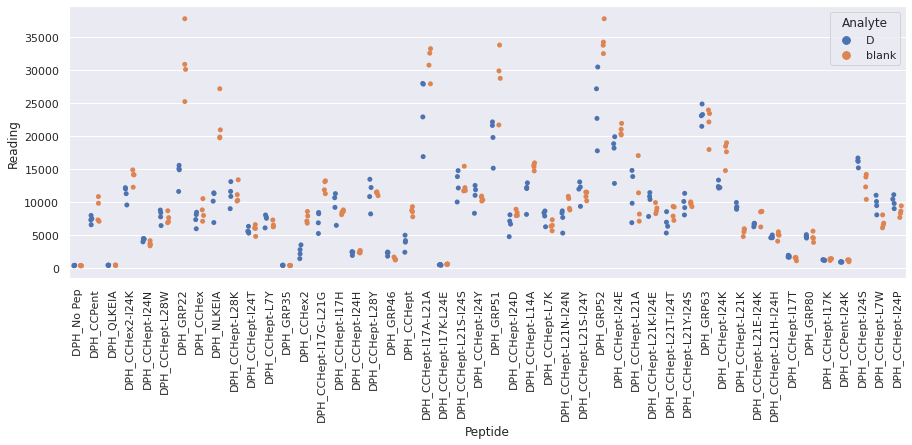

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_9.xlsx
Drawing scatter plot of data spread for N_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

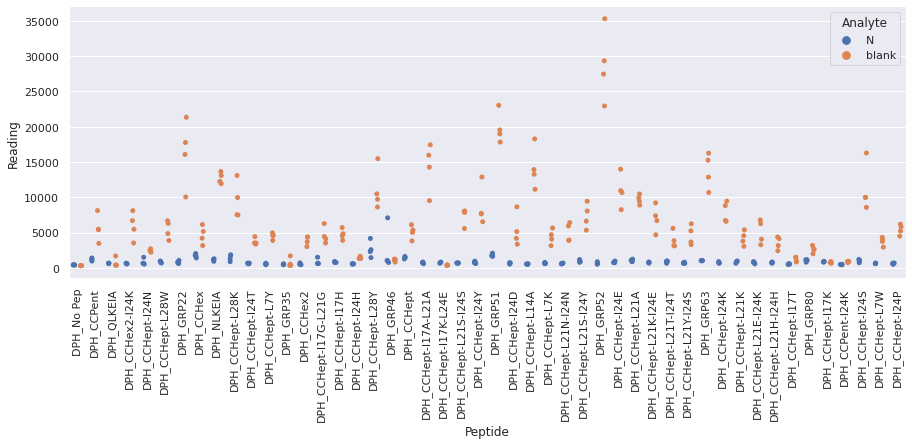

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx
Drawing scatter plot of data spread for P_repeat_9 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

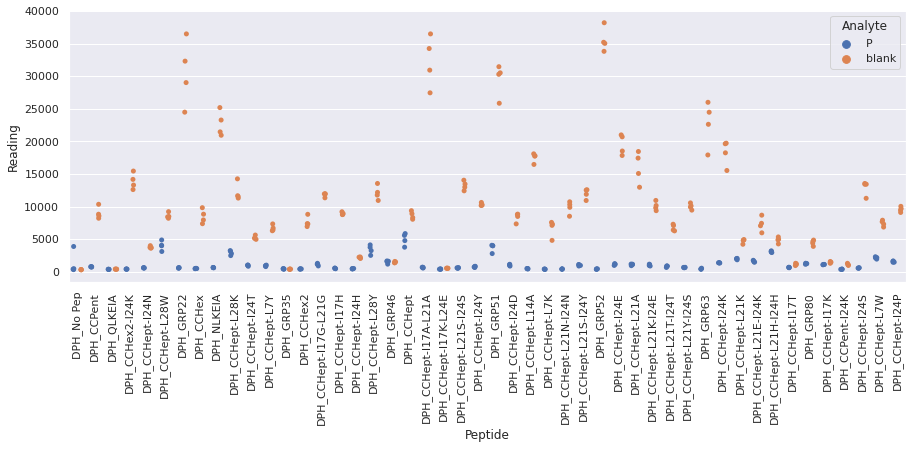

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_10.xlsx
Drawing scatter plot of data spread for B_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

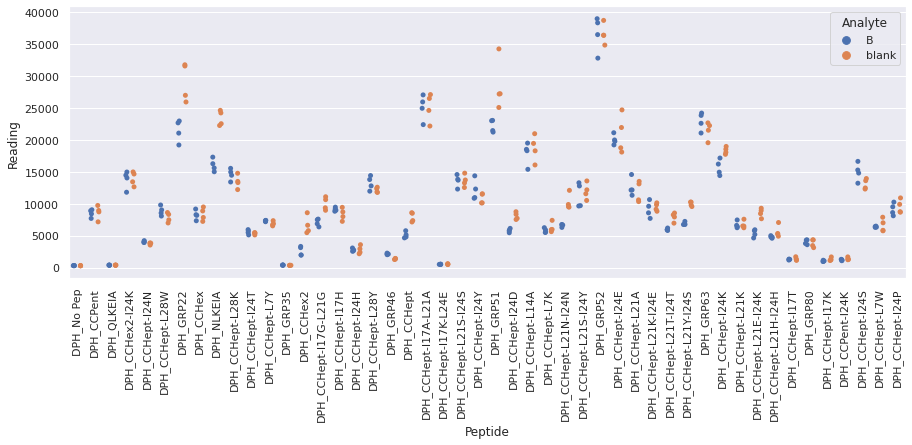

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_10.xlsx
Drawing scatter plot of data spread for D_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

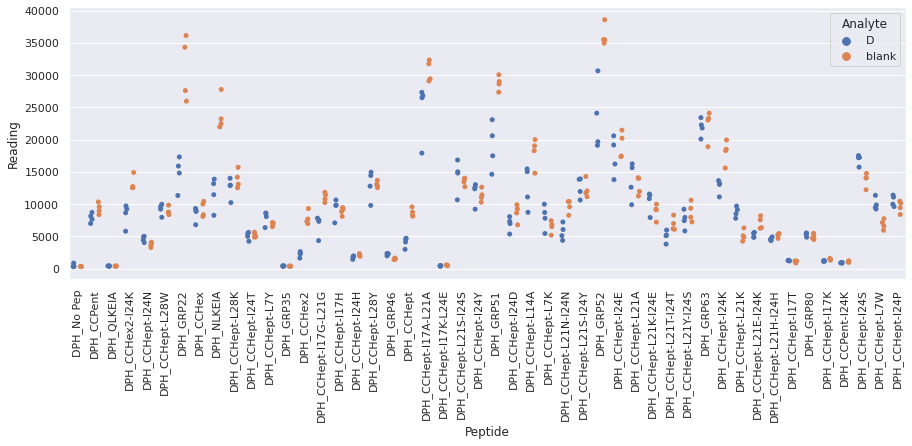

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_10.xlsx
Drawing scatter plot of data spread for N_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

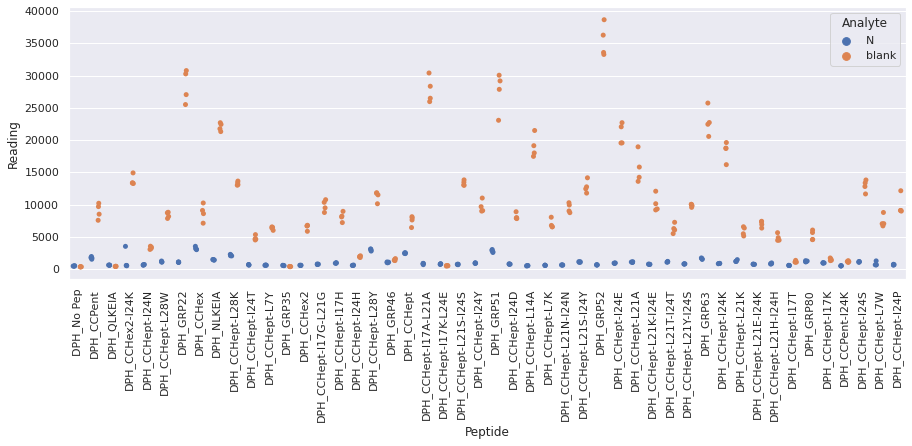

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx
Drawing scatter plot of data spread for O_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

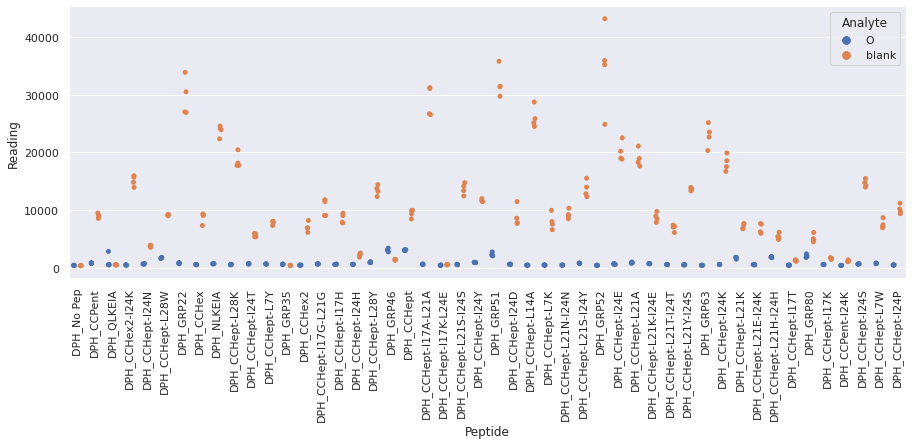

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_10.xlsx
Drawing scatter plot of data spread for P_repeat_10 in FA_unscaled_data


<Figure size 720x720 with 0 Axes>

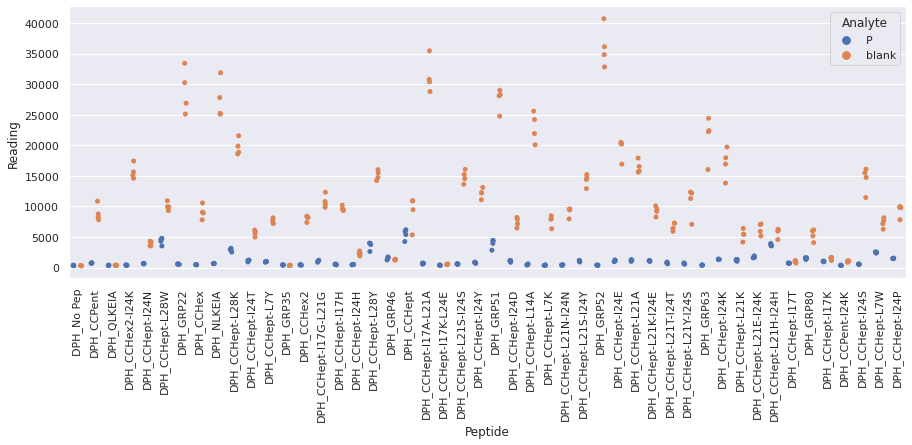

Drawing scatter plot of data spread for B_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

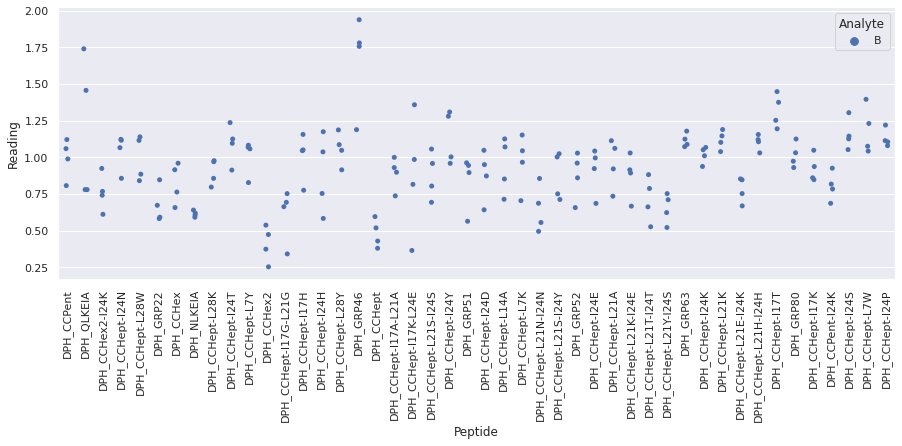

Drawing scatter plot of data spread for D_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

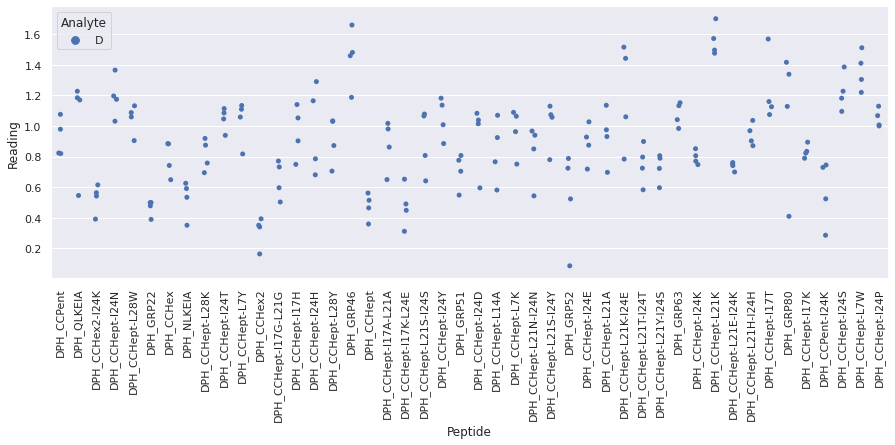

Drawing scatter plot of data spread for N_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

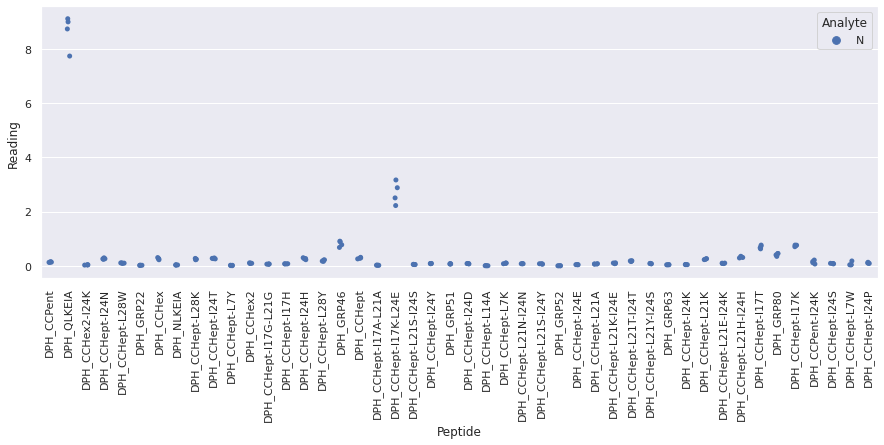

 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_1.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

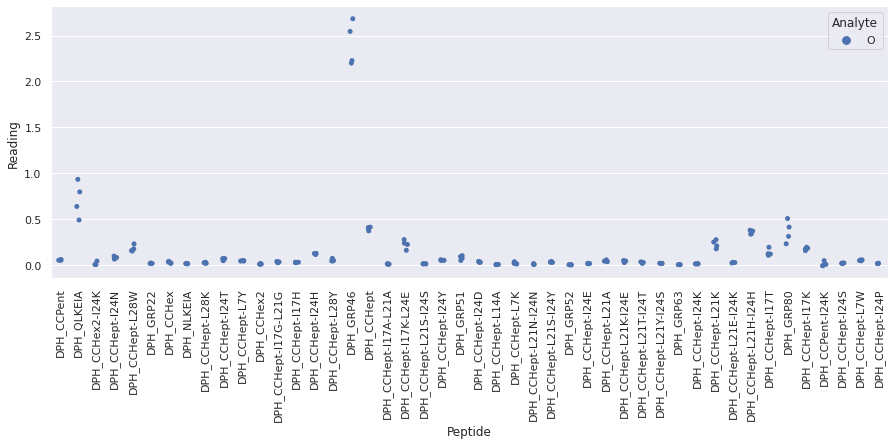

Drawing scatter plot of data spread for P_repeat_1 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

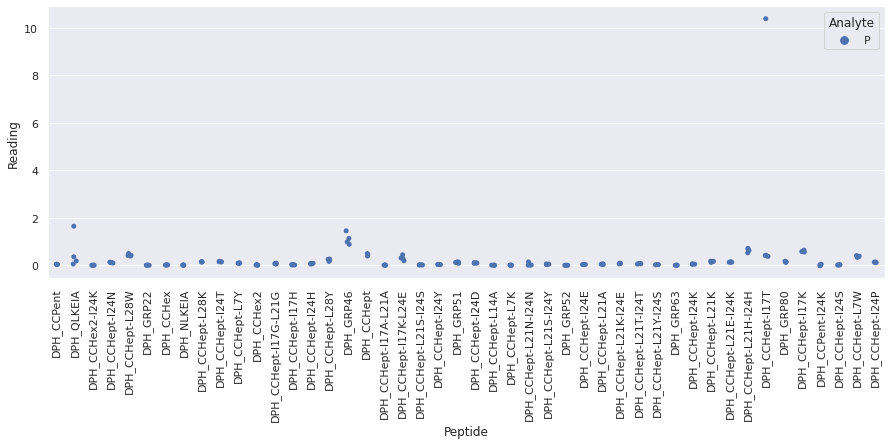

Drawing scatter plot of data spread for B_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

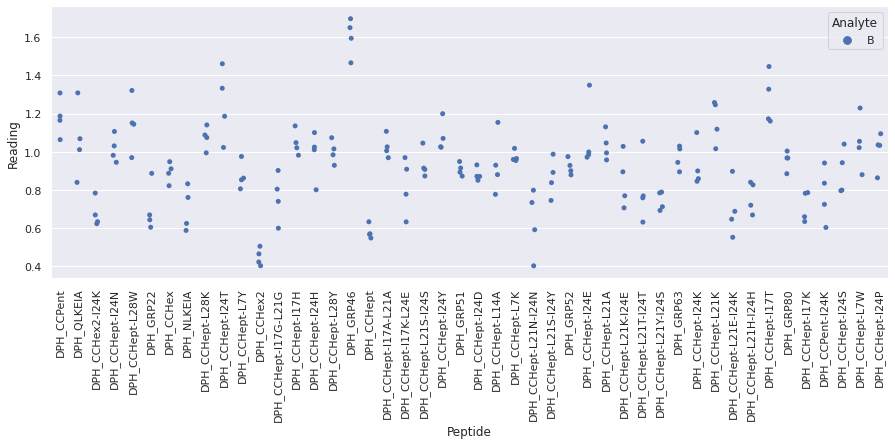

Drawing scatter plot of data spread for D_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

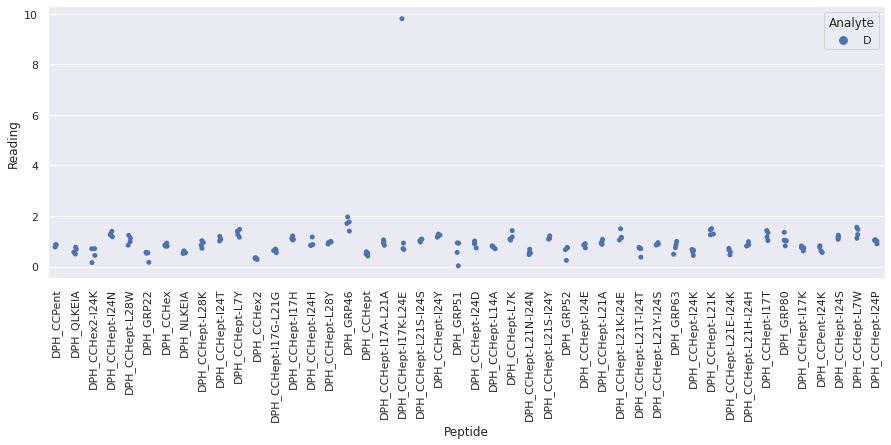

Drawing scatter plot of data spread for N_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

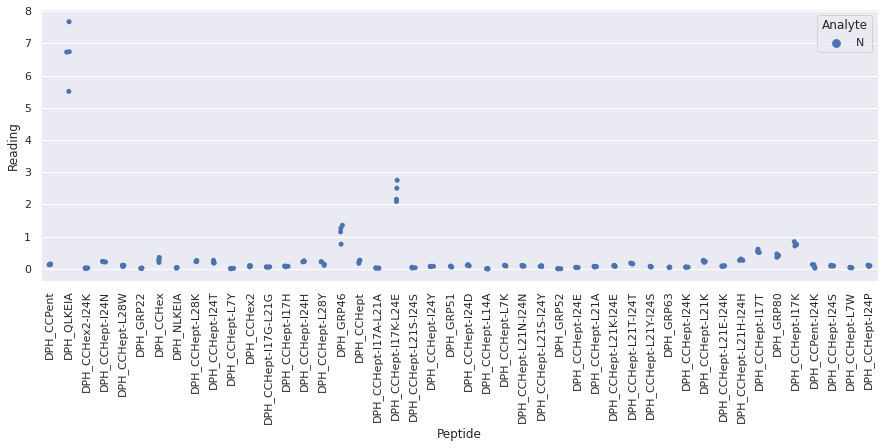

Drawing scatter plot of data spread for O_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

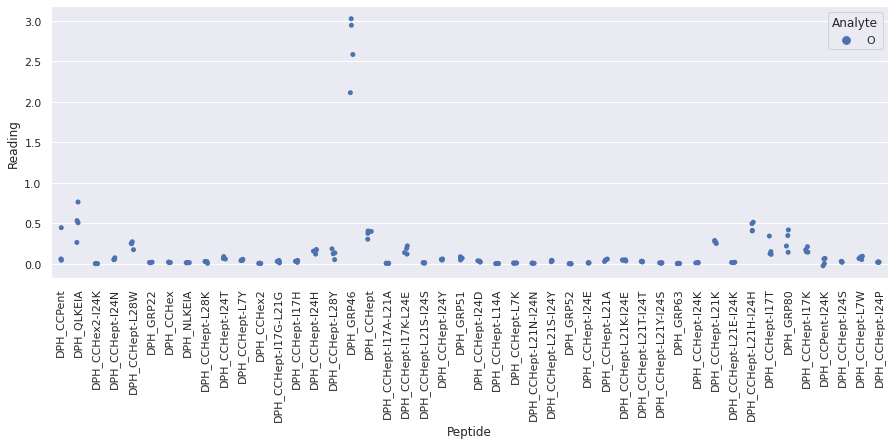

Drawing scatter plot of data spread for P_repeat_2 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

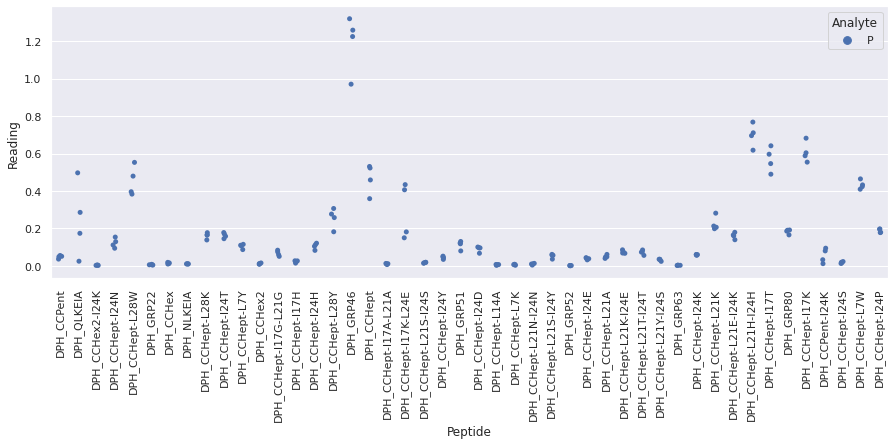

Drawing scatter plot of data spread for B_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

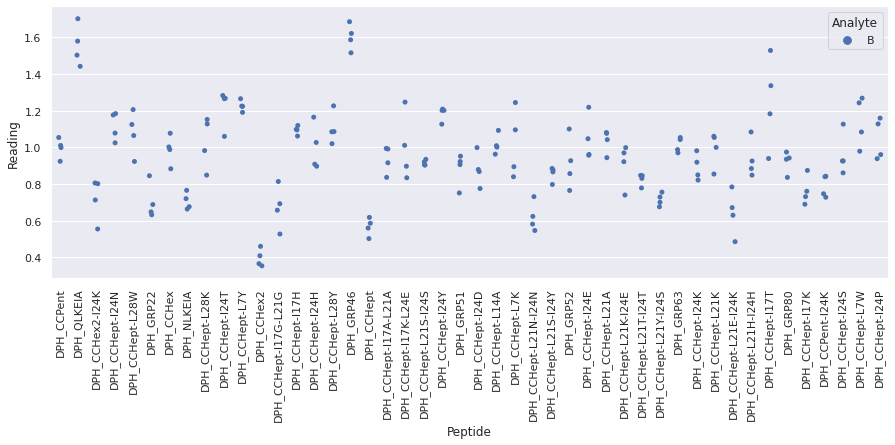

Drawing scatter plot of data spread for D_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

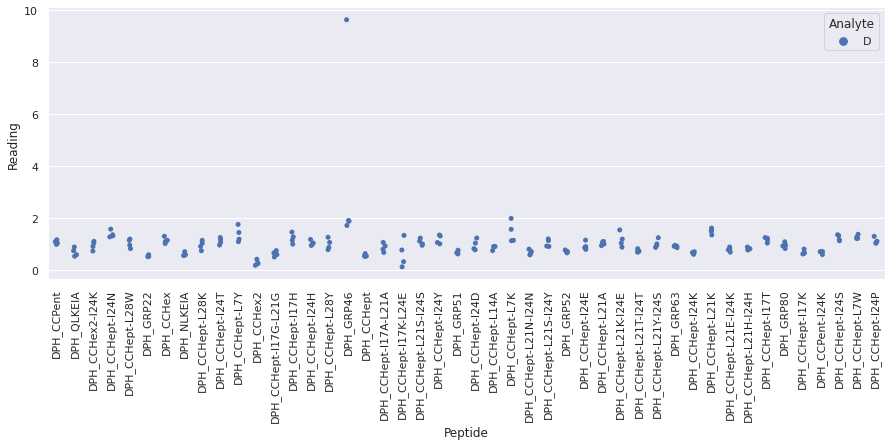

 WARNING - median fluorescence of (N + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (N + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/N_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for N_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

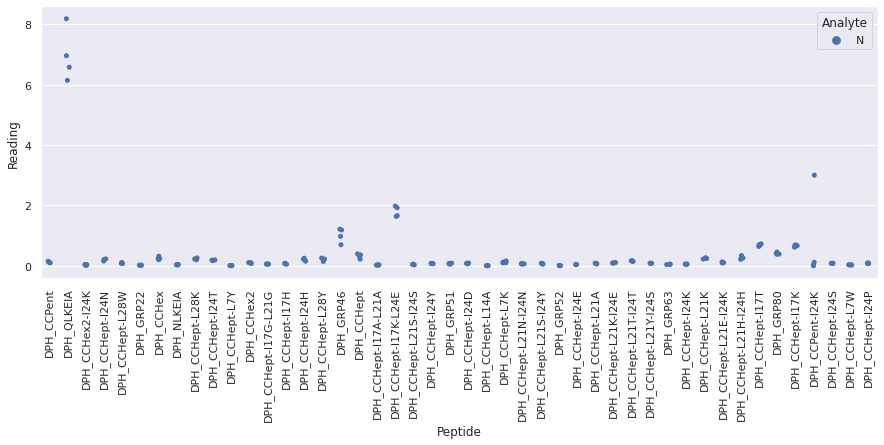

 WARNING - median fluorescence of (O + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCHex2 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate 

<Figure size 720x720 with 0 Axes>

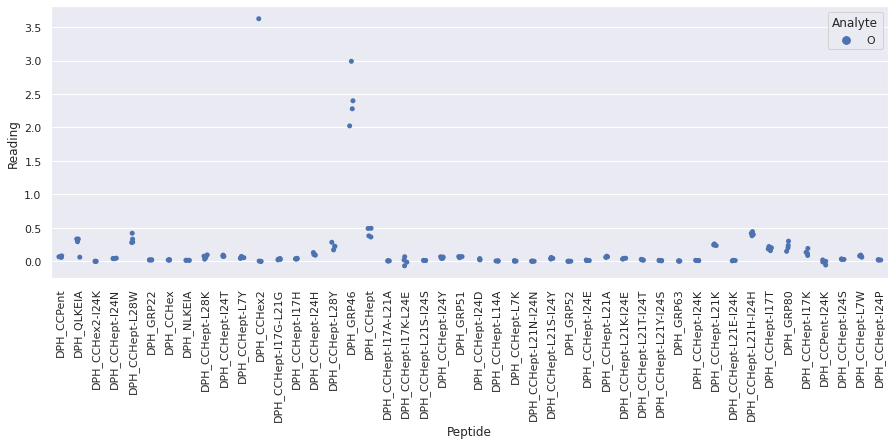

 WARNING - median fluorescence of (P + DPH_QLKEIA + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_3.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for P_repeat_3 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

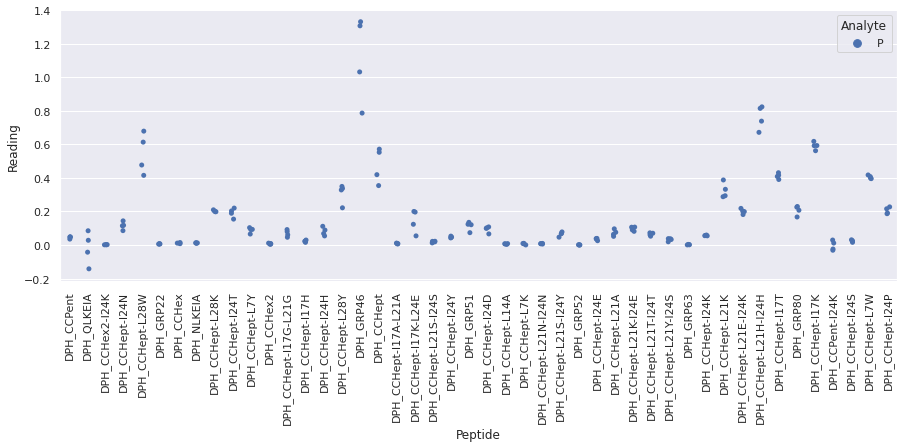

Drawing scatter plot of data spread for B_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

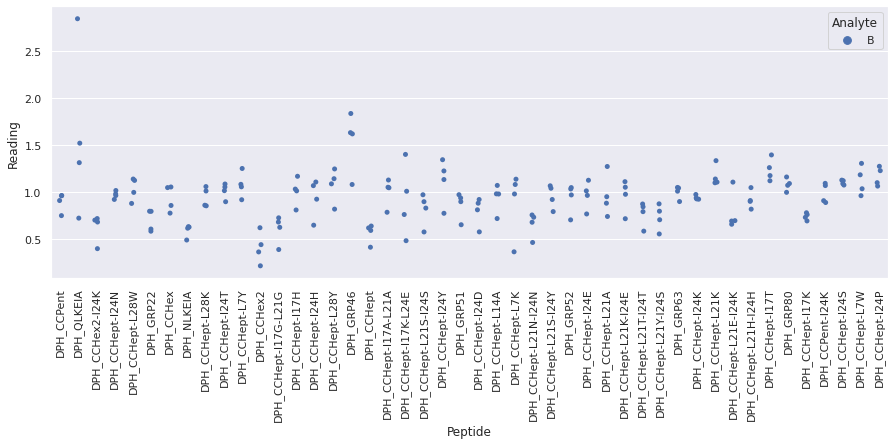

Drawing scatter plot of data spread for D_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

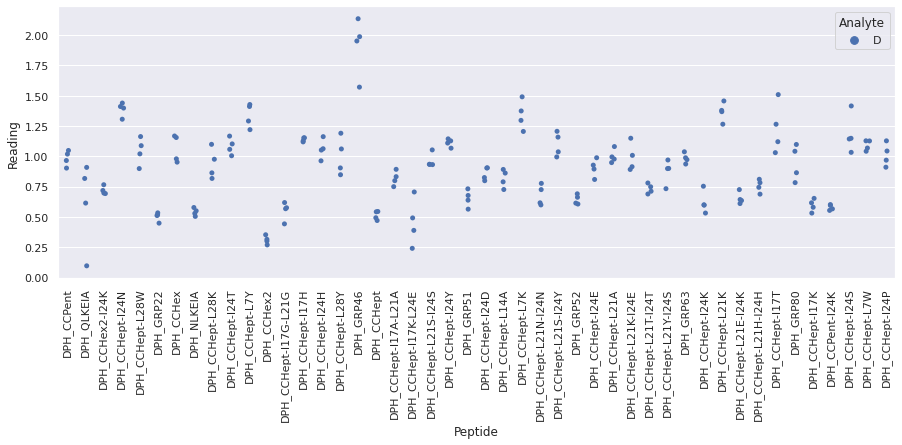

Drawing scatter plot of data spread for N_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

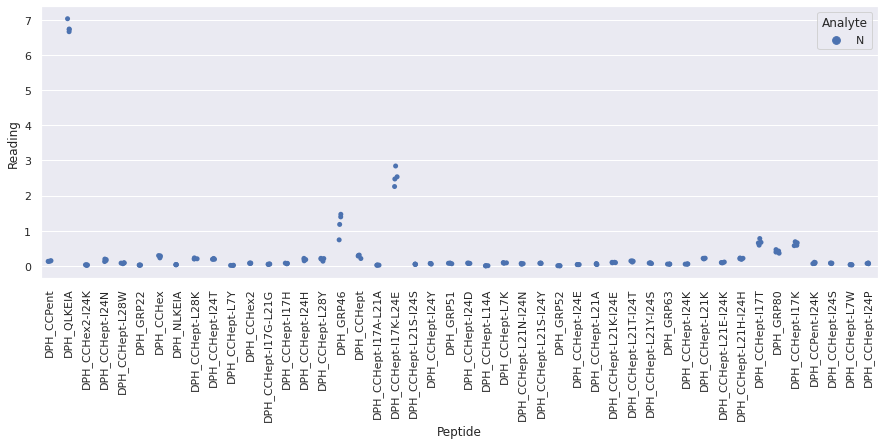

Drawing scatter plot of data spread for O_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

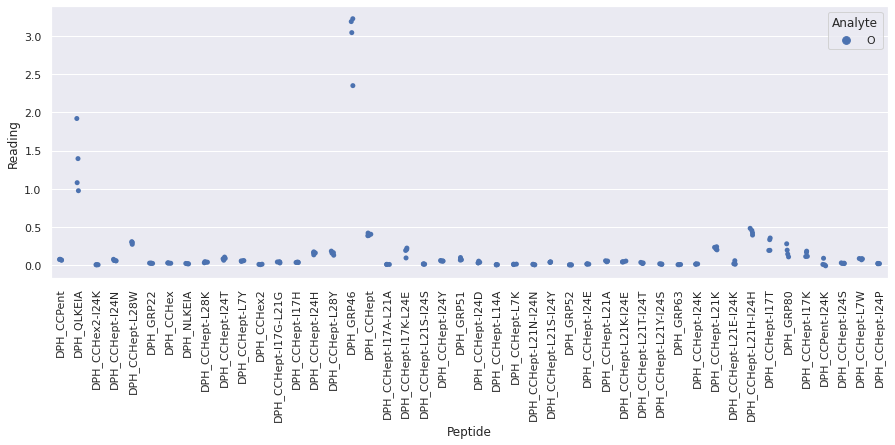

Drawing scatter plot of data spread for P_repeat_4 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

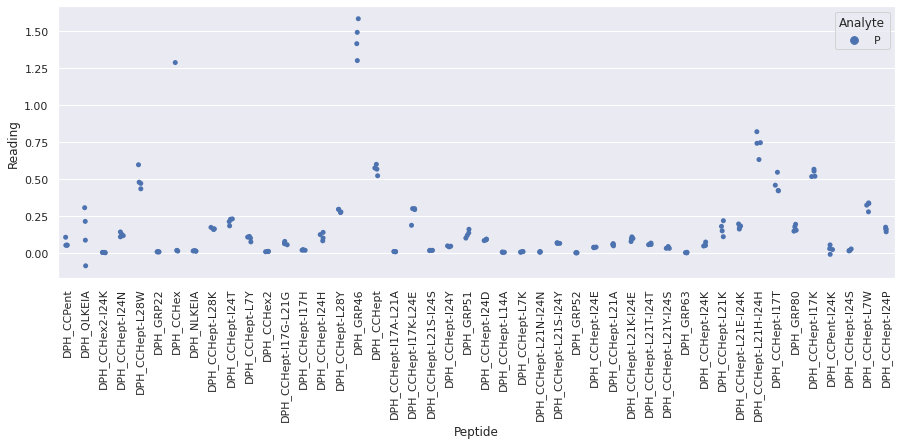

Drawing scatter plot of data spread for B_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

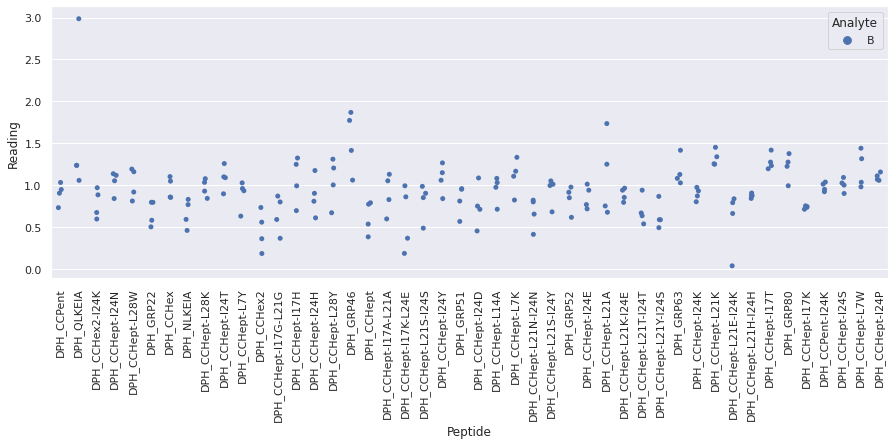

Drawing scatter plot of data spread for D_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

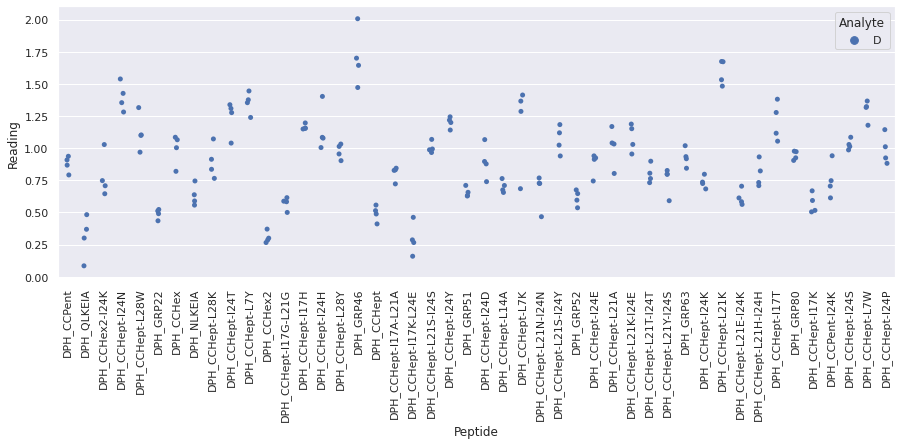

Drawing scatter plot of data spread for N_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

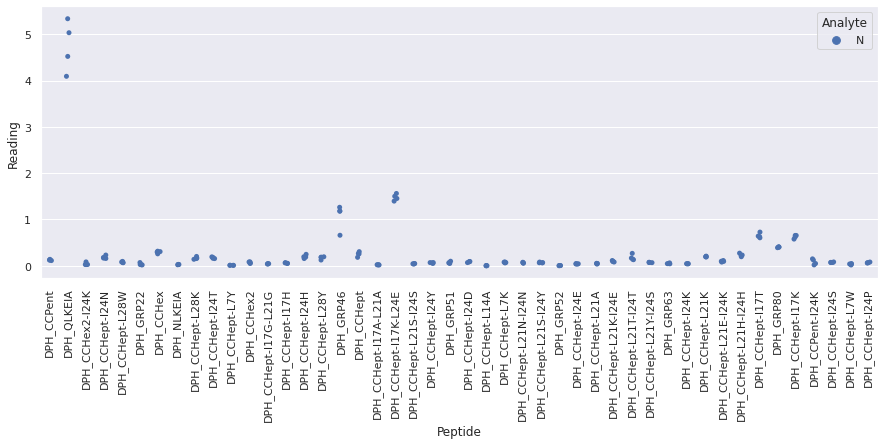

Drawing scatter plot of data spread for O_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

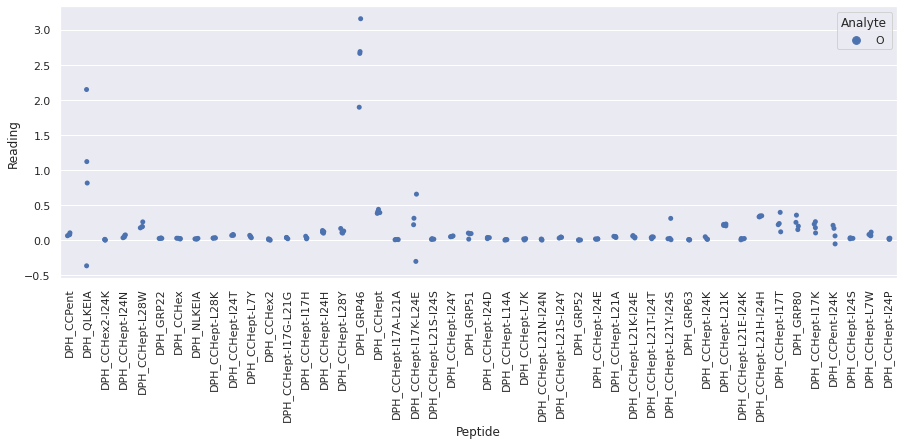

Drawing scatter plot of data spread for P_repeat_5 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

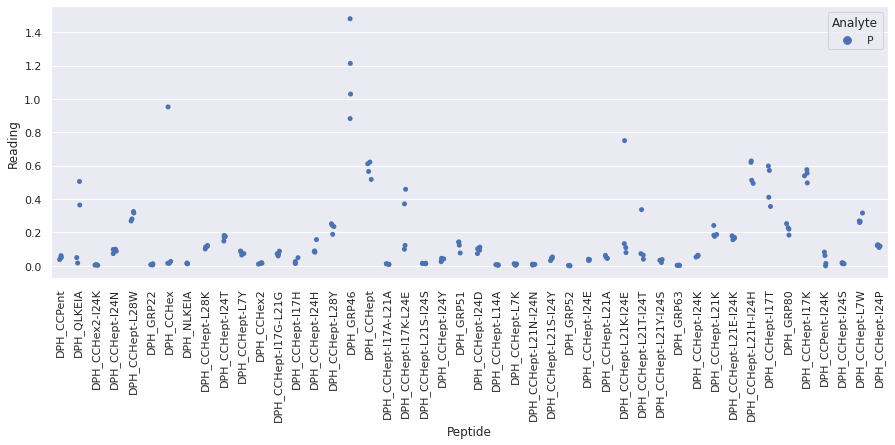

Drawing scatter plot of data spread for B_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

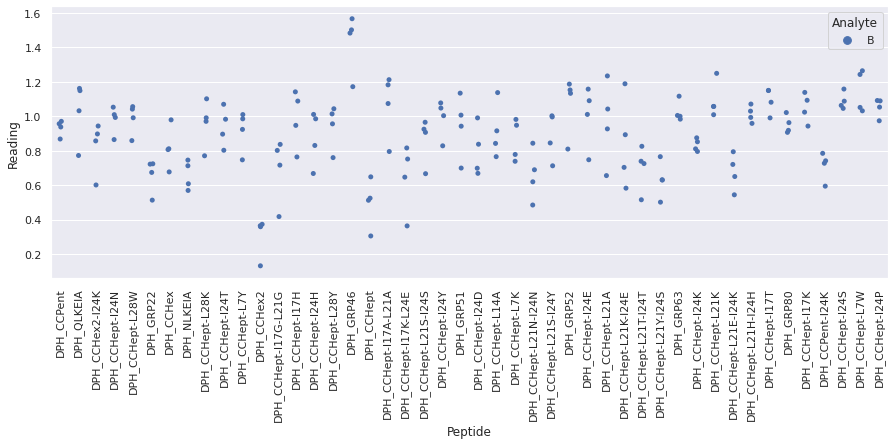

Drawing scatter plot of data spread for D_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

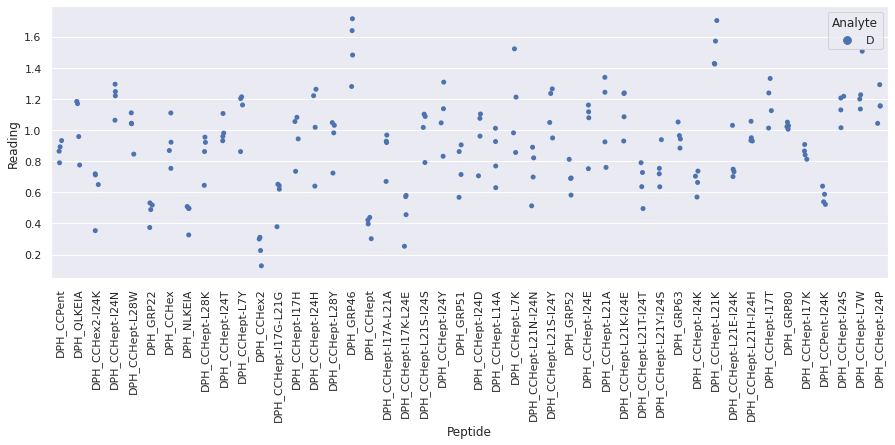

Drawing scatter plot of data spread for N_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

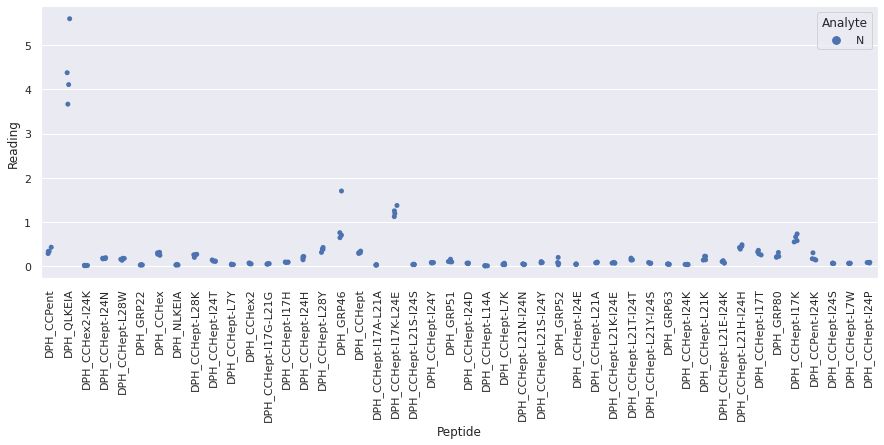

 WARNING - median fluorescence of (O + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_6.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

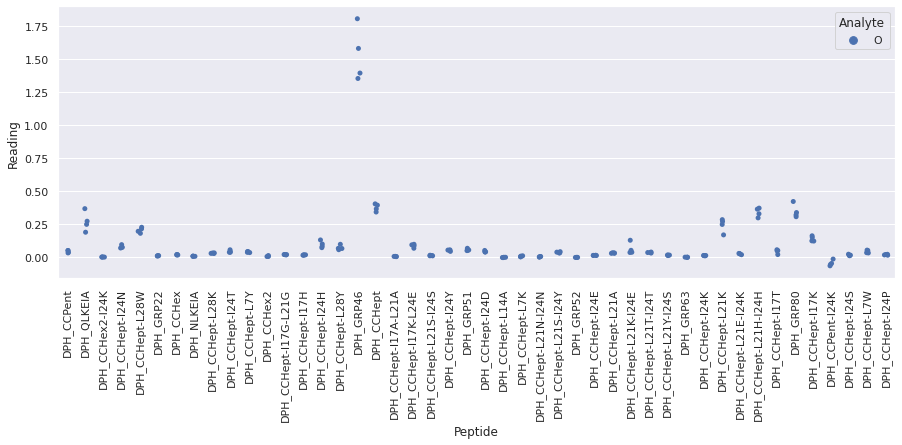

Drawing scatter plot of data spread for P_repeat_6 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

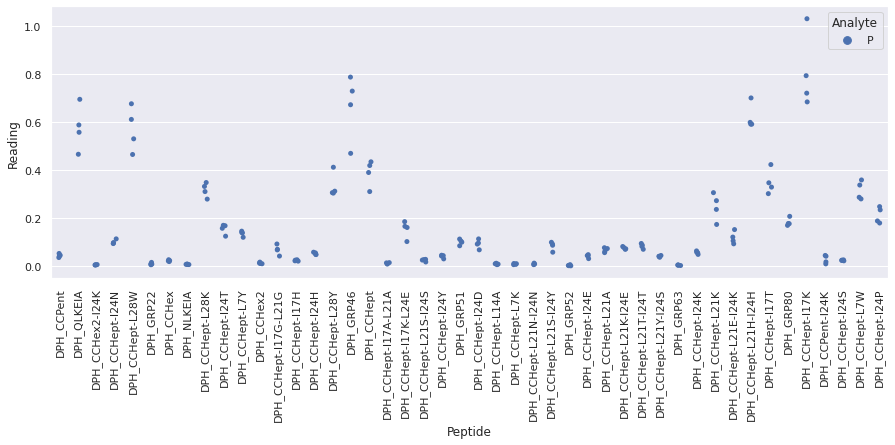

Drawing scatter plot of data spread for B_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

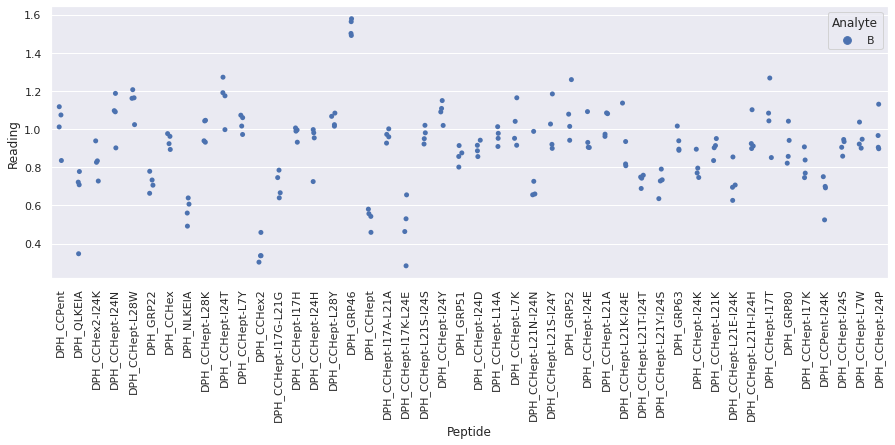

Drawing scatter plot of data spread for D_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

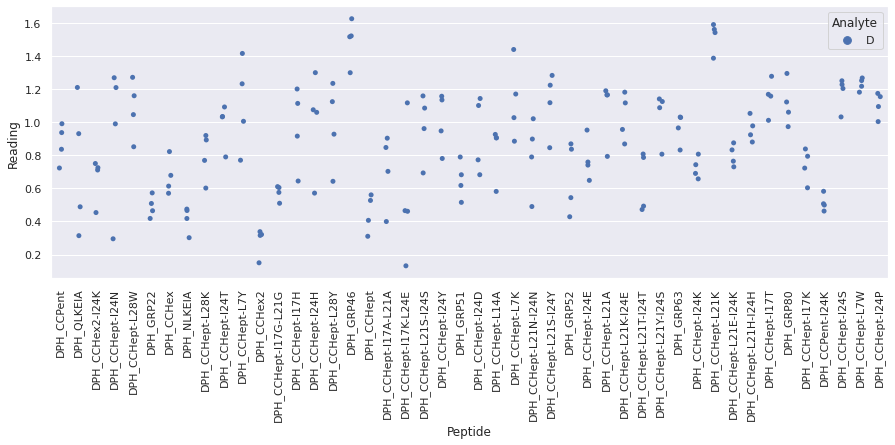

Drawing scatter plot of data spread for N_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

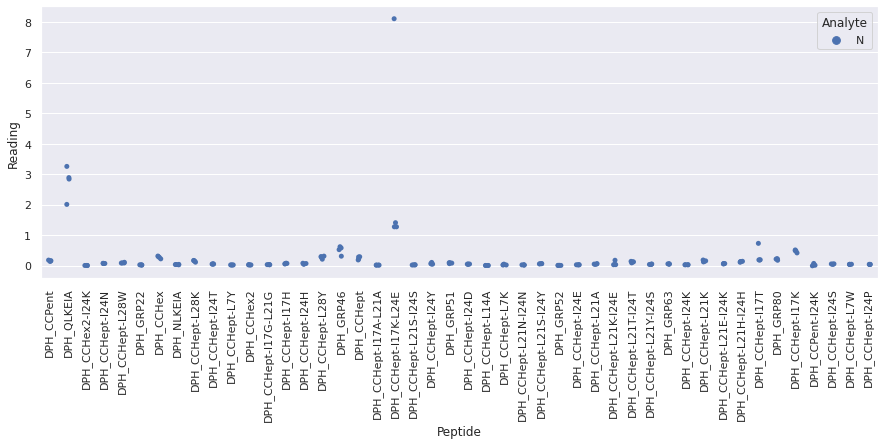

 WARNING - median fluorescence of (O + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCHept-L14A + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on p

<Figure size 720x720 with 0 Axes>

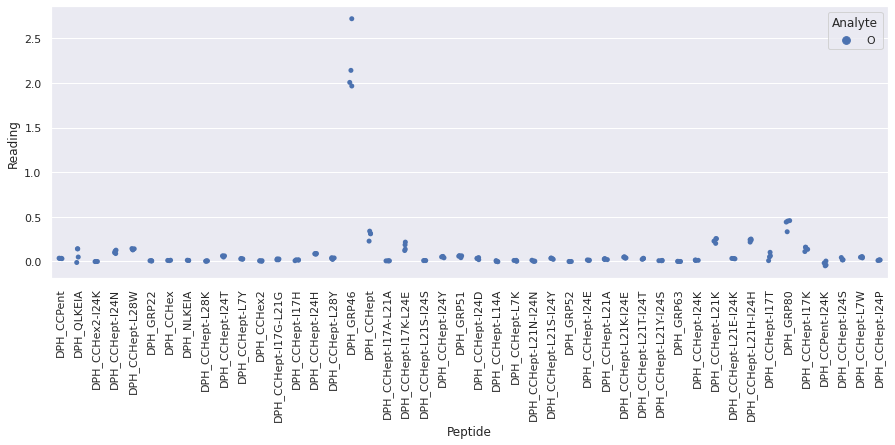

Drawing scatter plot of data spread for P_repeat_7 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

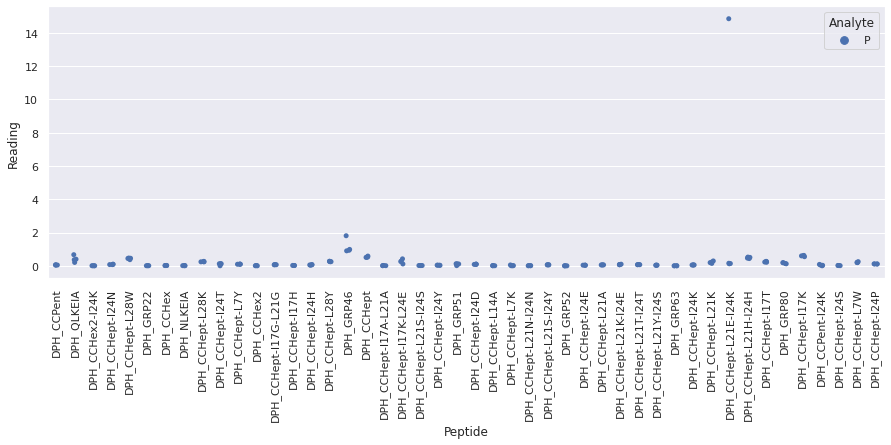

Drawing scatter plot of data spread for B_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

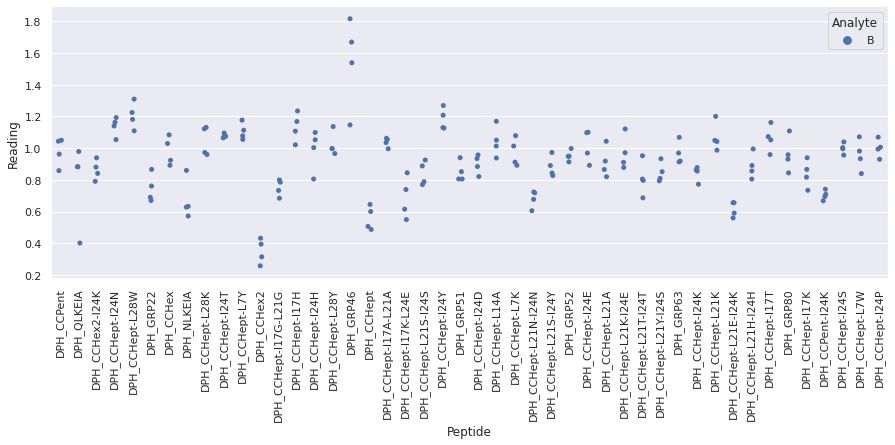

Drawing scatter plot of data spread for D_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

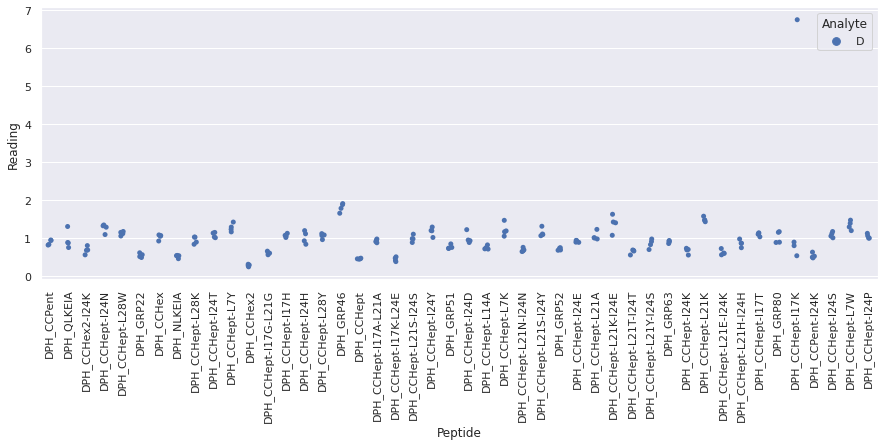

Drawing scatter plot of data spread for N_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

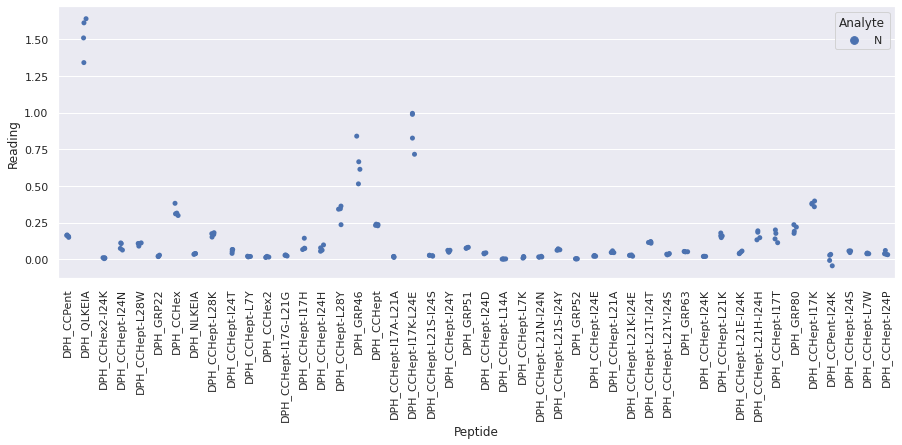

Drawing scatter plot of data spread for O_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

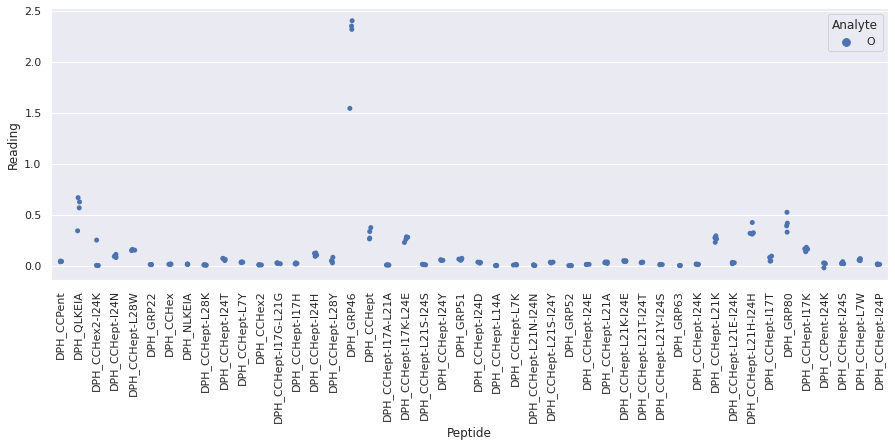

Drawing scatter plot of data spread for P_repeat_8 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

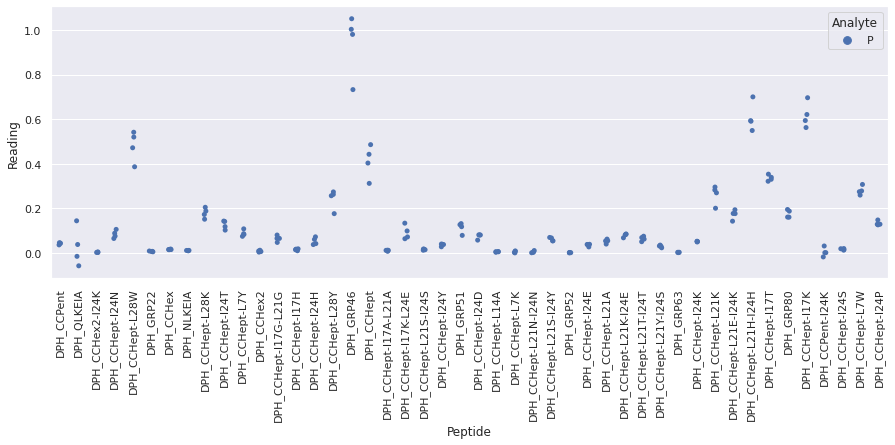

Drawing scatter plot of data spread for B_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

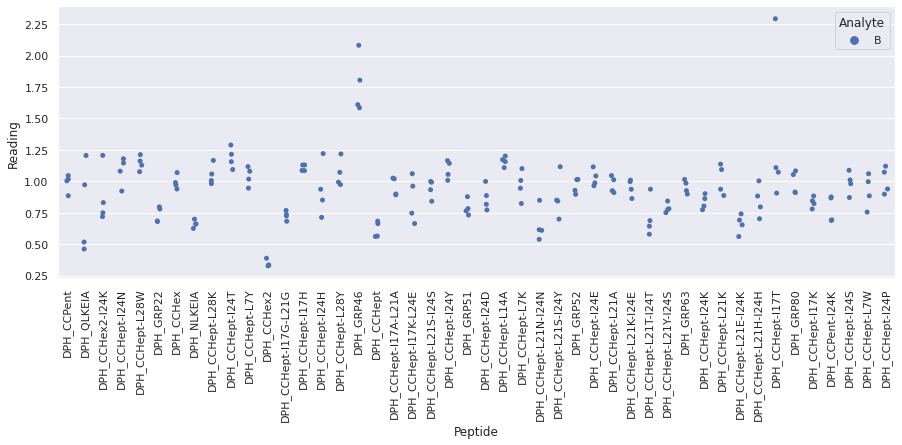

Drawing scatter plot of data spread for D_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

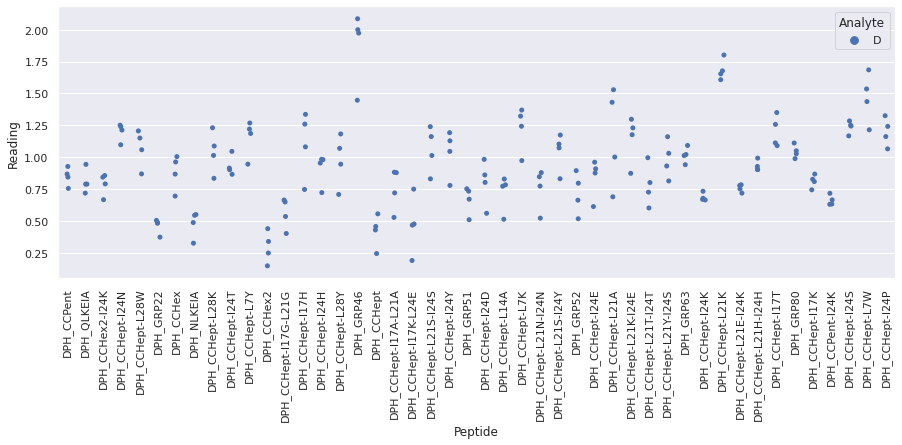

Drawing scatter plot of data spread for N_repeat_9 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

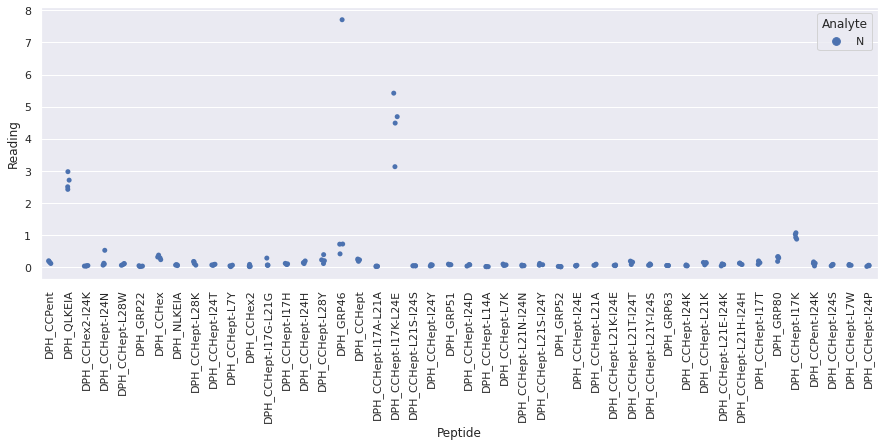

 WARNING - median fluorescence of (P + DPH_QLKEIA + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHex2-I24K + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHex2 + fluorophore) is less than fluorescence of (P + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/P_repeat_9.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (P + DPH_CCHept-I17K-L24E + fluorophore) is less than fluorescence of (P + fluorophore) alone on 

<Figure size 720x720 with 0 Axes>

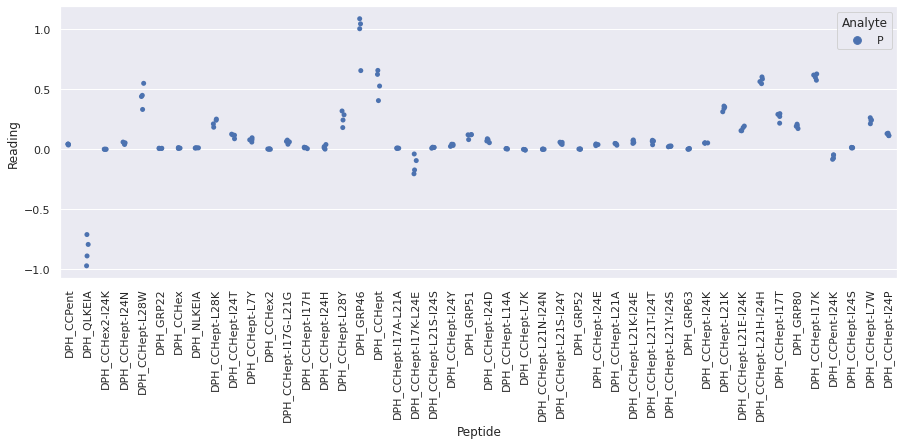

Drawing scatter plot of data spread for B_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

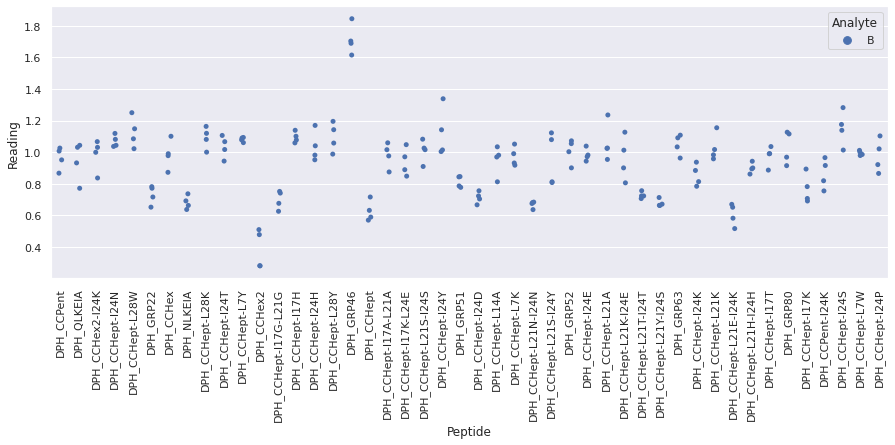

Drawing scatter plot of data spread for D_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

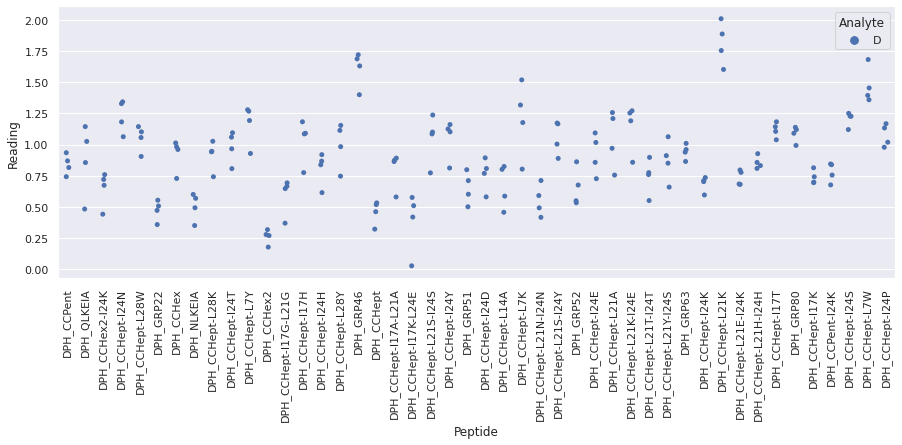

Drawing scatter plot of data spread for N_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

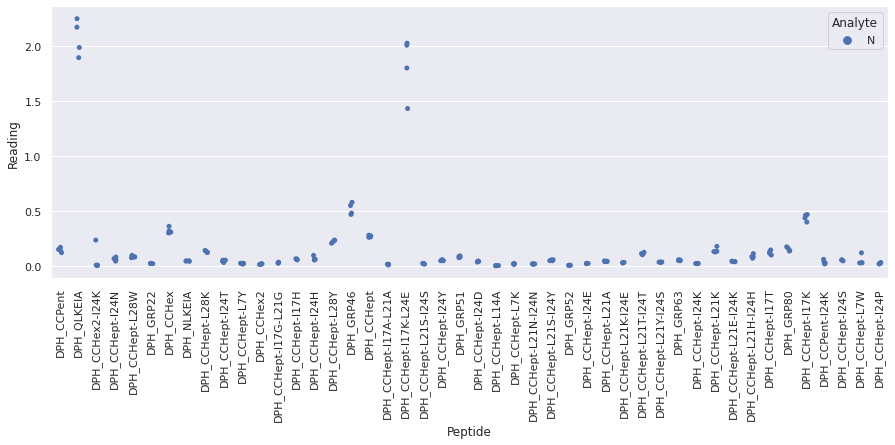

 WARNING - median fluorescence of (O + DPH_GRP52 + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
 WARNING - median fluorescence of (O + DPH_CCPent-I24K + fluorophore) is less than fluorescence of (O + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/O_repeat_10.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for O_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

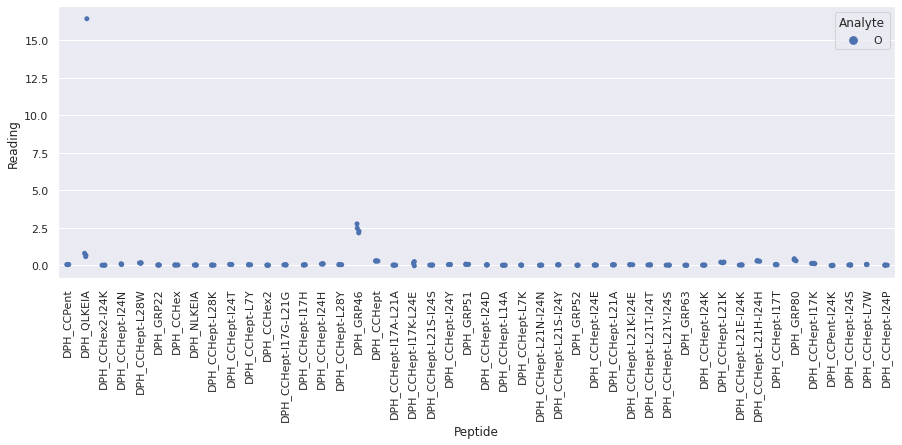

Drawing scatter plot of data spread for P_repeat_10 in FA_scaled_data


<Figure size 720x720 with 0 Axes>

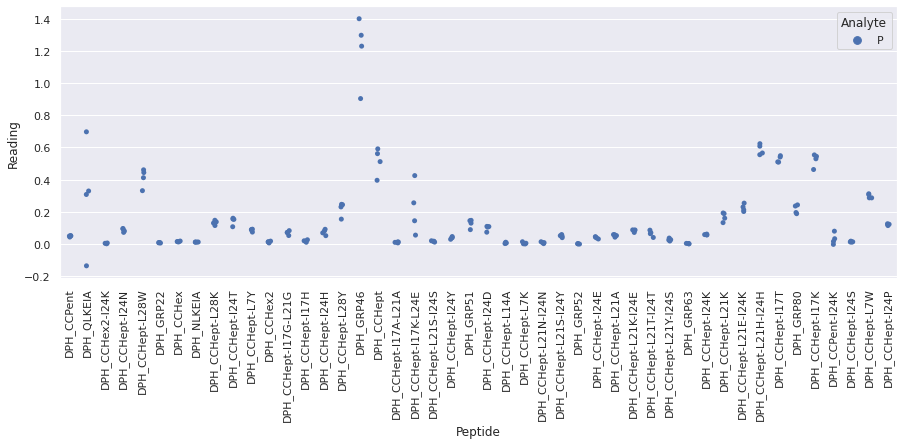



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: blank, DPH_CCHept-L28Y, 14387.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: blank, DPH_CCHept-I17K-L24E, 858.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: B, DPH_CCHept-L7Y, 5924.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/B_repeat_1.xlsx: B, DPH_GRP51, 17187.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_GRP52, 48839.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_CCHept-L21T-I24T, 8211.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/FAs/Reformatted_FA_csvs/D_repeat_1.xlsx: blank, DPH_CCHept-L21E-I24K, 

In [14]:
fa_fluor_data = ParseArrayData(
    data_dirs_dict={'DPH': '/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/'
                           'FAs/Reformatted_FA_csvs/'},
    results_dir='/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
                'All_small_molecules/FA_plate_parsing_plots/',
    repeat_labels_list=['repeat_1', 'repeat_2', 'repeat_3', 'repeat_4', 'repeat_5', 'repeat_6', 'repeat_7',
                        'repeat_8', 'repeat_9', 'repeat_10'],
    peptide_dict = {'DPH': ['No Pep', 'CCPent', 'QLKEIA', 'CCHex2-I24K', 'CCHept-I24N', 'CCHept-L28W',
                            'GRP22', 'CCHex', 'NLKEIA', 'CCHept-L28K', 'CCHept-I24T', 'CCHept-L7Y',
                            'GRP35', 'CCHex2', 'CCHept-I17G-L21G', 'CCHept-I17H', 'CCHept-I24H', 'CCHept-L28Y',
                            'GRP46', 'CCHept', 'CCHept-I17A-L21A', 'CCHept-I17K-L24E', 'CCHept-L21S-I24S',
                            'CCHept-I24Y', 'GRP51', 'CCHept-I24D', 'CCHept-L14A', 'CCHept-L7K',
                            'CCHept-L21N-I24N', 'CCHept-L21S-I24Y', 'GRP52', 'CCHept-I24E', 'CCHept-L21A',
                            'CCHept-L21K-I24E', 'CCHept-L21T-I24T', 'CCHept-L21Y-I24S', 'GRP63', 'CCHept-I24K',
                            'CCHept-L21K', 'CCHept-L21E-I24K', 'CCHept-L21H-I24H', 'CCHept-I17T', 'GRP80',
                            'CCHept-I17K', 'CCPent-I24K', 'CCHept-I24S', 'CCHept-L7W', 'CCHept-I24P']},
    control_peptides={'DPH': ['GRP35']},
    control_analytes=[]
)
fa_fluor_data.group_xlsx_repeats(ignore_files={'DPH': ['O_repeat_9.xlsx']})
fa_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='FA'
)

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx
Drawing scatter plot of data spread for fru_repeat_1 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

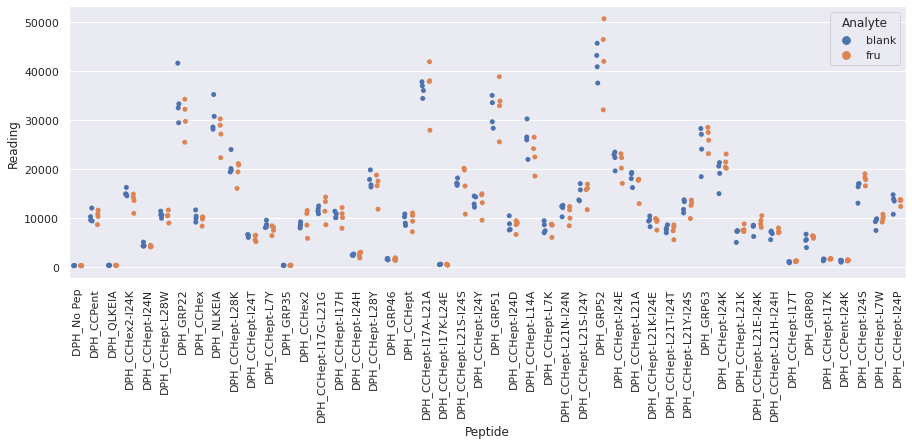

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_1.xlsx
Drawing scatter plot of data spread for glu_repeat_1 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

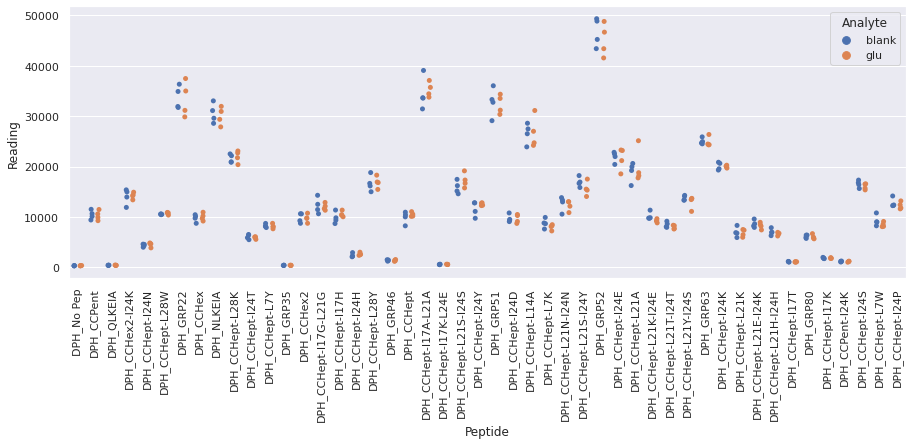

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_1.xlsx
Drawing scatter plot of data spread for gluam_repeat_1 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

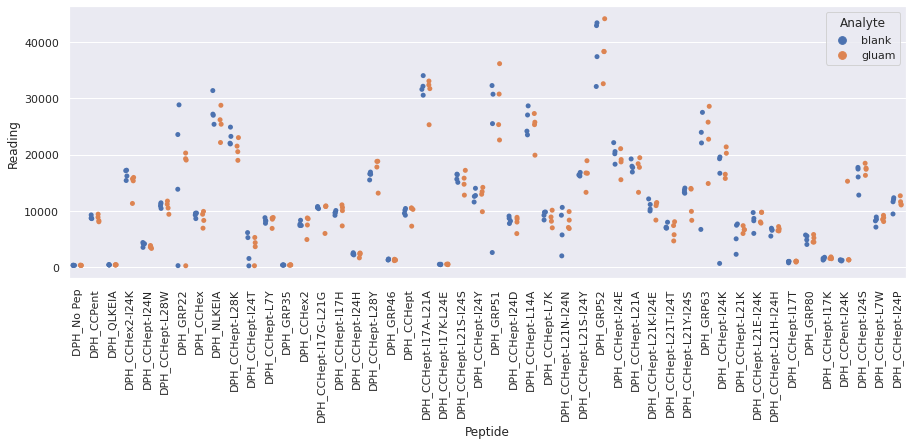

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_1.xlsx
Drawing scatter plot of data spread for mal_repeat_1 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

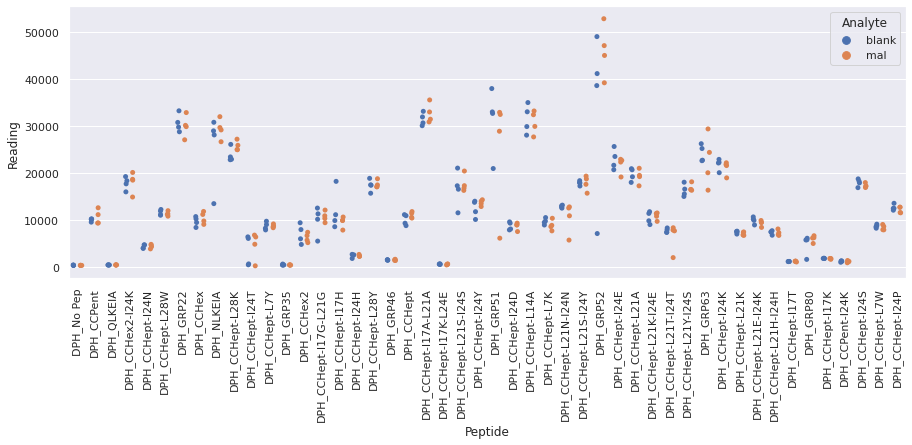

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_1.xlsx
Drawing scatter plot of data spread for man_repeat_1 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

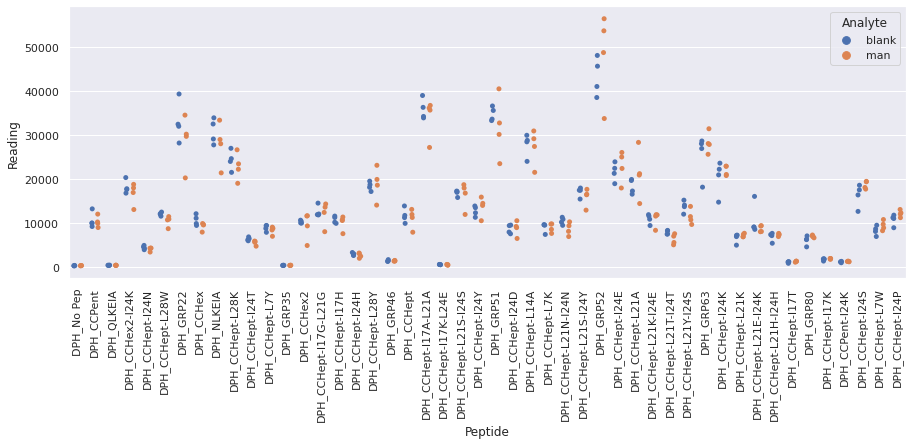

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_2.xlsx
Drawing scatter plot of data spread for fru_repeat_2 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

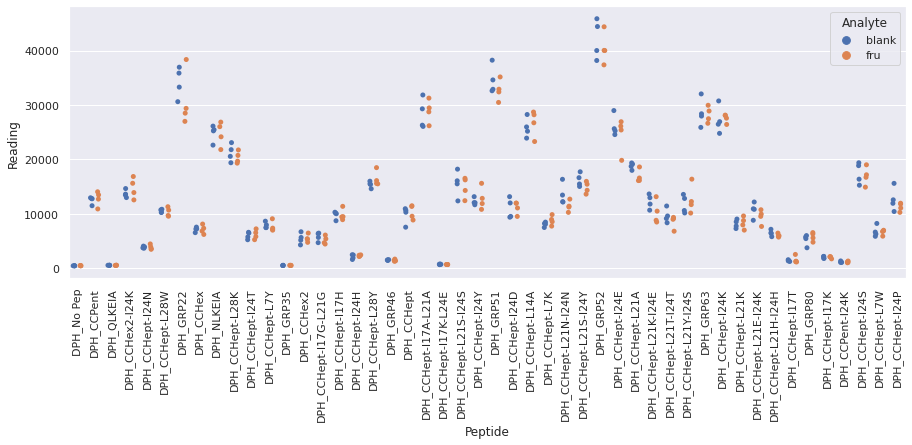

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_2.xlsx
Drawing scatter plot of data spread for glu_repeat_2 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

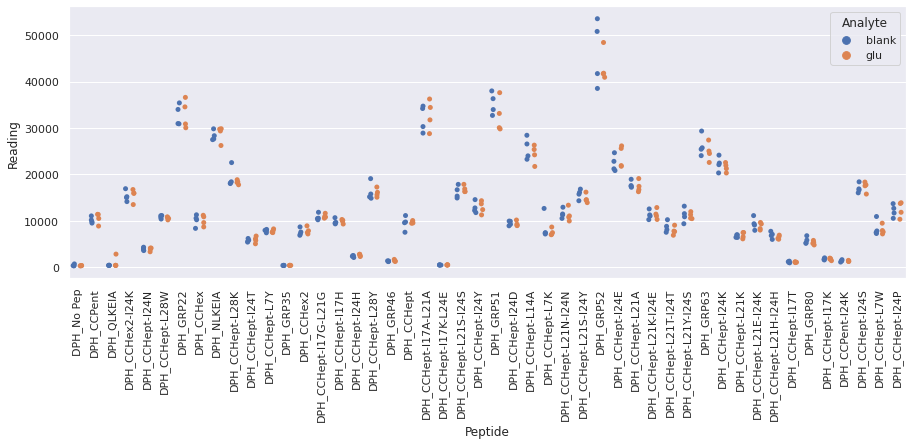

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_2.xlsx
Drawing scatter plot of data spread for gluam_repeat_2 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

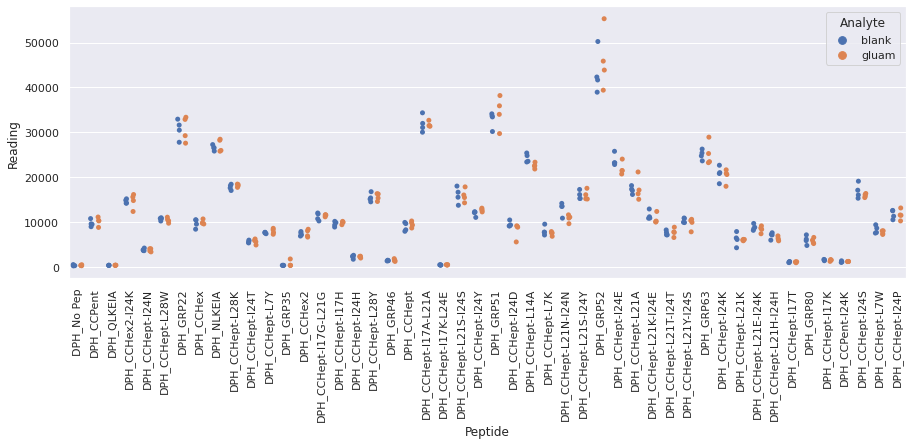

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_2.xlsx
Drawing scatter plot of data spread for mal_repeat_2 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

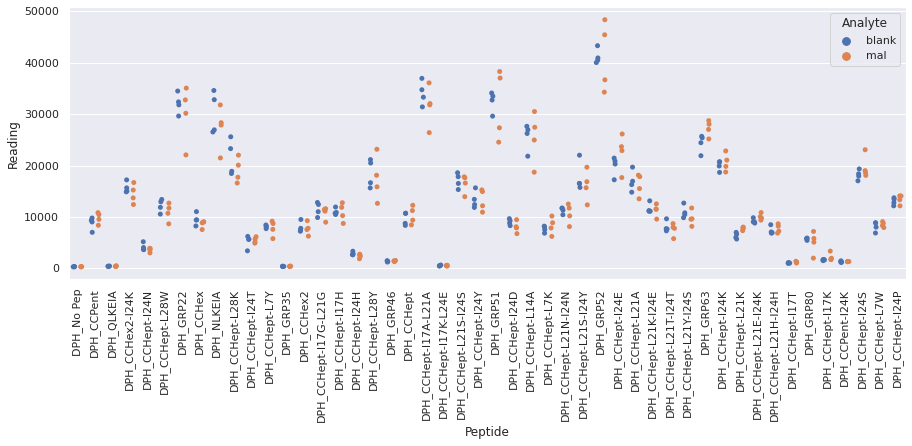

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_2.xlsx
Drawing scatter plot of data spread for man_repeat_2 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

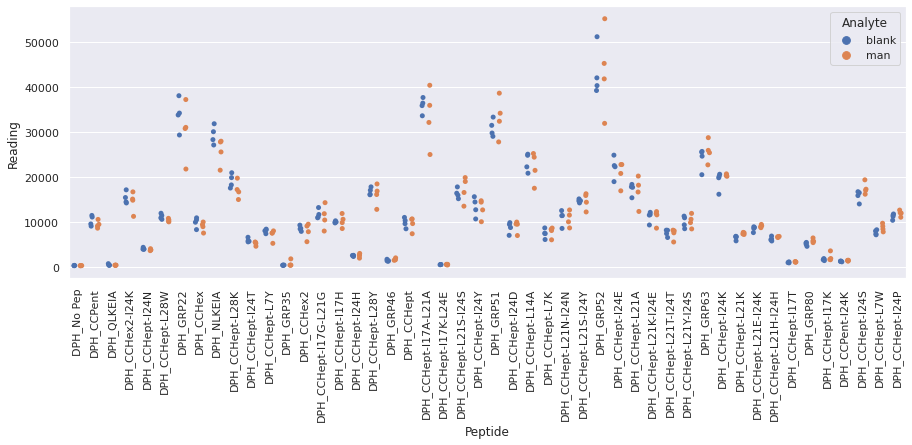

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_3.xlsx
Drawing scatter plot of data spread for fru_repeat_3 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

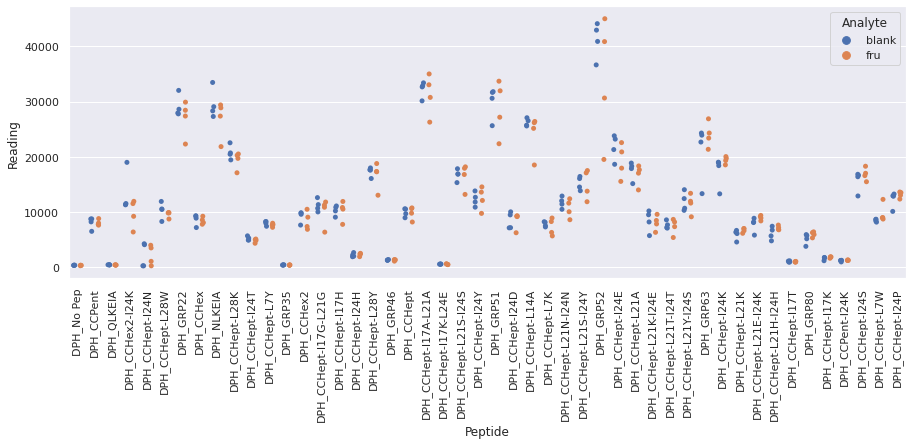

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_3.xlsx
Drawing scatter plot of data spread for glu_repeat_3 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

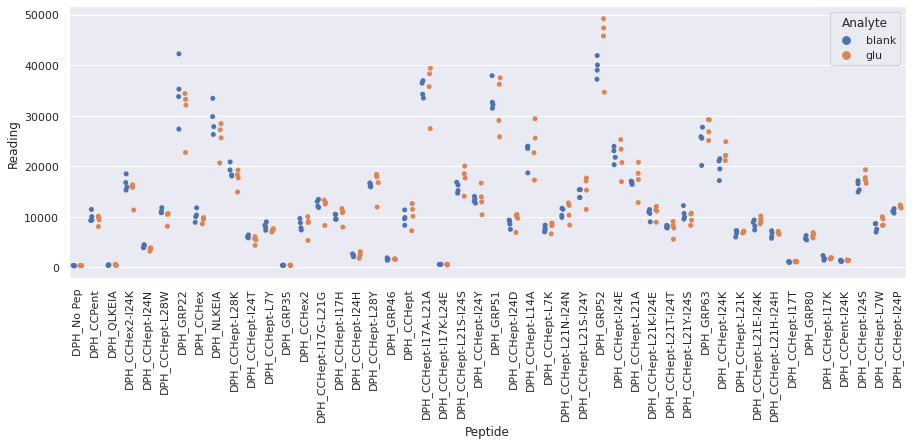

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_3.xlsx
Drawing scatter plot of data spread for gluam_repeat_3 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

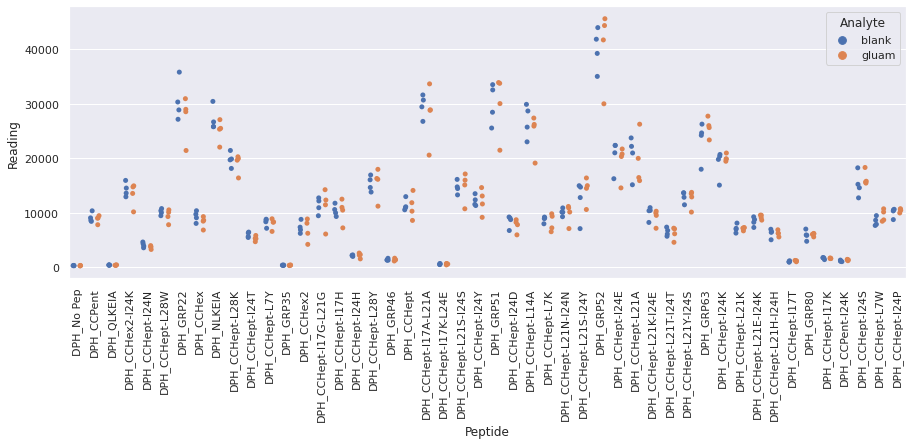

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_3.xlsx
Drawing scatter plot of data spread for mal_repeat_3 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

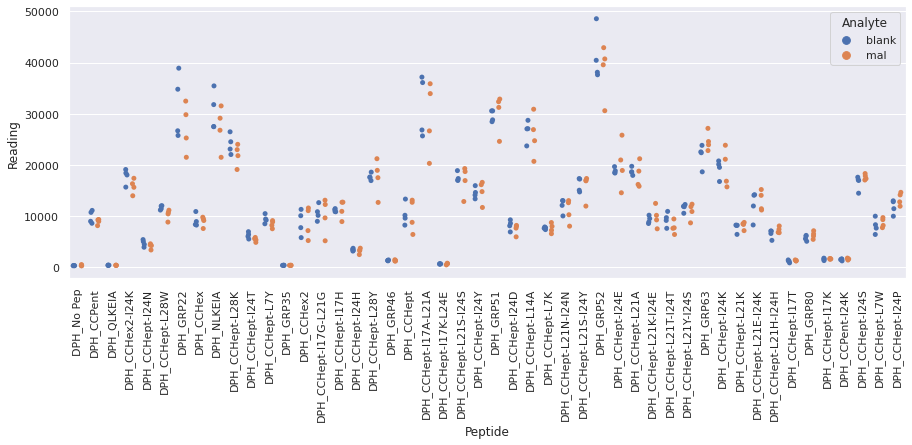

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_3.xlsx
Drawing scatter plot of data spread for man_repeat_3 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

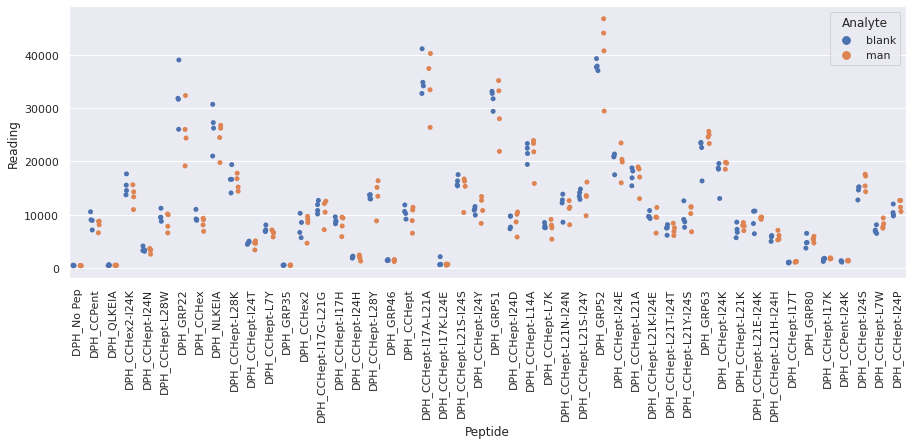

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_4.xlsx
Drawing scatter plot of data spread for fru_repeat_4 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

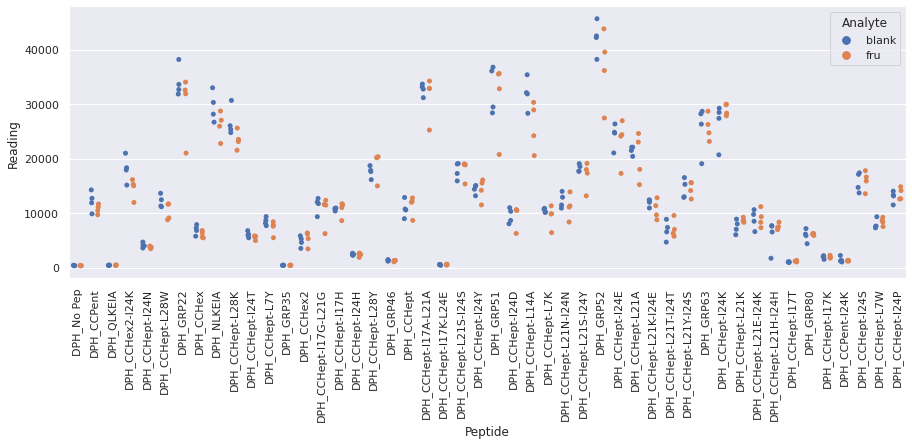

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_4.xlsx
Drawing scatter plot of data spread for glu_repeat_4 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

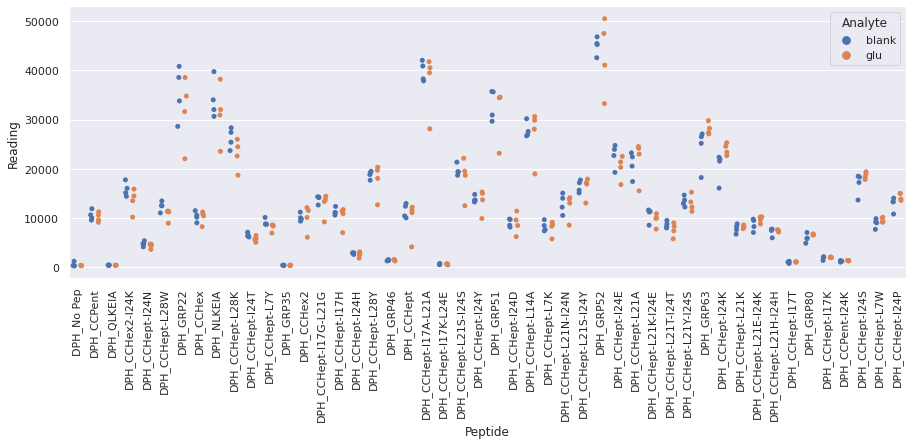

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_4.xlsx
Drawing scatter plot of data spread for gluam_repeat_4 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

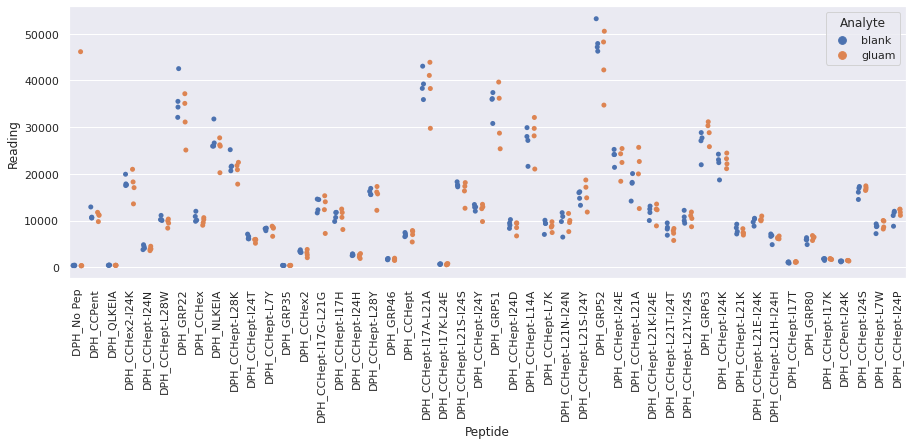

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_4.xlsx
Drawing scatter plot of data spread for mal_repeat_4 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

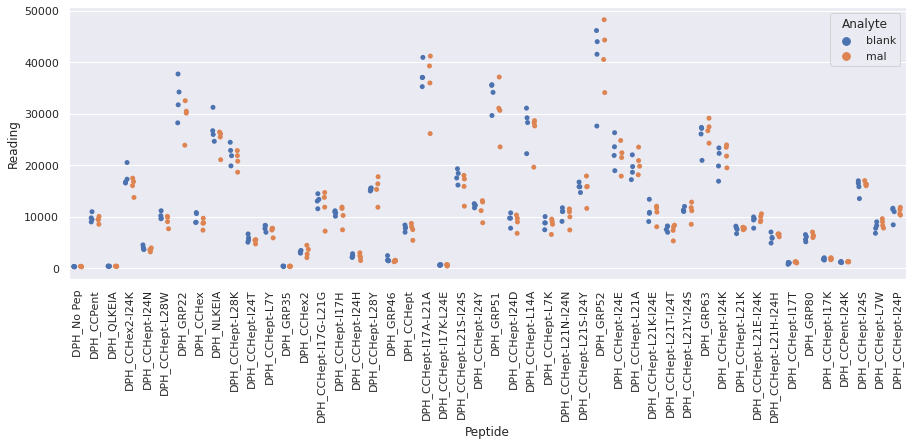

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_4.xlsx
Drawing scatter plot of data spread for man_repeat_4 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

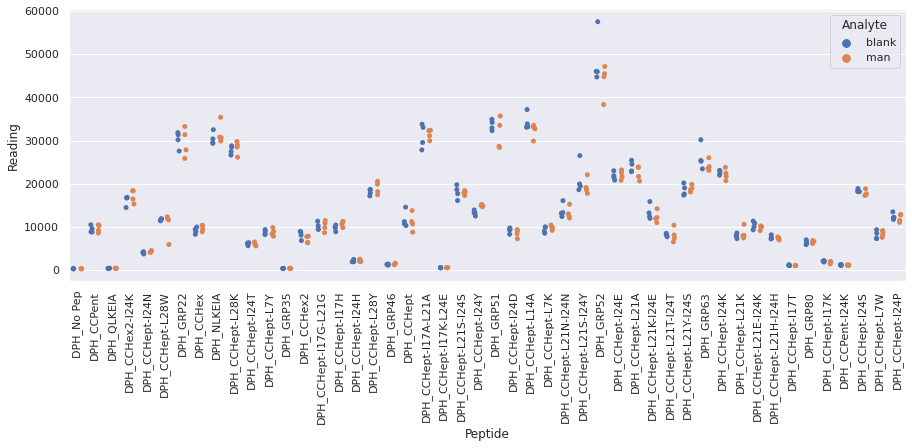

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_5.xlsx
Drawing scatter plot of data spread for fru_repeat_5 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

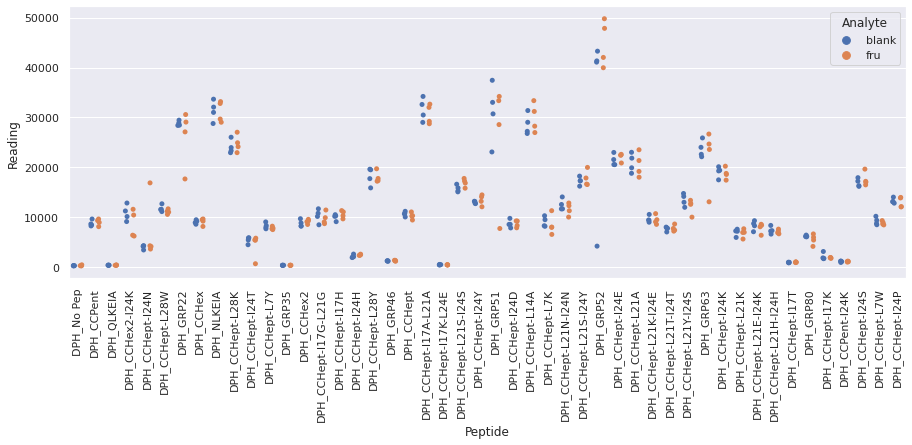

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_5.xlsx
Drawing scatter plot of data spread for glu_repeat_5 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

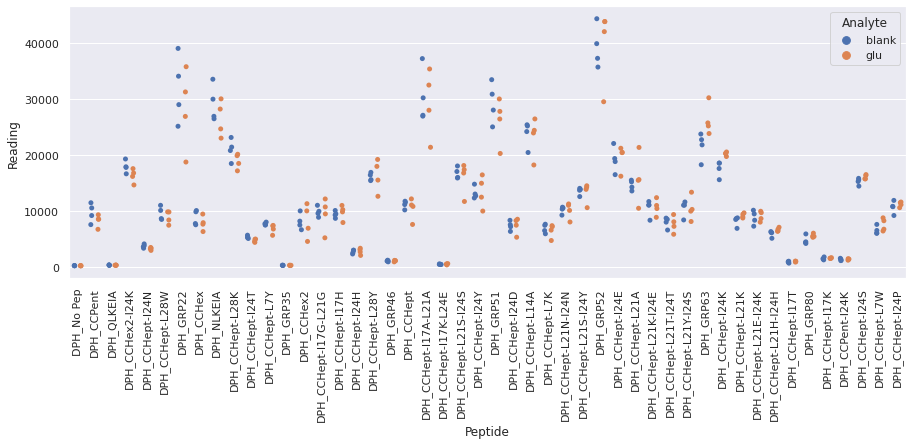

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_5.xlsx
Drawing scatter plot of data spread for gluam_repeat_5 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

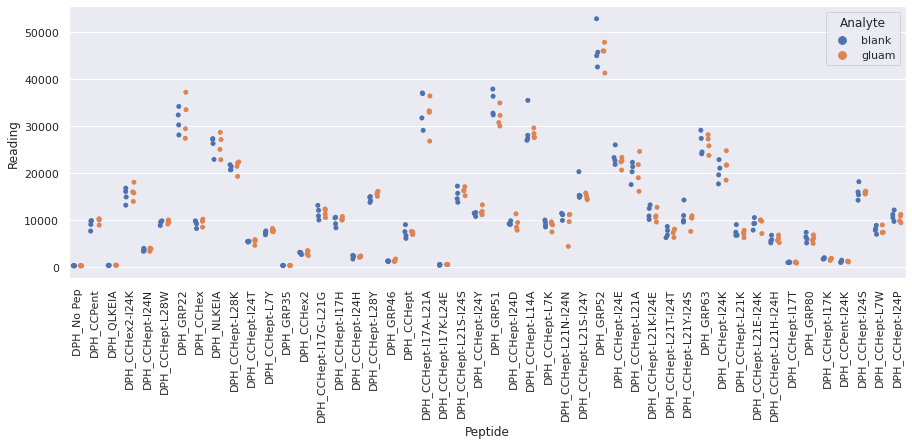

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_5.xlsx
Drawing scatter plot of data spread for mal_repeat_5 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

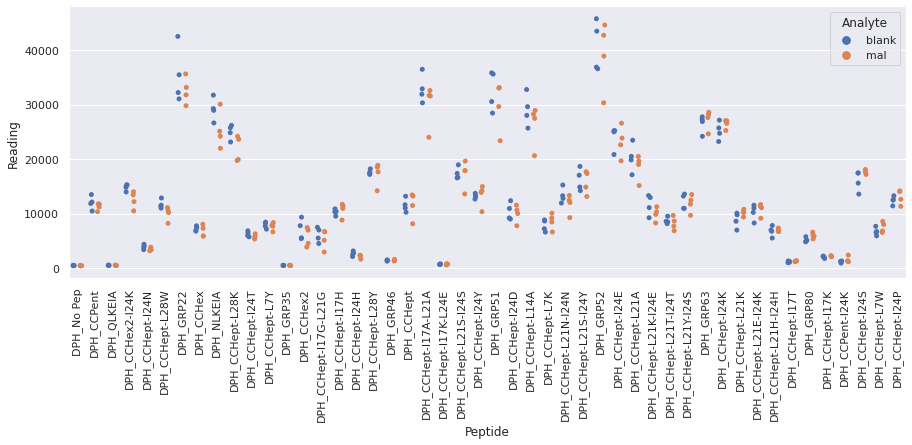

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_5.xlsx
Drawing scatter plot of data spread for man_repeat_5 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

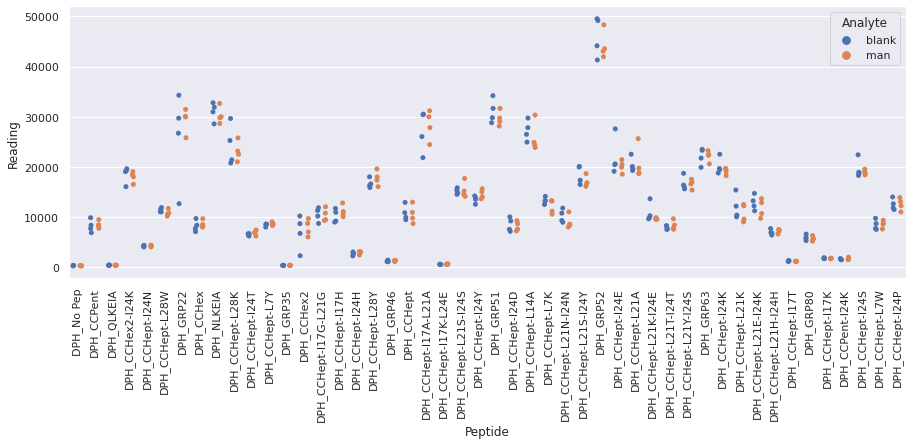

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_6.xlsx
Drawing scatter plot of data spread for fru_repeat_6 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

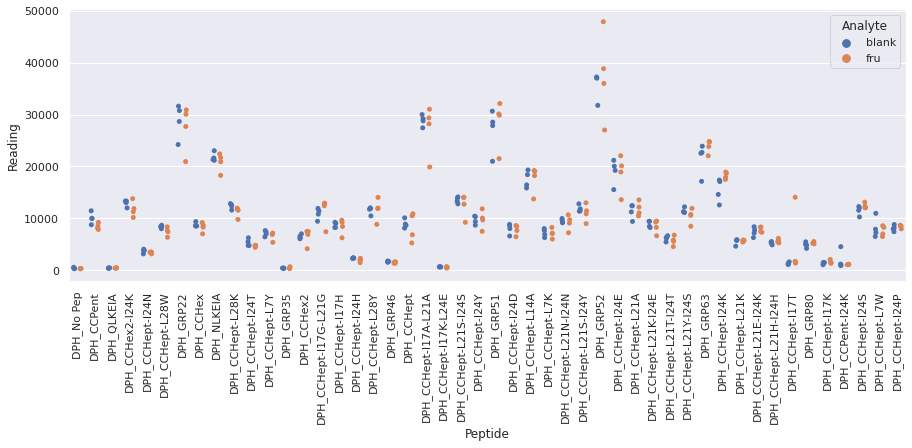

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_6.xlsx
Drawing scatter plot of data spread for glu_repeat_6 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

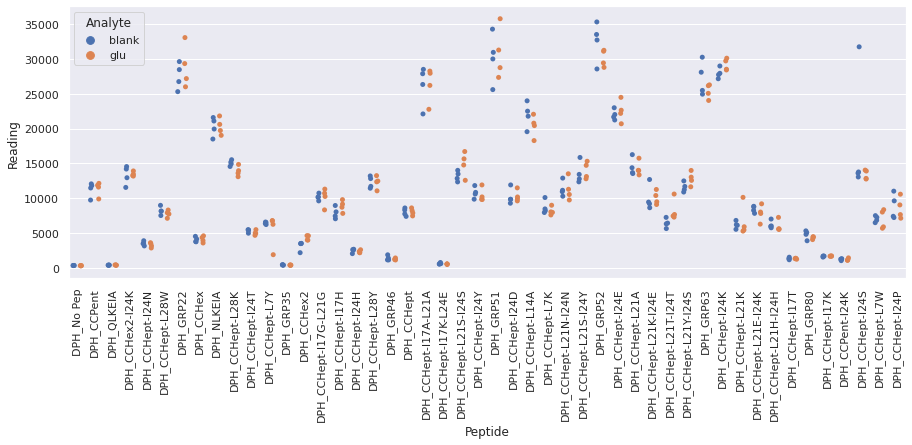

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_6.xlsx
Drawing scatter plot of data spread for gluam_repeat_6 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

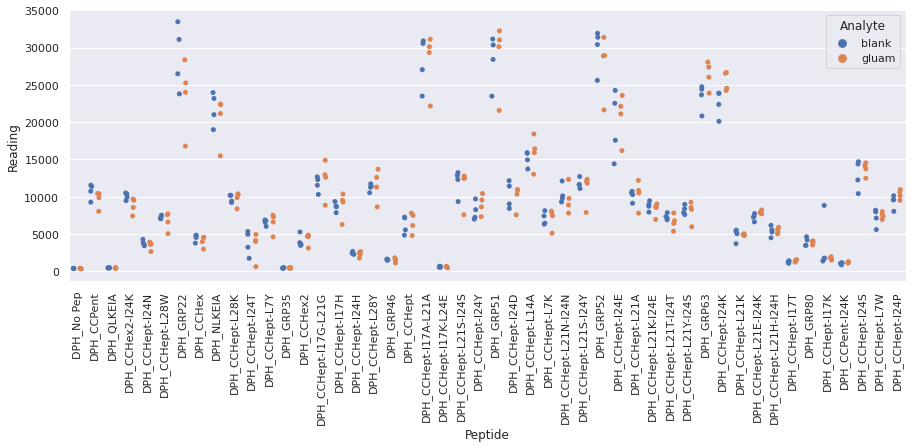

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_6.xlsx
Drawing scatter plot of data spread for mal_repeat_6 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

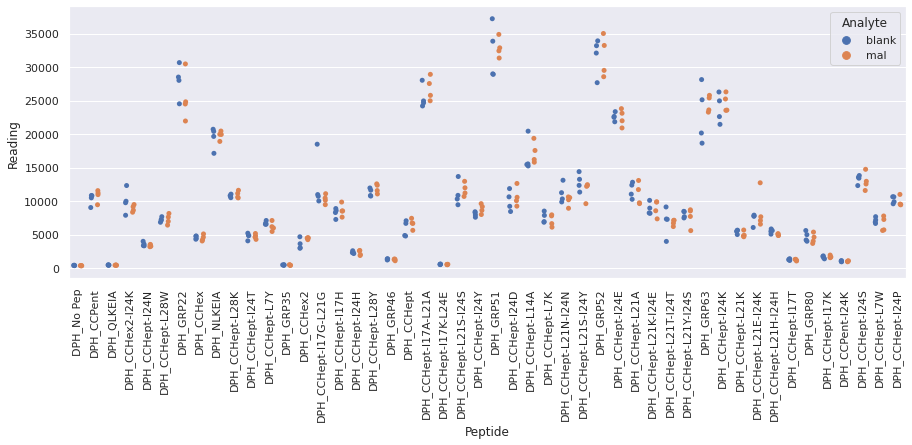

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_6.xlsx
Drawing scatter plot of data spread for man_repeat_6 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

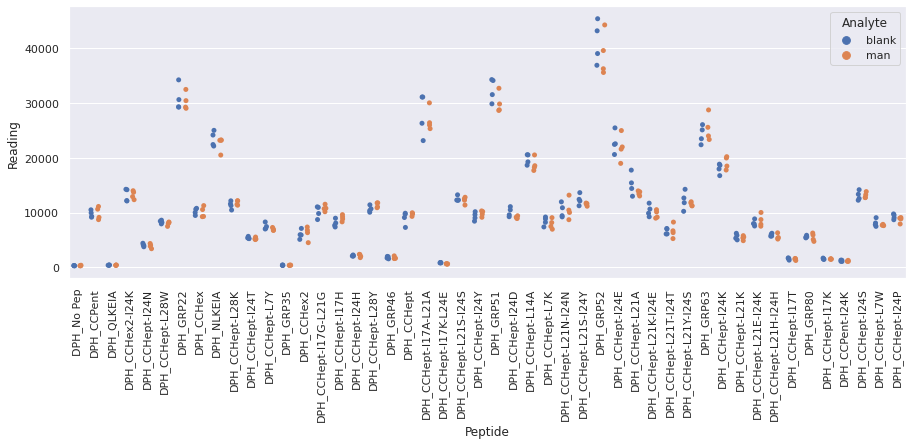

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_7.xlsx
Drawing scatter plot of data spread for fru_repeat_7 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

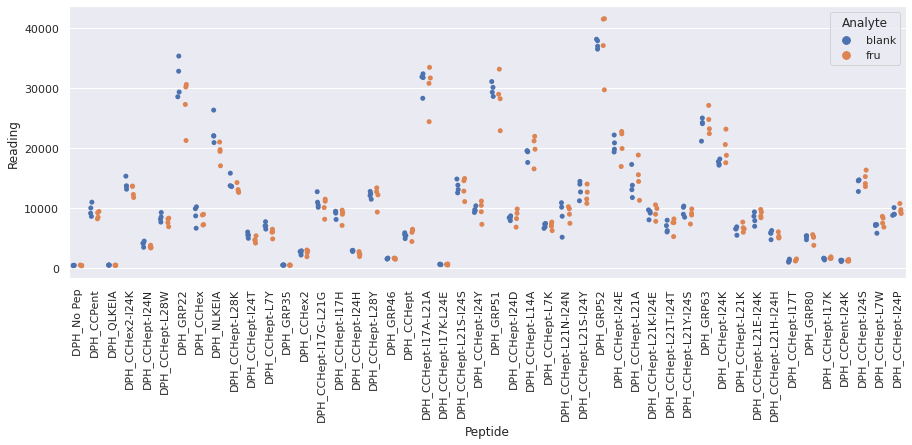

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_7.xlsx
Drawing scatter plot of data spread for glu_repeat_7 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

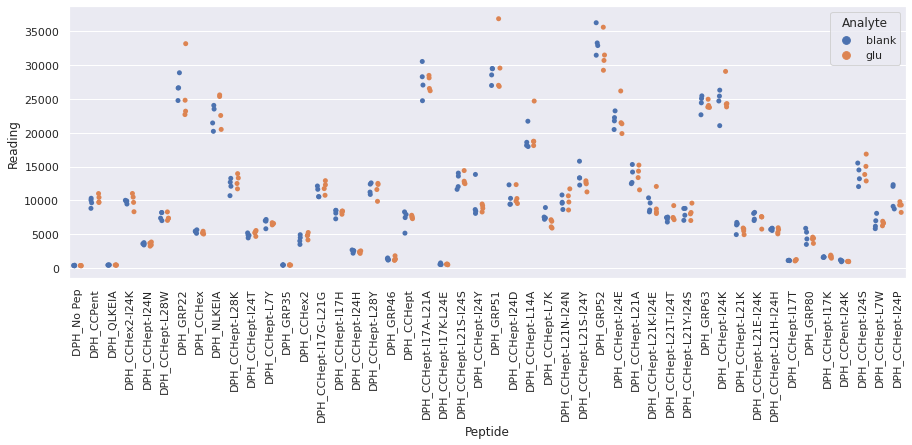

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_7.xlsx
Drawing scatter plot of data spread for gluam_repeat_7 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

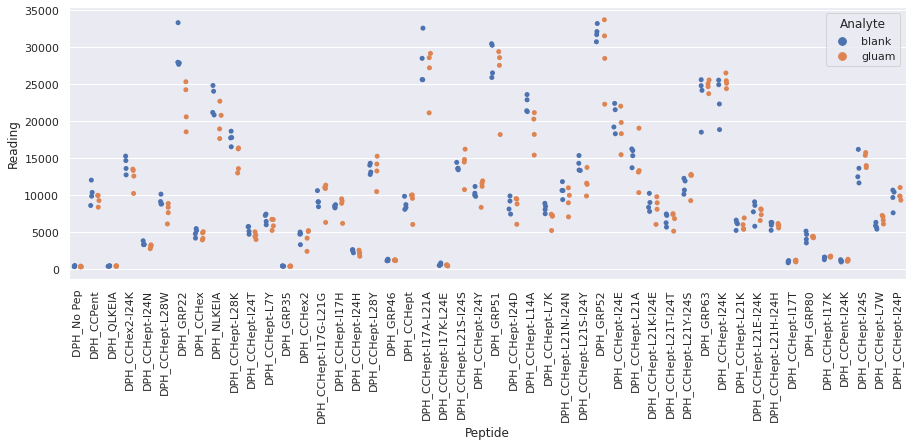

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_7.xlsx
Drawing scatter plot of data spread for mal_repeat_7 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

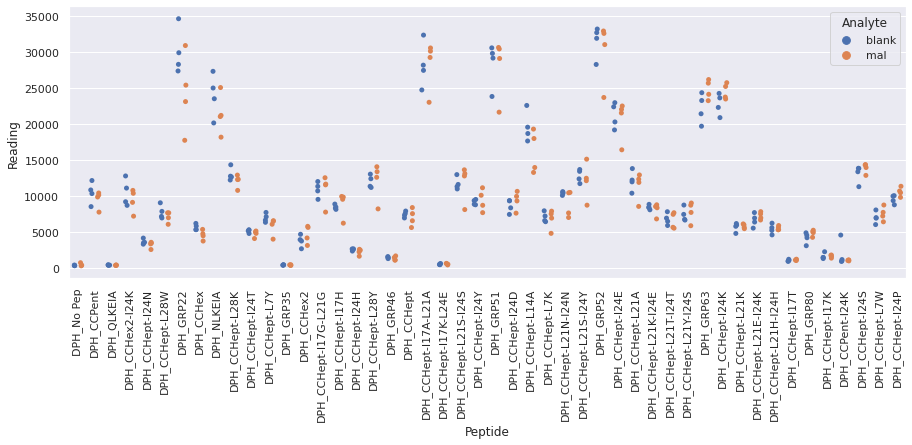

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_7.xlsx
Drawing scatter plot of data spread for man_repeat_7 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

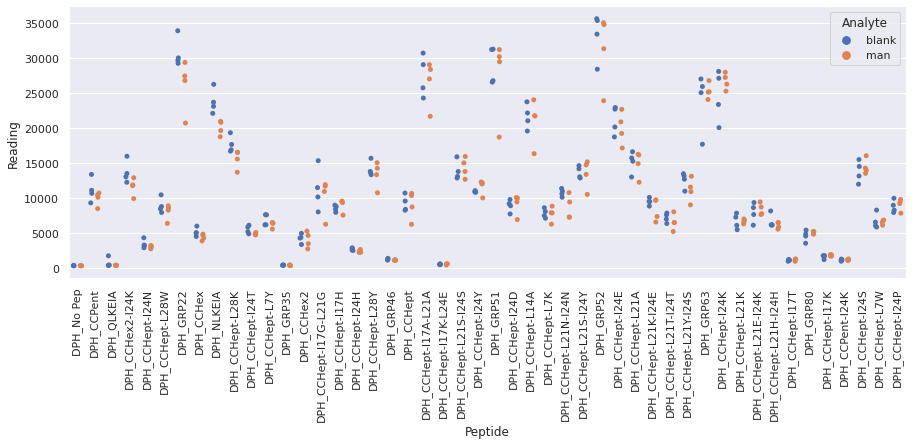

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_8.xlsx
Drawing scatter plot of data spread for fru_repeat_8 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

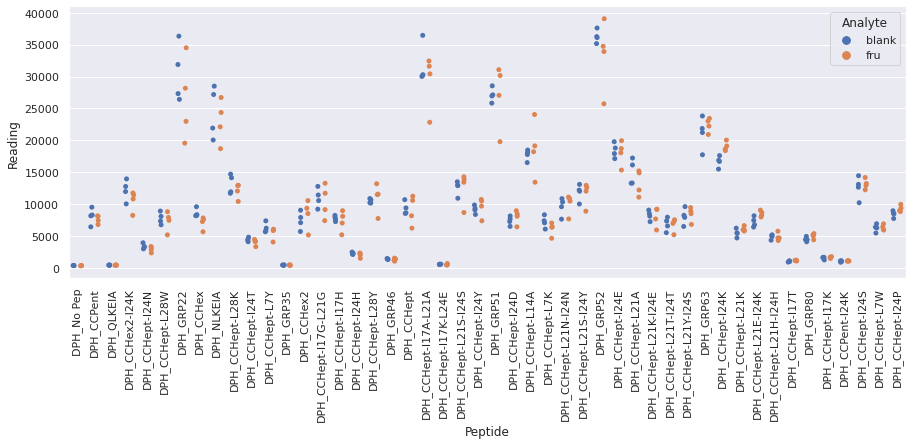

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_8.xlsx
Drawing scatter plot of data spread for glu_repeat_8 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

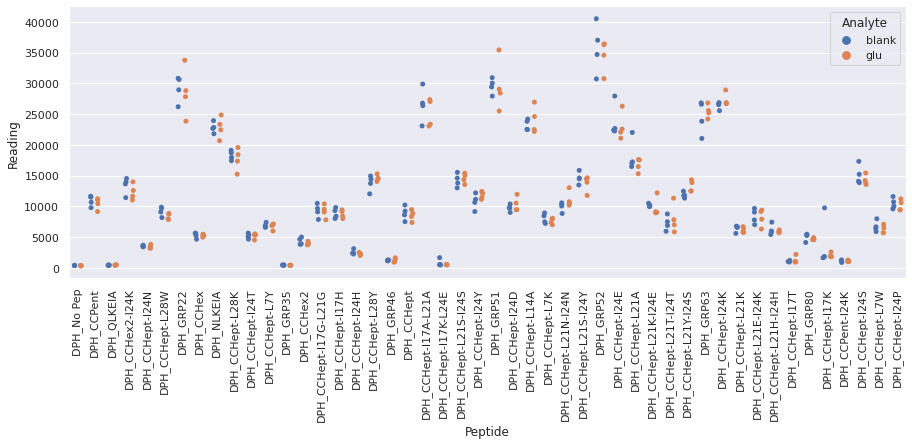

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_8.xlsx
Drawing scatter plot of data spread for gluam_repeat_8 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

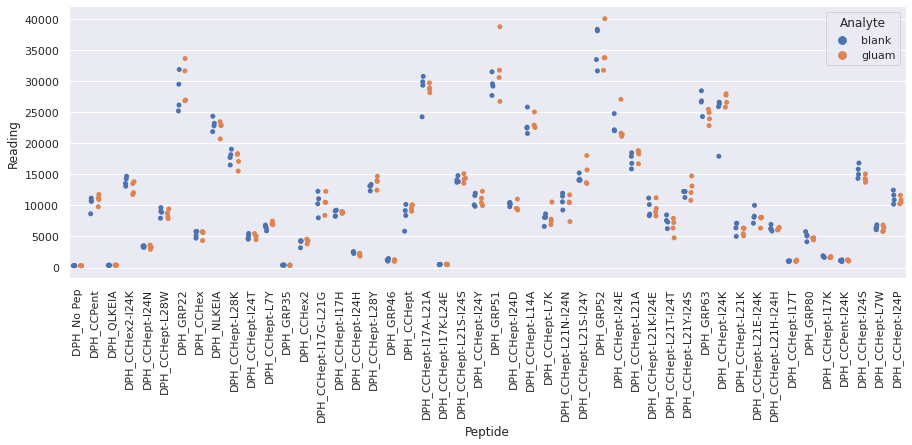

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_8.xlsx
Drawing scatter plot of data spread for mal_repeat_8 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

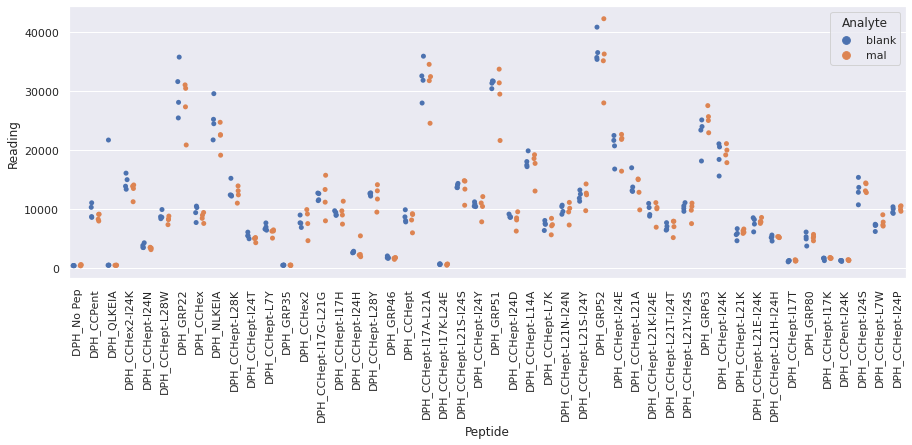

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_8.xlsx
Drawing scatter plot of data spread for man_repeat_8 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

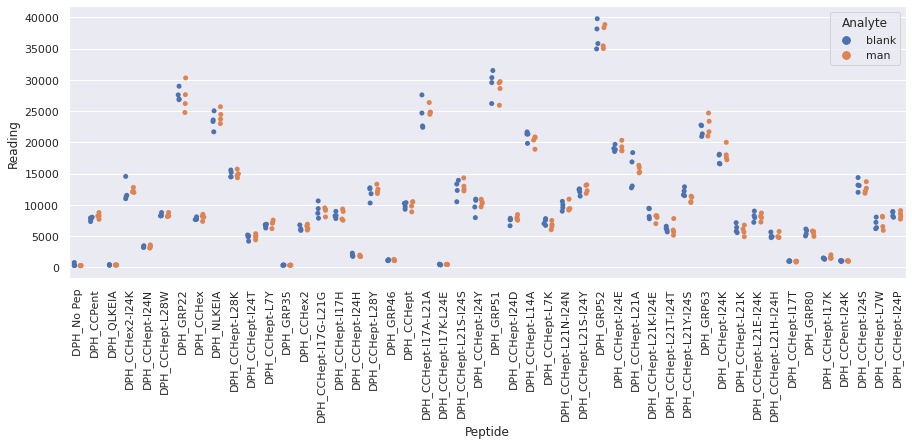

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_9.xlsx
Drawing scatter plot of data spread for fru_repeat_9 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

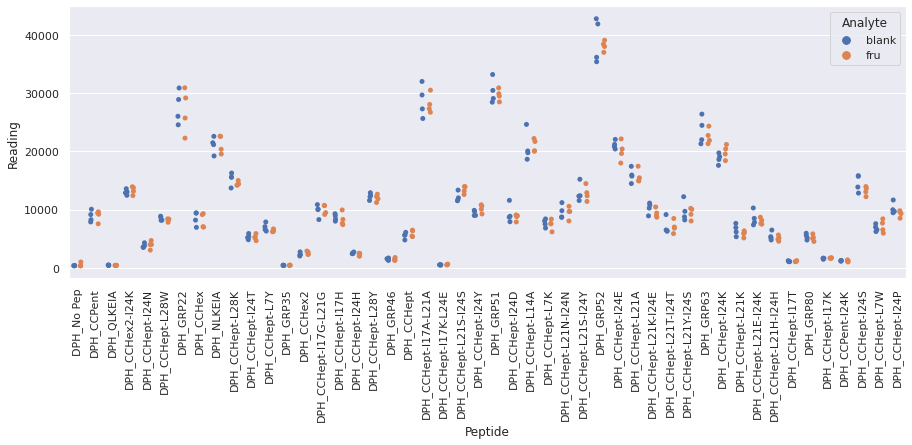

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_9.xlsx
Drawing scatter plot of data spread for glu_repeat_9 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

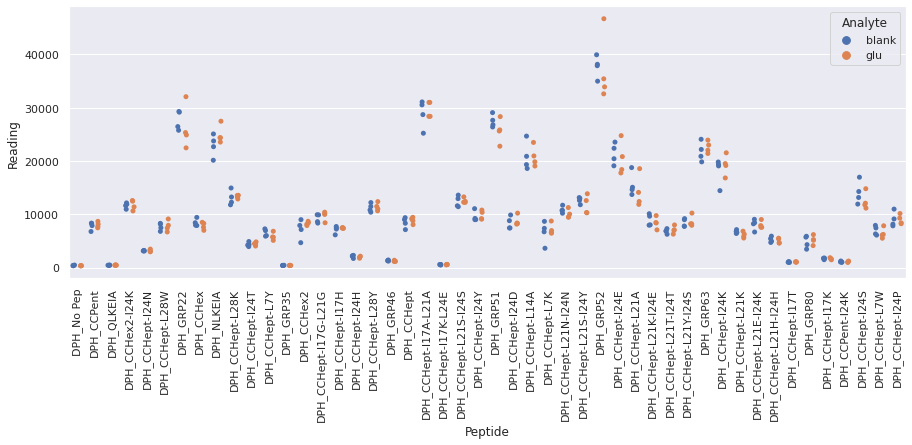

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_9.xlsx
Drawing scatter plot of data spread for gluam_repeat_9 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

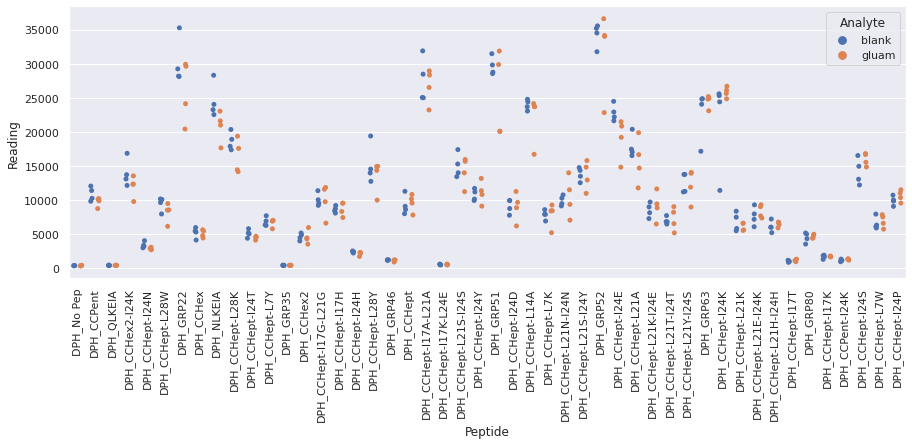

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_9.xlsx
Drawing scatter plot of data spread for mal_repeat_9 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

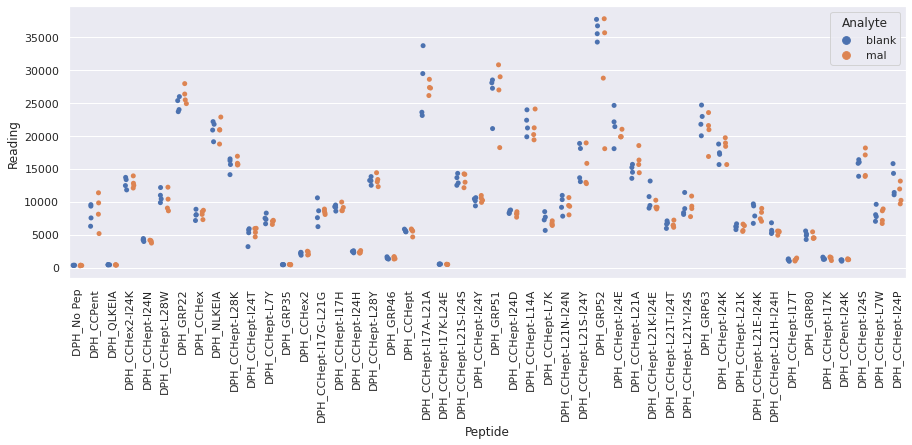

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_9.xlsx
Drawing scatter plot of data spread for man_repeat_9 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

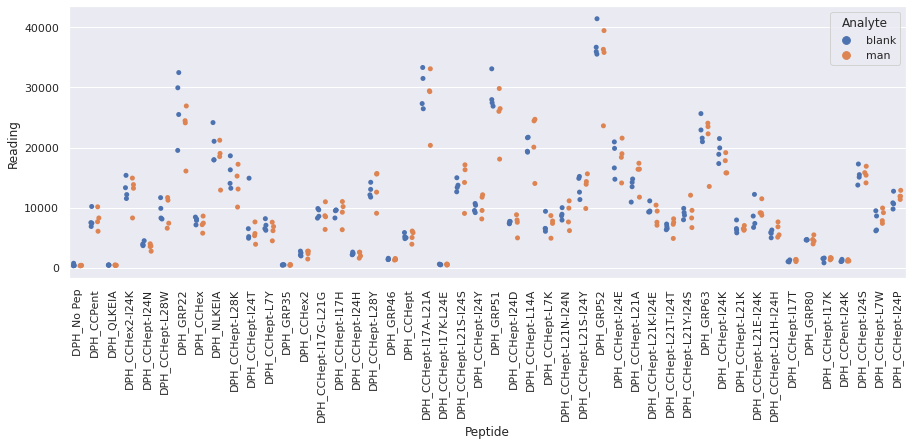

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_10.xlsx
Drawing scatter plot of data spread for fru_repeat_10 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

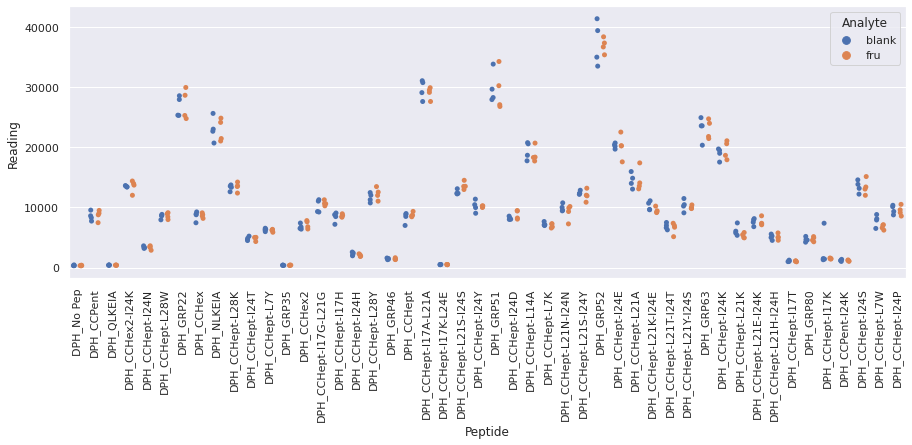

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/glu_repeat_10.xlsx
Drawing scatter plot of data spread for glu_repeat_10 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

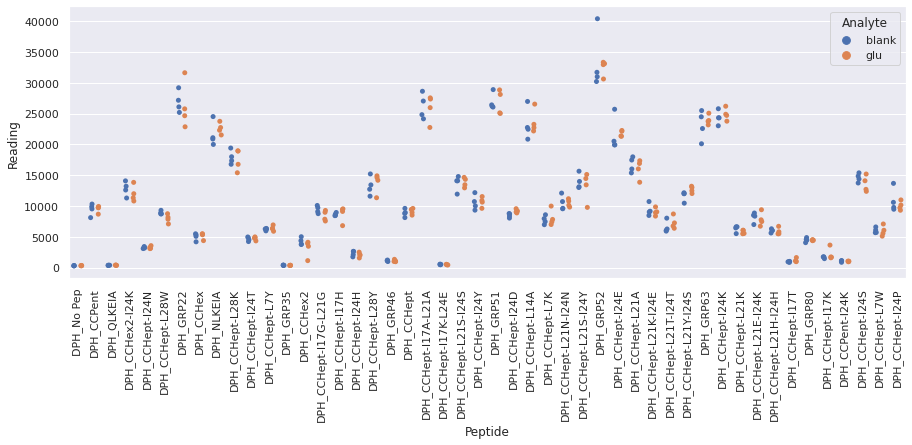

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/gluam_repeat_10.xlsx
Drawing scatter plot of data spread for gluam_repeat_10 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

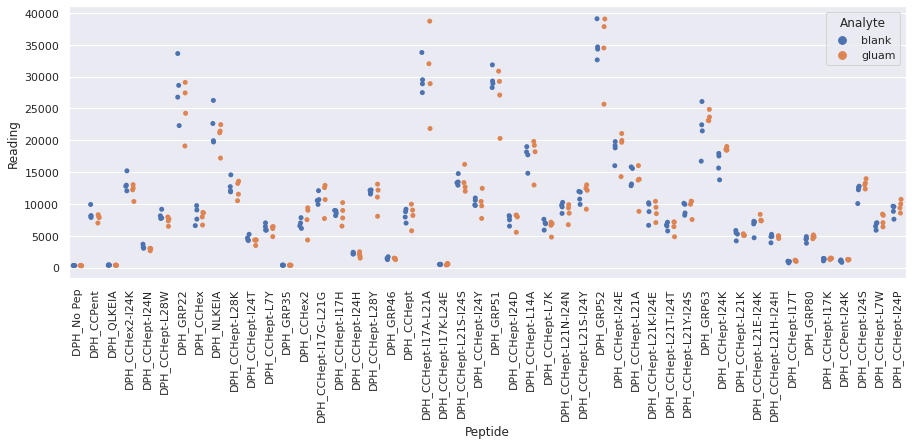

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_10.xlsx
Drawing scatter plot of data spread for mal_repeat_10 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

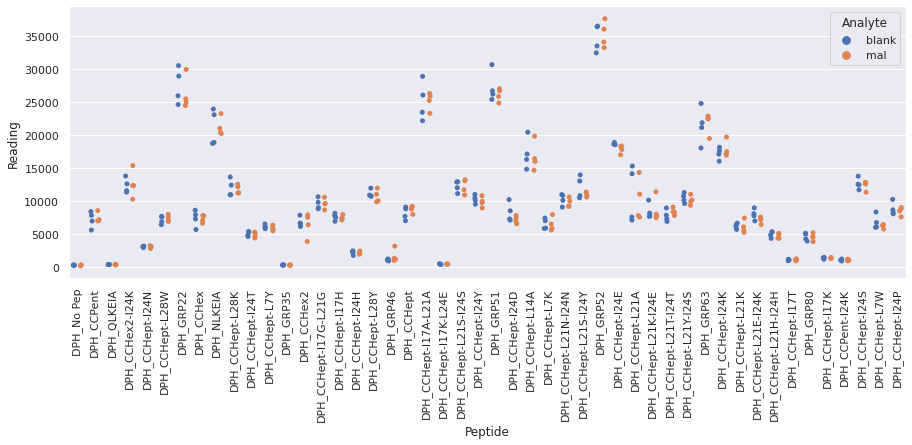

Parsing plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/man_repeat_10.xlsx
Drawing scatter plot of data spread for man_repeat_10 in Sugar_unscaled_data


<Figure size 720x720 with 0 Axes>

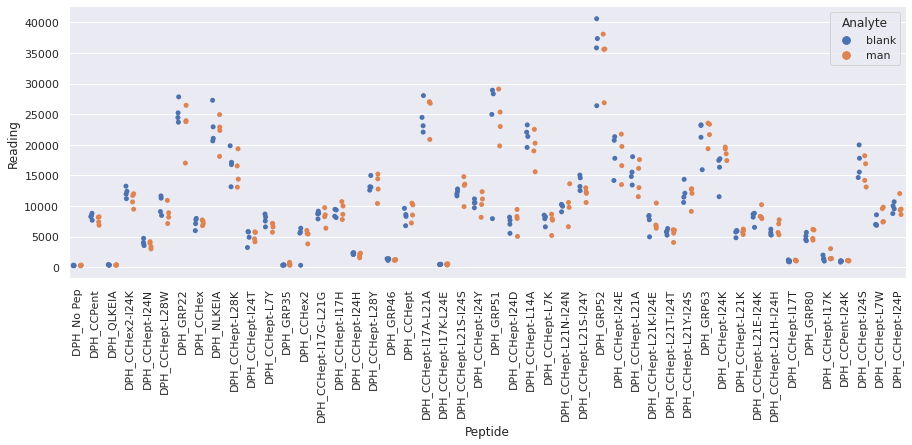

Drawing scatter plot of data spread for fru_repeat_1 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

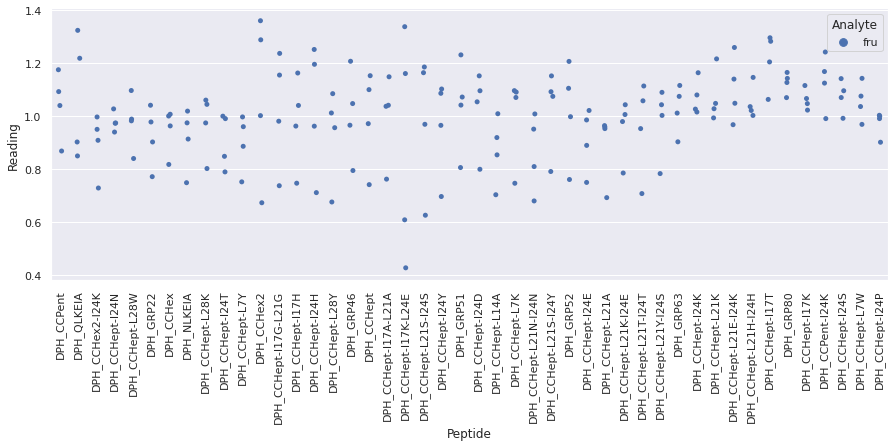

Drawing scatter plot of data spread for glu_repeat_1 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

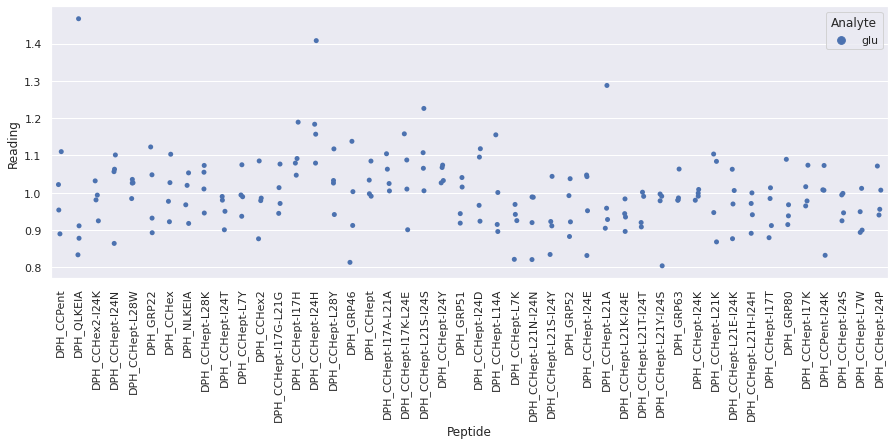

Drawing scatter plot of data spread for gluam_repeat_1 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

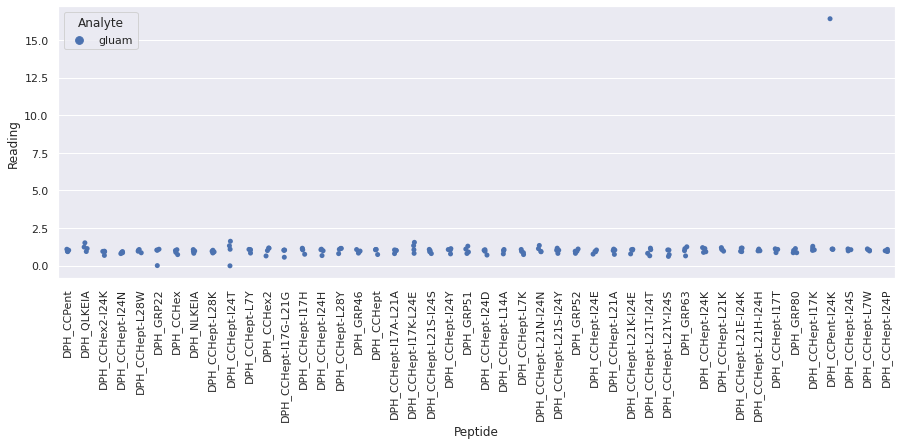

Drawing scatter plot of data spread for mal_repeat_1 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

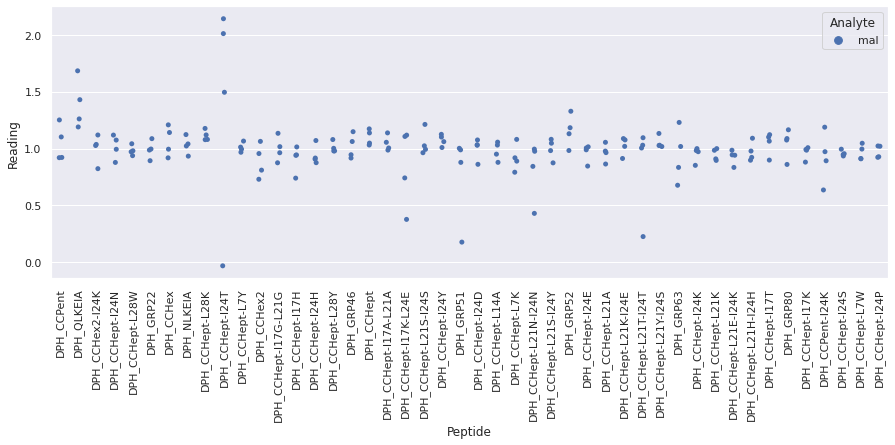

Drawing scatter plot of data spread for man_repeat_1 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

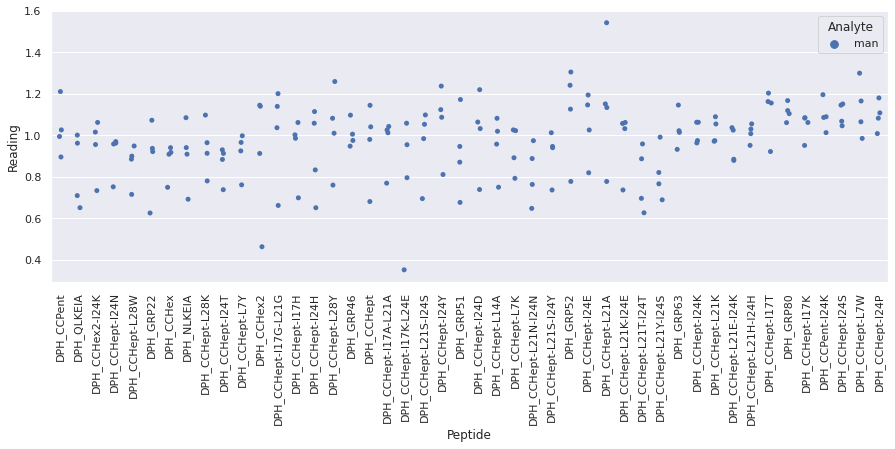

Drawing scatter plot of data spread for fru_repeat_2 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

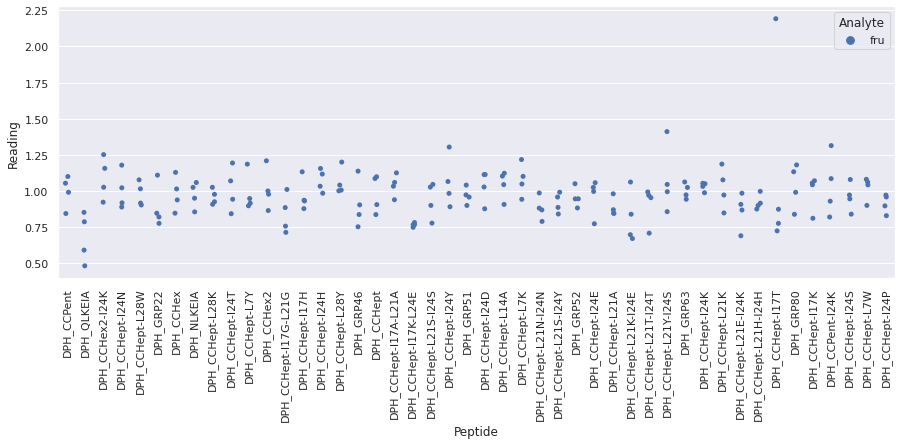

Drawing scatter plot of data spread for glu_repeat_2 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

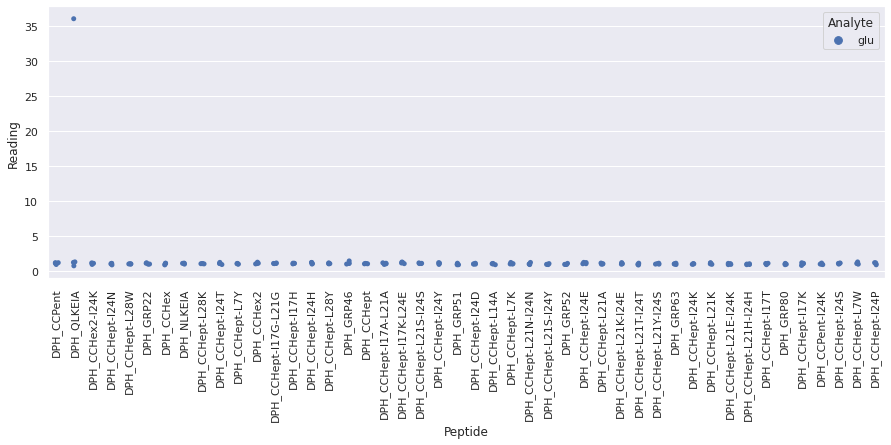

Drawing scatter plot of data spread for gluam_repeat_2 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

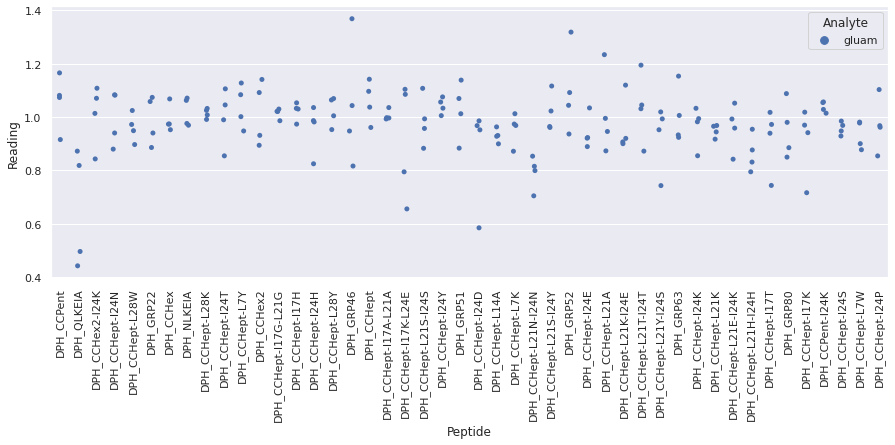

Drawing scatter plot of data spread for mal_repeat_2 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

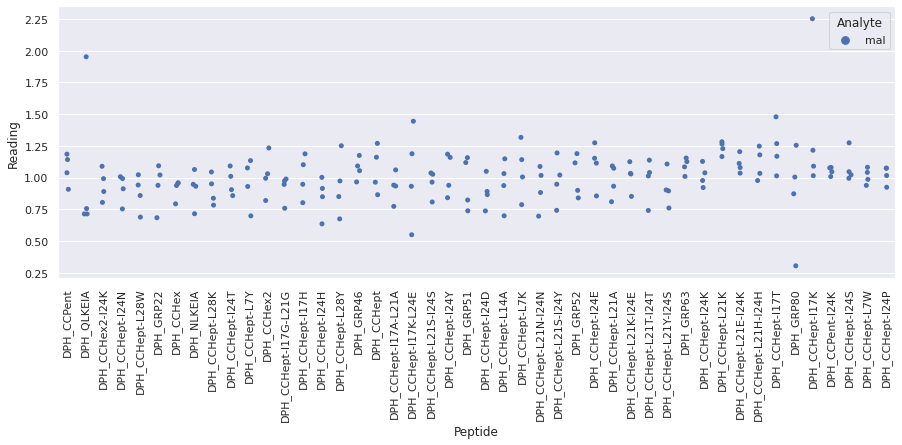

Drawing scatter plot of data spread for man_repeat_2 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

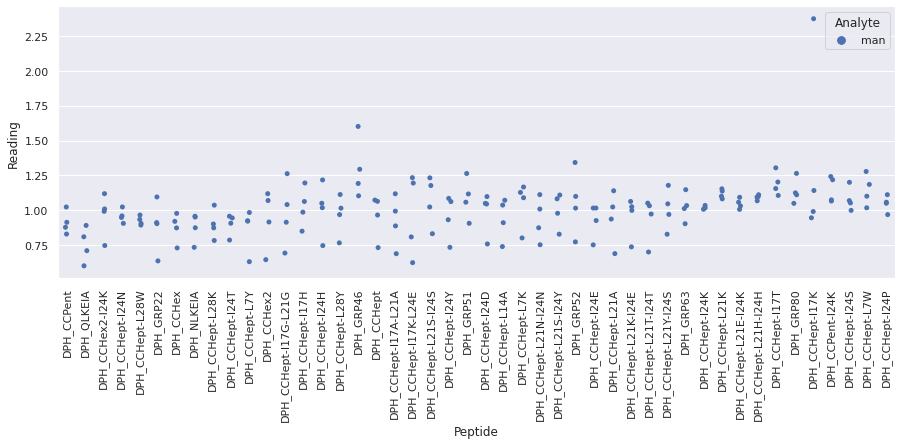

Drawing scatter plot of data spread for fru_repeat_3 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

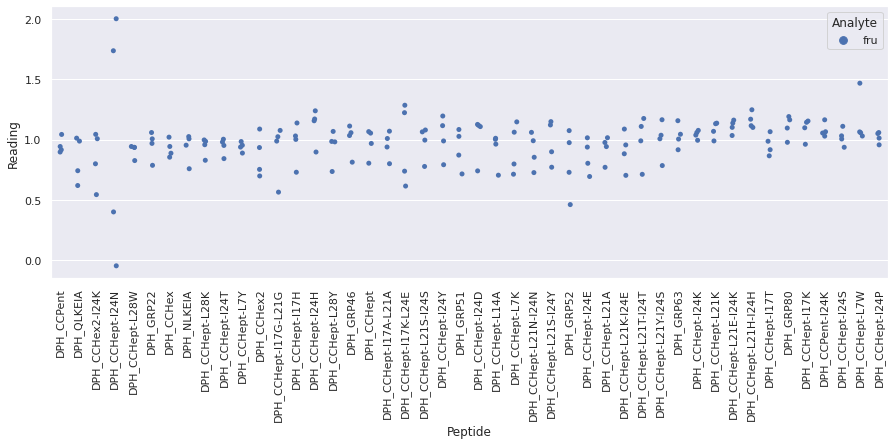

Drawing scatter plot of data spread for glu_repeat_3 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

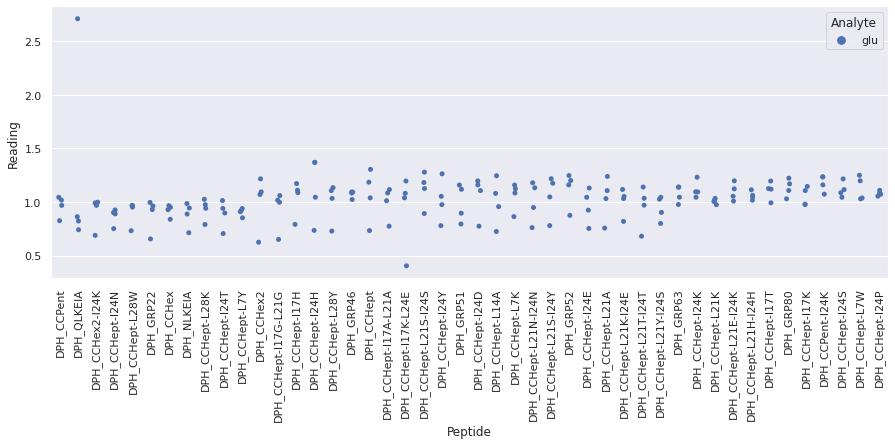

Drawing scatter plot of data spread for gluam_repeat_3 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

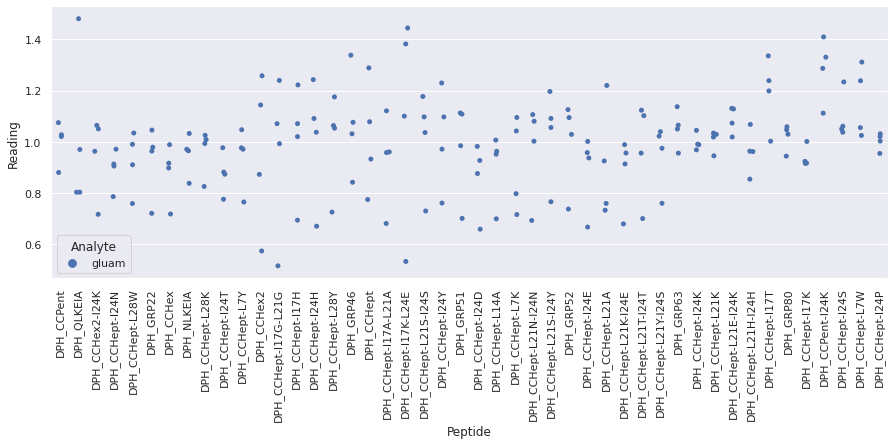

Drawing scatter plot of data spread for mal_repeat_3 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

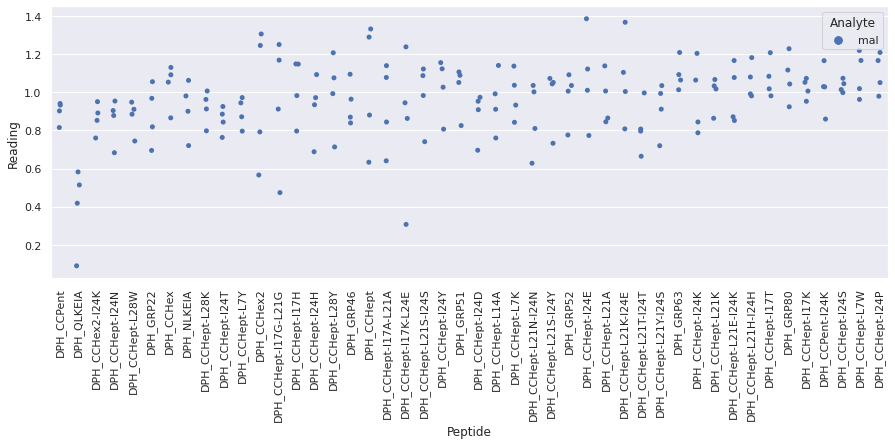

Drawing scatter plot of data spread for man_repeat_3 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

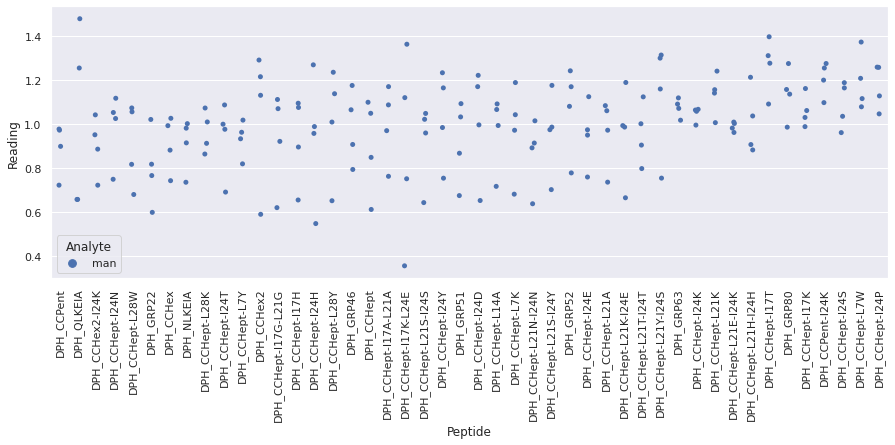

Drawing scatter plot of data spread for fru_repeat_4 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

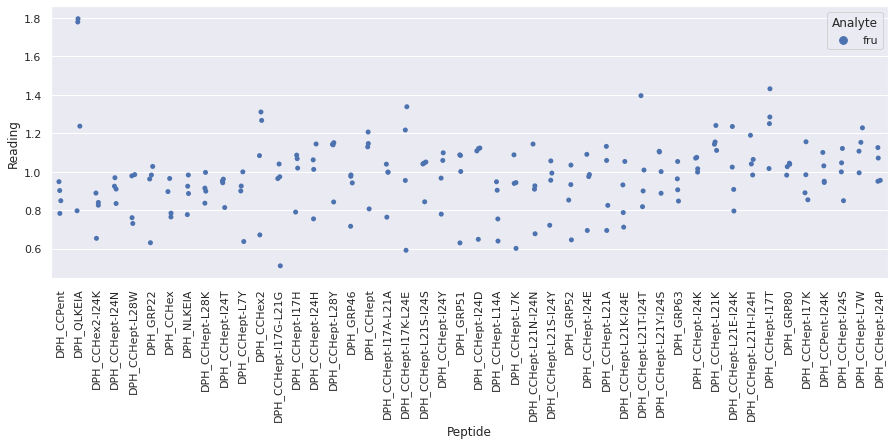

Drawing scatter plot of data spread for glu_repeat_4 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

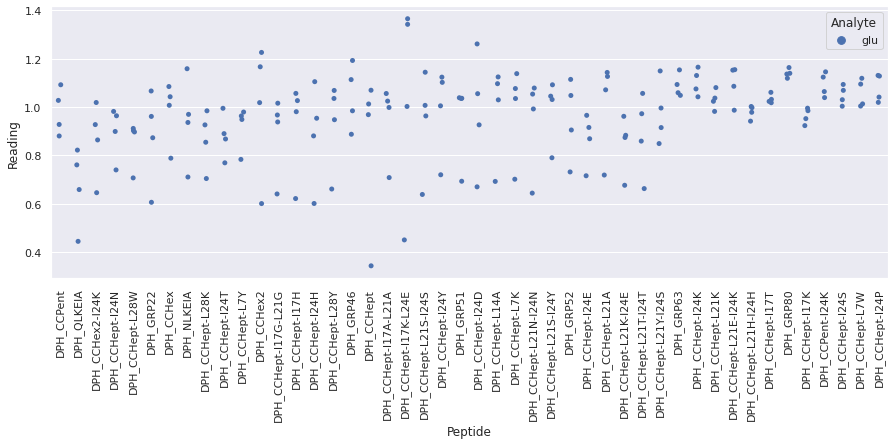

Drawing scatter plot of data spread for gluam_repeat_4 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

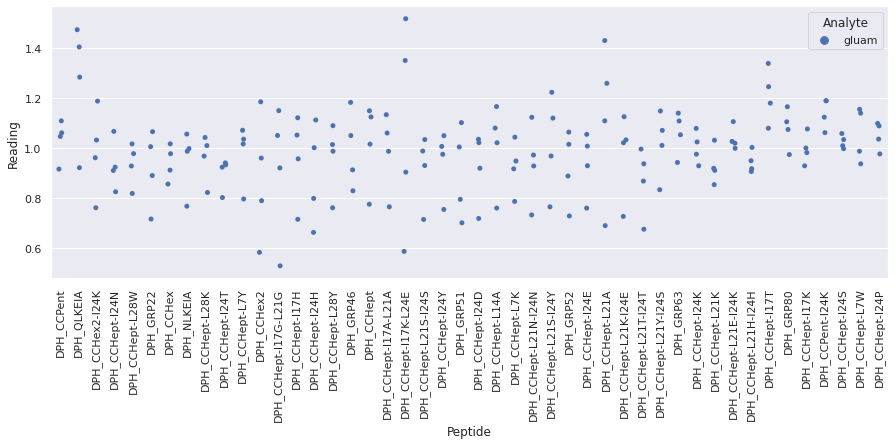

Drawing scatter plot of data spread for mal_repeat_4 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

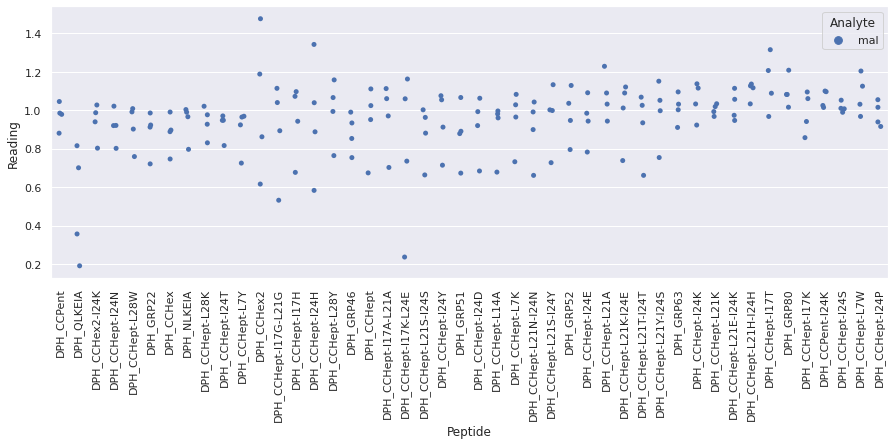

Drawing scatter plot of data spread for man_repeat_4 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

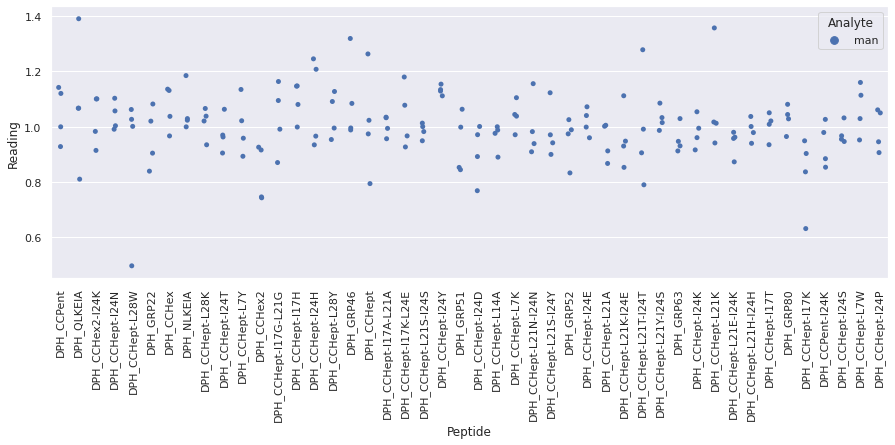

Drawing scatter plot of data spread for fru_repeat_5 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

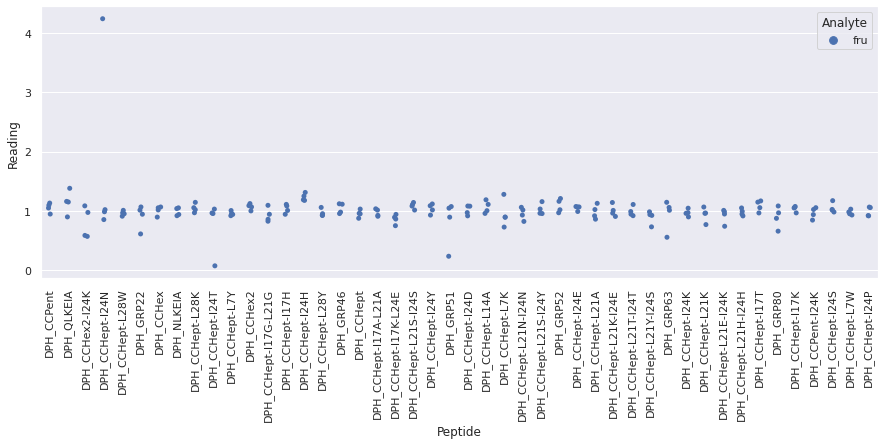

Drawing scatter plot of data spread for glu_repeat_5 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

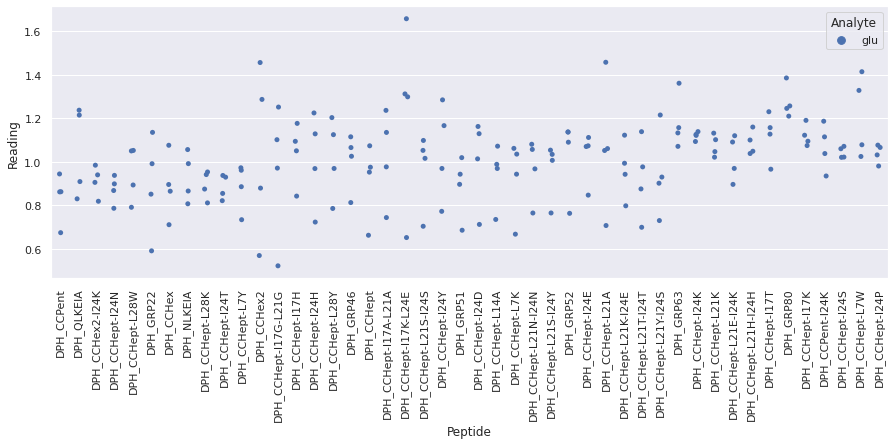

Drawing scatter plot of data spread for gluam_repeat_5 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

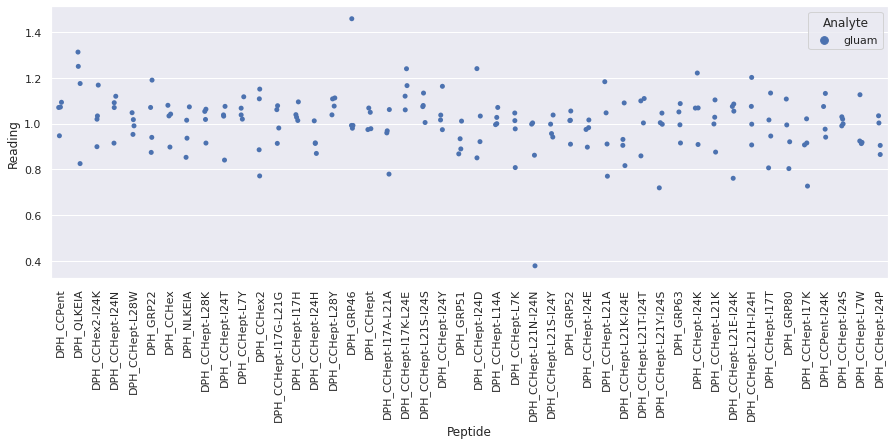

Drawing scatter plot of data spread for mal_repeat_5 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

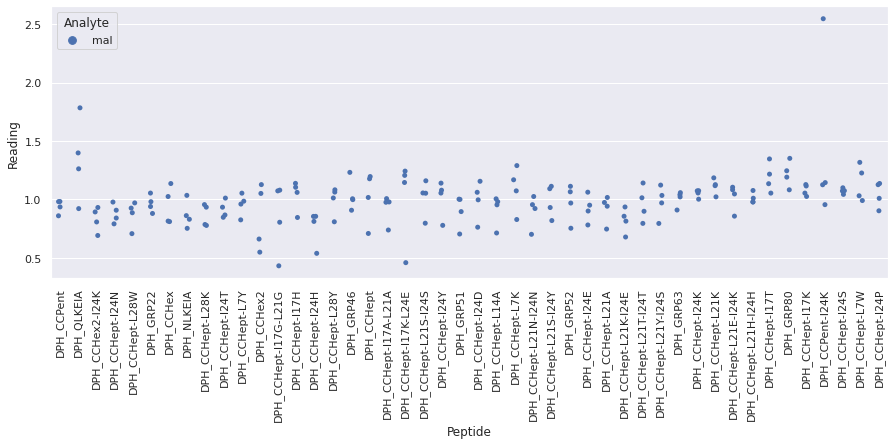

Drawing scatter plot of data spread for man_repeat_5 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

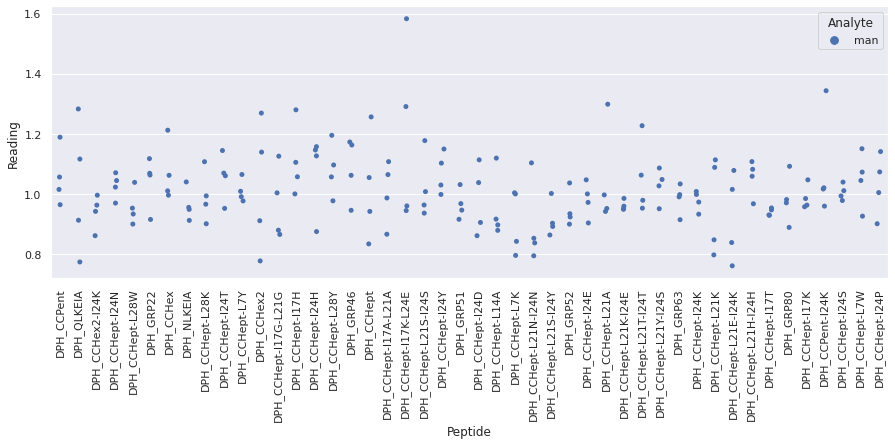

Drawing scatter plot of data spread for fru_repeat_6 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

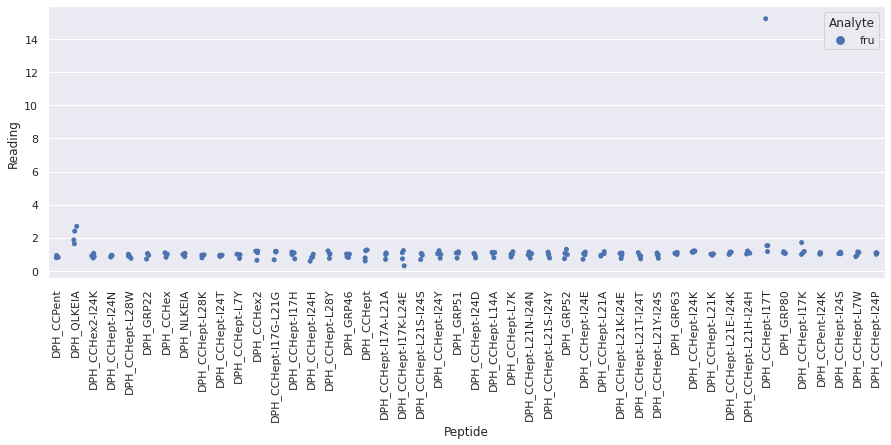

Drawing scatter plot of data spread for glu_repeat_6 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

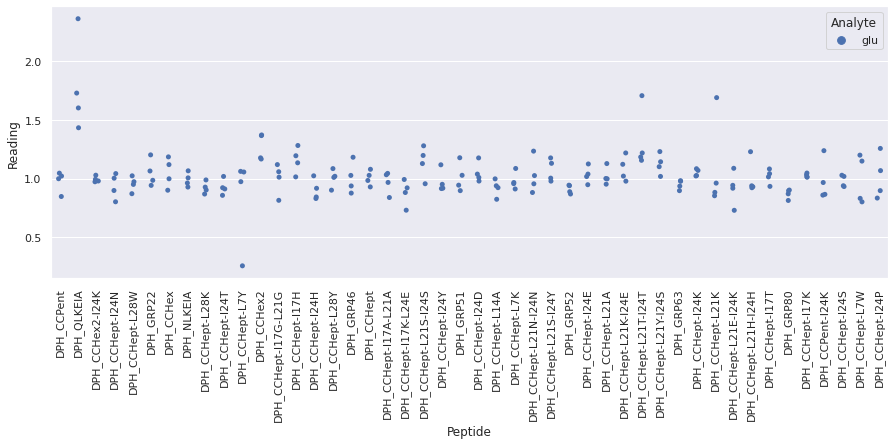

Drawing scatter plot of data spread for gluam_repeat_6 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

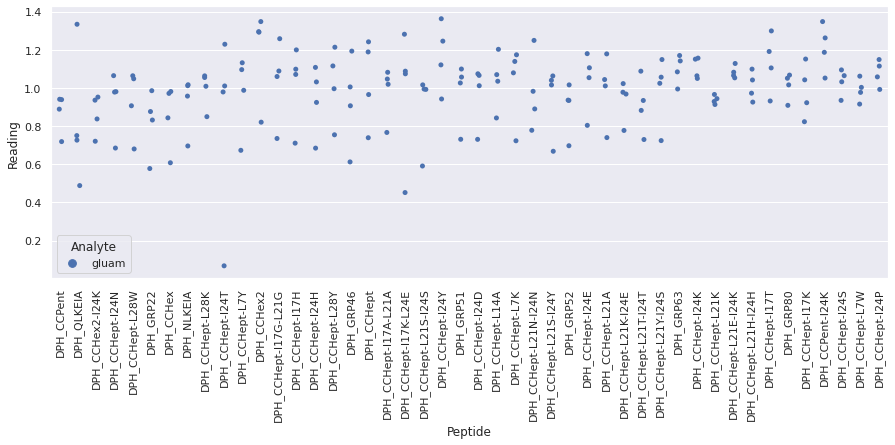

Drawing scatter plot of data spread for mal_repeat_6 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

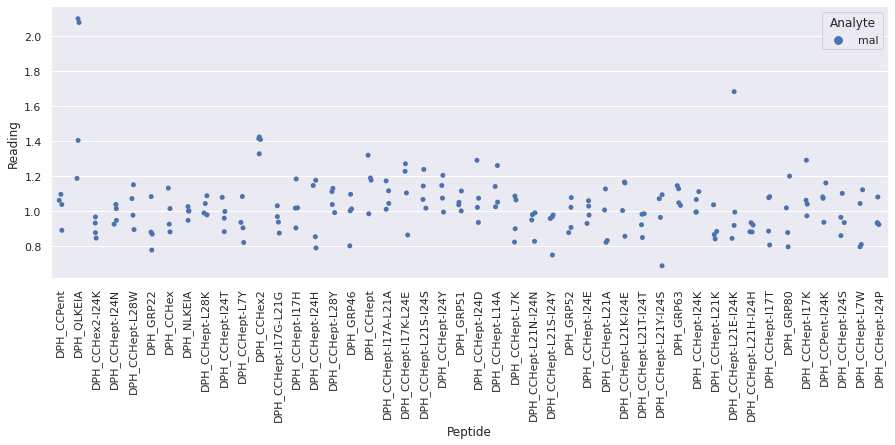

Drawing scatter plot of data spread for man_repeat_6 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

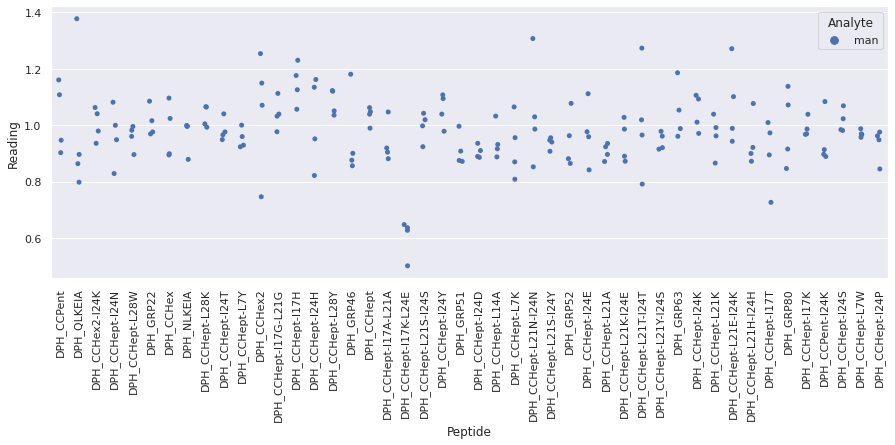

Drawing scatter plot of data spread for fru_repeat_7 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

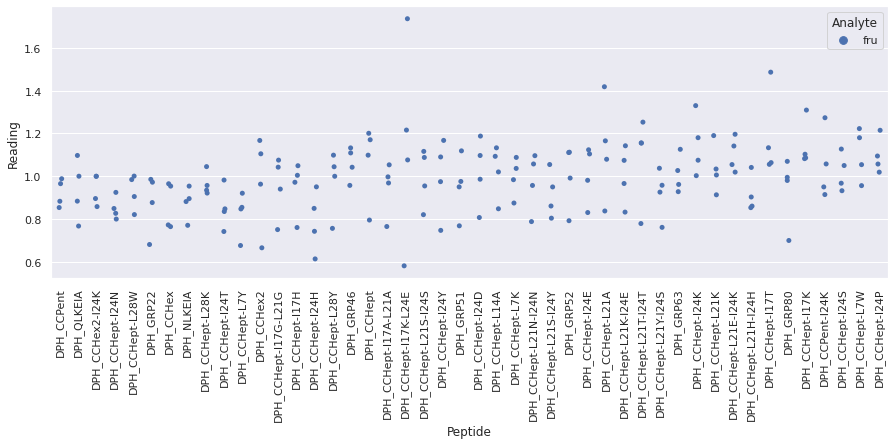

Drawing scatter plot of data spread for glu_repeat_7 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

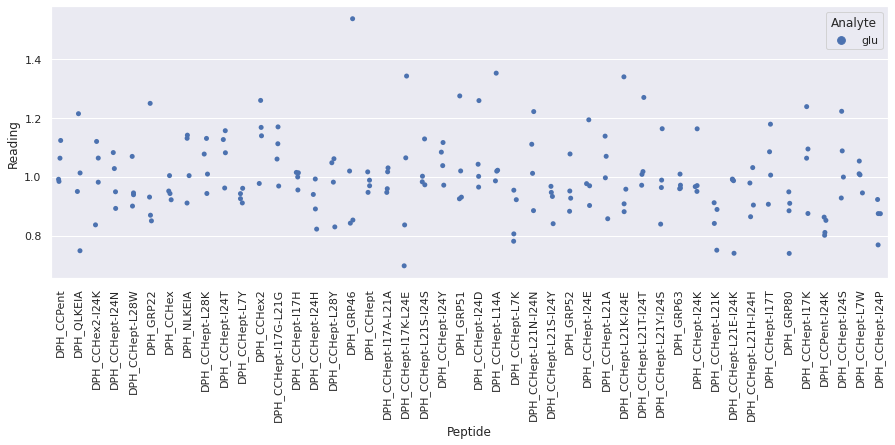

Drawing scatter plot of data spread for gluam_repeat_7 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

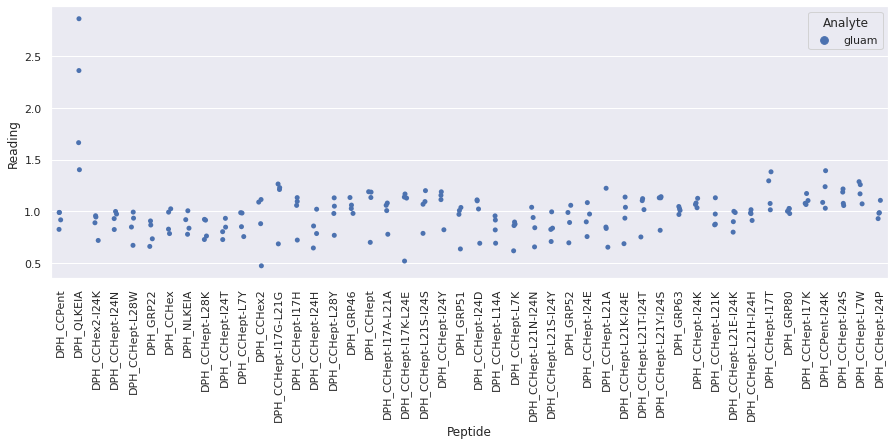

 WARNING - median fluorescence of (mal + DPH_QLKEIA + fluorophore) is less than fluorescence of (mal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_7.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for mal_repeat_7 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

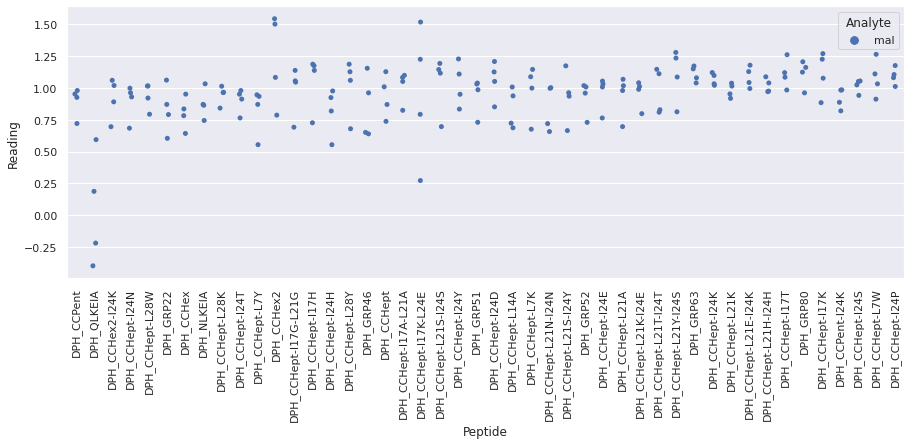

Drawing scatter plot of data spread for man_repeat_7 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

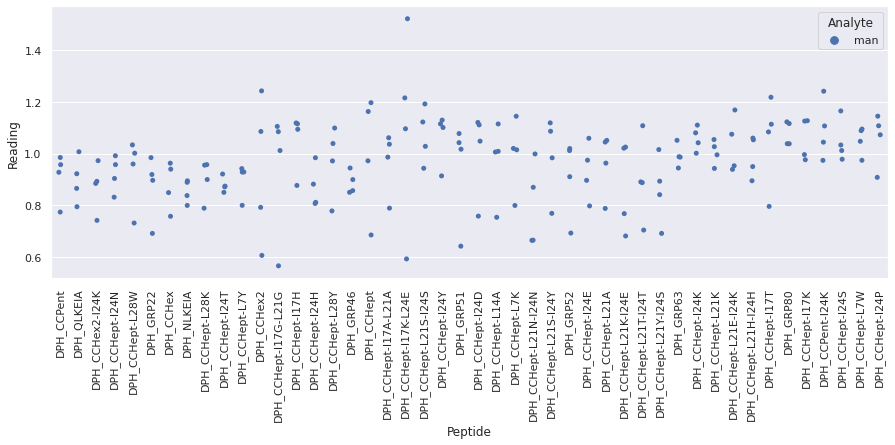

Drawing scatter plot of data spread for fru_repeat_8 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

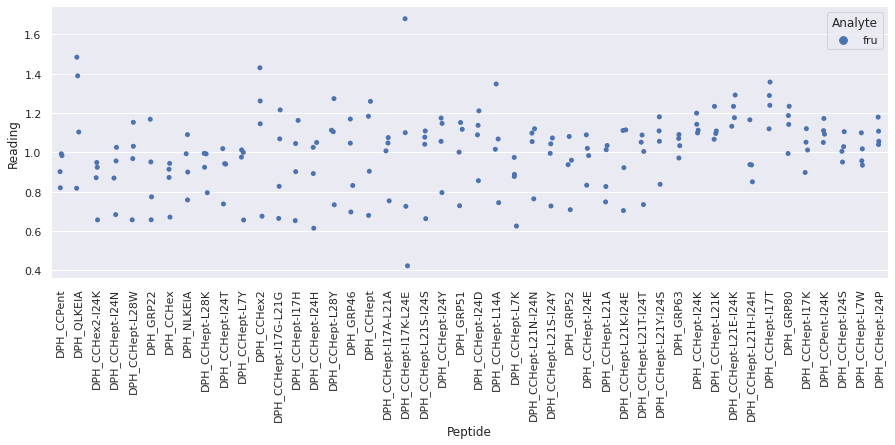

Drawing scatter plot of data spread for glu_repeat_8 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

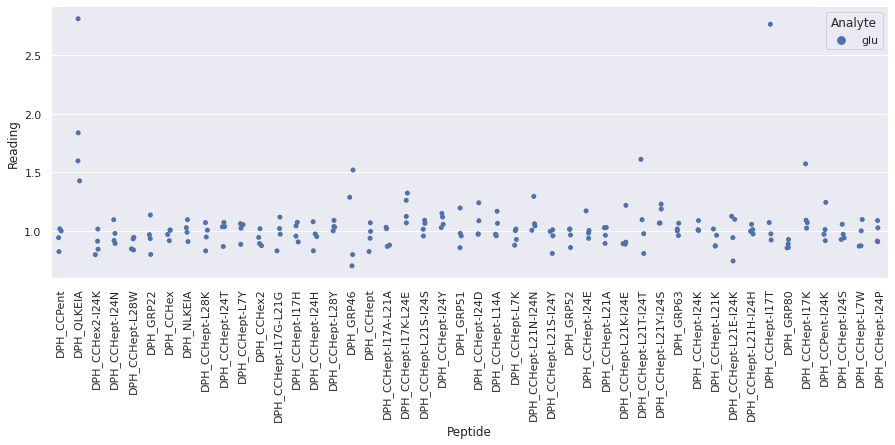

Drawing scatter plot of data spread for gluam_repeat_8 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

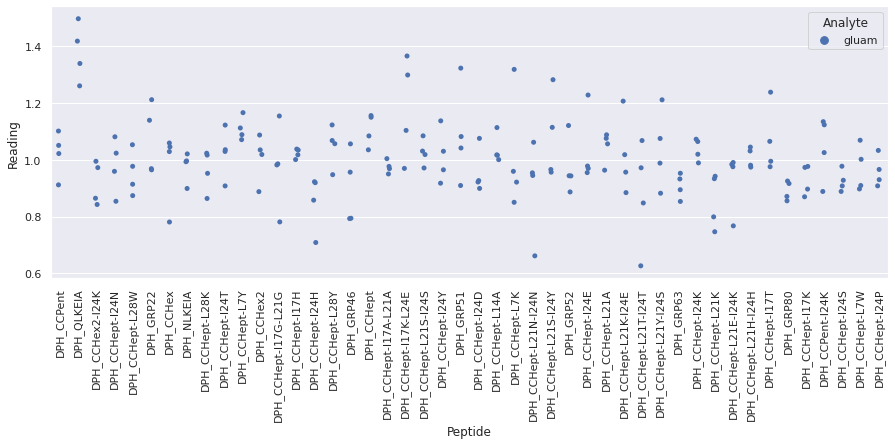

 WARNING - median fluorescence of (mal + DPH_QLKEIA + fluorophore) is less than fluorescence of (mal + fluorophore) alone on plate /home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/mal_repeat_8.xlsx. Analysis will continue but please CHECK YOUR DATA. 
Drawing scatter plot of data spread for mal_repeat_8 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

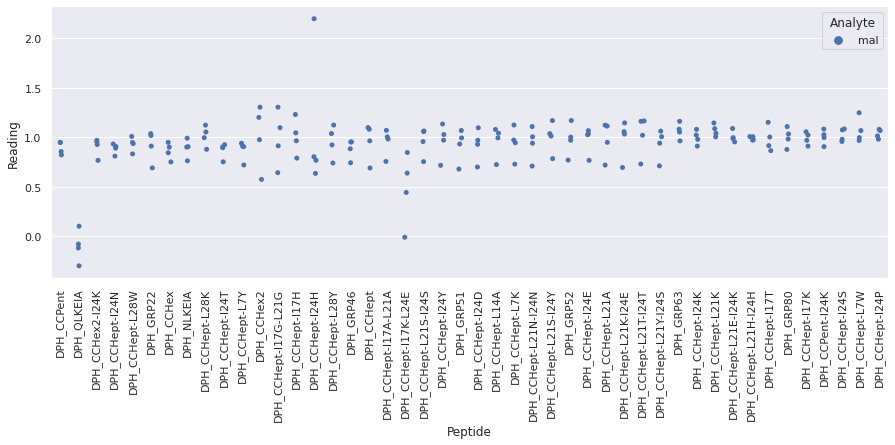

Drawing scatter plot of data spread for man_repeat_8 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

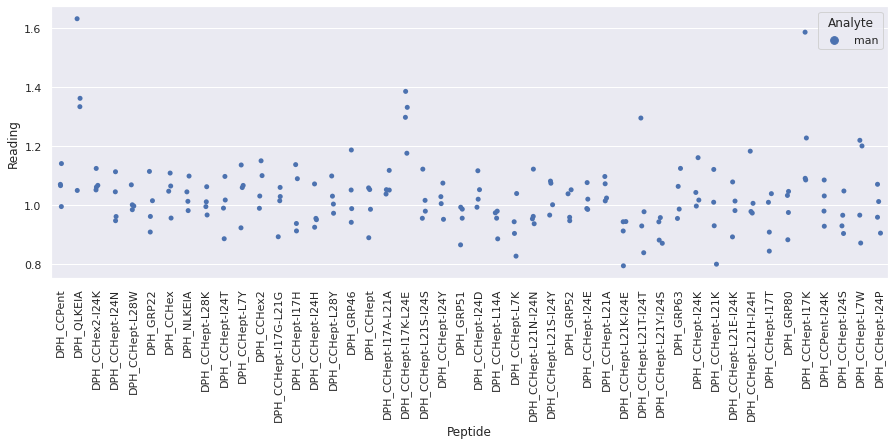

Drawing scatter plot of data spread for fru_repeat_9 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

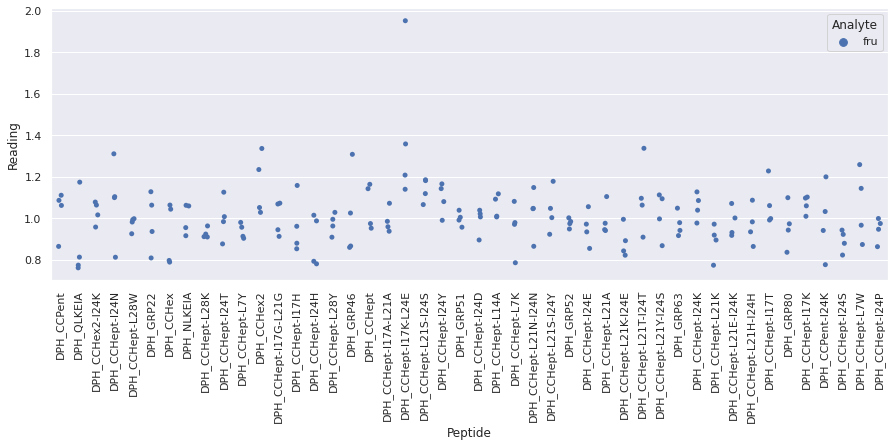

Drawing scatter plot of data spread for glu_repeat_9 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

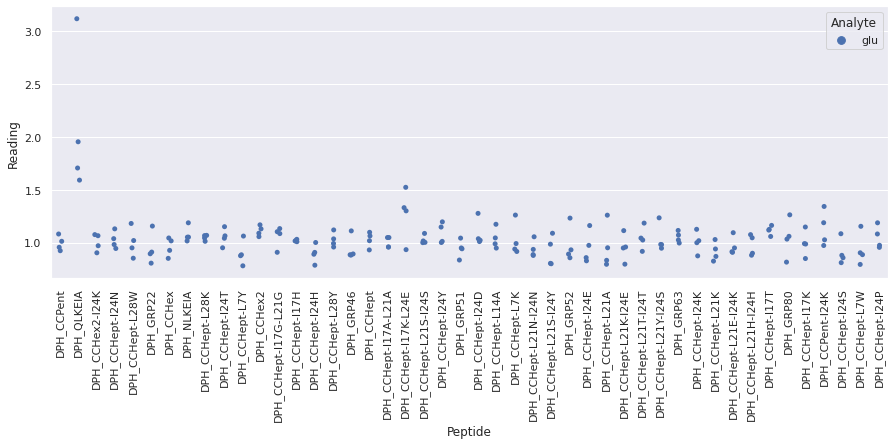

Drawing scatter plot of data spread for gluam_repeat_9 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

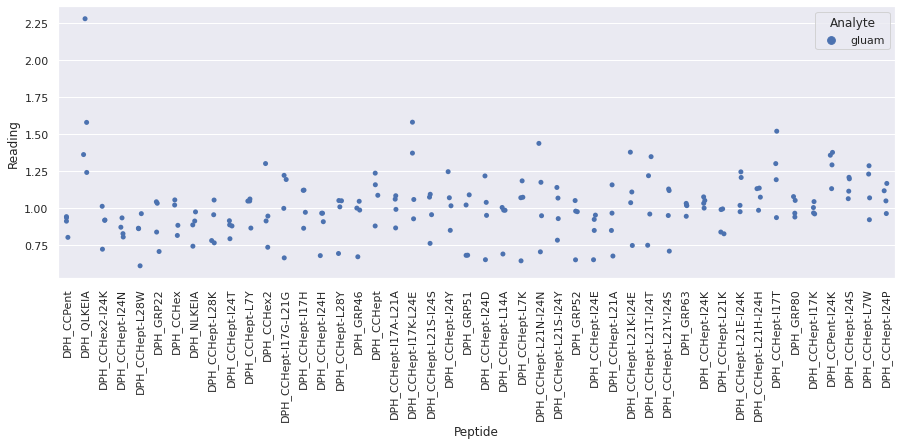

Drawing scatter plot of data spread for mal_repeat_9 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

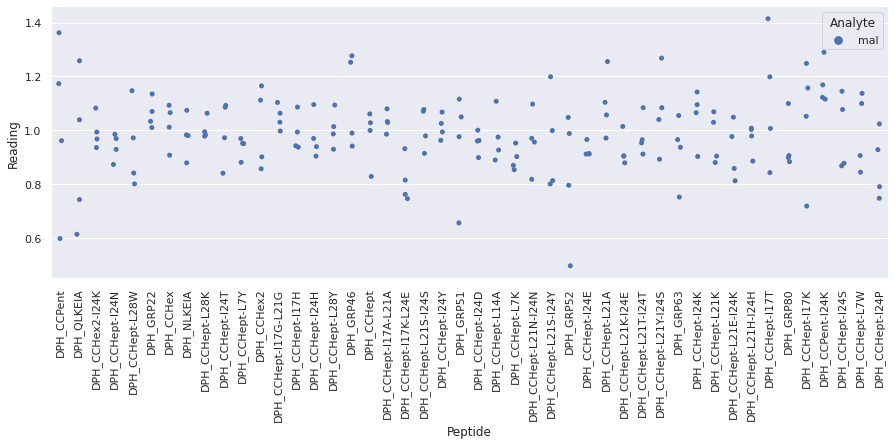

Drawing scatter plot of data spread for man_repeat_9 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

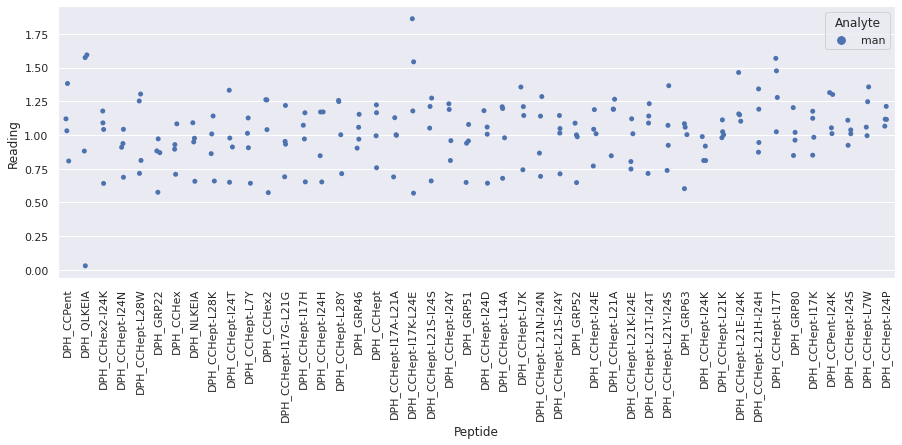

Drawing scatter plot of data spread for fru_repeat_10 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

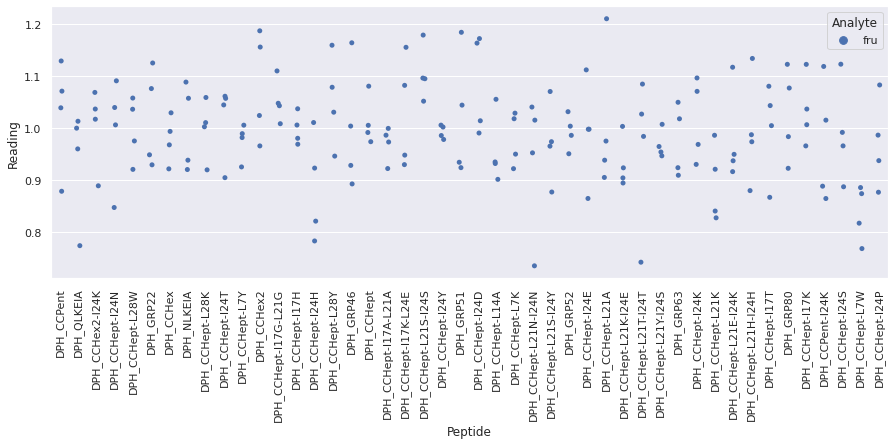

Drawing scatter plot of data spread for glu_repeat_10 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

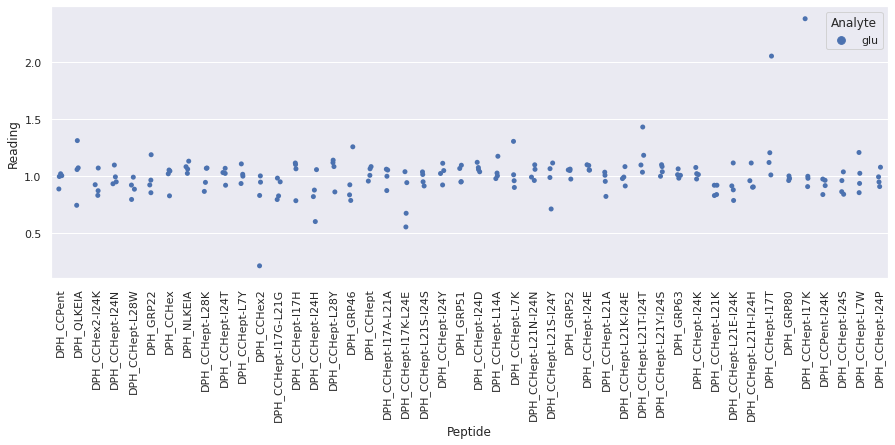

Drawing scatter plot of data spread for gluam_repeat_10 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

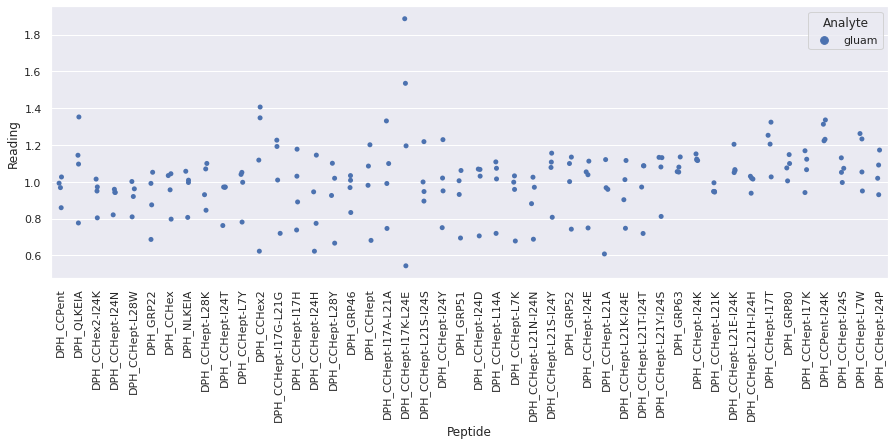

Drawing scatter plot of data spread for mal_repeat_10 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

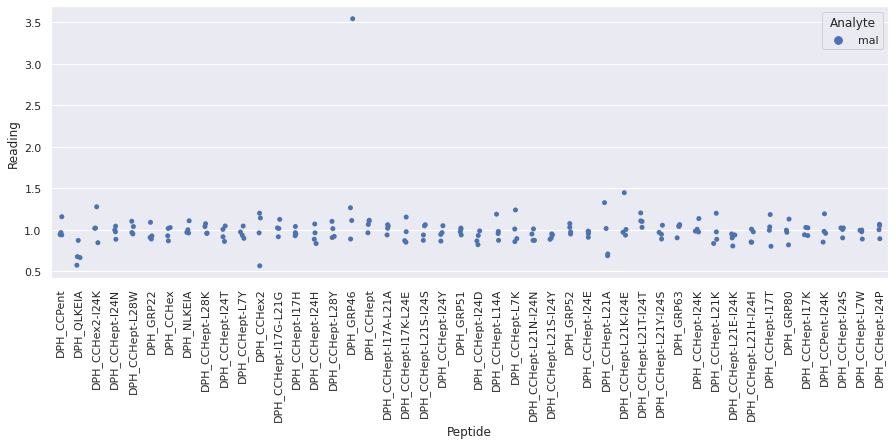

Drawing scatter plot of data spread for man_repeat_10 in Sugar_scaled_data


<Figure size 720x720 with 0 Axes>

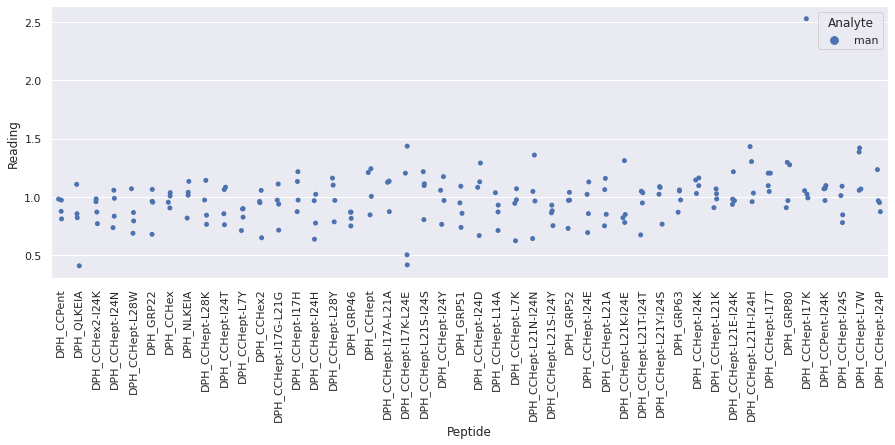



Outliers on the same plate:

/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-I24N, 5154.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-L28K, 24009.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-L21K, 5090.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-L21E-I24K, 6301.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-I17K, 1343.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars/Reformatted_sugar_csvs/fru_repeat_1.xlsx: blank, DPH_CCHept-I24S, 13076.0
/home/ks17361/ML_environment/BADASS/Small_molecule_data_large_array/Sugars

In [15]:
sugar_fluor_data.xlsx_to_scaled_df(
    no_pep={'DPH': 'No Pep'}, scale_method='analyte_fluorophore', draw_plot=True, plot_dir_name='Sugar'
)

At a glance:
- There are no plates in the dataset that by eye are obviously anomalous
- As expected given the AA and FA data, the fluorescence of peptides GRP35, QLKEIA and CCHept-I17K-L24E in the presence of DPH is very similar to that of DPH on its own.
- In all cases, addition of analyte causes little/no (by eye) noticeable change in fluorescence signal. This would likely make the fingerprints of the different sugar subclasses difficult to distinguish from one another, but may actually help to distinguish the sugar class from the amino acid and fatty acid classes.

Combines readings of the same analyte solution across different plates, then calculates the median reading of non-independent repeats of the same analyte. Runs generalised ESD test, discards samples with more than two outlier readings (p=0.05 threshold).

In [16]:
aa_fluor_data.combine_plate_readings(outlier_excl_thresh=0.05, drop_thresh=2)



Outliers across plates:

repeat_1_R: R, DPH_QLKEIA, 1.3071428571428572
repeat_1_S: S, DPH_QLKEIA, 1.7027027027027026
repeat_1_S: S, DPH_CCHex2, 0.6022068965517241
repeat_1_S: S, DPH_CCHept-I24Y, 1.1675653499003633
repeat_1_S: S, DPH_CCHept-I24D, 0.3405367049412979
repeat_1_S: S, DPH_CCHept-L21S-I24Y, 1.0717790863668808
repeat_1_V: V, DPH_CCHept, 0.7914523851746763
repeat_1_W: W, DPH_QLKEIA, 0.3466666666666667
repeat_1_W: W, DPH_CCHept-L7Y, 0.7301670602641477
repeat_1_W: W, DPH_GRP51, 0.6993677535193781
repeat_1_W: W, DPH_GRP52, 0.6598825944052933
repeat_1_W: W, DPH_CCHept-I17K, 2.4305694305694305
repeat_2_E: E, DPH_CCHept-L28K, 1.0639455782312925
repeat_2_E: E, DPH_CCHept-I24T, 0.47694547807798093
repeat_2_E: E, DPH_CCHept-L28Y, 1.1706338939197931
repeat_2_E: E, DPH_GRP46, 1.3170498084291187
repeat_2_E: E, DPH_GRP51, 0.07872613984769064
repeat_2_E: E, DPH_CCHept-L21A, 1.1681006668100666
repeat_2_R: R, DPH_CCHept-L28K, 1.131226831421006
repeat_2_R: R, DPH_CCHept-I17G-L21G, 0.866722630

 Outlier excluded from final output dataset: 8, R
DPH_CCPent                                  0.934316
DPH_QLKEIA              Outlier: -0.2465753424657534
DPH_CCHex2-I24K                              0.90275
DPH_CCHept-I24N                              1.10587
DPH_CCHept-L28W                             0.847136
DPH_GRP22               Outlier: 0.49449856055527075
DPH_CCHex                Outlier: 0.2832626491764474
DPH_NLKEIA              Outlier: 0.18964678408095748
DPH_CCHept-L28K                             0.944828
DPH_CCHept-I24T                             0.974166
DPH_CCHept-L7Y                              0.901342
DPH_CCHex2               Outlier: 0.3442462958033892
DPH_CCHept-I17G-L21G                        0.655086
DPH_CCHept-I17H                              1.13525
DPH_CCHept-I24H          Outlier: 0.5765986394557823
DPH_CCHept-L28Y                             0.997362
DPH_GRP46                                    1.36449
DPH_CCHept               Outlier: 0.4337993685973

In [17]:
fa_fluor_data.combine_plate_readings(outlier_excl_thresh=0.05, drop_thresh=2)



Outliers across plates:

repeat_1_B: B, DPH_CCHept-L7Y, 0.8274386123000675
repeat_1_B: B, DPH_GRP51, 0.5635826010987719
repeat_1_D: D, DPH_QLKEIA, 0.5460992907801419
repeat_1_D: D, DPH_CCHept-I24D, 0.595922479701298
repeat_1_D: D, DPH_CCHept-I17T, 1.568082788671024
repeat_1_N: N, DPH_CCHept-L7W, 0.18032154340836012
repeat_1_O: O, DPH_CCHex2-I24K, 0.041086770440351264
repeat_1_O: O, DPH_CCHept-I24H, 0.11178180192264699
repeat_1_O: O, DPH_CCHept-I24Y, 0.05511407331453474
repeat_1_O: O, DPH_CCHept-L21E-I24K, 0.019499401334169567
repeat_1_P: P, DPH_CCHex2, 0.02642726180691661
repeat_1_P: P, DPH_CCHept-L21N-I24N, 0.1434275506987496
repeat_1_P: P, DPH_CCHept-L21S-I24Y, 0.028805099524926332
repeat_1_P: P, DPH_GRP52, 0.004831375521030693
repeat_1_P: P, DPH_CCHept-L21K, 0.12369114877589454
repeat_1_P: P, DPH_CCHept-I17T, 10.388857938718663
repeat_2_B: B, DPH_CCHept-L7K, 1.0179321098716565
repeat_2_B: B, DPH_CCHept-I24E, 1.3488673875924873
repeat_2_D: D, DPH_GRP22, 0.17400696242078015
repeat_2

 Outlier excluded from final output dataset: 5, N
DPH_CCPent              Outlier: 0.33439714647768337
DPH_QLKEIA                                   4.24161
DPH_CCHex2-I24K                            0.0157171
DPH_CCHept-I24N                             0.174716
DPH_CCHept-L28W          Outlier: 0.1653316645807259
DPH_GRP22               Outlier: 0.02787501620640477
DPH_CCHex                                   0.284919
DPH_NLKEIA                                 0.0274765
DPH_CCHept-L28K                              0.25756
DPH_CCHept-I24T                             0.115302
DPH_CCHept-L7Y                             0.0390531
DPH_CCHex2                                  0.058433
DPH_CCHept-I17G-L21G                       0.0515875
DPH_CCHept-I17H                            0.0892234
DPH_CCHept-I24H                             0.197901
DPH_CCHept-L28Y                             0.381687
DPH_GRP46                                   0.728743
DPH_CCHept                                   0.30

In [18]:
sugar_fluor_data.combine_plate_readings(outlier_excl_thresh=0.05, drop_thresh=2)



Outliers across plates:

repeat_1_fru: fru, DPH_CCHept-L7K, 0.7478243927782829
repeat_1_fru: fru, DPH_CCHept-L21A, 0.6936249622657044
repeat_1_fru: fru, DPH_CCHept-I24P, 0.9025750430421439
repeat_1_glu: glu, DPH_QLKEIA, 1.4666666666666666
repeat_1_glu: glu, DPH_CCHept-L21A, 1.2876719439397872
repeat_1_glu: glu, DPH_CCHept-L21Y-I24S, 0.8038316746803832
repeat_1_glu: glu, DPH_GRP63, 1.0634136382196815
repeat_1_gluam: gluam, DPH_CCHex2-I24K, 0.6733983074149889
repeat_1_gluam: gluam, DPH_GRP22, -0.003287954131681204
repeat_1_gluam: gluam, DPH_CCHept-L7Y, 0.8293958293958293
repeat_1_gluam: gluam, DPH_CCHept-I17G-L21G, 0.5530310401868249
repeat_1_gluam: gluam, DPH_CCHept, 0.7321971683272155
repeat_1_gluam: gluam, DPH_CCHept-I17A-L21A, 0.7923772425696325
repeat_1_gluam: gluam, DPH_CCPent-I24K, 16.41392543859649
repeat_1_mal: mal, DPH_GRP51, 0.17836010143702452
repeat_1_mal: mal, DPH_CCHept-I24E, 0.8462747916713461
repeat_1_mal: mal, DPH_CCHept-L21T-I24T, 0.2268723970778999
repeat_1_mal: mal

 Outlier excluded from final output dataset: 6, gluam
DPH_CCPent                                 0.953856
DPH_QLKEIA                                  2.01087
DPH_CCHex2-I24K                            0.918032
DPH_CCHept-I24N                            0.952469
DPH_CCHept-L28W                            0.891911
DPH_GRP22                                  0.802215
DPH_CCHex                                   0.91078
DPH_NLKEIA                                 0.879023
DPH_CCHept-L28K                            0.839183
DPH_CCHept-I24T                            0.826194
DPH_CCHept-L7Y                             0.918353
DPH_CCHex2                                 0.985539
DPH_CCHept-I17G-L21G    Outlier: 1.2201509606587373
DPH_CCHept-I17H                             1.07721
DPH_CCHept-I24H                            0.822713
DPH_CCHept-L28Y                             1.01522
DPH_GRP46                                   1.04417
DPH_CCHept                                  1.16003
DPH_CCHept

Display range of data points across repeats for the different analytes




Original_data:


E


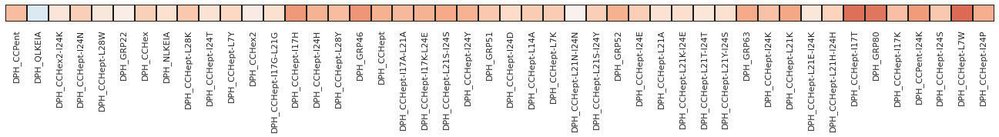


R


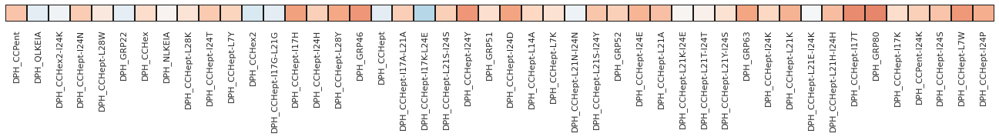


S


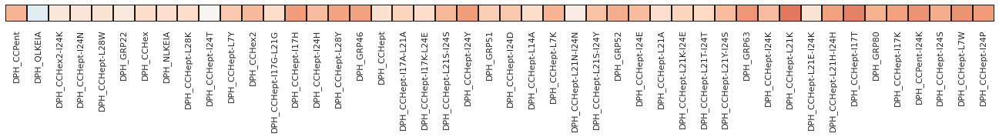


V


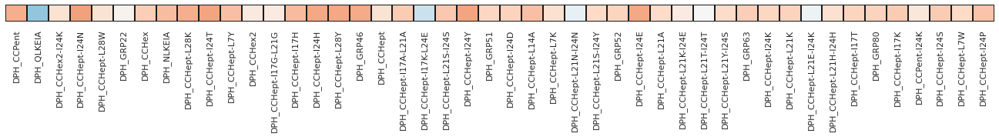


W


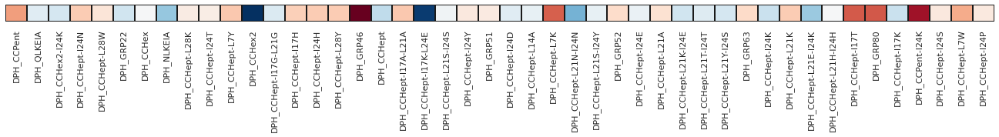




Scaled_data:


E


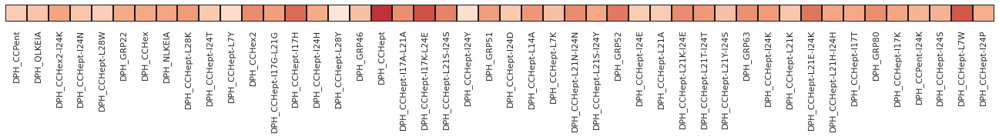


R


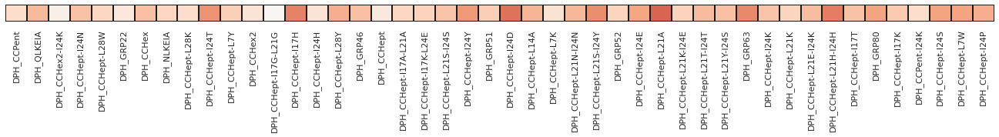


S


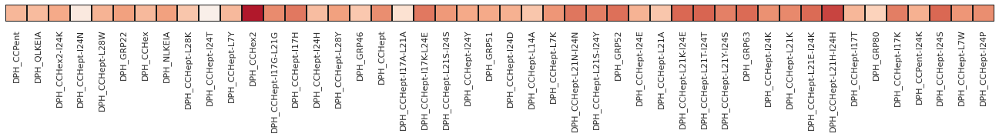


V


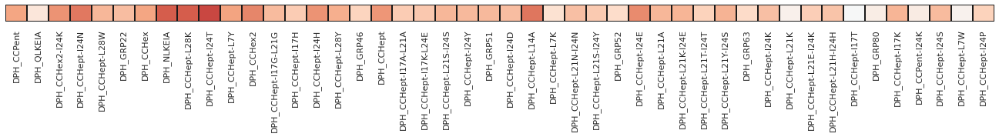


W


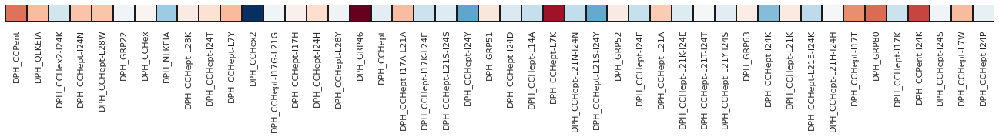




Original_data:



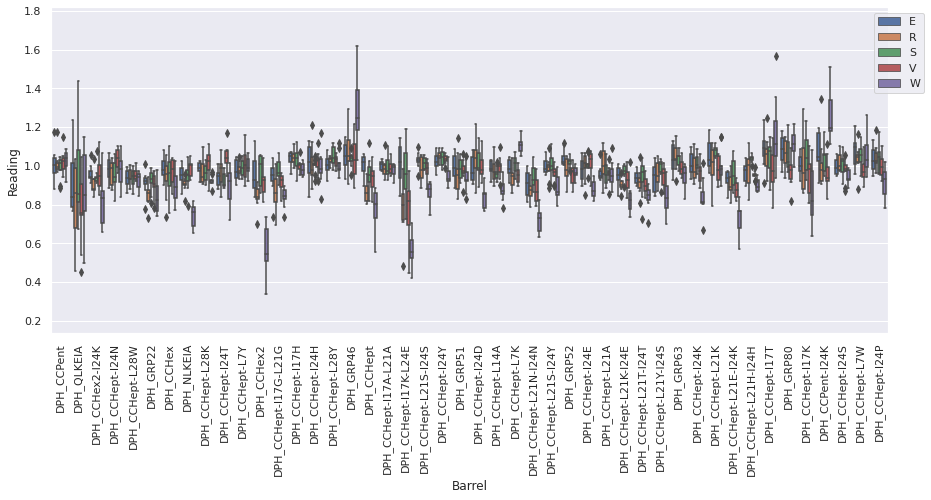

E


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


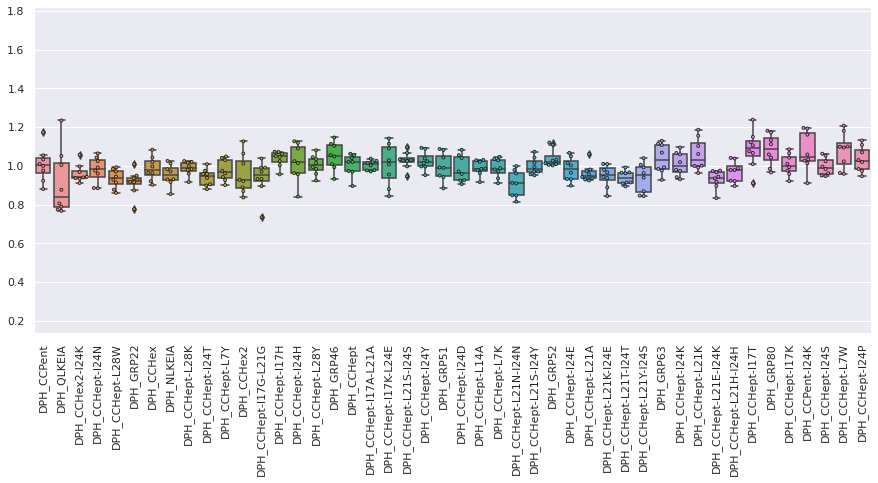

R


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


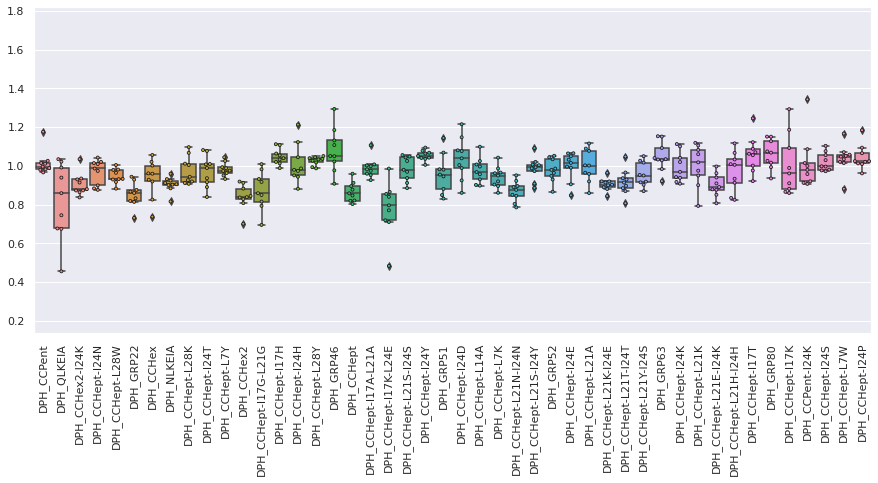

S


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


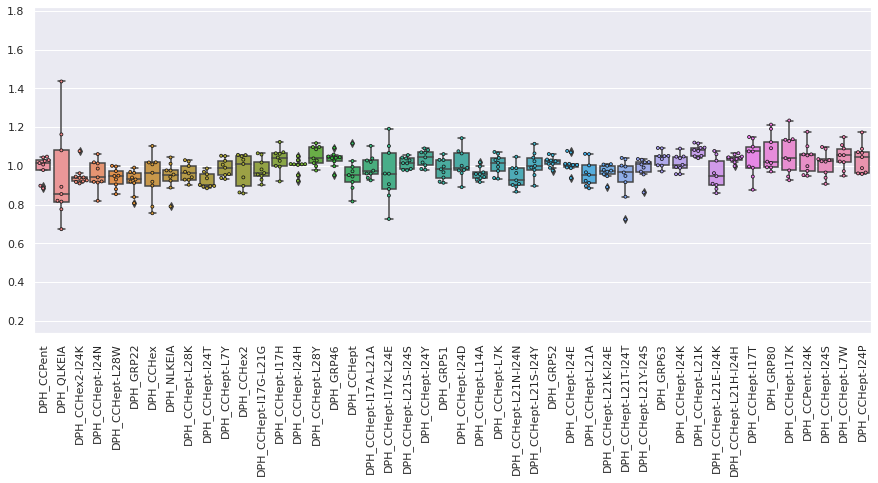

V


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


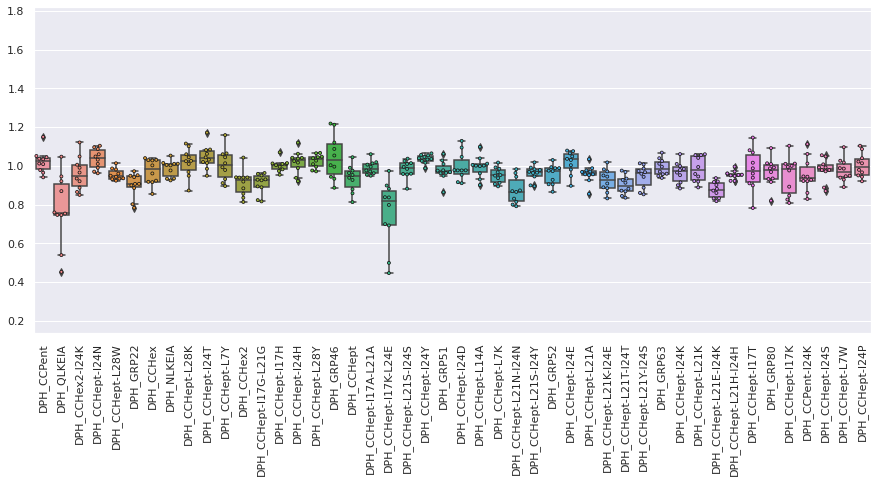

W


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


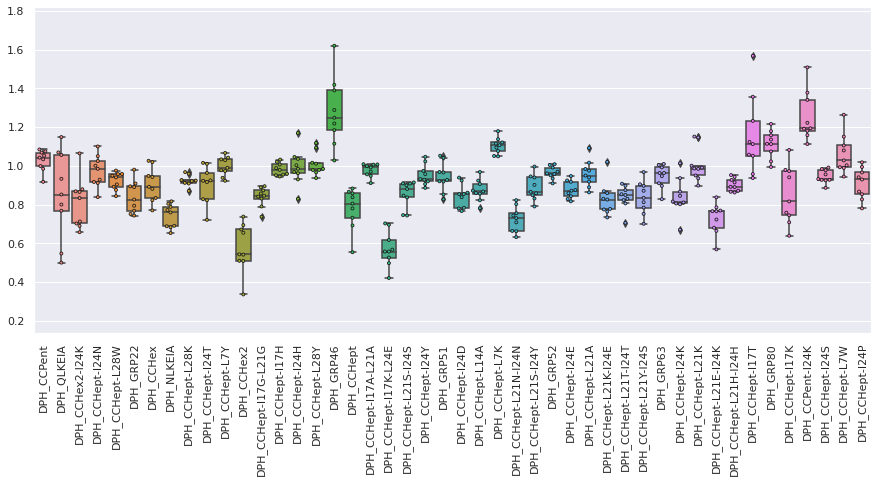




Scaled_data:



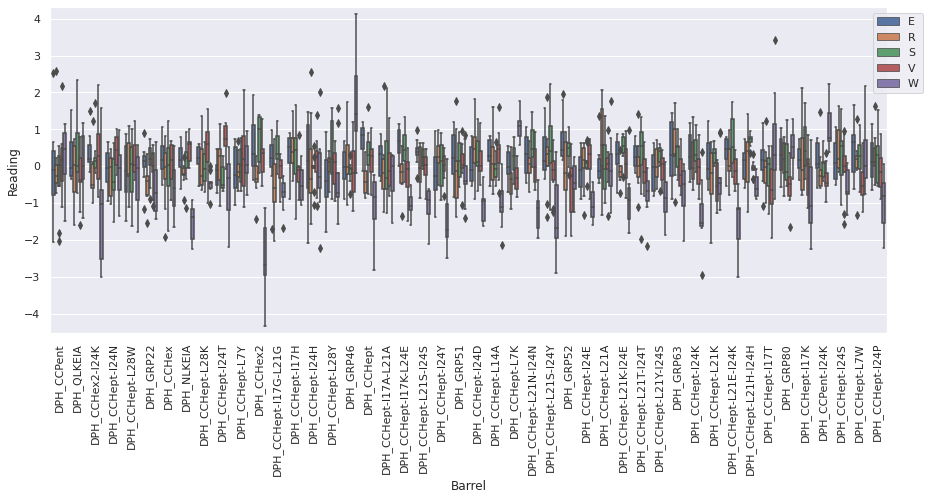

E


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


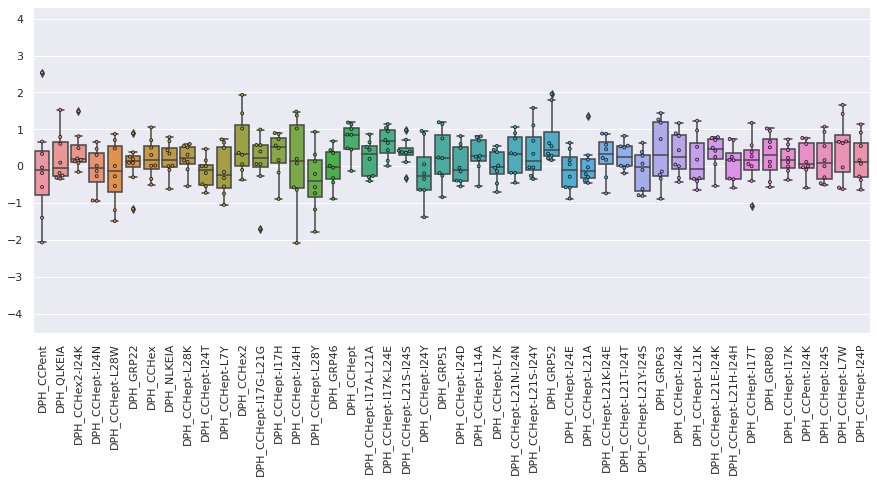

R


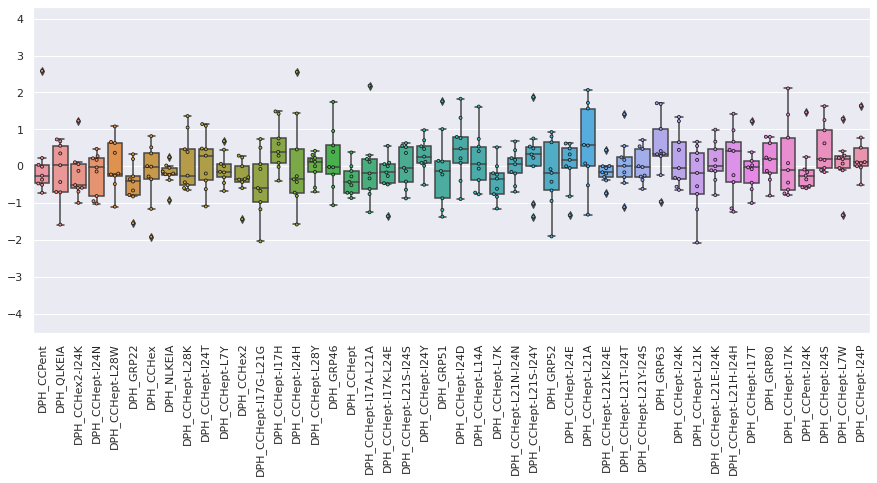

S


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


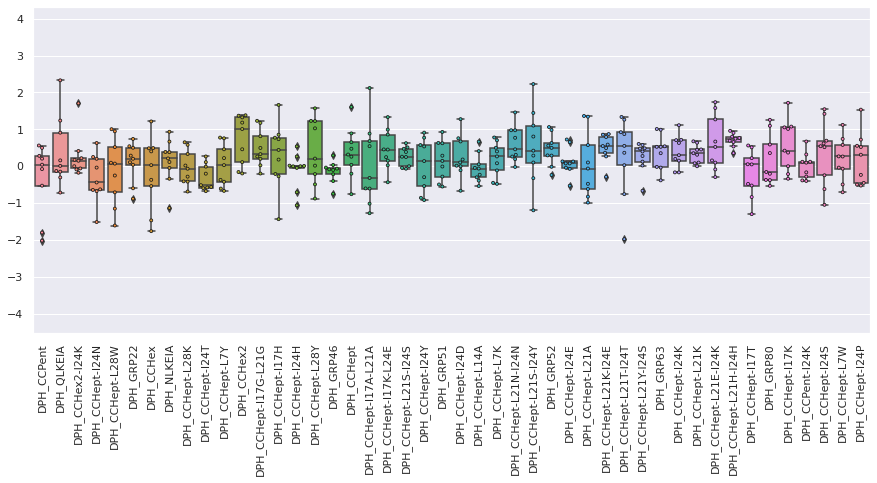

V


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


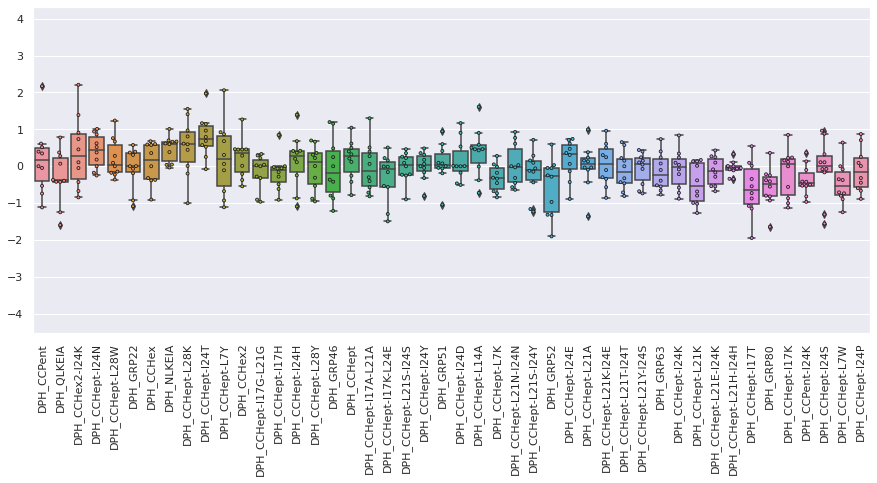

W


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


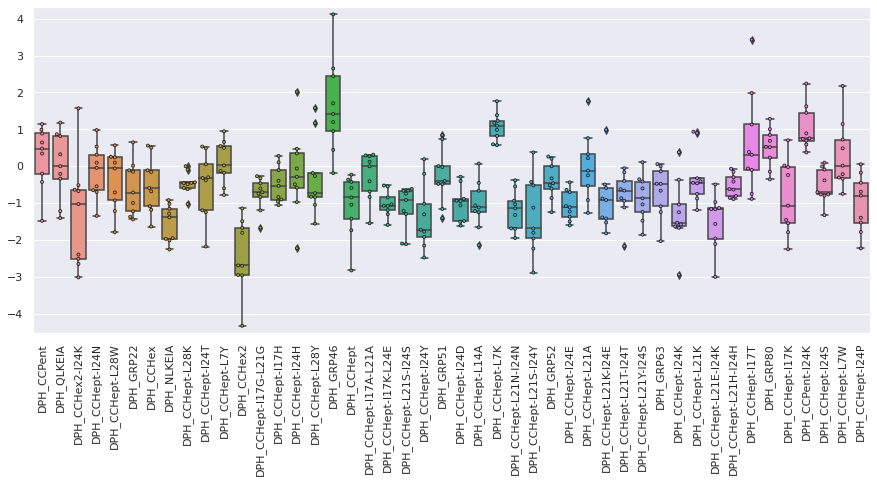

In [19]:
aa_fluor_data.display_data_distribution()

- As suggested by the scatter plots of the raw data above, the fingerprint of W is the most easily distinguishable, whereas the other four amino acids are similar to one another.
- When looking at the unscaled data, the ranges of readings obtained for QLKEIA (identified above as having a minimal effect upon the fluorescence of DPH) are very large for the five analytes. However, when looking at the scaled data, the degree of overlap of the readings for the different classes is not noticeably larger for QLKEIA as compared to the other peptides. In contrast, the readings and extent of class overlap for CCHept-I17K-L24E are similar to the other peptides for both the unscaled and scaled data.




Original_data:


B


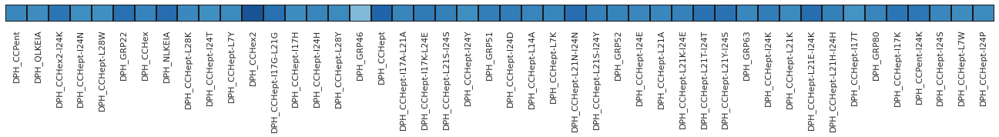


D


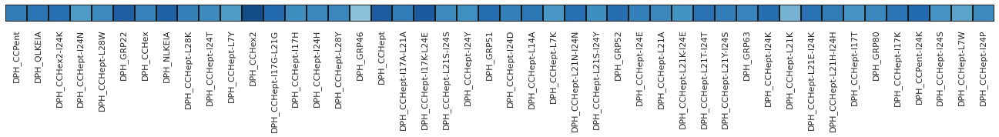


N


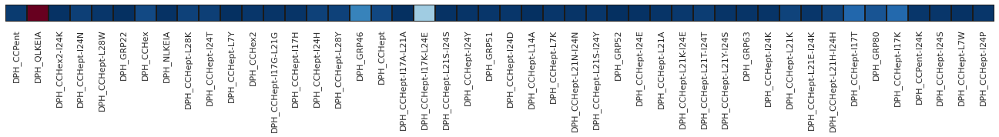


O


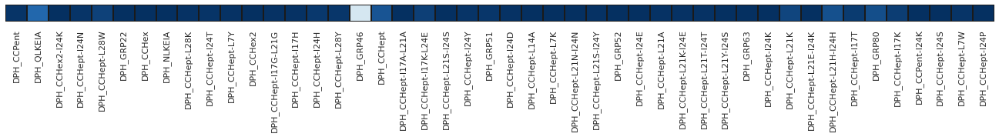


P


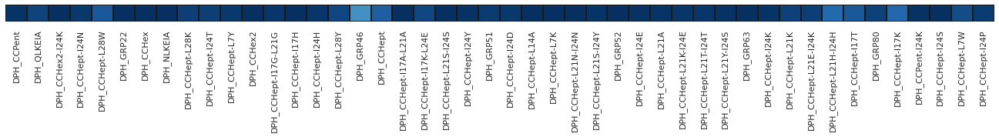




Scaled_data:


B


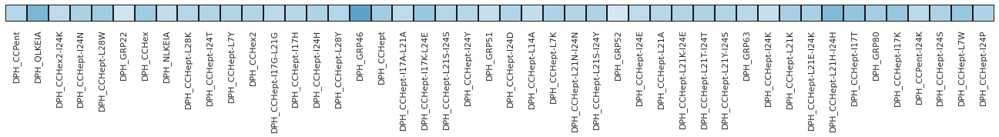


D


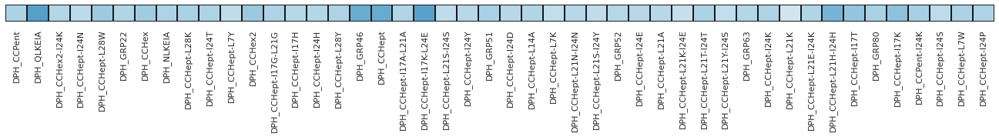


N


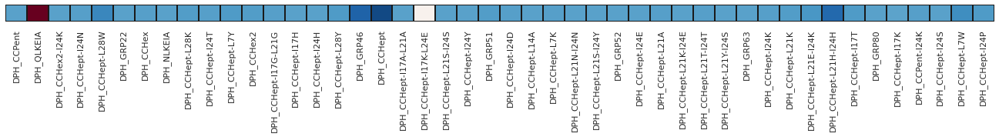


O


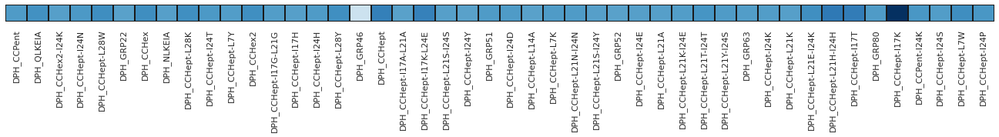


P


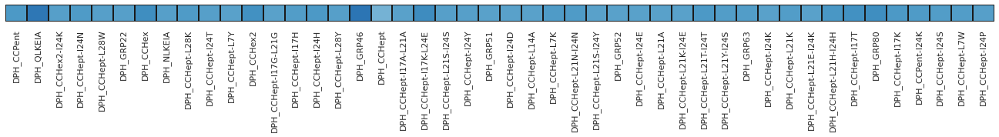




Original_data:



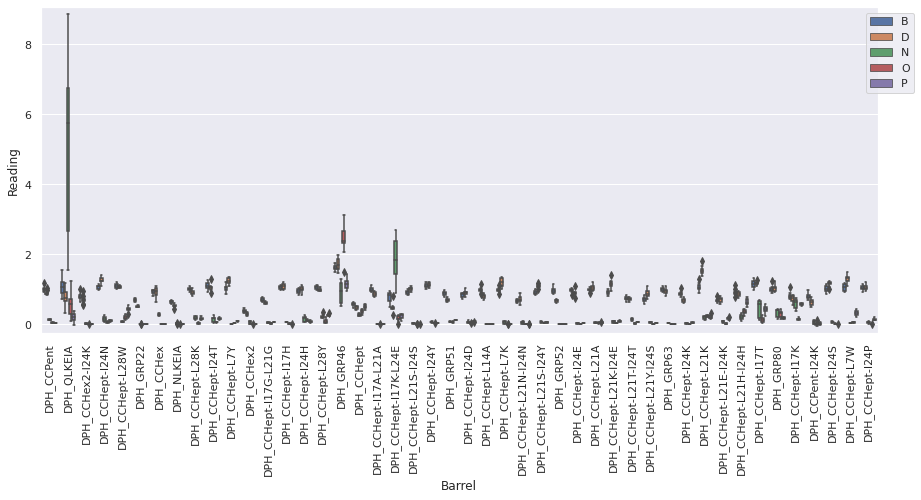

B


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 60.0% of the points cannot be placed; you may want 

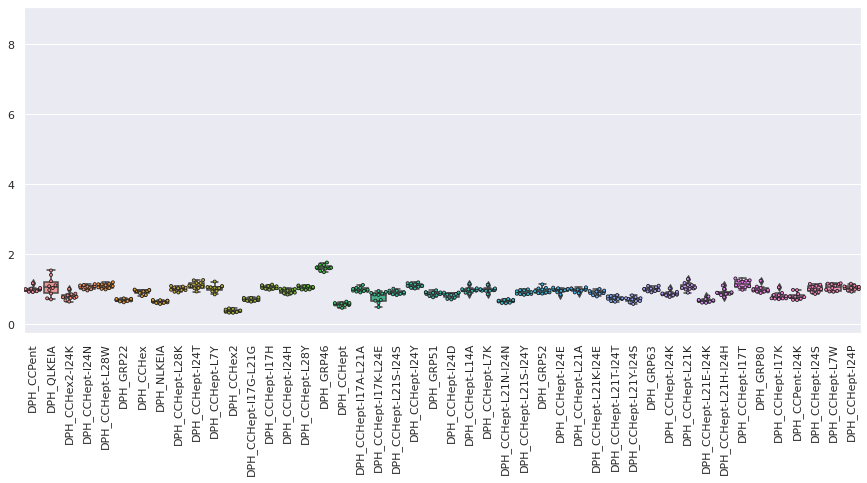

D


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 70.0% of the points cannot be placed; you may want 

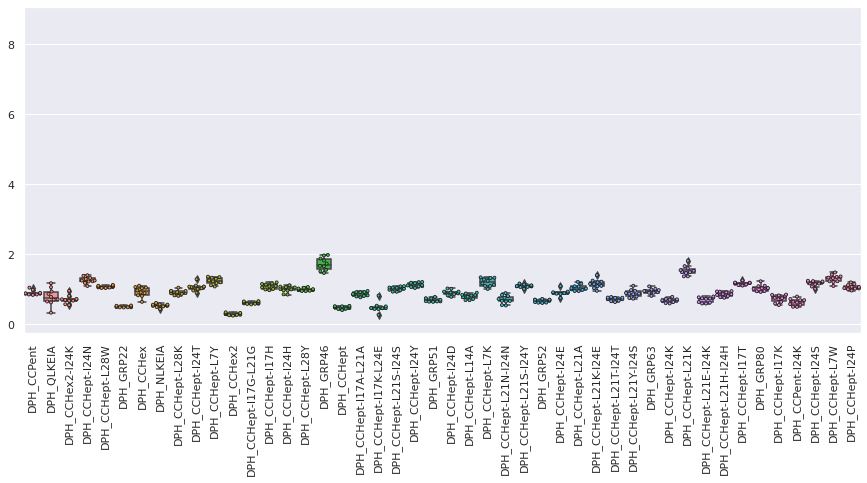

N


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 62.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 37.5% of the points cannot be placed; you may want 

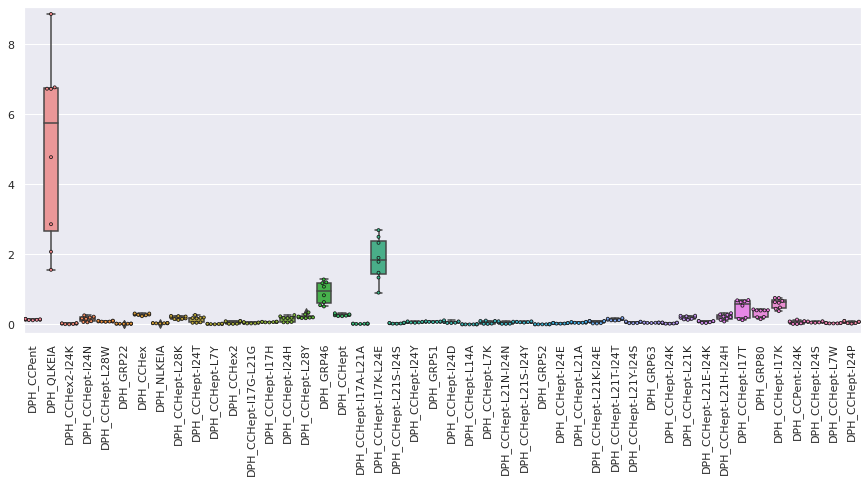

O


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 33.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 44.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want 

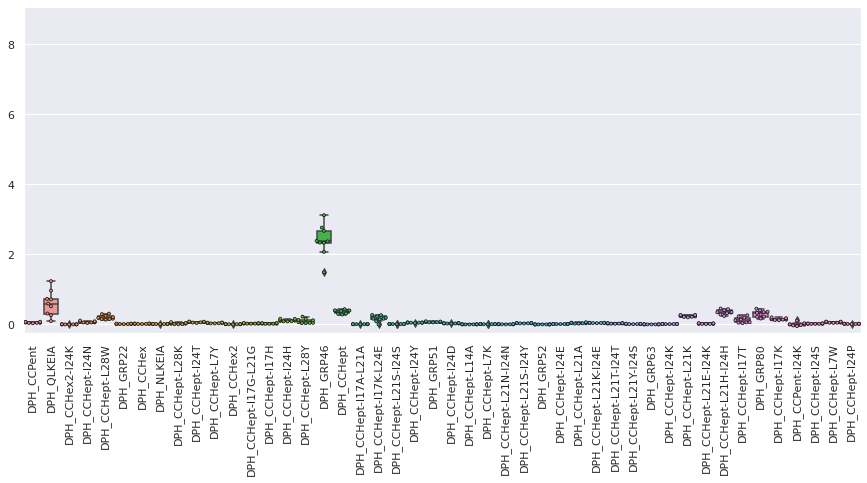

P


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 62.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 37.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want 

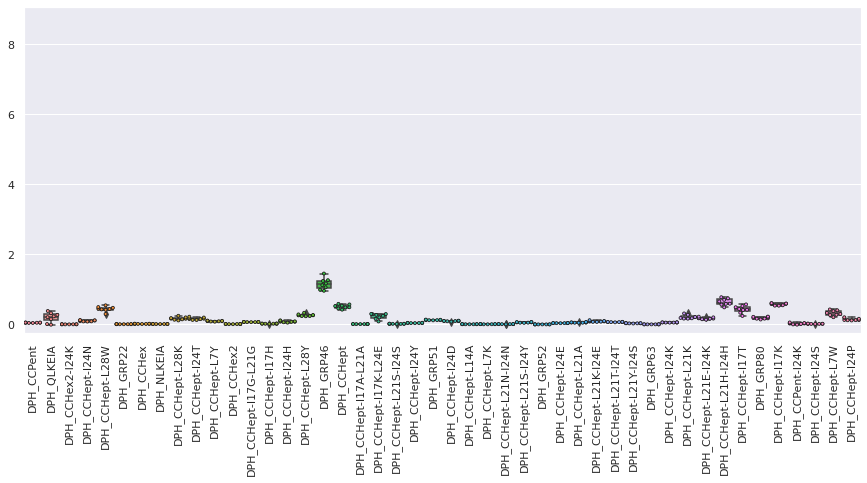




Scaled_data:



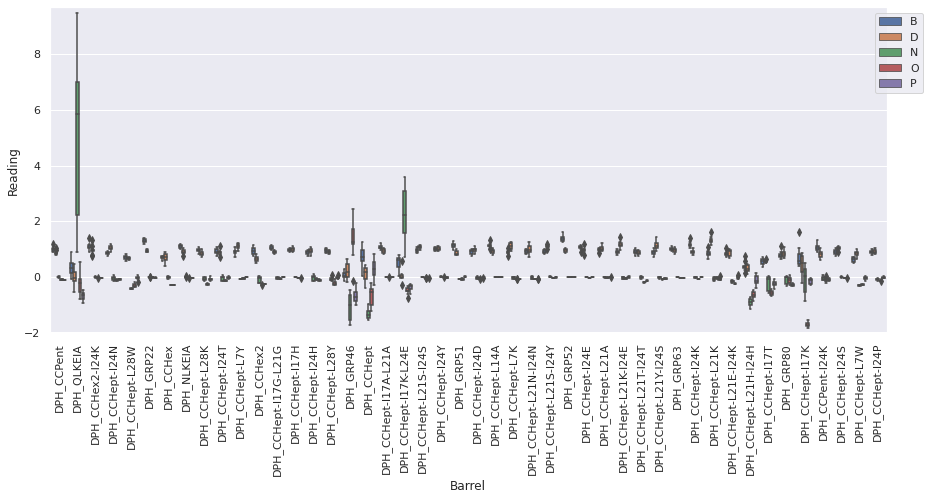

B


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 40.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want 

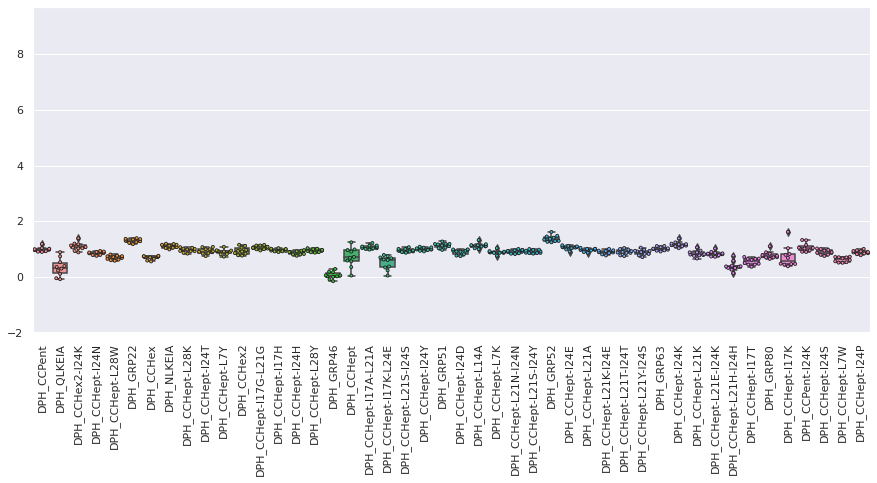

D


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 70.0% of the points cannot be placed; you may want 

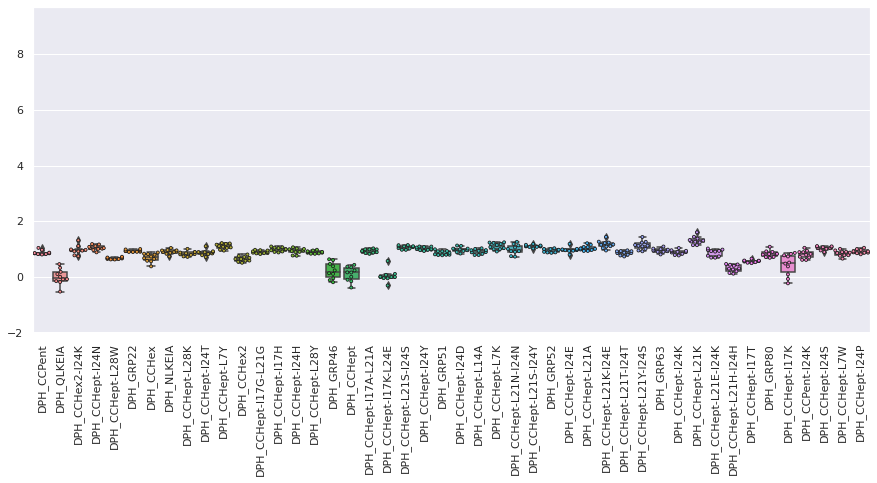

N


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 62.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want 

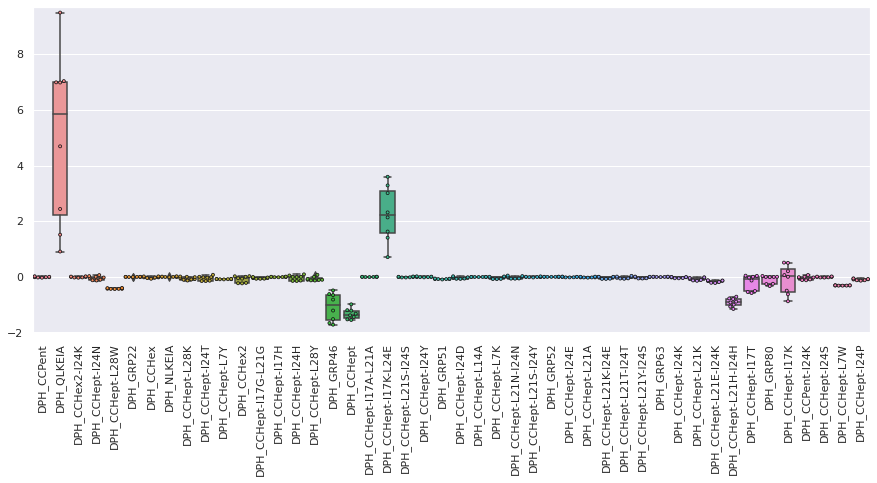

O


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 44.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 33.3% of the points cannot be placed; you may want 

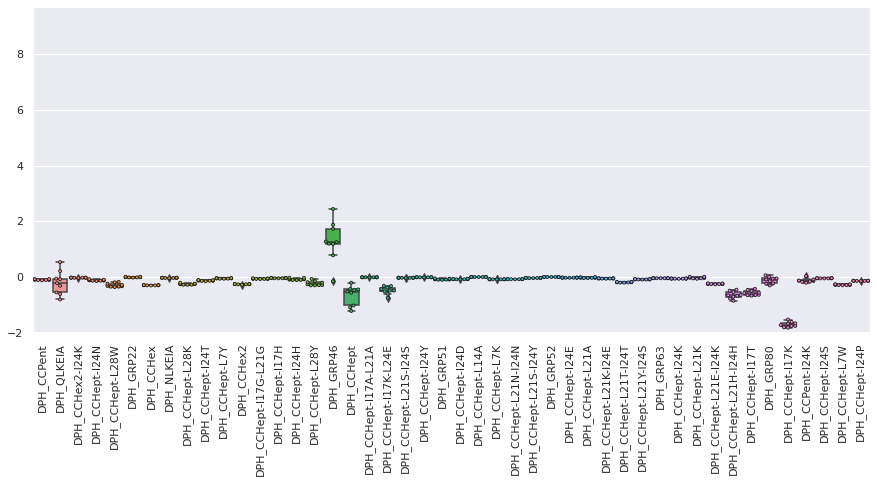

P


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 62.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 25.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 12.5% of the points cannot be placed; you may want 

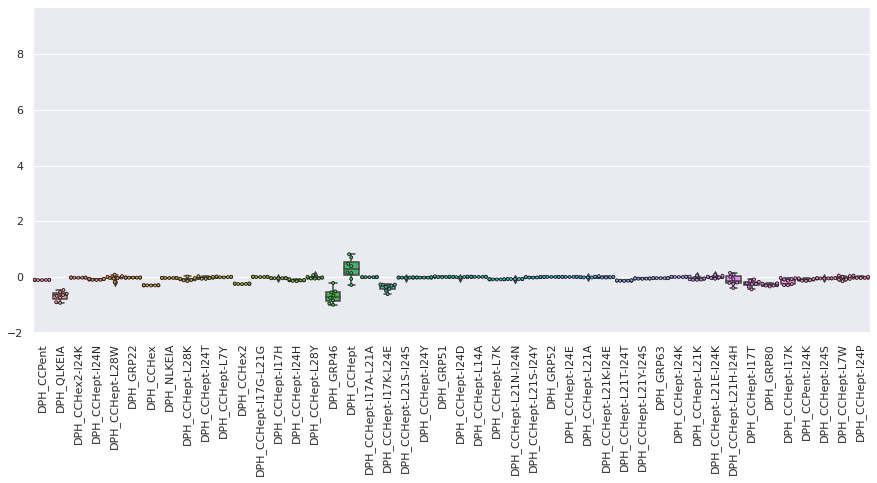

In [20]:
fa_fluor_data.display_data_distribution()

- Although the ranges of readings obtained with CCHept-I17K-L24E, GRP46 and (especially) QLKEIA are very large, there isn't much overlap between the ranges obtained for different analytes => they provide useful signal when distinguishing between these subclasses. 




Original_data:


fru


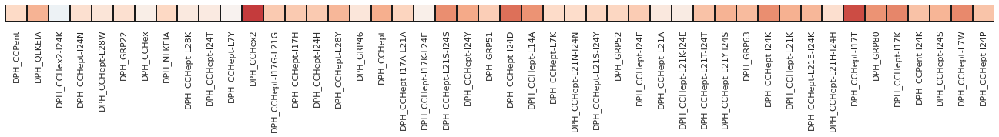


glu


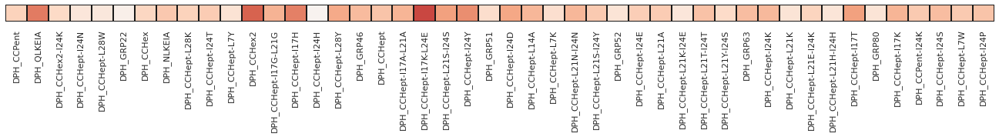


gluam


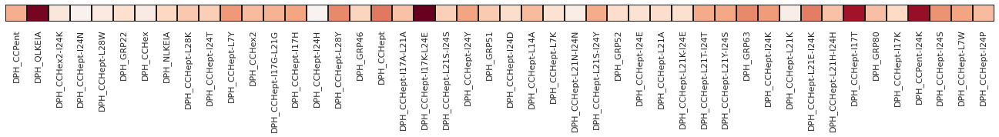


mal


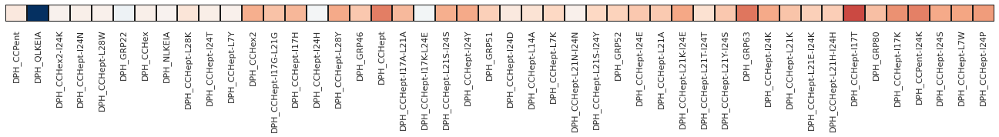


man


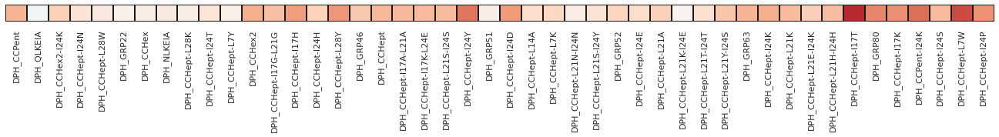




Scaled_data:


fru


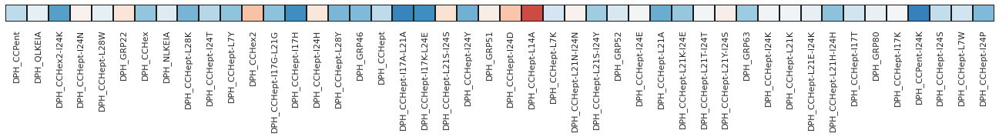


glu


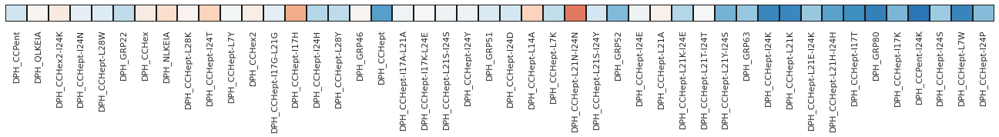


gluam


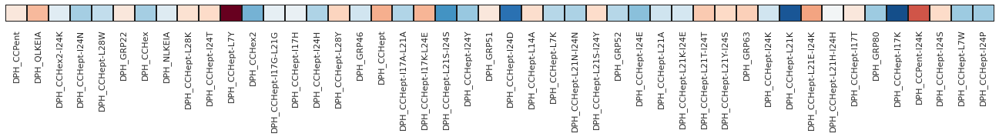


mal


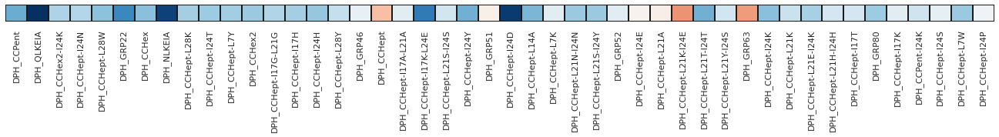


man


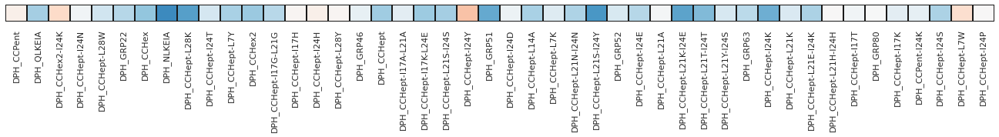




Original_data:



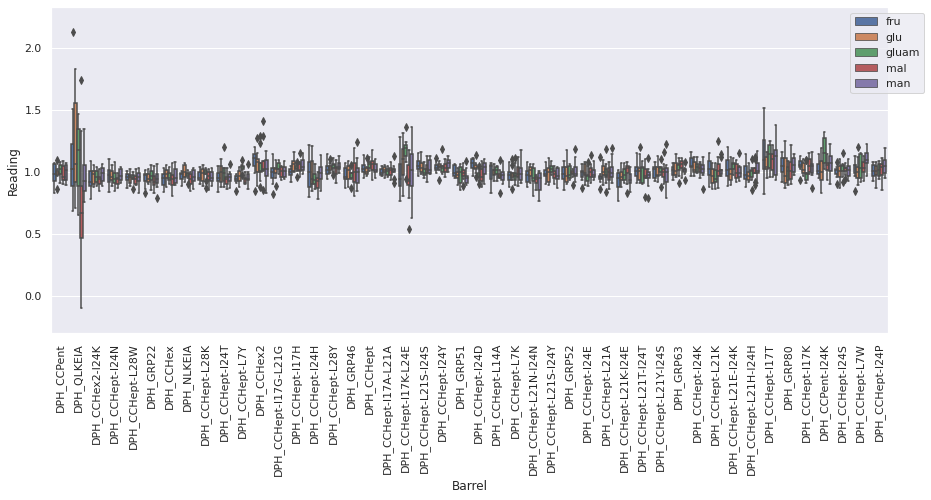

fru


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


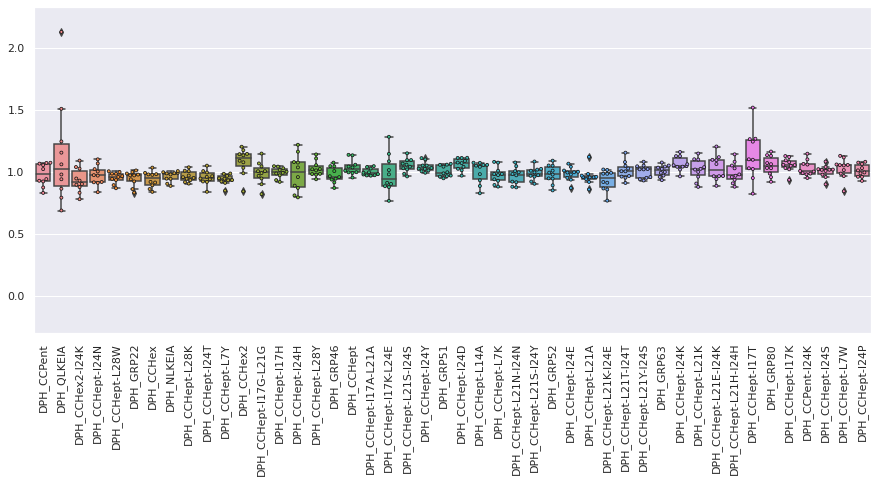

glu


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


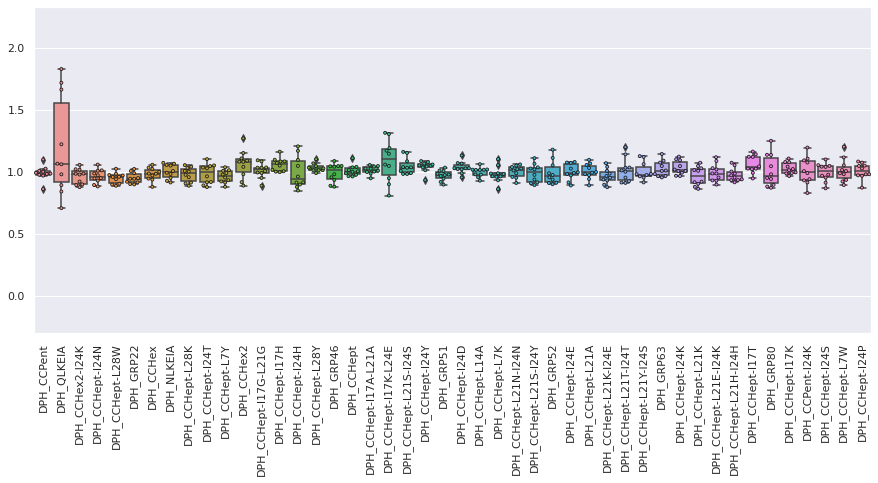

gluam


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


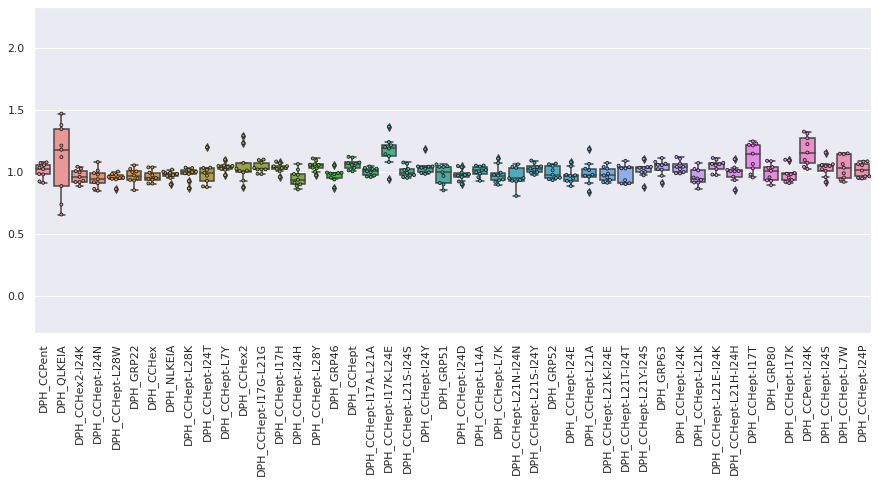

mal


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 11.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


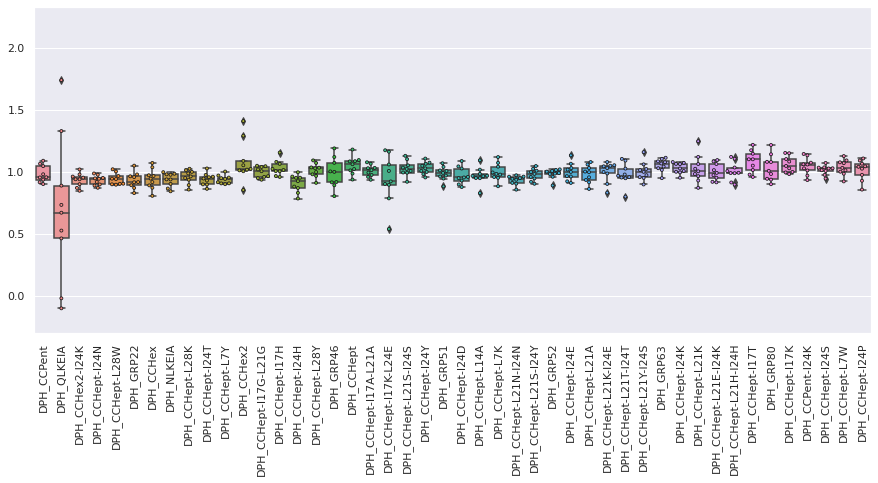

man


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 10.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


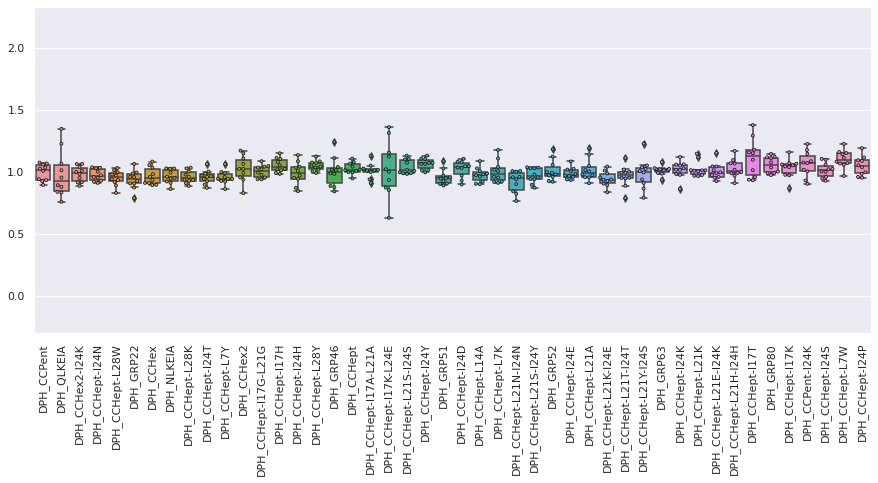




Scaled_data:



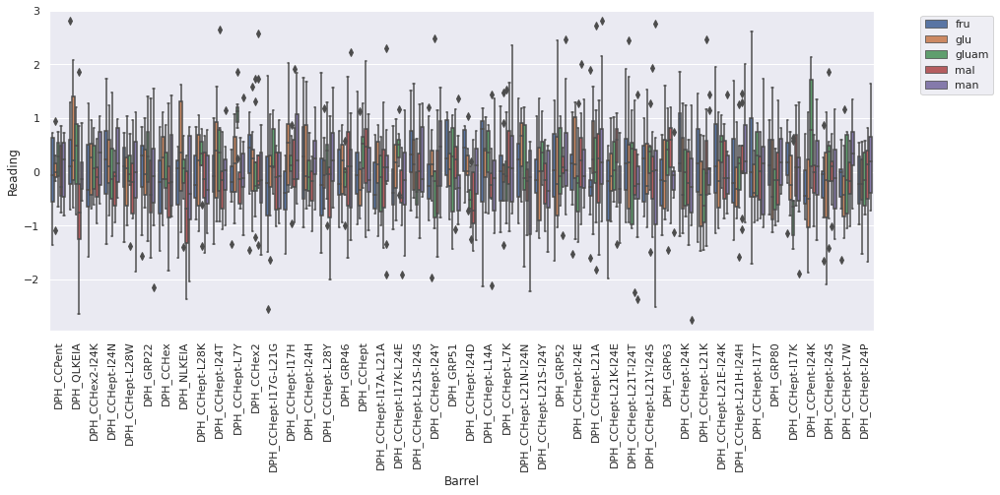

fru


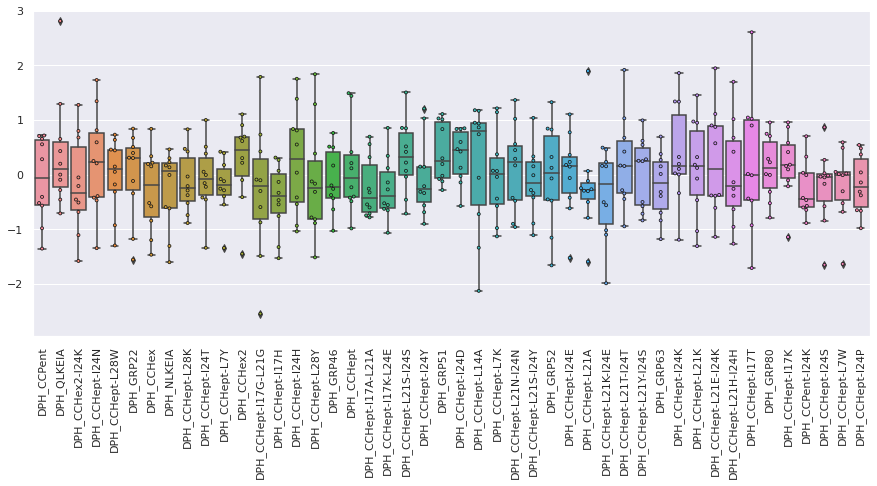

glu


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


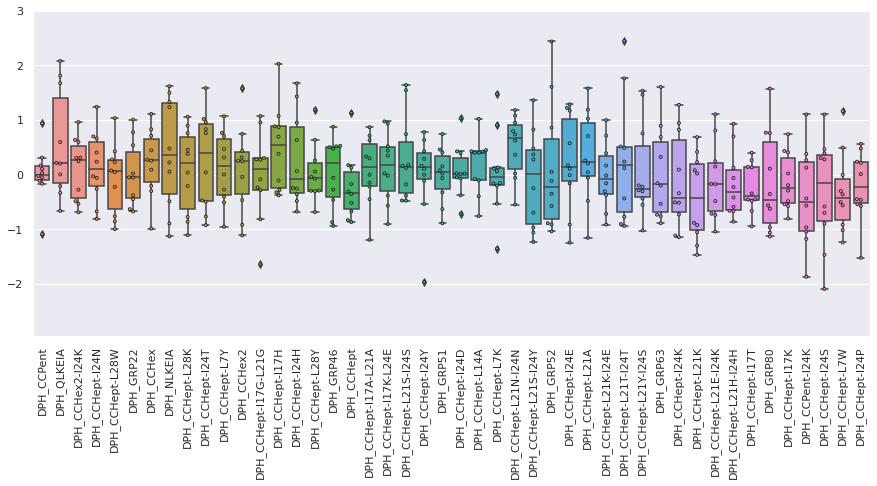

gluam


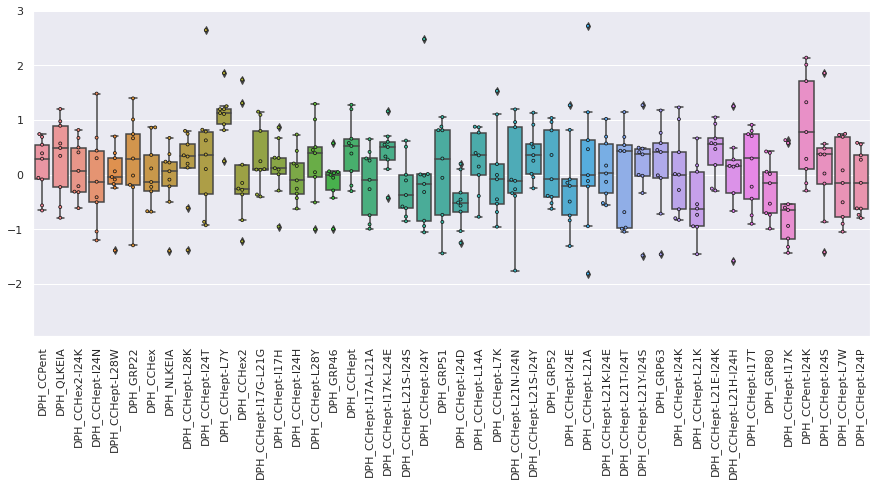

mal


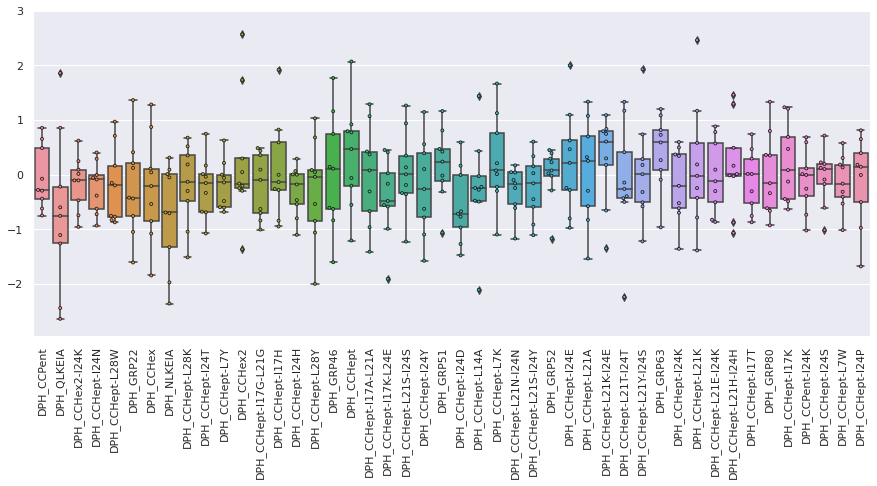

man


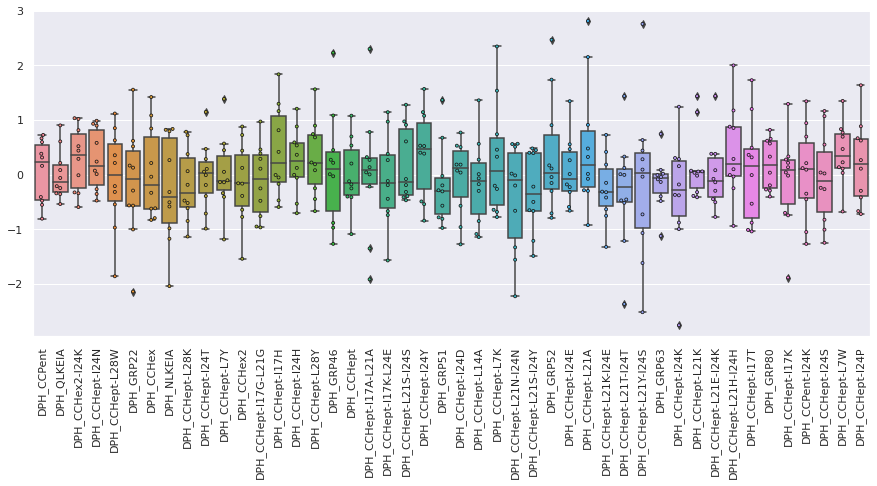

In [21]:
sugar_fluor_data.display_data_distribution()

- There is very little difference between the fingerprints of the different analytes. Peptide QLKEIA in particular has an especially large range for the unscaled data, but the degree of overlap between classes is not noticeably (by eye) larger as compared with the other peptides on the scaled data plot.

In [22]:
aa_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,0.975754,0.805970,0.911260,0.959824,0.992671,0.949460,0.996339,0.929025,1.024605,0.957439,...,0.972638,0.921093,0.910909,0.984478,1.042352,0.910192,0.961709,0.963116,0.946389,E
1,1.173333,0.876437,0.968451,1.042891,0.970839,1.008017,1.019729,0.970988,1.016143,0.957612,...,0.917594,0.895863,1.122525,1.058936,1.010333,1.013535,0.949764,0.958733,0.973714,E
2,1.054200,0.789017,1.057116,1.064320,0.983391,0.936198,1.083456,1.025333,0.997308,0.974687,...,0.833333,0.923131,1.008582,0.965823,0.921273,1.033352,0.947079,1.022945,0.983653,E
3,1.032963,1.004405,0.997020,1.024302,0.944165,0.916627,1.042882,0.916823,0.982637,1.008268,...,0.896363,0.978689,1.105980,1.131978,0.957890,1.058071,0.995787,1.098436,1.029730,E
4,0.999950,0.774510,0.932947,0.991259,0.913675,0.775800,0.902547,1.012388,0.978639,0.904505,...,0.975191,1.037625,1.149506,1.181197,0.992958,1.160988,1.023756,1.099746,1.130901,E
5,0.922894,1.234375,0.943548,0.975264,0.928380,0.928596,0.920456,0.982110,1.019693,0.937569,...,0.935408,0.977644,1.238383,1.172258,1.065114,1.195792,0.983709,1.207681,1.069779,E
6,0.880173,1.051095,0.936436,0.885496,0.876904,0.872823,0.962317,0.853927,0.916010,0.898641,...,0.943916,0.987938,1.075606,1.042473,0.975499,1.192737,1.052147,1.180891,1.019655,E
7,1.009470,0.767606,0.940277,0.884394,0.860375,0.917590,0.963124,0.930681,0.959728,0.879332,...,0.966801,1.040873,1.066630,1.111805,1.085274,1.027042,1.062601,1.094662,1.107924,E
8,1.025855,1.021429,1.034466,1.009236,1.004214,0.943589,1.020425,0.959219,1.004224,1.007548,...,0.806447,0.933195,1.070046,1.016349,0.988957,0.920160,0.997541,1.020918,0.960921,R
9,1.014104,0.858757,0.929889,1.042682,0.978965,0.866702,0.959320,0.923752,1.011156,1.076569,...,0.878458,0.824546,0.975738,0.934832,0.909808,0.979306,0.980335,1.034094,1.023615,R


In [23]:
fa_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,1.023815,1.118110,0.754224,1.091023,1.000000,0.631851,0.838841,0.612530,0.913015,1.110212,...,0.799253,1.113330,1.313932,1.002100,0.898441,0.800250,1.135116,1.153071,1.109400,B
1,1.176017,1.040000,0.651792,1.006400,1.147716,0.656773,0.899203,0.692953,1.081371,1.259465,...,0.667876,0.773788,1.250326,0.967690,0.721541,0.780227,0.871173,1.038386,1.034988,B
2,1.005394,1.541985,0.758220,1.128030,1.095430,0.668936,0.995861,0.699115,1.055767,1.267305,...,0.651446,0.905731,1.260460,0.939336,0.746685,0.794058,0.926527,1.164184,1.044868,B
3,0.933102,1.416000,0.688626,0.969718,1.058668,0.698003,0.950435,0.618271,0.933694,1.032468,...,0.691039,0.903220,1.216427,1.079714,0.743049,0.986778,1.103498,1.107882,1.162466,B
4,0.923828,1.234483,0.776929,1.083207,1.037086,0.685776,0.950957,0.677345,0.979182,1.092526,...,0.724585,0.874715,1.252276,1.248290,0.737926,0.979461,1.011143,1.173271,1.087395,B
5,0.947699,1.090909,0.877685,1.001786,1.016905,0.698449,0.809425,0.660837,0.981239,0.940045,...,0.685703,1.012174,1.116020,0.941129,1.059001,0.734706,1.075857,1.147624,1.071844,B
6,1.042685,0.715278,0.829850,1.093504,1.162554,0.719836,0.942800,0.583652,0.990682,1.182490,...,0.701222,0.917795,1.063377,0.898983,0.803817,0.696085,0.919617,0.934237,0.935491,B
7,1.003189,0.882883,0.860887,1.151163,1.203092,0.726150,0.976632,0.630901,1.047360,1.077837,...,0.623422,0.873781,1.062473,0.944521,0.841939,0.702405,0.999619,0.957570,1.000053,B
8,1.010617,0.744444,0.790121,1.113111,1.144841,0.731933,0.980152,0.660311,1.031715,1.185479,...,0.672418,0.839465,1.090547,0.984060,0.833684,0.779988,0.995406,0.940545,1.005856,B
9,0.979174,0.981481,1.014783,1.062214,1.116195,0.744128,0.983977,0.677394,1.099882,1.041593,...,0.616931,0.897338,0.990380,1.041864,0.744580,0.867446,1.156847,0.992969,0.971107,B


In [24]:
sugar_fluor_data.ml_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21E-I24K,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte
0,1.067249,1.061404,0.930518,0.974706,0.986582,0.941292,0.982774,0.945126,1.010415,0.920501,...,1.095147,1.029638,1.244386,1.135611,1.057832,1.147379,1.083942,1.056854,0.996107,fru
1,1.023382,0.690217,1.092062,0.971062,0.966632,0.834383,0.977192,0.988439,0.952275,1.007237,...,0.888868,0.908712,0.825995,1.062858,1.049984,1.008481,0.959748,1.053025,0.928841,fru
2,0.929441,0.865031,0.903539,1.068681,0.935655,0.987581,0.915296,0.980295,0.971700,0.966054,...,1.119402,1.142357,0.951529,1.129966,1.120896,1.059988,1.018290,1.060613,1.031531,fru
3,0.875429,1.508475,0.832761,0.917173,0.869452,0.972457,0.840453,0.905449,0.906673,0.947368,...,0.965952,1.052145,1.267616,1.032518,0.937197,0.990571,1.022743,1.129959,1.013060,fru
4,1.072976,1.155779,0.781212,1.004087,0.960213,0.979373,1.035184,0.990321,1.037728,0.960859,...,0.967611,0.969925,1.102072,0.921684,1.055556,0.981503,1.019704,0.967253,0.989376,fru
5,0.831905,2.127451,0.878794,0.919547,0.894355,0.972952,0.992821,0.993940,0.934672,0.923737,...,1.064398,1.082189,1.518006,1.071640,1.128230,1.065174,1.040557,1.015320,1.064631,fru
6,0.924035,0.941748,0.947549,0.837797,0.944620,0.924430,0.862978,0.888350,0.945624,0.841140,...,1.097872,0.881572,1.098394,0.987486,1.094323,1.003704,1.008683,1.117092,1.075748,fru
7,0.942728,1.246032,0.897593,0.912835,0.999524,0.862581,0.893130,0.946443,0.958286,0.941402,...,1.205056,0.937015,1.264180,1.164580,1.031708,1.101504,1.017302,0.987347,1.082026,fru
8,1.074247,0.793548,1.040113,1.101920,0.987546,0.999889,0.920378,1.007278,0.917730,0.995928,...,0.966478,0.958800,1.029903,0.958367,1.078798,0.986959,0.900943,1.055456,0.960998,fru
9,1.055340,0.980000,1.027093,1.023074,1.005902,1.012482,0.980785,0.997954,1.006680,1.051143,...,0.943299,0.980566,1.024188,1.030550,1.021768,0.951786,0.978841,0.845216,0.961973,fru


Changes analyte name to "FA", "AA" or "S" as appropriate, then concatentates the dataframes into a single dataset. (Thus far the data points have only been scaled relative to their parent plate, so the values are identical to those that would be obtained if the input excel files had all been processed together.)

In [25]:
aa_fluor_data.ml_fluor_data['Sub_analyte'] = [
    'AA_{}'.format(aa_subclass) for aa_subclass in aa_fluor_data.ml_fluor_data['Analyte'].tolist()
]
aa_fluor_data.ml_fluor_data['Analyte'] = ['AA']*aa_fluor_data.ml_fluor_data.shape[0]

In [26]:
fa_fluor_data.ml_fluor_data['Sub_analyte'] = [
    'FA_{}'.format(fa_subclass) for fa_subclass in fa_fluor_data.ml_fluor_data['Analyte'].tolist()
]
fa_fluor_data.ml_fluor_data['Analyte'] = ['FA']*fa_fluor_data.ml_fluor_data.shape[0]

In [27]:
sugar_fluor_data.ml_fluor_data['Sub_analyte'] = [
    'S_{}'.format(sugar_subclass) for sugar_subclass in sugar_fluor_data.ml_fluor_data['Analyte'].tolist()
]
sugar_fluor_data.ml_fluor_data['Analyte'] = ['S']*sugar_fluor_data.ml_fluor_data.shape[0]

In [28]:
small_mol_fluor_data = pd.concat(
    [fa_fluor_data.ml_fluor_data, aa_fluor_data.ml_fluor_data, sugar_fluor_data.ml_fluor_data],
    axis=0, ignore_index=True
)

In [29]:
small_mol_fluor_data

,DPH_CCPent,DPH_QLKEIA,DPH_CCHex2-I24K,DPH_CCHept-I24N,DPH_CCHept-L28W,DPH_GRP22,DPH_CCHex,DPH_NLKEIA,DPH_CCHept-L28K,DPH_CCHept-I24T,...,DPH_CCHept-L21H-I24H,DPH_CCHept-I17T,DPH_GRP80,DPH_CCHept-I17K,DPH_CCPent-I24K,DPH_CCHept-I24S,DPH_CCHept-L7W,DPH_CCHept-I24P,Analyte,Sub_analyte
0,1.023815,1.118110,0.754224,1.091023,1.000000,0.631851,0.838841,0.612530,0.913015,1.110212,...,1.113330,1.313932,1.002100,0.898441,0.800250,1.135116,1.153071,1.109400,FA,FA_B
1,1.176017,1.040000,0.651792,1.006400,1.147716,0.656773,0.899203,0.692953,1.081371,1.259465,...,0.773788,1.250326,0.967690,0.721541,0.780227,0.871173,1.038386,1.034988,FA,FA_B
2,1.005394,1.541985,0.758220,1.128030,1.095430,0.668936,0.995861,0.699115,1.055767,1.267305,...,0.905731,1.260460,0.939336,0.746685,0.794058,0.926527,1.164184,1.044868,FA,FA_B
3,0.933102,1.416000,0.688626,0.969718,1.058668,0.698003,0.950435,0.618271,0.933694,1.032468,...,0.903220,1.216427,1.079714,0.743049,0.986778,1.103498,1.107882,1.162466,FA,FA_B
4,0.923828,1.234483,0.776929,1.083207,1.037086,0.685776,0.950957,0.677345,0.979182,1.092526,...,0.874715,1.252276,1.248290,0.737926,0.979461,1.011143,1.173271,1.087395,FA,FA_B
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
133,1.027172,0.879781,1.009790,0.973793,0.971086,0.995867,0.961108,0.995973,1.034317,0.970834,...,0.910241,0.933486,0.993410,0.977514,0.904894,1.003360,0.967915,0.955022,S,S_man
134,0.942395,0.893617,0.888558,0.930496,0.980557,0.907789,0.894287,0.863128,0.927413,0.872692,...,1.001541,1.098819,1.077319,1.060963,1.075593,1.022536,1.068256,1.090200,S,S_man
135,1.068127,1.347518,1.063994,1.003194,0.998933,0.988275,1.055860,1.028838,1.003062,1.003549,...,0.992208,0.959034,1.003870,1.159028,1.005398,0.947668,1.083153,0.985524,S,S_man
136,1.075548,1.227723,1.065561,0.922900,1.031941,0.875391,0.911726,0.962331,0.934727,0.944332,...,1.067966,1.377315,0.990694,1.053452,1.177040,1.023721,1.152702,1.116431,S,S_man





Original_data:


AA


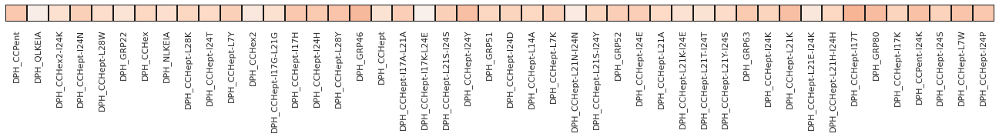


FA


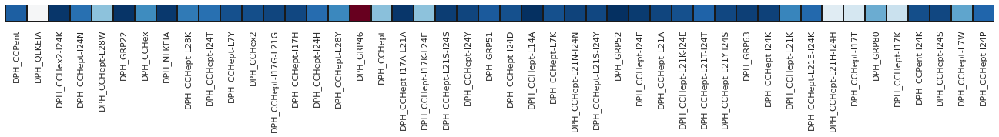


S


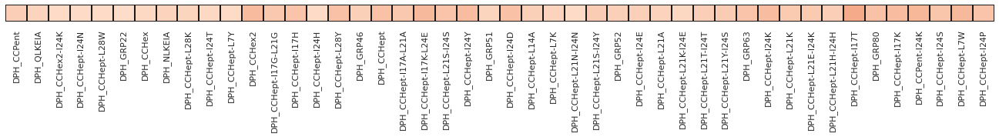




Scaled_data:


AA


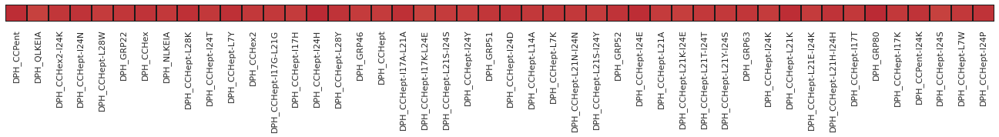


FA


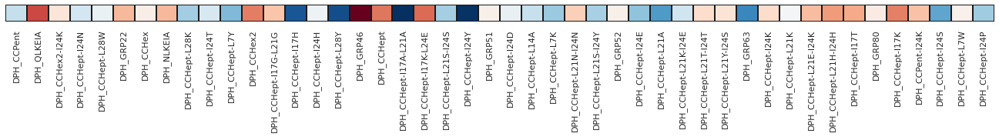


S


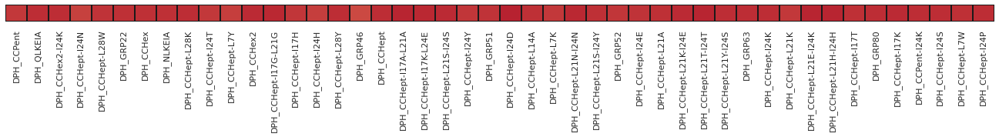




Original_data:



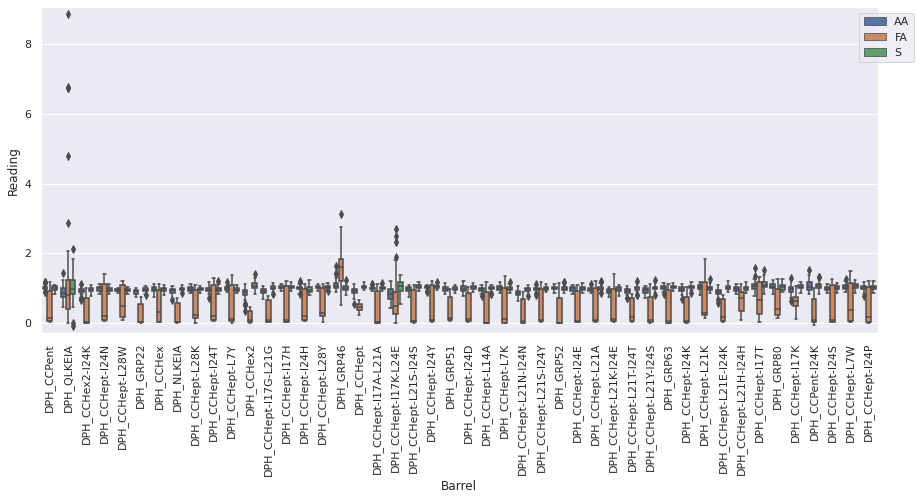

AA


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 75.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 51.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 68.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 77.8% of the points cannot be placed; you may want 

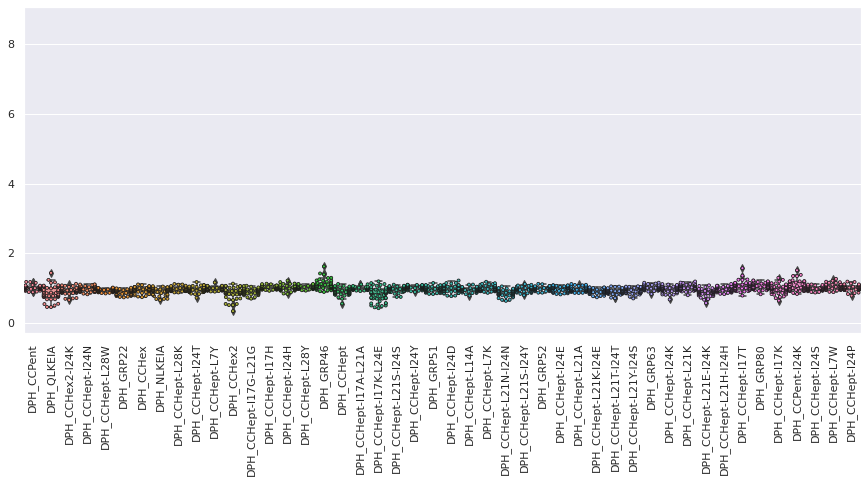

FA


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 13.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 53.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 55.6% of the points cannot be placed; you may want 

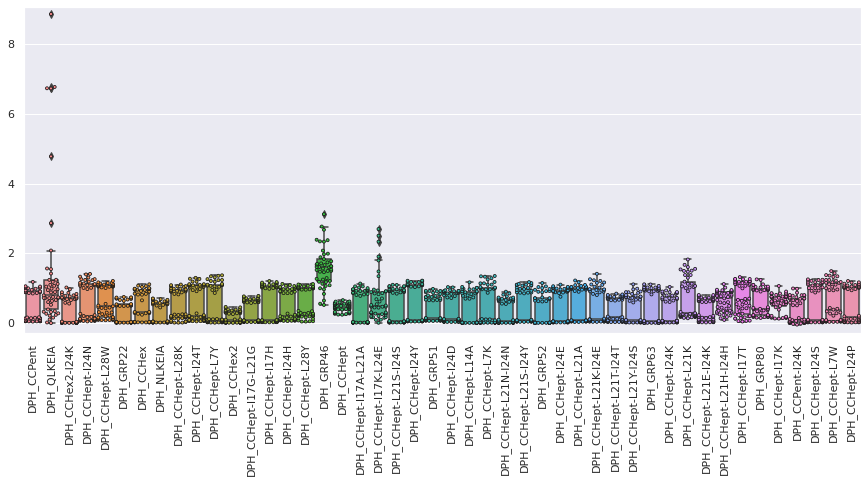

S


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 81.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 31.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 75.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 79.2% of the points cannot be placed; you may want 

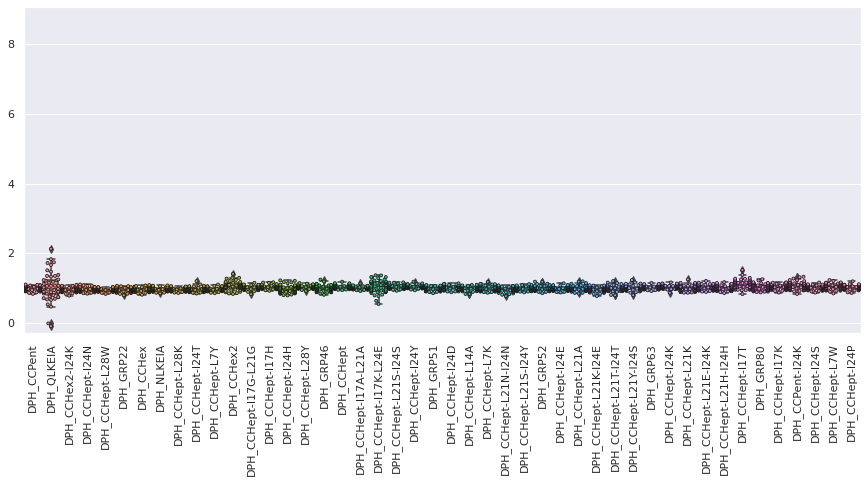




Scaled_data:



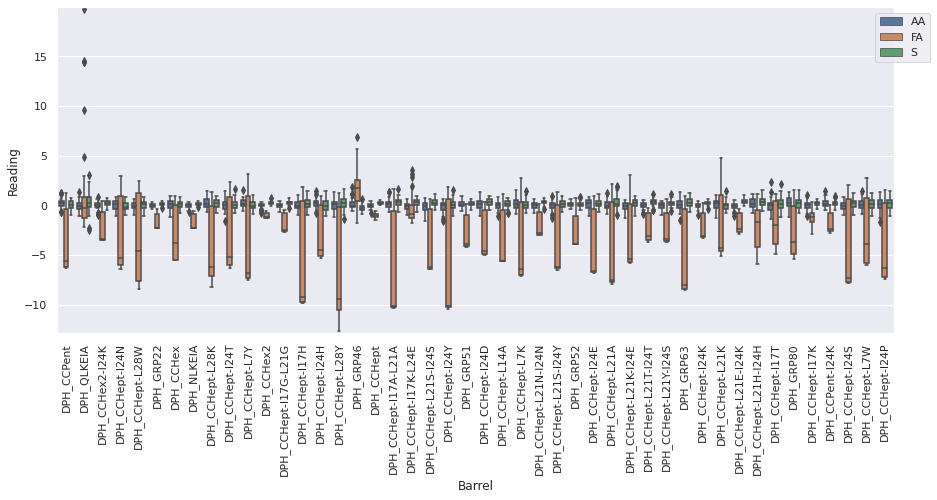

AA


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 64.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 68.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 60.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 82.2% of the points cannot be placed; you may want 

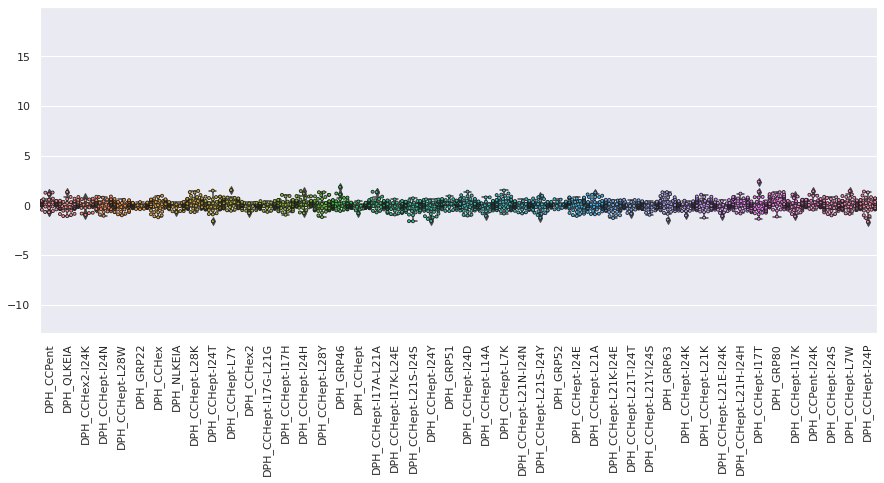

FA


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 57.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 24.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 66.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 37.8% of the points cannot be placed; you may want 

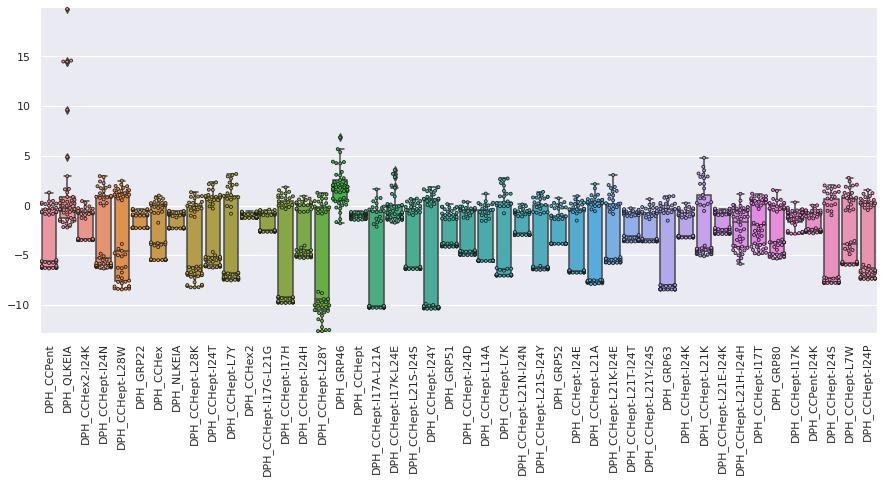

S


/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 62.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 43.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 75.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/ks17361/.local/share/virtualenvs/ML_environment-eYyPySDz/lib/python3.7/site-packages/seaborn/categorical.py:1296: UserWarning: 64.6% of the points cannot be placed; you may want 

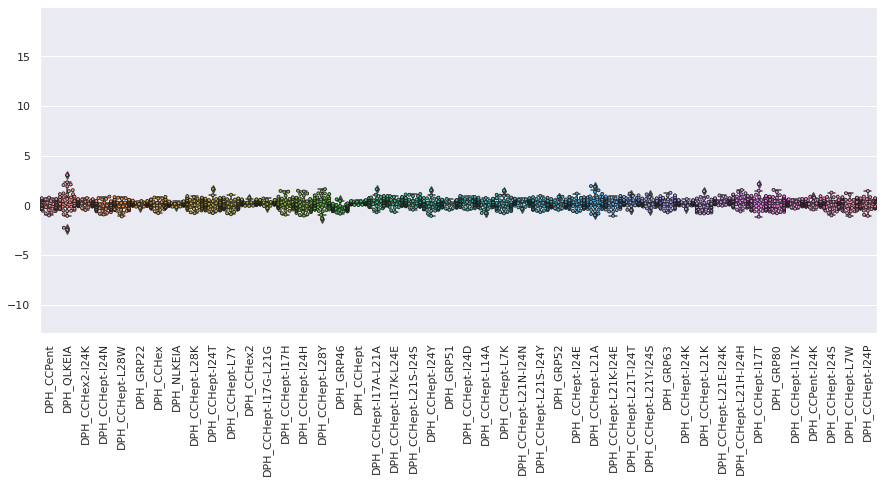

In [30]:
plot_dir = ('/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
            'All_small_molecules/')
if not os.path.isdir(plot_dir):
    raise FileNotFoundError('Directory {} does not exist'.format(plot_dir))

aa_fluor_data.display_data_distribution(
    ml_fluor_data=small_mol_fluor_data.drop(['Sub_analyte'], axis=1), results_dir=plot_dir,
    prefix='All_small_molecules'
)

As expected given the plots above, the FA fingerprint is readily distinguishable, whereas the AA and sugar fingerprints are much more similar to one another. In the scaled dataset, none of the peptides has a noticeably (by eye) greater overlap between the range of readings  measured for each class as compared to the others. Hence I will not discard any of the peptides from the initial dataset used for ML training.

#### ML analysis

In [31]:
plt.rcParams['figure.figsize'] = (10, 10)  # Sets default figure size
ml = RunML(
    results_dir='/home/ks17361/ML_environment/BADASS/Small_molecule_analysis_large_array/'
                'All_small_molecules/Small_molecule_ML_plots',
    fluor_data=small_mol_fluor_data.drop(['Analyte', 'Sub_analyte'], axis=1),
    classes=small_mol_fluor_data['Analyte'].tolist(),
    subclasses=small_mol_fluor_data['Sub_analyte'].tolist(), shuffle=False
)

- Calculate feature correlations

In [32]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size

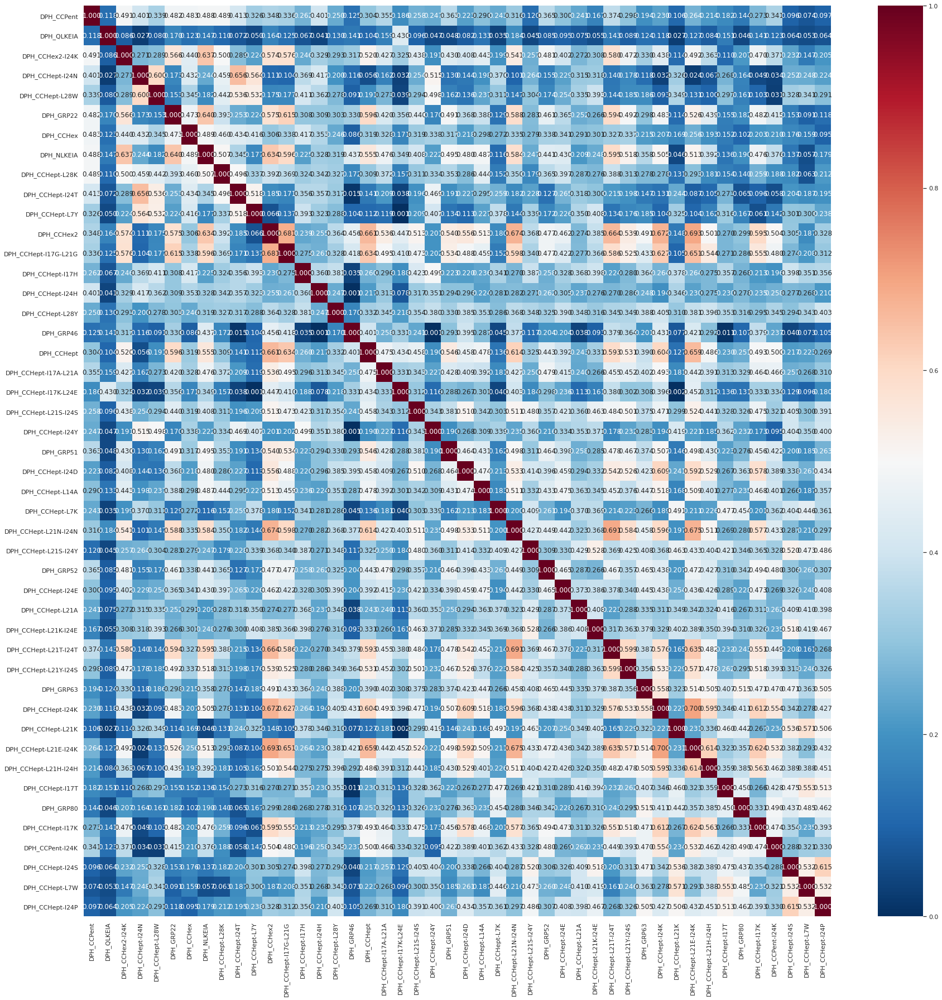

In [33]:
kendall_tau_correlation_matrix = ml.calc_feature_correlations(
    fluor_data=ml.fluor_data, correlation_coeff='kendall', plt_name='', abs_vals=True
)

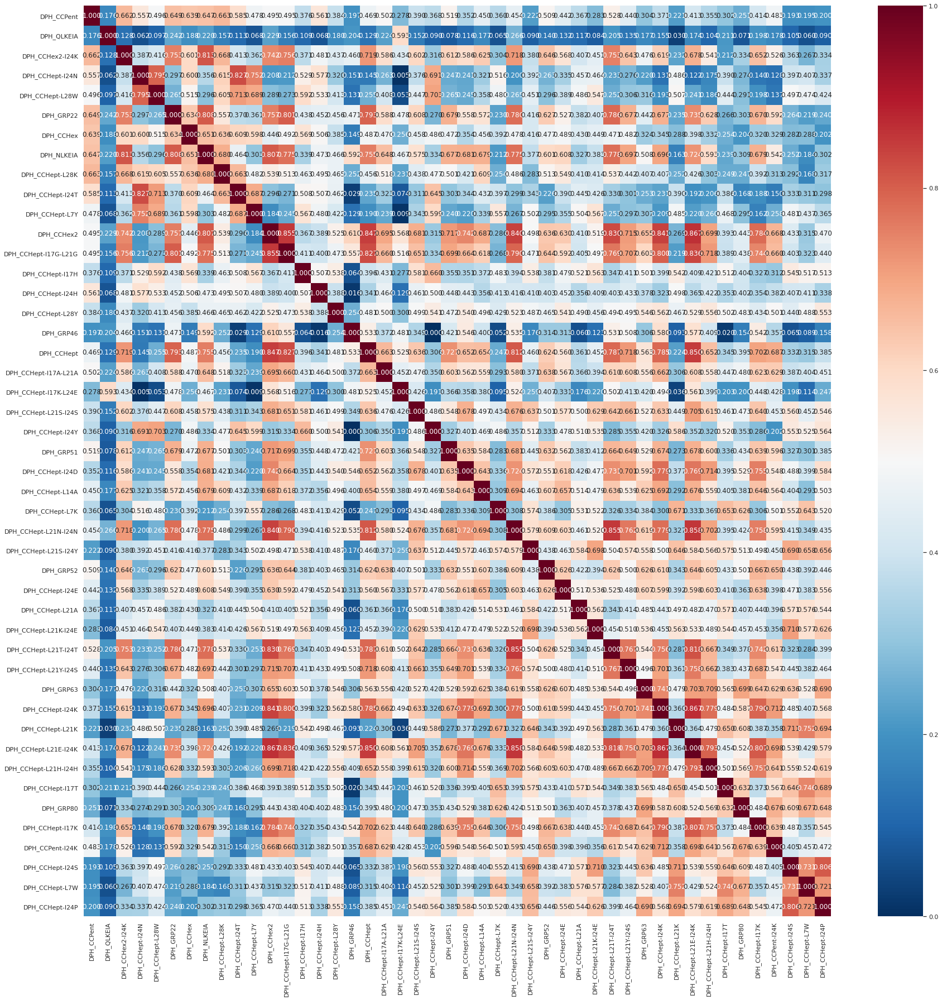

In [34]:
spearman_correlation_matrix = ml.calc_feature_correlations(
    fluor_data=ml.fluor_data, correlation_coeff='spearman', plt_name='', abs_vals=True
)

So, there is quite a wide range of correlation coefficients across the readings of the different barrels. That some of the barrel pairs show high correlation coefficients is encouraging, as it indicates that at least some of the barrels are likely picking up signal in the data as opposed to just noise. However, the barrels with low correlation coefficients are not necessarily picking up noise - they may instead be picking up different information from one another (and hence combining the readings from such barrels in the subsequent ML analysis would likely be beneficial for model performance). The following analysis will help to identify which barrels fall into which of these categories!

In [35]:
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

- Measure the relative importances of the peptides with KBest using one-way ANOVA

<Figure size 720x720 with 0 Axes>

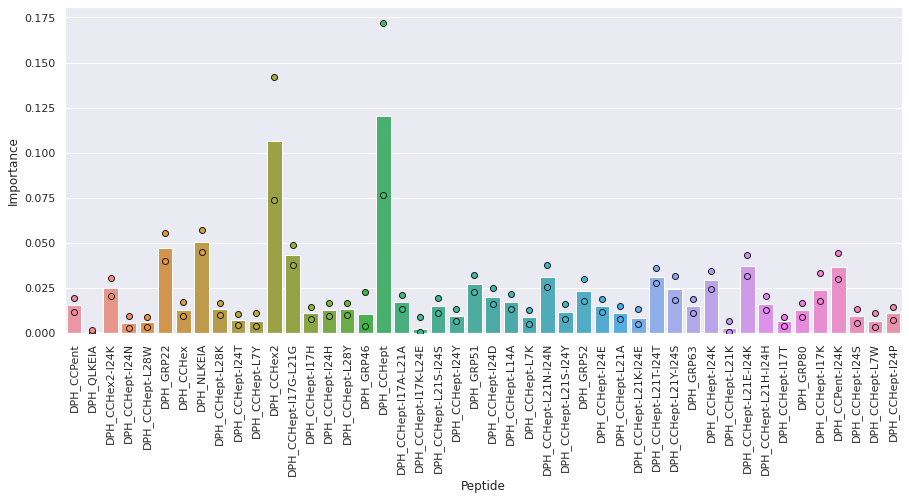

<Figure size 720x720 with 0 Axes>

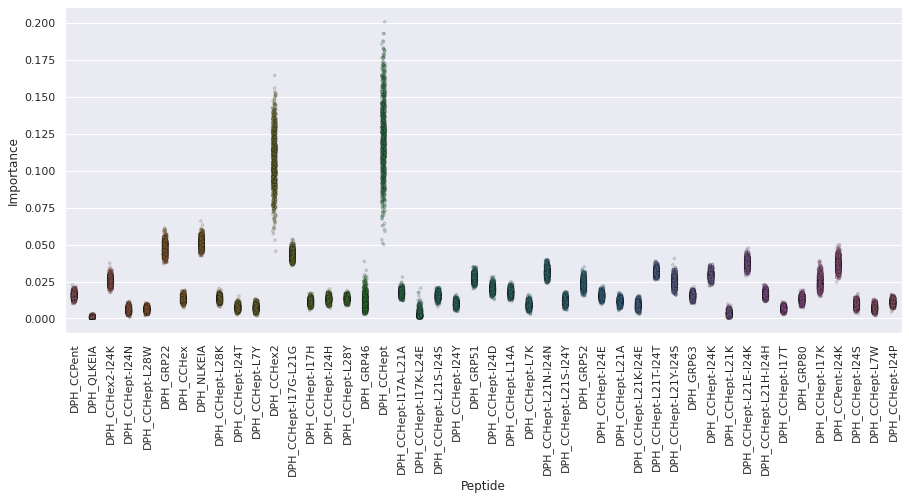

In [36]:
kbest_feat_importances_df, kbest_feat_importances_dict = ml.calc_feature_importances_kbest(
    x=ml.x, y=ml.y, features=None, method_classif='f_classif', num_repeats=1000, scale=True, plt_name=''
)

In [37]:
print('Peptides ordered by F-score:')
kbest_feat_importances_df

Peptides ordered by F-score:


,Feature,Score
0,DPH_CCHept,0.120577
1,DPH_CCHex2,0.106646
2,DPH_NLKEIA,0.050775
3,DPH_GRP22,0.046995
4,DPH_CCHept-I17G-L21G,0.043083
5,DPH_CCHept-L21E-I24K,0.037073
6,DPH_CCPent-I24K,0.036650
7,DPH_CCHept-L21T-I24T,0.031380
8,DPH_CCHept-L21N-I24N,0.031124
9,DPH_CCHept-I24K,0.029208


KBest analysis is a univariate feature selection method, and hence assumes that the features are independent of one another (the importance scores calculated here are the F-scores from running one-way ANOVA). Consequently, the output importance scores do not reflect correlations between features - the scores represent the information provided by a feature about the output class, rather than the unique information provided by that feature alone. Therefore the most important features highlighted by this method could be providing the same information as one another.

From this analysis, unsurprisingly I find that the two peptides identified earlier as having minimal effect upon the fluorescence of DPH (QLKEIA and CCHept-I17K-L24E), and whose readings are hence likely to contain large amounts of noise, provide the least information. However, overall the correlation between importance score and the fluorescence reading of the peptide + DPH (no analyte) is poor, as would be expected. Peptides CCHept and CCHex2 have the highest importance scores.

- Measure the relative importances of the peptides with decision tree analysis

<Figure size 720x720 with 0 Axes>

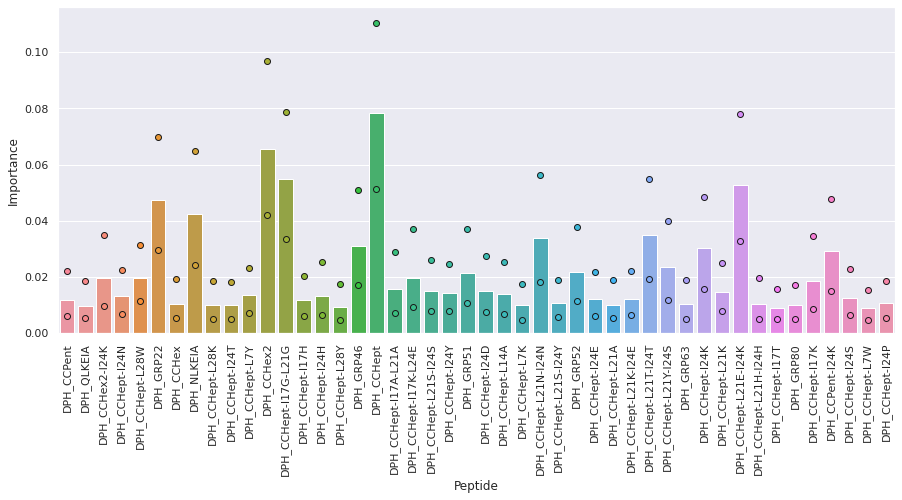

<Figure size 720x720 with 0 Axes>

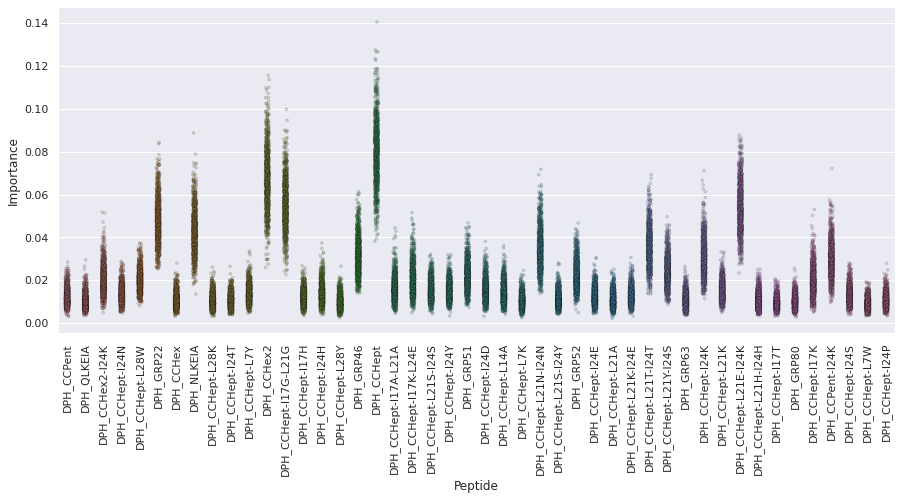

In [38]:
tree_feat_importances_df, tree_feat_importances_dict = ml.calc_feature_importances_tree(
    x=ml.x, y=ml.y, features=None, num_repeats=1000, scale=True, plt_name=''
)

In [39]:
print('Peptides ordered by importance:')
tree_feat_importances_df

Peptides ordered by importance:


,Feature,Score
0,DPH_CCHept,0.078449
1,DPH_CCHex2,0.065637
2,DPH_CCHept-I17G-L21G,0.054935
3,DPH_CCHept-L21E-I24K,0.052598
4,DPH_GRP22,0.047545
5,DPH_NLKEIA,0.042329
6,DPH_CCHept-L21T-I24T,0.035011
7,DPH_CCHept-L21N-I24N,0.033688
8,DPH_GRP46,0.031109
9,DPH_CCHept-I24K,0.030259


In this method, an ExtraTrees classifier is used to calculate importance scores. The ExtraTrees classifier trains multiple decision trees on the data. Each tree is trained with a random subset of features on a random subset of dataset, the results of these trees are then averaged to make a prediction. Importance scores are calculated as the 
average increase in purity achieved when using a particular feature to split the data across all trees in which that feature is included (i.e. the Gini importance score of the feature). When looking at the Gini importance scores of features in individual trees, correlations between the included features are reflected in the scores. However, as more and more trees, incorporating different subsets of features, are included in the average, feature correlations have less of an effect upon the importance scores. The  number of trees (plus bootstrap repeats) included here means that the correlation between features will have little effect upon the importance scores.

In spite of the difference in method, reassuringly the ExtraTrees classifier identifies the same selection of barrels as having the highest importance scores. Whilst there is some variation in the relative order of the less important barrels, their scores are all low.

- Measure the relative importances of the peptides with permutation analysis

<Figure size 720x720 with 0 Axes>

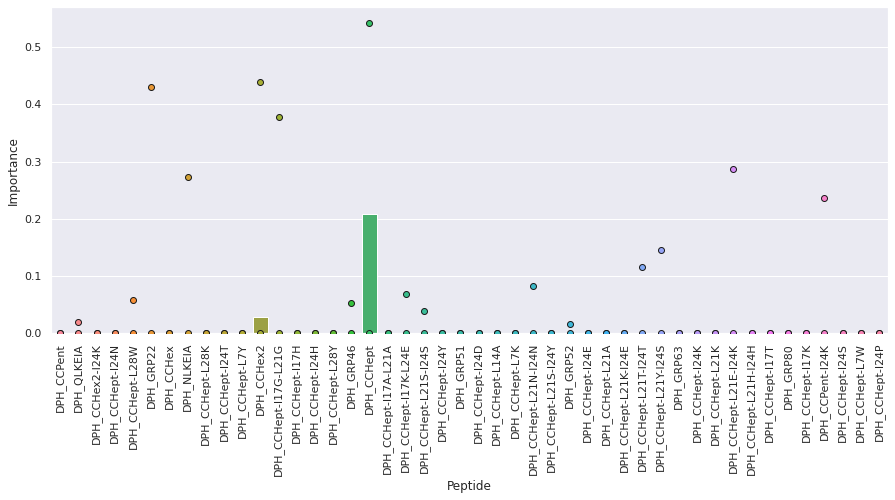

<Figure size 720x720 with 0 Axes>

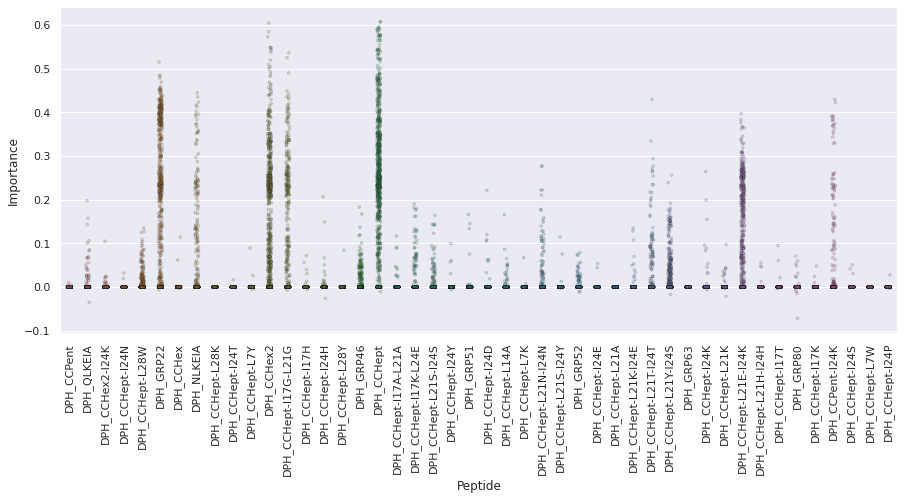

In [40]:
f1 = make_scorer(f1_score, average='weighted')
permut_feat_importances_df, permut_feat_importances_dict = ml.calc_feature_importances_permutation(
    x=ml.x, y=ml.y, features=None, classifier=AdaBoostClassifier,
    parameters={'n_estimators': np.array([10, 30, 100, 300, 1000])}, model_metric=f1, num_repeats=1000,
    scale=True, plt_name=''
)

In [41]:
print('Peptides ordered by median importance:')
permut_feat_importances_df

Peptides ordered by median importance:


,Feature,Score
0,DPH_CCHept,0.208046
1,DPH_CCHex2,0.028679
2,DPH_CCPent,0.000000
3,DPH_GRP63,0.000000
4,DPH_CCHept-L21N-I24N,0.000000
5,DPH_CCHept-L21S-I24Y,0.000000
6,DPH_GRP52,0.000000
7,DPH_CCHept-I24E,0.000000
8,DPH_CCHept-L21A,0.000000
9,DPH_CCHept-L21K-I24E,0.000000


In [42]:
mean_permut_feat_importances_df = OrderedDict({})
for feat, score_list in permut_feat_importances_dict.items():
    mean_permut_feat_importances_df[feat] = np.mean(score_list)
mean_permut_feat_importances_df = pd.DataFrame({'Feature': list(mean_permut_feat_importances_df.keys()),
                                                'Score': list(mean_permut_feat_importances_df.values())})
mean_permut_feat_importances_df = mean_permut_feat_importances_df.sort_values(
    by=['Score'], axis=0, ascending=False
).reset_index(drop=True)

In [43]:
print('Peptides ordered by mean importance:')
mean_permut_feat_importances_df

Peptides ordered by mean importance:


,Feature,Score
0,DPH_CCHept,0.190747
1,DPH_GRP22,0.126381
2,DPH_CCHex2,0.113868
3,DPH_CCHept-L21E-I24K,0.065874
4,DPH_CCHept-I17G-L21G,0.050664
5,DPH_NLKEIA,0.023357
6,DPH_CCPent-I24K,0.015874
7,DPH_CCHept-L21Y-I24S,0.012250
8,DPH_CCHept-L21T-I24T,0.009040
9,DPH_CCHept-L21N-I24N,0.004951


In permutation analysis, importance scores are calculated by training two ML models (in this case I have selected AdaBoost classifiers). The first model is trained using all features, the second is trained with one of the features randomly scrambled: the importance score of the feature is then calculated as the difference in performance (in this case measured via model F1 score) between the two models. Hence this method does take into account correlations between features, and the output importance scores represent the unique information that a feature provides about the output class label.

As can be seen from the plots, most of the features provide little unique information about the output class (when looking at the median scores, only two barrels have non-zero values). CCHept and CCHex2 are again found to be two of the most important barrels - however, permutation analysis finds CCHept to be substantially more important than CCHex2, whereas the KBest and ExtraTrees analyses calculate the importance scores of the two barrels as being more similar. When looking at the median importance scores, CCHept and CCHex2 are the only two barrels with non-zero scores, whereas when looking at the mean scores, GRP22 is found to be the second most important peptide, so clearly it has a high importance score across a smaller number of the bootstrap repeats (as can be seen in the strip plot of permutation importance scores). GRP22 also has a high importance score in both the KBest and ExtraTrees analyses.

So, whilst there is some variation in the relative order of the less important peptides, all three methods agree that CCHept, CCHex2 and GRP22 are three of the most important peptides, with respect to both their independent relationship with the output class label plus the unique information they provide.

- What percentage of the signal in the data can be measured by N principal components?

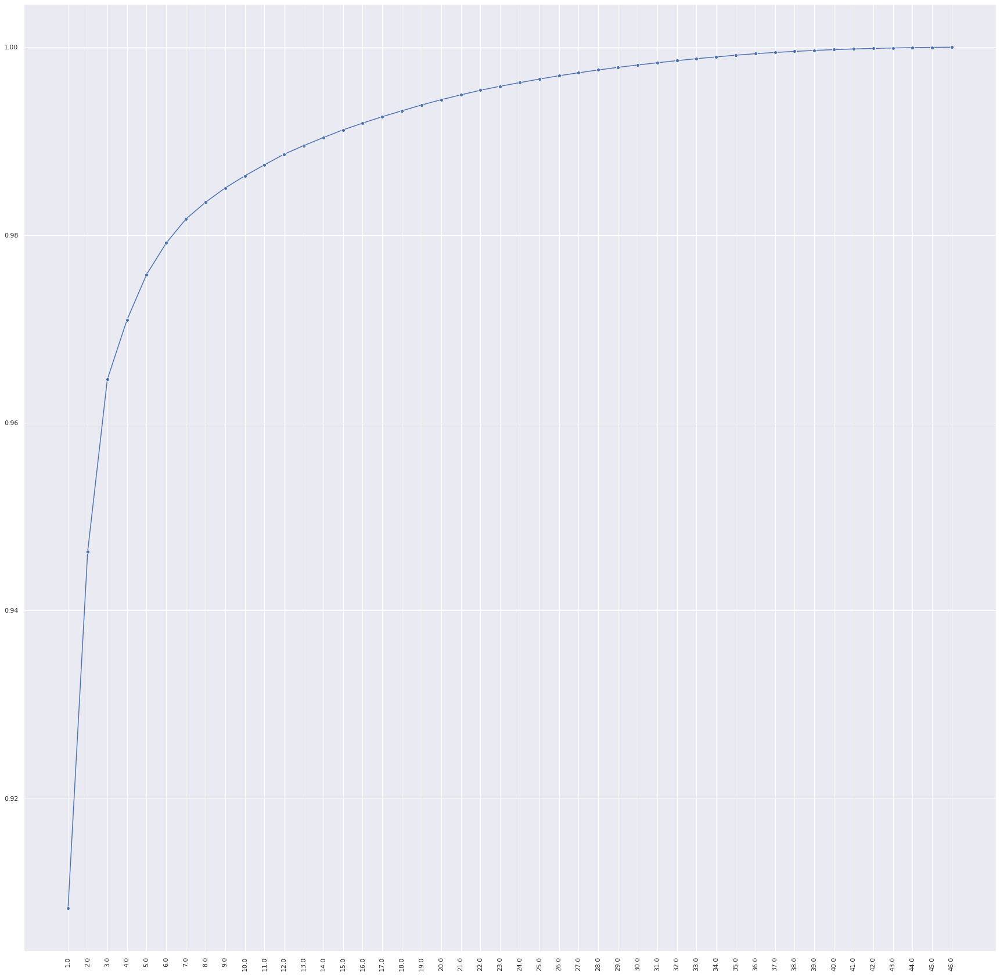

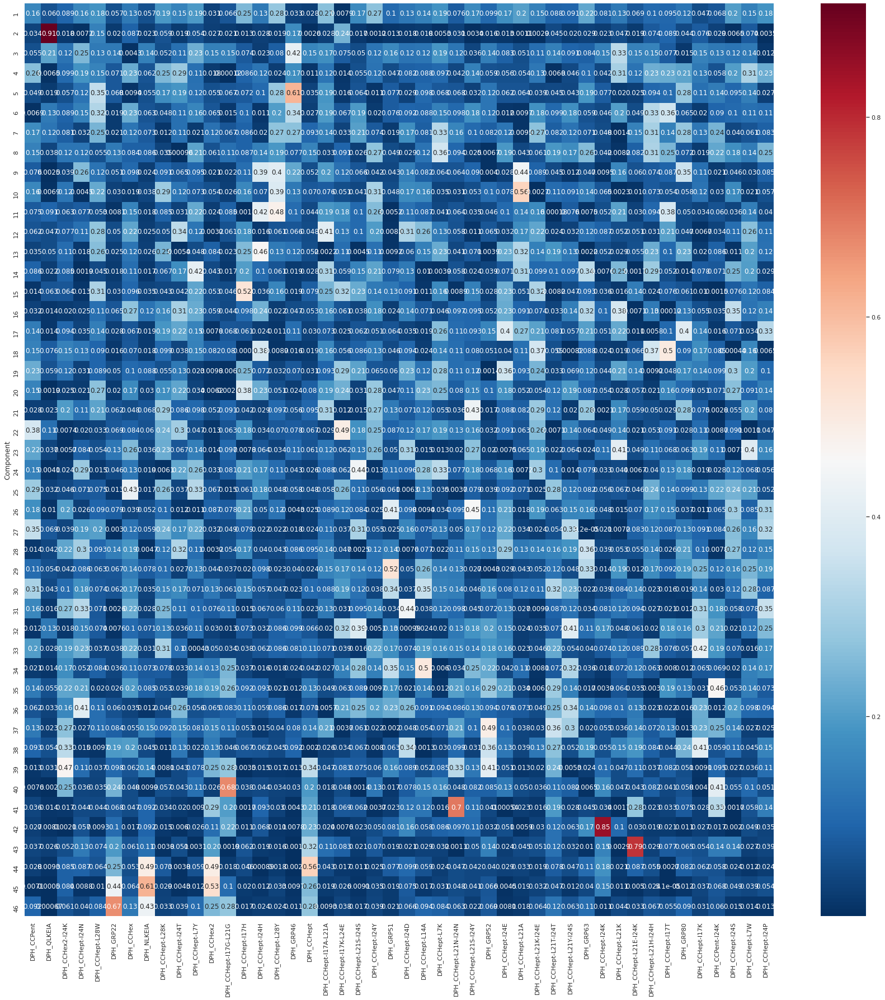

In [44]:
plt.rcParams['figure.figsize'] = (30, 30)  # Sets figure size
pca_model, pca_components = ml.run_pca(fluor_data=ml.fluor_data, scale=True, plt_name='')
plt.rcParams['figure.figsize'] = (10, 10)  # Resets default figure size

Over 96% of the variance in the data can be represented by three principal components, and over 90% by just one. Lots of different peptides make a contribution to the first principal component. Interestingly, the feature that makes by far the largest contribution to the second principal component is QLKEIA, thus demonstrating that it contains useful information in addition to the noise identified by the earlier analysis in this notebook. This probably occurs because, as seen in the box plots generated for the FA subclasses earlier, peptide QLKEIA gives noticeably different readings for the different FA subclasses. (This result therefore nicely highlights the fact that PCA does not take into account class labels when calculating principal components in the direction of the maximum variance in the data.)

Scatter plots of data transformed to PCA dimensions

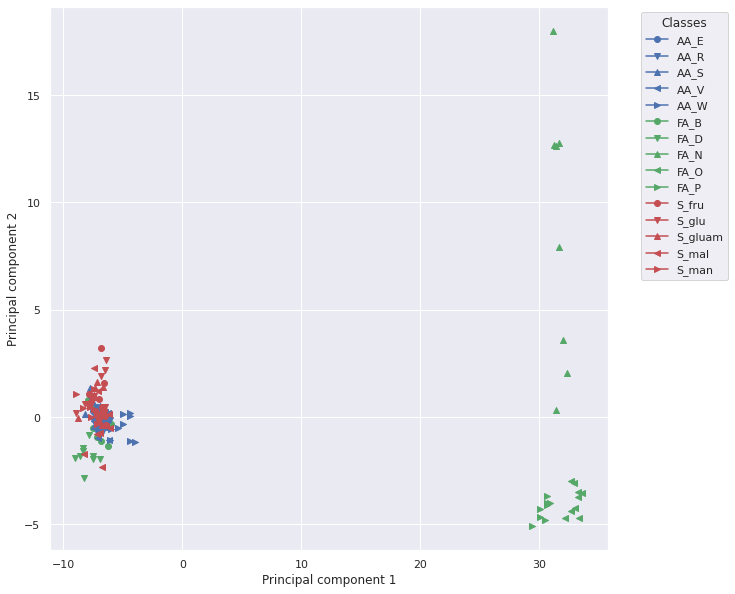

In [45]:
ml.plot_scatter_on_pca_axes(
    x=ml.x, y=ml.y, subclasses=ml.sub_classes, num_dimensions=2, scale=True, plt_name=''
)

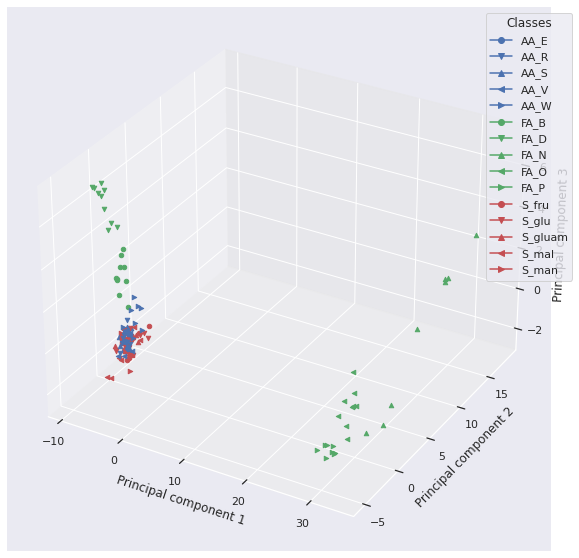

In [46]:
ml.plot_scatter_on_pca_axes(
    x=ml.x, y=ml.y, subclasses=ml.sub_classes, num_dimensions=3, scale=True, plt_name=''
)

As expected based upon the earlier scatter plots of fluorescence readings, on these scatter plots on PCA axes the fatty acids are readily distinguishable (and indeed even the different subclasses of fatty acid are clustered separatelyfrom one another), whereas the amino acids and sugars are more difficult to separate (the exception to this being the tryptophan subclass).

#### How well does a model trained with all features perform?

Runs grid search with nested cross-validation to spot check 5 different ML algorithms. Inner loop identifies the optimal parameter values to use with the ML algorithm; outer loop measures the performance of a model trained using these parameter values.

In [47]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing']  # Classes are ~balanced, plus the dataset is quite small => decided
# not to test any data resampling methods such as oversampling and SMOTE, etc.

n_components_pca = None
inner_splits = None
outer_splits = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 5
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

all_feat_searches = OrderedDict({})
all_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})
for algorithm in algorithms:
    for resampling_method in resampling_methods:
        fixed_params = ml.define_fixed_model_params(classifier=algorithm())
        if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
            fixed_params['random_state'] = 1
        tuned_params = ml.define_tuned_model_params(
            classifier=algorithm(), x_train=ml.x, n_folds=cv_folds_inner_loop
        )
        nested_cv_search = ml.run_nested_CV(
            clf=algorithm, x=ml.x, y=ml.y, groups=None, selected_features=list(ml.features),
            inner_splits=inner_splits, outer_splits=outer_splits, const_split=True,
            resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
            fixed_params=fixed_params, tuned_params=tuned_params, train_scoring_metric=train_scoring_metric,
            test_scoring_funcs=test_scoring_funcs, n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
            cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
        )

        all_feat_searches[
            '{}__{}'.format(algorithm.__name__, resampling_method)
        ] = copy.deepcopy(nested_cv_search)

        all_feat_score_dict['Algorithm'].append(algorithm.__name__)
        all_feat_score_dict['Resampling_method'].append(resampling_method)
        all_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
        all_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
        all_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
        all_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
        all_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
        all_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
        all_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
        all_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

        for index, params in enumerate(nested_cv_search['outer_loop_params']):
            print('\n\n\n')
            print('{}: {}'.format(algorithm.__name__, resampling_method))
            print('Parameters: {}'.format(params))
            print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][index]))
            print('F1: {}'.format(nested_cv_search['test_scores']['f1'][index]))





KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 24), ('p', 1), ('weights', 'distance')])
Accuracy: 0.75
F1: 0.738031212484994




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'distance')])
Accuracy: 0.9285714285714286
F1: 0.9273538961038961




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8214285714285714
F1: 0.8214285714285713




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 6), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8888888888888888
F1: 0.888544891640867




KNeighborsClassifier: no_balancing
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 16), ('p', 1), ('weights', 'distance')])

In [48]:
all_feat_score_df = pd.DataFrame(all_feat_score_dict)

In [49]:
all_feat_score_df

,Algorithm,Resampling_method,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,0.840741,0.062147,0.840741,0.062147,0.866478,0.045670,0.837920,0.065378
1,GaussianNB,no_balancing,0.817989,0.063594,0.817989,0.063594,0.847339,0.059801,0.814820,0.065911
2,LinearSVC,no_balancing,0.817989,0.074665,0.817989,0.074665,0.833328,0.082474,0.812600,0.076743
3,SVC,no_balancing,0.833333,0.036437,0.833333,0.036437,0.863386,0.027403,0.826095,0.043012
4,AdaBoostClassifier,no_balancing,0.774339,0.073522,0.774339,0.073522,0.801125,0.069173,0.770238,0.071588


In [50]:
with open('{}/All_features_CV_search_models.pkl'.format(ml.results_dir), 'wb') as f:
    pickle.dump((all_feat_searches, all_feat_score_df), f)

Several algorithms perform similarly well. Have selected KNeighborsClassifier to take forwards since it achieves the best performance across all 4 metrics.

In [51]:
all_feat_searches['KNeighborsClassifier__no_balancing']['outer_loop_params']

[OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 24),
              ('p', 1),
              ('weights', 'distance')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 11),
              ('p', 1),
              ('weights', 'distance')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 11),
              ('p', 1),
              ('weights', 'distance')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 6),
              ('p', 1),
              ('weights', 'distance')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 16),
              ('p', 1),
              ('weights', 'distance')])]

In [52]:
all_feat_searches['KNeighborsClassifier__no_balancing']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 11),
                           ('p', 1),
                           ('weights', 'distance')])),
             ('recall',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 11),
                           ('p', 1),
                           ('weights', 'distance')])),
             ('precision',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 11),
                           ('p', 1),
                           ('weights', 'distance')])),
             ('f1',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 11),
                           ('p', 1),
                  

In [53]:
all_feat_searches['KNeighborsClassifier__no_balancing']['test_scores']['accuracy']

[0.75,
 0.9285714285714286,
 0.8214285714285714,
 0.8888888888888888,
 0.8148148148148148]

In [54]:
all_feat_nested_pred = all_feat_searches['KNeighborsClassifier__no_balancing']['predictions']
all_feat_nested_y_true = all_feat_searches['KNeighborsClassifier__no_balancing']['y_true']
all_feat_nested_x_true = all_feat_searches['KNeighborsClassifier__no_balancing']['x_true']

all_feat_flat_pred = np.array([pred for pred_array in all_feat_nested_pred for pred in pred_array])
all_feat_flat_y_true = np.array([y for y_array in all_feat_nested_y_true for y in y_array])
all_feat_flat_x_true = np.array([x for x_array in all_feat_nested_x_true for x in x_array])

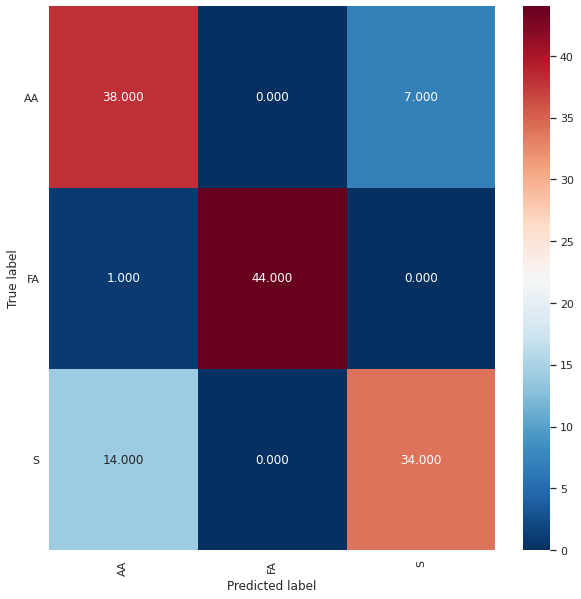

Normalised over true label (rows)


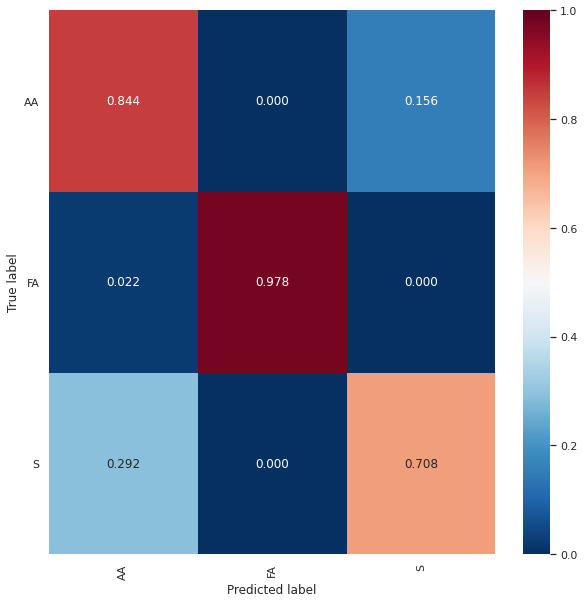

Normalised over pred label (columns)


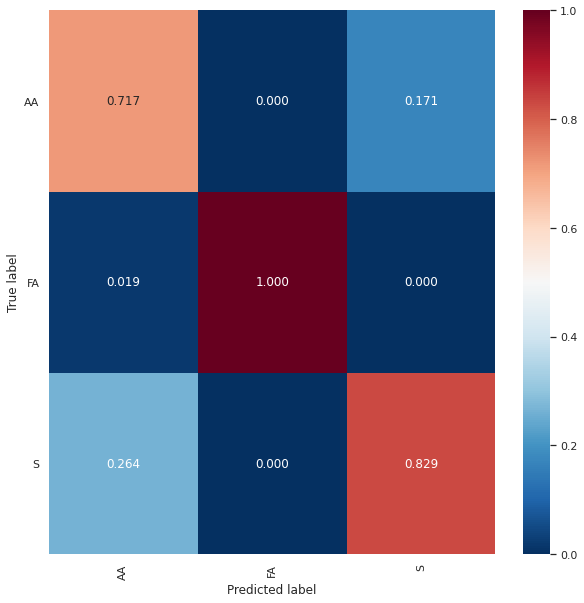

In [55]:
draw_conf_matrices(all_feat_flat_y_true, all_feat_flat_pred, ml.results_dir, 'All_features')

In [56]:
all_feat_true_hue = []
for index, y in enumerate(all_feat_flat_y_true):
    if all_feat_flat_pred[index] == y:
        all_feat_true_hue.append('{}_correct'.format(y))
    else:
        all_feat_true_hue.append('{}_incorrect'.format(y))

sub_all_feat_true_hue = []
sub_all_feat_flat_x_true = []
sub_all_feat_flat_y_true = []
for i, true_hue in enumerate(all_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_all_feat_true_hue.append(true_hue)
        sub_all_feat_flat_x_true.append(all_feat_flat_x_true[i])
        sub_all_feat_flat_y_true.append(all_feat_flat_y_true[i])

all_feat_true_hue = np.array(all_feat_true_hue)
sub_all_feat_true_hue = np.array(sub_all_feat_true_hue)
sub_all_feat_flat_x_true = np.array(sub_all_feat_flat_x_true)
sub_all_feat_flat_y_true = np.array(sub_all_feat_flat_y_true)

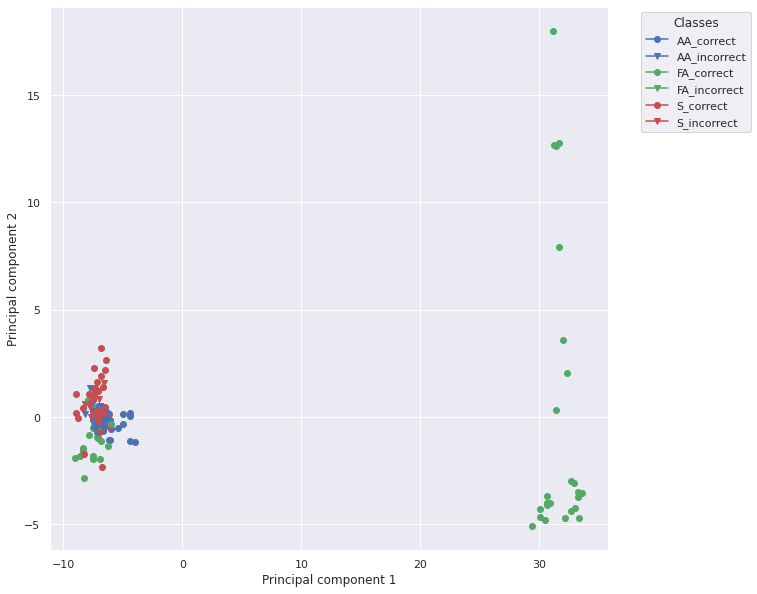

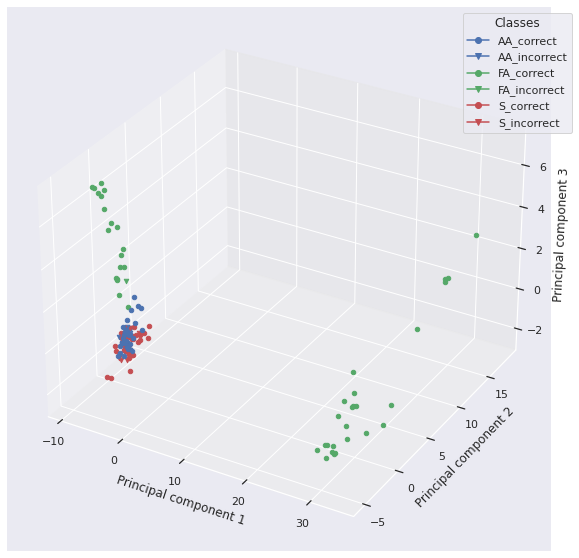

In [57]:
# Scatter plot (axes = top two principal components)
ml.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml.plot_scatter_on_pca_axes(
    x=all_feat_flat_x_true, y=all_feat_flat_y_true, subclasses=all_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='All_features_coloured_by_pred'
)

# AA_incorrect = Value that is actually amino acid is predicted to be something else

It is possible to train an ML model to distinguish the difference between amino acid, fatty acid and sugar BADASS fingerprints. The best performing model is much more effective than random guessing (which would have an expected accuraccy of 0.33 (2sf)). As would be expected given the earlier analysis in this notebook, the model is able to distinguish the fatty acids from the amino acids and sugars more readily than it is able to distinguish the latter two classes from one another. However, it still gets most of the amino acid and sugar predictions correct.

#### Is it possible to maintain/improve model performance when reducing the number of peptides?

Sequentially include features via their feature importance (as measured via KBest/permutation analysis), measure if there is any difference in trained classifier performance.

In [58]:
algorithms = [KNeighborsClassifier, GaussianNB, LinearSVC, SVC, AdaBoostClassifier]
resampling_methods = ['no_balancing']  # Classes are ~ balanced, plus the dataset is quite small => decided
# not to test any data resampling methods such as oversampling and SMOTE, etc.
num_features_list = [1, 2, 3, 4, 5, 10, 15, 20, 30, 46]

ordered_features = {'KBest_Fscore': kbest_feat_importances_df['Feature'].tolist(),
                    'Permutation_score': mean_permut_feat_importances_df['Feature'].tolist()}

n_components_pca = None
inner_splits = None
outer_splits = None
run = 'gridsearch'
n_iter = None
cv_folds_inner_loop = 5
cv_folds_outer_loop = 5
train_scoring_metric = make_scorer(f1_score, average='weighted', zero_division=0)
test_scoring_funcs={accuracy_score: {},
                    recall_score: {'average': 'weighted',
                                   'zero_division': 0},
                    precision_score: {'average': 'weighted',
                                      'zero_division': 0},
                    f1_score: {'average': 'weighted',
                               'zero_division': 0}}

red_feat_searches = OrderedDict({})
red_feat_score_dict = OrderedDict({'Algorithm': [],
                                   'Resampling_method': [],
                                   'Feature_selection_method': [],
                                   'Num_features': [],
                                   'Average_accuracy': [],
                                   'Std_dev_accuracy': [],
                                   'Average_recall': [],
                                   'Std_dev_recall': [],
                                   'Average_precision': [],
                                   'Std_dev_precision': [],
                                   'Average_f1': [],
                                   'Std_dev_f1': []})
for algorithm in algorithms:
    for resampling_method in resampling_methods:
        for feat_method, all_features in ordered_features.items():
            for num_features in num_features_list:
                fixed_params = ml.define_fixed_model_params(classifier=algorithm())
                if algorithm.__name__ in ['LinearSVC', 'SVC', 'AdaBoostClassifier']:
                    fixed_params['random_state'] = 1
                tuned_params = ml.define_tuned_model_params(
                    classifier=algorithm(), x_train=ml.x, n_folds=cv_folds_inner_loop
                )
                selected_features = all_features[:num_features]

                nested_cv_search = ml.run_nested_CV(
                    clf=algorithm, x=ml.x, y=ml.y, groups=None, selected_features=selected_features,
                    inner_splits=inner_splits, outer_splits=outer_splits, const_split=True,
                    resampling_method=resampling_method, n_components_pca=n_components_pca, run=run,
                    fixed_params=fixed_params, tuned_params=tuned_params,
                    train_scoring_metric=train_scoring_metric, test_scoring_funcs=test_scoring_funcs,
                    n_iter=n_iter, cv_folds_inner_loop=cv_folds_inner_loop,
                    cv_folds_outer_loop=cv_folds_outer_loop, draw_conf_mat=False, plt_name=''
                )

                red_feat_searches[
                    '{}__{}__{}__{}'.format(algorithm.__name__, resampling_method, feat_method, num_features)
                ] = copy.deepcopy(nested_cv_search)

                red_feat_score_dict['Algorithm'].append(algorithm.__name__)
                red_feat_score_dict['Resampling_method'].append(resampling_method)
                red_feat_score_dict['Average_accuracy'].append(nested_cv_search['average_test_scores']['accuracy'])
                red_feat_score_dict['Feature_selection_method'].append(feat_method)
                red_feat_score_dict['Num_features'].append(num_features)
                red_feat_score_dict['Std_dev_accuracy'].append(nested_cv_search['stddev_test_scores']['accuracy'])
                red_feat_score_dict['Average_recall'].append(nested_cv_search['average_test_scores']['recall'])
                red_feat_score_dict['Std_dev_recall'].append(nested_cv_search['stddev_test_scores']['recall'])
                red_feat_score_dict['Average_precision'].append(nested_cv_search['average_test_scores']['precision'])
                red_feat_score_dict['Std_dev_precision'].append(nested_cv_search['stddev_test_scores']['precision'])
                red_feat_score_dict['Average_f1'].append(nested_cv_search['average_test_scores']['f1'])
                red_feat_score_dict['Std_dev_f1'].append(nested_cv_search['stddev_test_scores']['f1'])

                for index, params in enumerate(nested_cv_search['outer_loop_params']):
                    print('\n\n\n')
                    print('{}: {},  {},  {}'.format(
                        algorithm.__name__, resampling_method, feat_method, num_features
                    ))
                    print('Parameters: {}'.format(params))
                    print('Accuracy: {}'.format(nested_cv_search['test_scores']['accuracy'][index]))
                    print('F1: {}'.format(nested_cv_search['test_scores']['f1'][index]))





KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.9285714285714286
F1: 0.9285714285714286




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 24), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8214285714285714
F1: 0.8214285714285713




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 8), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.7777777777777778
F1: 0.7662337662337663




KNeighborsClassifier: no_balancing,  KBest_Fscore,  1
Parameters: Orde





KNeighborsClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.75




KNeighborsClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 10), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




KNeighborsClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 9), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8928571428571429
F1: 0.8891304347826087




KNeighborsClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 5), ('p', 1), ('weights', 'distance')])
Accuracy: 0.8888888888888888
F1: 0.888544891640867




KNeighborsClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('metric', 'm





KNeighborsClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 19), ('p', 1), ('weights', 'uniform')])
Accuracy: 0.8214285714285714
F1: 0.8110766045548655




KNeighborsClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.75
F1: 0.7485994397759104




KNeighborsClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 7), ('p', 2), ('weights', 'uniform')])
Accuracy: 0.9285714285714286
F1: 0.9285714285714286




KNeighborsClassifier: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 21), ('p', 1), ('weights', 'distance')])
Accuracy: 0.9259259259259259
F1: 0.9259259259259259




KNeighborsClassifier: no_balancing,  Permutation_score,  1





GaussianNB: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.9642857142857143
F1: 0.9642857142857143




GaussianNB: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.8928571428571429
F1: 0.8922569027611046




GaussianNB: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.8571428571428571
F1: 0.8541514431859701




GaussianNB: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.7777777777777778
F1: 0.7727272727272728




GaussianNB: no_balancing,  KBest_Fscore,  15
Parameters: OrderedDict()
Accuracy: 0.8888888888888888
F1: 0.8824561403508772




GaussianNB: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict()
Accuracy: 0.9642857142857143
F1: 0.9642857142857143




GaussianNB: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict()
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




GaussianNB: no_balancing,  KBest_Fscore,  20
Parameters: OrderedDict()
Accuracy: 0.7857142857142857
F1: 0.7





GaussianNB: no_balancing,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.8928571428571429
F1: 0.8951060687432868




GaussianNB: no_balancing,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




GaussianNB: no_balancing,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.8214285714285714
F1: 0.8186602870813396




GaussianNB: no_balancing,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.7037037037037037
F1: 0.696007696007696




GaussianNB: no_balancing,  Permutation_score,  46
Parameters: OrderedDict()
Accuracy: 0.8148148148148148
F1: 0.8156862745098039




LinearSVC: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.8214285714285714
F1: 0.8096938775510205




LinearSVC: no_balancing,  KBest_Fscore,  1
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)])
A





LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.8928571428571429
F1: 0.8910564225690276




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 2.0)])
Accuracy: 0.7857142857142857
F1: 0.7509398496240601




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.25)])
Accuracy: 0.8928571428571429
F1: 0.8922569027611046




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 0.0625)])
Accuracy: 0.8148148148148148
F1: 0.8142414860681114




LinearSVC: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 1.0)])
Accuracy: 0.7407407407407407
F1: 0.739938080495356
Range teste





LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 8.0)])
Accuracy: 0.9285714285714286
F1: 0.9281746031746032




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 256.0)])
Accuracy: 0.8928571428571429
F1: 0.8891304347826087




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 4.0)])
Accuracy: 0.8928571428571429
F1: 0.8922569027611046




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 256.0)])
Accuracy: 0.8148148148148148
F1: 0.8095238095238095




LinearSVC: no_balancing,  Permutation_score,  15
Parameters: OrderedDict([('dual', False), ('max_iter', 10000), ('random_state', 1), ('C', 512.0)])
Accuracy: 0.8518518518518519
F1: 0.8

Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 8.0


Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 8.0






SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 0.25), ('gamma', 8.0), ('kernel', 'rbf')])
Accuracy: 0.8928571428571429
F1: 0.8923374613003097




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 4.0), ('kernel', 'rbf')])
Accuracy: 0.9285714285714286
F1: 0.9273538961038961




SVC: no_balancing,  KBest_Fscore,  3
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 8.0), ('kernel', 'rbf')])
Accuracy: 0.85714285

Range tested: [3.0517578125e-05, 6.103515625e-05, 0.0001220703125, 0.000244140625, 0.00048828125, 0.0009765625, 0.001953125, 0.00390625, 0.0078125, 0.015625, 0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 2.0, 4.0, 8.0]
Value selected: 8.0






SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 64.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8517051557465092




SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 32.0), ('gamma', 2.0), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 2.0), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




SVC: no_balancing,  Permutation_score,  1
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 8.0), ('kernel', 'rbf')])
Accuracy: 0.7777777777777778
F1: 0.7662337662





SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.015625), ('kernel', 'rbf')])
Accuracy: 0.8928571428571429
F1: 0.8910564225690276




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 4.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.8571428571428571
F1: 0.8486394557823128




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 8.0), ('gamma', 0.03125), ('kernel', 'rbf')])
Accuracy: 0.9285714285714286
F1: 0.9285714285714286




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 128.0), ('gamma', 0.00390625), ('kernel', 'rbf')])
Accuracy: 0.8148148148148148
F1: 0.8095238095238095




SVC: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('C', 1.0), ('gamma', 0.125), ('kernel', 'rbf')])
Accuracy: 0.8148148148148148
F1: 0.8142414860681114




SVC: 





AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.8571428571428571
F1: 0.8522727272727273




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.6785714285714286
F1: 0.6588435374149659




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8571428571428571
F1: 0.8571428571428571




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6666666666666666
F1: 0.6793650793650793




AdaBoostClassifier: no_balancing,  KBest_Fscore,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7407407407407407
F1: 0.7269005847953217




AdaBoostClassifier: no_balancing,  KBest_Fscore,  46
Parameters: OrderedDict([('random_state', 1), ('n_





AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.8571428571428571
F1: 0.8522727272727273




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 3162)])
Accuracy: 0.75
F1: 0.7355072463768115




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 10)])
Accuracy: 0.8571428571428571
F1: 0.8571428571428571




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 100)])
Accuracy: 0.6666666666666666
F1: 0.6793650793650793




AdaBoostClassifier: no_balancing,  Permutation_score,  30
Parameters: OrderedDict([('random_state', 1), ('n_estimators', 31)])
Accuracy: 0.7407407407407407
F1: 0.7269005847953217




AdaBoostClassifier: no_balancing,  Permutation_score,  46
Parameters: OrderedDict([('rando

In [59]:
red_feat_score_df = pd.DataFrame(red_feat_score_dict)

In [60]:
red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,KBest_Fscore,1,0.854762,0.052261,0.854762,0.052261,0.869480,0.047477,0.850294,0.055403
1,KNeighborsClassifier,no_balancing,KBest_Fscore,2,0.869577,0.036443,0.869577,0.036443,0.876523,0.036731,0.868573,0.036724
2,KNeighborsClassifier,no_balancing,KBest_Fscore,3,0.876984,0.036379,0.876984,0.036379,0.882246,0.033731,0.874310,0.039667
3,KNeighborsClassifier,no_balancing,KBest_Fscore,4,0.869048,0.069209,0.869048,0.069209,0.879480,0.069388,0.865776,0.071313
4,KNeighborsClassifier,no_balancing,KBest_Fscore,5,0.847884,0.027005,0.847884,0.027005,0.860960,0.024424,0.844871,0.029121
...,...,...,...,...,...,...,...,...,...,...,...,...
95,AdaBoostClassifier,no_balancing,Permutation_score,10,0.767460,0.082768,0.767460,0.082768,0.785565,0.083494,0.758637,0.090814
96,AdaBoostClassifier,no_balancing,Permutation_score,15,0.774603,0.065224,0.774603,0.065224,0.797817,0.053456,0.770801,0.063097
97,AdaBoostClassifier,no_balancing,Permutation_score,20,0.781746,0.071605,0.781746,0.071605,0.808701,0.063266,0.779519,0.068301
98,AdaBoostClassifier,no_balancing,Permutation_score,30,0.774339,0.073522,0.774339,0.073522,0.801125,0.069173,0.770238,0.071588


In [61]:
with open('{}/Red_features_CV_search_models.pkl'.format(ml.results_dir), 'wb') as f:
    pickle.dump((red_feat_searches, red_feat_score_df), f)

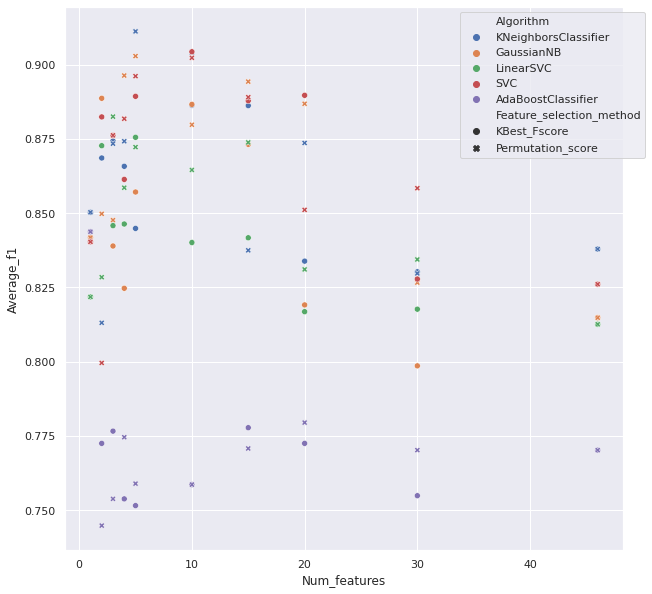

In [62]:
plt.clf()
sns.scatterplot(
    x=red_feat_score_df['Num_features'], y=red_feat_score_df['Average_f1'],
    hue=red_feat_score_df['Algorithm'], style=red_feat_score_df['Feature_selection_method']
)
plt.legend(bbox_to_anchor=(1.05,1))
plt.savefig('{}/Number_of_features_vs_performance_scatter_plot.svg'.format(ml.results_dir))
plt.show()

The number of features with which optimal model performance is achieved is dependent upon the algorithm, but is generally reached by ~5-10 features. Including additional features beyond this typically (with the exception of the AdaBoost classifier) leads to a decrease in performance, thus indicating that these extra features are primarily introducing noise as opposed to signal.

In [63]:
sub_red_feat_score_df = red_feat_score_df[red_feat_score_df['Num_features'] == 5].reset_index(drop=True)

In [64]:
sub_red_feat_score_df

,Algorithm,Resampling_method,Feature_selection_method,Num_features,Average_accuracy,Std_dev_accuracy,Average_recall,Std_dev_recall,Average_precision,Std_dev_precision,Average_f1,Std_dev_f1
0,KNeighborsClassifier,no_balancing,KBest_Fscore,5,0.847884,0.027005,0.847884,0.027005,0.860960,0.024424,0.844871,0.029121
1,KNeighborsClassifier,no_balancing,Permutation_score,5,0.912698,0.043687,0.912698,0.043687,0.919237,0.040730,0.911181,0.044560
2,GaussianNB,no_balancing,KBest_Fscore,5,0.862169,0.036055,0.862169,0.036055,0.885657,0.034182,0.857123,0.038811
3,GaussianNB,no_balancing,Permutation_score,5,0.905556,0.043868,0.905556,0.043868,0.920931,0.035928,0.902874,0.045978
4,LinearSVC,no_balancing,KBest_Fscore,5,0.876984,0.028517,0.876984,0.028517,0.884902,0.025213,0.875541,0.029386
5,LinearSVC,no_balancing,Permutation_score,5,0.875926,0.060665,0.875926,0.060665,0.885484,0.058797,0.872234,0.063827
6,SVC,no_balancing,KBest_Fscore,5,0.890741,0.047299,0.890741,0.047299,0.899865,0.042530,0.889335,0.048946
7,SVC,no_balancing,Permutation_score,5,0.897884,0.037585,0.897884,0.037585,0.904892,0.039533,0.896118,0.039106
8,AdaBoostClassifier,no_balancing,KBest_Fscore,5,0.760582,0.060396,0.760582,0.060396,0.817861,0.051877,0.751572,0.059939
9,AdaBoostClassifier,no_balancing,Permutation_score,5,0.767460,0.061558,0.767460,0.061558,0.808593,0.066871,0.758976,0.056997


Most of the algorithms perform similarly well, but will select KNeighbors classifier (with 5 features selected via permutation analysis), as it has the highest performance scores across three of the four metrics (and the second highest score on the other).

In [65]:
red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['outer_loop_params']

[OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 10),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 8),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 8),
              ('p', 1),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 8),
              ('p', 2),
              ('weights', 'uniform')]),
 OrderedDict([('metric', 'minkowski'),
              ('n_jobs', -1),
              ('n_neighbors', 10),
              ('p', 2),
              ('weights', 'uniform')])]

In [66]:
red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['best_outer_loop_params']

OrderedDict([('accuracy',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 8),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('recall',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 8),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('precision',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 8),
                           ('p', 1),
                           ('weights', 'uniform')])),
             ('f1',
              OrderedDict([('metric', 'minkowski'),
                           ('n_jobs', -1),
                           ('n_neighbors', 8),
                           ('p', 1),
                         

In [67]:
red_feat_nested_pred = red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['predictions']
red_feat_nested_y_true = red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['y_true']
red_feat_nested_x_true = red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['x_true']

red_feat_flat_pred = np.array([pred for pred_array in red_feat_nested_pred for pred in pred_array])
red_feat_flat_y_true = np.array([y for y_array in red_feat_nested_y_true for y in y_array])
red_feat_flat_x_true = np.array([x for x_array in red_feat_nested_x_true for x in x_array])

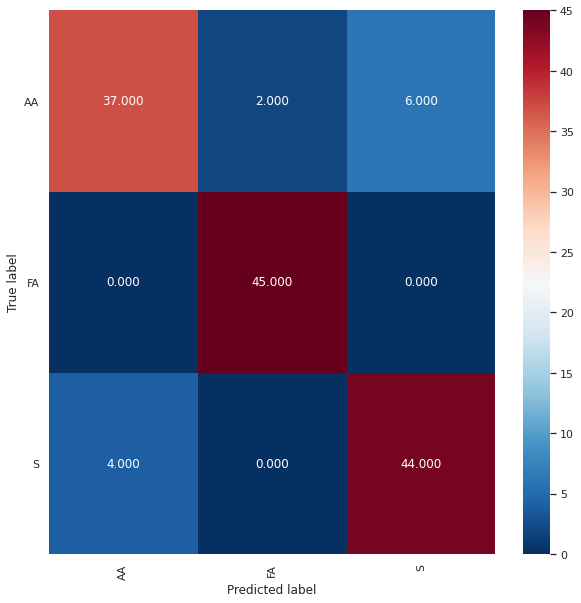

Normalised over true label (rows)


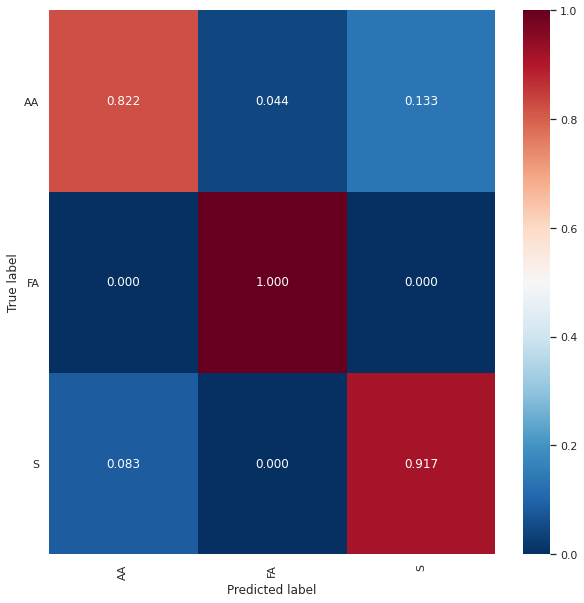

Normalised over pred label (columns)


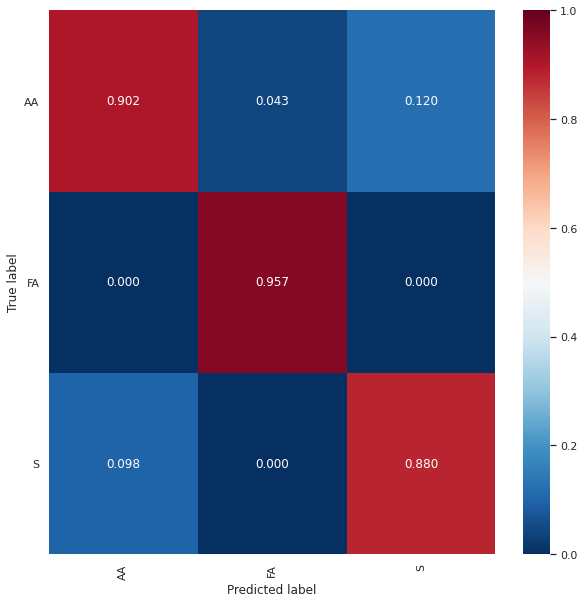

In [68]:
draw_conf_matrices(red_feat_flat_y_true, red_feat_flat_pred, ml.results_dir, 'Red_features')

In [69]:
red_feat_true_hue = []
for index, y in enumerate(red_feat_flat_y_true):
    if red_feat_flat_pred[index] == y:
        red_feat_true_hue.append('{}_correct'.format(y))
    else:
        red_feat_true_hue.append('{}_incorrect'.format(y))

sub_red_feat_true_hue = []
sub_red_feat_flat_x_true = []
sub_red_feat_flat_y_true = []
for i, true_hue in enumerate(red_feat_true_hue):
    if true_hue.endswith('_incorrect'):
        sub_red_feat_true_hue.append(true_hue)
        sub_red_feat_flat_x_true.append(red_feat_flat_x_true[i])
        sub_red_feat_flat_y_true.append(red_feat_flat_y_true[i])

red_feat_true_hue = np.array(red_feat_true_hue)
sub_red_feat_true_hue = np.array(sub_red_feat_true_hue)
sub_red_feat_flat_x_true = np.array(sub_red_feat_flat_x_true)
sub_red_feat_flat_y_true = np.array(sub_red_feat_flat_y_true)

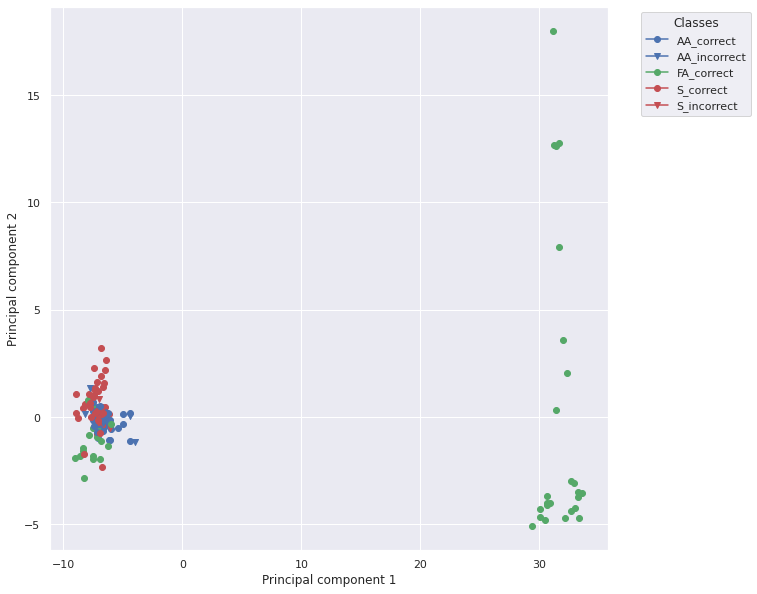

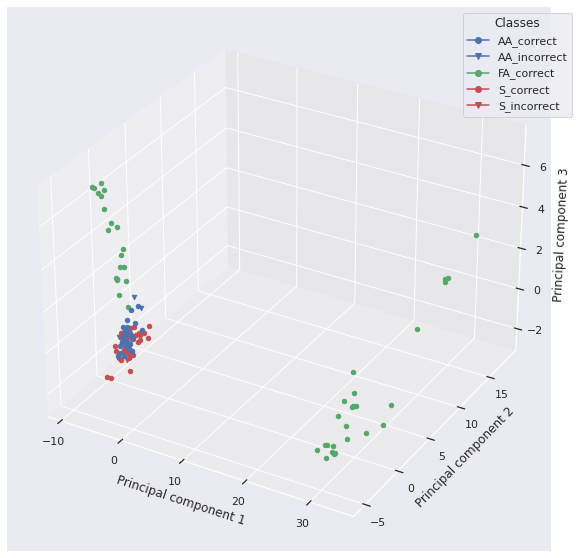

In [70]:
# Scatter plot (axes = top two principal components)
ml.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=2,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# Scatter plot (axes = top three principal components)
ml.plot_scatter_on_pca_axes(
    x=red_feat_flat_x_true, y=red_feat_flat_y_true, subclasses=red_feat_true_hue, num_dimensions=3,
    scale=True, plt_name='Red_features_coloured_by_pred'
)

# AA_incorrect = Value that is actually amino acid is predicted to be something else

So, a KNeighbors classifier trained with 5 peptides appears to perform better than a KNeighbors classifier trained with all 46 peptides.

Is this apparent difference in model performance significant?

In [71]:
params_1 = all_feat_searches['KNeighborsClassifier__no_balancing']['best_outer_loop_params']['f1']
selected_features_1 = list(ml.features)
params_2 = red_feat_searches['KNeighborsClassifier__no_balancing__Permutation_score__5']['best_outer_loop_params']['f1']
selected_features_2 = mean_permut_feat_importances_df['Feature'].tolist()[:5]

print('Model 1:')
print('Algorithm: KNeighborsClassifier')
print('Parameters:\n{}'.format(params_1))
print('Features:\n{}'.format(selected_features_1))
print('\n\n\n')
print('Model 2:')
print('Algorithm: KNeighborsClassifier')
print('Parameters:\n{}'.format(params_2))
print('Features:\n{}'.format(selected_features_2))

F, p = ml.run_5x2_CV_combined_F_test(
    x=ml.x, y=ml.y, selected_features_1=selected_features_1, selected_features_2=selected_features_2,
    classifier_1=KNeighborsClassifier, classifier_2=KNeighborsClassifier, params_1=params_1, params_2=params_2,
    resampling_method_1='no_balancing', resampling_method_2='no_balancing', n_components_pca_1=None,
    n_components_pca_2=None
)

Model 1:
Algorithm: KNeighborsClassifier
Parameters:
OrderedDict([('metric', 'minkowski'), ('n_jobs', -1), ('n_neighbors', 11), ('p', 1), ('weights', 'distance')])
Features:
['DPH_CCPent', 'DPH_QLKEIA', 'DPH_CCHex2-I24K', 'DPH_CCHept-I24N', 'DPH_CCHept-L28W', 'DPH_GRP22', 'DPH_CCHex', 'DPH_NLKEIA', 'DPH_CCHept-L28K', 'DPH_CCHept-I24T', 'DPH_CCHept-L7Y', 'DPH_CCHex2', 'DPH_CCHept-I17G-L21G', 'DPH_CCHept-I17H', 'DPH_CCHept-I24H', 'DPH_CCHept-L28Y', 'DPH_GRP46', 'DPH_CCHept', 'DPH_CCHept-I17A-L21A', 'DPH_CCHept-I17K-L24E', 'DPH_CCHept-L21S-I24S', 'DPH_CCHept-I24Y', 'DPH_GRP51', 'DPH_CCHept-I24D', 'DPH_CCHept-L14A', 'DPH_CCHept-L7K', 'DPH_CCHept-L21N-I24N', 'DPH_CCHept-L21S-I24Y', 'DPH_GRP52', 'DPH_CCHept-I24E', 'DPH_CCHept-L21A', 'DPH_CCHept-L21K-I24E', 'DPH_CCHept-L21T-I24T', 'DPH_CCHept-L21Y-I24S', 'DPH_GRP63', 'DPH_CCHept-I24K', 'DPH_CCHept-L21K', 'DPH_CCHept-L21E-I24K', 'DPH_CCHept-L21H-I24H', 'DPH_CCHept-I17T', 'DPH_GRP80', 'DPH_CCHept-I17K', 'DPH_CCPent-I24K', 'DPH_CCHept-I24S', 'DP

In [72]:
print('F score: {}'.format(F))
print('p value: {}'.format(p))

F score: 2.2068328601014437
p value: 0.1978124222159449


So, although by eye model performance clearly peaks at ~5-10 features, and then subsequently declines when further features are included (see the plot of F1 score vs. number of features above), this difference is not found to be significant (p=0.05). The small size of the dataset size means that the errors associated with the performance metrics calculated for the models will be large, hence only even larger differences in model performance will able to be detected. I suspect therefore that with a larger dataset, reducing the number of features would be found to lead to a significant improvement in model performance.